In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when ONI is removed as a predictor
df_trimmed = df_trimmed.drop(['ONI'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-20 23:58:23,939] A new study created in memory with name: no-name-ac8ff91b-55fc-41dd-9b44-db4adcef3289
[I 2025-05-21 00:03:13,199] Trial 0 finished with value: 5.27193431854248 and parameters: {'lr': 0.9558546248629887, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.3643733965202276}. Best is trial 0 with value: 5.27193431854248.


Cross Validation Accuracies:
[5.565174102783203, 5.5022711753845215, 4.373484134674072, 5.009019374847412, 5.909722805023193]
Mean Cross Validation Accuracy:
5.27193431854248
Standard Deviation of Cross Validation Accuracy:
0.5333208776487439


[I 2025-05-21 00:09:30,127] Trial 1 finished with value: 0.06867870688438416 and parameters: {'lr': 0.001837461198168192, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.18173039731035764}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[0.06749662011861801, 0.06773598492145538, 0.08030156046152115, 0.06536292284727097, 0.06249644607305527]
Mean Cross Validation Accuracy:
0.06867870688438416
Standard Deviation of Cross Validation Accuracy:
0.006108871444331129


[I 2025-05-21 00:15:09,425] Trial 2 finished with value: 0.06953778862953186 and parameters: {'lr': 0.888249562639659, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2650500959171095}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[0.06377669423818588, 0.061705827713012695, 0.06839605420827866, 0.07616040855646133, 0.07764995843172073]
Mean Cross Validation Accuracy:
0.06953778862953186
Standard Deviation of Cross Validation Accuracy:
0.0064109246052135825


[I 2025-05-21 00:19:46,963] Trial 3 finished with value: 0.12917666286230087 and parameters: {'lr': 0.021686345703216092, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.46344325750912707}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[0.15139758586883545, 0.10375415533781052, 0.16171668469905853, 0.12002301961183548, 0.10899186879396439]
Mean Cross Validation Accuracy:
0.12917666286230087
Standard Deviation of Cross Validation Accuracy:
0.023195436730398998


[I 2025-05-21 00:23:41,594] Trial 4 finished with value: 0.1846876859664917 and parameters: {'lr': 0.035400320105961905, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.3823539650143257}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[0.18390582501888275, 0.1950194388628006, 0.16093802452087402, 0.2094796746969223, 0.17409546673297882]
Mean Cross Validation Accuracy:
0.1846876859664917
Standard Deviation of Cross Validation Accuracy:
0.016722683138383265


[I 2025-05-21 00:33:15,168] Trial 5 finished with value: 4.011168003082275 and parameters: {'lr': 0.049882150085025785, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.28199054580684313}. Best is trial 1 with value: 0.06867870688438416.


Cross Validation Accuracies:
[4.5616774559021, 2.4393250942230225, 4.749467849731445, 4.488321781158447, 3.8170478343963623]
Mean Cross Validation Accuracy:
4.011168003082275
Standard Deviation of Cross Validation Accuracy:
0.846663548189043


[I 2025-05-21 00:39:10,112] Trial 6 finished with value: 0.05107387825846672 and parameters: {'lr': 0.006580266640267653, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27046469908289605}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.04249671474099159, 0.045296043157577515, 0.05648990720510483, 0.06254686415195465, 0.04853986203670502]
Mean Cross Validation Accuracy:
0.05107387825846672
Standard Deviation of Cross Validation Accuracy:
0.007407227896233787


[I 2025-05-21 00:44:07,441] Trial 7 finished with value: 0.9854403734207153 and parameters: {'lr': 0.605937335526479, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.11452833678550985}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.6476268768310547, 1.1606515645980835, 1.0395011901855469, 1.0202308893203735, 1.059191346168518]
Mean Cross Validation Accuracy:
0.9854403734207153
Standard Deviation of Cross Validation Accuracy:
0.1757208455926713


[I 2025-05-21 00:48:35,187] Trial 8 finished with value: 1.4821093320846557 and parameters: {'lr': 0.8573186947939732, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4047895412416317}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[1.884287714958191, 1.4442414045333862, 1.833909511566162, 1.4929946660995483, 0.7551133632659912]
Mean Cross Validation Accuracy:
1.4821093320846557
Standard Deviation of Cross Validation Accuracy:
0.4038778099985748


[I 2025-05-21 00:54:36,406] Trial 9 finished with value: 0.05765921920537949 and parameters: {'lr': 0.1554728133709094, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.25854029453015237}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.05298822000622749, 0.0512922964990139, 0.05634655803442001, 0.06381139159202576, 0.06385762989521027]
Mean Cross Validation Accuracy:
0.05765921920537949
Standard Deviation of Cross Validation Accuracy:
0.005298085272471146


[I 2025-05-21 01:00:53,142] Trial 10 finished with value: 0.30728051960468294 and parameters: {'lr': 0.002384959321038042, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18825671130398702}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.31184080243110657, 0.37189266085624695, 0.31937023997306824, 0.2457219511270523, 0.28757694363594055]
Mean Cross Validation Accuracy:
0.30728051960468294
Standard Deviation of Cross Validation Accuracy:
0.04127801975416439


[I 2025-05-21 01:07:53,619] Trial 11 finished with value: 0.06021386086940765 and parameters: {'lr': 0.1457712180204786, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.22510583780430715}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.05339103937149048, 0.06463606655597687, 0.06331360340118408, 0.06585203111171722, 0.05387656390666962]
Mean Cross Validation Accuracy:
0.06021386086940765
Standard Deviation of Cross Validation Accuracy:
0.005434436430123432


[I 2025-05-21 01:13:02,826] Trial 12 finished with value: 0.1505704939365387 and parameters: {'lr': 0.009258151995327361, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3137625206705784}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.16748297214508057, 0.11977555602788925, 0.06222524493932724, 0.13995634019374847, 0.26341235637664795]
Mean Cross Validation Accuracy:
0.1505704939365387
Standard Deviation of Cross Validation Accuracy:
0.06615918578543632


[I 2025-05-21 01:17:40,149] Trial 13 finished with value: 0.055870074033737185 and parameters: {'lr': 0.1288954189131518, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3230082208913488}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.04559481516480446, 0.060720883309841156, 0.058669399470090866, 0.0644751563668251, 0.04989011585712433]
Mean Cross Validation Accuracy:
0.055870074033737185
Standard Deviation of Cross Validation Accuracy:
0.007025024699011307


[I 2025-05-21 01:22:02,270] Trial 14 finished with value: 0.05116631537675857 and parameters: {'lr': 0.006614318403589186, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3360866456622074}. Best is trial 6 with value: 0.05107387825846672.


Cross Validation Accuracies:
[0.04226727783679962, 0.04547780752182007, 0.0566626638174057, 0.0625687763094902, 0.04885505139827728]
Mean Cross Validation Accuracy:
0.05116631537675857
Standard Deviation of Cross Validation Accuracy:
0.007444728248028884


[I 2025-05-21 01:28:39,426] Trial 15 finished with value: 0.051044286042451856 and parameters: {'lr': 0.005404551035956621, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.449775915365779}. Best is trial 15 with value: 0.051044286042451856.


Cross Validation Accuracies:
[0.04251108691096306, 0.0453217513859272, 0.05636783689260483, 0.062447819858789444, 0.04857293516397476]
Mean Cross Validation Accuracy:
0.051044286042451856
Standard Deviation of Cross Validation Accuracy:
0.00734916651916169


[I 2025-05-21 01:35:34,444] Trial 16 finished with value: 0.05102758929133415 and parameters: {'lr': 0.005294432374959981, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4963469269484101}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.0425584577023983, 0.04510955512523651, 0.05644184350967407, 0.06245611980557442, 0.04857197031378746]
Mean Cross Validation Accuracy:
0.05102758929133415
Standard Deviation of Cross Validation Accuracy:
0.007385185729288465


[I 2025-05-21 01:40:58,429] Trial 17 finished with value: 0.5692744612693786 and parameters: {'lr': 0.0010545278848791998, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49185525419733084}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.5873256921768188, 0.5190343856811523, 0.6121917366981506, 0.61375892162323, 0.5140615701675415]
Mean Cross Validation Accuracy:
0.5692744612693786
Standard Deviation of Cross Validation Accuracy:
0.044088853964262195


[I 2025-05-21 01:48:03,010] Trial 18 finished with value: 0.09136146754026413 and parameters: {'lr': 0.015622502720989955, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43618470520530606}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.0859605222940445, 0.08223897963762283, 0.10970651358366013, 0.09376499056816101, 0.08513633161783218]
Mean Cross Validation Accuracy:
0.09136146754026413
Standard Deviation of Cross Validation Accuracy:
0.009934384224693563


[I 2025-05-21 01:51:42,680] Trial 19 finished with value: 0.06020569875836372 and parameters: {'lr': 0.004060291056158403, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.48916932915689265}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.06778410077095032, 0.046017229557037354, 0.056339558213949203, 0.06292818486690521, 0.06795942038297653]
Mean Cross Validation Accuracy:
0.06020569875836372
Standard Deviation of Cross Validation Accuracy:
0.00826104118974986


[I 2025-05-21 01:56:26,000] Trial 20 finished with value: 0.22341266870498658 and parameters: {'lr': 0.0031520288307098298, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4313369898671497}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.3051508069038391, 0.13639052212238312, 0.24081097543239594, 0.224153533577919, 0.2105575054883957]
Mean Cross Validation Accuracy:
0.22341266870498658
Standard Deviation of Cross Validation Accuracy:
0.05426321481653108


[I 2025-05-21 02:01:49,341] Trial 21 finished with value: 0.051159337908029553 and parameters: {'lr': 0.007417722274812812, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.44918584721856003}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.042559605091810226, 0.045386556535959244, 0.05647542327642441, 0.06276240199804306, 0.04861270263791084]
Mean Cross Validation Accuracy:
0.051159337908029553
Standard Deviation of Cross Validation Accuracy:
0.007438516255277218


[I 2025-05-21 02:08:08,510] Trial 22 finished with value: 0.051338189840316774 and parameters: {'lr': 0.014288128421506783, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4988881906071839}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.042583152651786804, 0.04510456696152687, 0.05697524920105934, 0.06296940892934799, 0.049058571457862854]
Mean Cross Validation Accuracy:
0.051338189840316774
Standard Deviation of Cross Validation Accuracy:
0.007586396853193446


[I 2025-05-21 02:14:52,811] Trial 23 finished with value: 0.05183838754892349 and parameters: {'lr': 0.004592607242858895, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3625954553479331}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.046200644224882126, 0.04531661421060562, 0.05620134249329567, 0.06254696846008301, 0.04892636835575104]
Mean Cross Validation Accuracy:
0.05183838754892349
Standard Deviation of Cross Validation Accuracy:
0.00658037406266609


[I 2025-05-21 02:21:29,755] Trial 24 finished with value: 0.44265968799591066 and parameters: {'lr': 0.001713242172265903, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.39448856133886995}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.42994582653045654, 0.4223979711532593, 0.4576061964035034, 0.4592362642288208, 0.4441121816635132]
Mean Cross Validation Accuracy:
0.44265968799591066
Standard Deviation of Cross Validation Accuracy:
0.014645614864611793


[I 2025-05-21 02:29:09,819] Trial 25 finished with value: 0.09570933282375335 and parameters: {'lr': 0.010639408343460065, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.22139615652651526}. Best is trial 16 with value: 0.05102758929133415.


Cross Validation Accuracies:
[0.1264086216688156, 0.09072738885879517, 0.09169134497642517, 0.09160211682319641, 0.07811719179153442]
Mean Cross Validation Accuracy:
0.09570933282375335
Standard Deviation of Cross Validation Accuracy:
0.016184949656866628


[I 2025-05-21 02:34:35,622] Trial 26 finished with value: 0.05102245062589646 and parameters: {'lr': 0.0050791000665729264, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41647911543396515}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.0426330640912056, 0.045341189950704575, 0.05632572993636131, 0.062324490398168564, 0.04848777875304222]
Mean Cross Validation Accuracy:
0.05102245062589646
Standard Deviation of Cross Validation Accuracy:
0.007279340152098919


[I 2025-05-21 02:40:46,811] Trial 27 finished with value: 0.568458890914917 and parameters: {'lr': 0.0010980097382684497, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4171614416410031}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.6108144521713257, 0.5515281558036804, 0.5719274878501892, 0.5195311903953552, 0.5884931683540344]
Mean Cross Validation Accuracy:
0.568458890914917
Standard Deviation of Cross Validation Accuracy:
0.031266489013290516


[I 2025-05-21 02:44:45,464] Trial 28 finished with value: 0.051178085058927535 and parameters: {'lr': 0.06049550023033372, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.46605220477781667}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.04196230694651604, 0.0479121170938015, 0.05441300570964813, 0.06205911561846733, 0.04954387992620468]
Mean Cross Validation Accuracy:
0.051178085058927535
Standard Deviation of Cross Validation Accuracy:
0.00673987057793171


[I 2025-05-21 02:48:27,581] Trial 29 finished with value: 0.0771654948592186 and parameters: {'lr': 0.02160947972500265, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3674576773203678}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.06785611808300018, 0.0767318606376648, 0.08417800068855286, 0.0770704448223114, 0.07999105006456375]
Mean Cross Validation Accuracy:
0.0771654948592186
Standard Deviation of Cross Validation Accuracy:
0.005366946419224128


[I 2025-05-21 02:51:51,342] Trial 30 finished with value: 0.2938618063926697 and parameters: {'lr': 0.004771059740708683, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.47106602433042516}. Best is trial 26 with value: 0.05102245062589646.


Cross Validation Accuracies:
[0.23426753282546997, 0.34757480025291443, 0.26270556449890137, 0.3338139057159424, 0.29094722867012024]
Mean Cross Validation Accuracy:
0.2938618063926697
Standard Deviation of Cross Validation Accuracy:
0.042454539366275926


[I 2025-05-21 02:57:11,328] Trial 31 finished with value: 0.050984546542167664 and parameters: {'lr': 0.005668181316305681, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45502838358743375}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042394403368234634, 0.045098088681697845, 0.05630620941519737, 0.06237003952264786, 0.04875399172306061]
Mean Cross Validation Accuracy:
0.050984546542167664
Standard Deviation of Cross Validation Accuracy:
0.007367032874034748


[I 2025-05-21 03:02:58,842] Trial 32 finished with value: 0.3295901656150818 and parameters: {'lr': 0.002630547359037514, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.42422229989916793}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.3475082814693451, 0.36137646436691284, 0.25011739134788513, 0.30415281653404236, 0.3847958743572235]
Mean Cross Validation Accuracy:
0.3295901656150818
Standard Deviation of Cross Validation Accuracy:
0.04762788788057916


[I 2025-05-21 03:08:14,476] Trial 33 finished with value: 0.4782963752746582 and parameters: {'lr': 0.0017080418665937247, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.453683816893905}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.47703787684440613, 0.5450551509857178, 0.42592307925224304, 0.5210710167884827, 0.4223947525024414]
Mean Cross Validation Accuracy:
0.4782963752746582
Standard Deviation of Cross Validation Accuracy:
0.04930708158914591


[I 2025-05-21 03:11:36,702] Trial 34 finished with value: 0.051183727383613584 and parameters: {'lr': 0.013861833793168602, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4848510661291912}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042316313832998276, 0.045494113117456436, 0.05672140419483185, 0.06257149577140808, 0.04881531000137329]
Mean Cross Validation Accuracy:
0.051183727383613584
Standard Deviation of Cross Validation Accuracy:
0.007442570359645235


[I 2025-05-21 03:17:38,515] Trial 35 finished with value: 0.06029686406254768 and parameters: {'lr': 0.0040273317410159035, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.44526587135309686}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.046588316559791565, 0.05671238526701927, 0.0671980232000351, 0.06751985102891922, 0.06346574425697327]
Mean Cross Validation Accuracy:
0.06029686406254768
Standard Deviation of Cross Validation Accuracy:
0.007881777752700663


[I 2025-05-21 03:24:38,928] Trial 36 finished with value: 0.11269363760948181 and parameters: {'lr': 0.026247723820511246, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.35539868514496353}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.09954559057950974, 0.11783497780561447, 0.12775175273418427, 0.09380649775266647, 0.12452936917543411]
Mean Cross Validation Accuracy:
0.11269363760948181
Standard Deviation of Cross Validation Accuracy:
0.013585727396762398


[I 2025-05-21 03:28:37,995] Trial 37 finished with value: 0.05451729074120522 and parameters: {'lr': 0.010209290854751942, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.3873265903546627}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.043409354984760284, 0.04880812391638756, 0.06036762893199921, 0.06571106612682343, 0.0542902797460556]
Mean Cross Validation Accuracy:
0.05451729074120522
Standard Deviation of Cross Validation Accuracy:
0.007944298847918045


[I 2025-05-21 03:33:45,506] Trial 38 finished with value: 0.05212816521525383 and parameters: {'lr': 0.005841547479885234, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4673973251293872}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.044263582676649094, 0.04347243905067444, 0.05833818018436432, 0.06437911093235016, 0.05018751323223114]
Mean Cross Validation Accuracy:
0.05212816521525383
Standard Deviation of Cross Validation Accuracy:
0.00811405374571475


[I 2025-05-21 03:36:44,524] Trial 39 finished with value: 0.055210118740797044 and parameters: {'lr': 0.03631532163006064, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.40792189919475663}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.044459596276283264, 0.04865213483572006, 0.060498785227537155, 0.06938095390796661, 0.05305912345647812]
Mean Cross Validation Accuracy:
0.055210118740797044
Standard Deviation of Cross Validation Accuracy:
0.008854267100279777


[I 2025-05-21 03:41:32,229] Trial 40 finished with value: 0.38772123456001284 and parameters: {'lr': 0.0022009597270482768, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1309235738215551}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.26184695959091187, 0.3392125964164734, 0.4452348053455353, 0.4554486572742462, 0.43686315417289734]
Mean Cross Validation Accuracy:
0.38772123456001284
Standard Deviation of Cross Validation Accuracy:
0.07550783263846293


[I 2025-05-21 03:47:04,661] Trial 41 finished with value: 0.05109559446573257 and parameters: {'lr': 0.007780598849622445, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2928680246938695}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042367320507764816, 0.04505395144224167, 0.05659255012869835, 0.0626182034611702, 0.04884594678878784]
Mean Cross Validation Accuracy:
0.05109559446573257
Standard Deviation of Cross Validation Accuracy:
0.00749309243238556


[I 2025-05-21 03:53:31,154] Trial 42 finished with value: 0.16333281695842744 and parameters: {'lr': 0.003347226982658619, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2607690367766171}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.16370418667793274, 0.21275340020656586, 0.15689058601856232, 0.16676251590251923, 0.116553395986557]
Mean Cross Validation Accuracy:
0.16333281695842744
Standard Deviation of Cross Validation Accuracy:
0.030607552547852877


[I 2025-05-21 04:00:41,916] Trial 43 finished with value: 0.05202133432030678 and parameters: {'lr': 0.004784846279310102, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4806541332059162}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04334597662091255, 0.047313667833805084, 0.05772420018911362, 0.06163604557514191, 0.05008678138256073]
Mean Cross Validation Accuracy:
0.05202133432030678
Standard Deviation of Cross Validation Accuracy:
0.006725054671316316


[I 2025-05-21 04:05:11,643] Trial 44 finished with value: 0.05108282193541527 and parameters: {'lr': 0.00590866824774296, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2841250823307159}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04221242293715477, 0.045181360095739365, 0.056576360017061234, 0.06273035705089569, 0.04871360957622528]
Mean Cross Validation Accuracy:
0.05108282193541527
Standard Deviation of Cross Validation Accuracy:
0.007549416300049619


[I 2025-05-21 04:08:19,284] Trial 45 finished with value: 0.4277293860912323 and parameters: {'lr': 0.0014002660962685036, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.2498658202084616}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.4265843331813812, 0.4333955943584442, 0.4417191743850708, 0.40396061539649963, 0.4329872131347656]
Mean Cross Validation Accuracy:
0.4277293860912323
Standard Deviation of Cross Validation Accuracy:
0.012819753853789024


[I 2025-05-21 04:12:39,058] Trial 46 finished with value: 0.45465545654296874 and parameters: {'lr': 0.0030598853667637665, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4537766087534131}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.44149133563041687, 0.44582557678222656, 0.46536919474601746, 0.44918468594551086, 0.471406489610672]
Mean Cross Validation Accuracy:
0.45465545654296874
Standard Deviation of Cross Validation Accuracy:
0.011632467339633608


[I 2025-05-21 04:17:37,873] Trial 47 finished with value: 0.05122214108705521 and parameters: {'lr': 0.018503921490259846, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.34073866094948524}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04313020035624504, 0.04529351741075516, 0.056515589356422424, 0.06263274699449539, 0.04853865131735802]
Mean Cross Validation Accuracy:
0.05122214108705521
Standard Deviation of Cross Validation Accuracy:
0.007294542104691359


[I 2025-05-21 04:24:31,461] Trial 48 finished with value: 0.09753186851739884 and parameters: {'lr': 0.010813001990258756, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.23465157477937454}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.08982286602258682, 0.09610298275947571, 0.11109836399555206, 0.0930808037519455, 0.09755432605743408]
Mean Cross Validation Accuracy:
0.09753186851739884
Standard Deviation of Cross Validation Accuracy:
0.007284678653452463


[I 2025-05-21 04:29:30,710] Trial 49 finished with value: 0.5553553879261017 and parameters: {'lr': 0.33825382201273674, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.40548837728221443}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.4881300628185272, 0.4797726571559906, 0.505088746547699, 0.4271158277988434, 0.8766696453094482]
Mean Cross Validation Accuracy:
0.5553553879261017
Standard Deviation of Cross Validation Accuracy:
0.16275562389140064


[I 2025-05-21 04:33:12,138] Trial 50 finished with value: 0.3777040958404541 and parameters: {'lr': 0.007833262975100886, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3086115758114054}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.324040025472641, 0.39374157786369324, 0.3908737003803253, 0.3691619634628296, 0.41070321202278137]
Mean Cross Validation Accuracy:
0.3777040958404541
Standard Deviation of Cross Validation Accuracy:
0.02990779649588216


[I 2025-05-21 04:38:02,134] Trial 51 finished with value: 0.05115235820412636 and parameters: {'lr': 0.005678225179984967, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27945521187070277}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.0423833504319191, 0.04544823616743088, 0.05685076862573624, 0.06255127489566803, 0.04852816089987755]
Mean Cross Validation Accuracy:
0.05115235820412636
Standard Deviation of Cross Validation Accuracy:
0.007466272163322101


[I 2025-05-21 04:44:11,832] Trial 52 finished with value: 0.05098752230405808 and parameters: {'lr': 0.00666685537337673, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2756817260572487}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04193450137972832, 0.045423757284879684, 0.05650194734334946, 0.06242718920111656, 0.048650216311216354]
Mean Cross Validation Accuracy:
0.05098752230405808
Standard Deviation of Cross Validation Accuracy:
0.007478643333904605


[I 2025-05-21 04:50:13,383] Trial 53 finished with value: 0.1578376352787018 and parameters: {'lr': 0.0035216223925649557, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20794086398562228}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.09243254363536835, 0.19586177170276642, 0.11846742033958435, 0.2131388783454895, 0.1692875623703003]
Mean Cross Validation Accuracy:
0.1578376352787018
Standard Deviation of Cross Validation Accuracy:
0.04574495185953503


[I 2025-05-21 04:55:35,899] Trial 54 finished with value: 0.05143168196082115 and parameters: {'lr': 0.013708895502231078, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.32706091912197244}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04292118176817894, 0.04579409584403038, 0.05669812858104706, 0.06265560537576675, 0.049089398235082626]
Mean Cross Validation Accuracy:
0.05143168196082115
Standard Deviation of Cross Validation Accuracy:
0.0072582256872228456


[I 2025-05-21 05:00:29,997] Trial 55 finished with value: 0.2783196300268173 and parameters: {'lr': 0.0023799316682010197, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43473222642107123}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.4067203402519226, 0.29131609201431274, 0.20965589582920074, 0.23610331118106842, 0.2478025108575821]
Mean Cross Validation Accuracy:
0.2783196300268173
Standard Deviation of Cross Validation Accuracy:
0.0694029840046378


[I 2025-05-21 05:05:18,515] Trial 56 finished with value: 0.051213546097278594 and parameters: {'lr': 0.008741124403826609, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.17148555302235113}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04275353252887726, 0.04550377279520035, 0.05652035400271416, 0.0626235082745552, 0.048666562885046005]
Mean Cross Validation Accuracy:
0.051213546097278594
Standard Deviation of Cross Validation Accuracy:
0.007334983452662059


[I 2025-05-21 05:10:15,476] Trial 57 finished with value: 0.05130074396729469 and parameters: {'lr': 0.006721787204379421, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49903004695061165}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04266251623630524, 0.04549515247344971, 0.05684530362486839, 0.06258013844490051, 0.048920609056949615]
Mean Cross Validation Accuracy:
0.05130074396729469
Standard Deviation of Cross Validation Accuracy:
0.007375036199167056


[I 2025-05-21 05:15:46,163] Trial 58 finished with value: 0.051214434951543805 and parameters: {'lr': 0.005165464954505452, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2715901960276225}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04264774173498154, 0.045326609164476395, 0.05675109475851059, 0.06246746703982353, 0.04887926205992699]
Mean Cross Validation Accuracy:
0.051214434951543805
Standard Deviation of Cross Validation Accuracy:
0.00735925391051602


[I 2025-05-21 05:21:14,148] Trial 59 finished with value: 0.05488366261124611 and parameters: {'lr': 0.012374754638987528, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.3005810851612935}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04641493782401085, 0.04712550342082977, 0.06174701079726219, 0.06616108119487762, 0.05296977981925011]
Mean Cross Validation Accuracy:
0.05488366261124611
Standard Deviation of Cross Validation Accuracy:
0.007872191551533797


[I 2025-05-21 05:25:51,489] Trial 60 finished with value: 0.06173822209239006 and parameters: {'lr': 0.0019957840696409285, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.47687647585453863}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.06802001595497131, 0.05529208481311798, 0.066777803003788, 0.061037614941596985, 0.05756359174847603]
Mean Cross Validation Accuracy:
0.06173822209239006
Standard Deviation of Cross Validation Accuracy:
0.004986569654698134


[I 2025-05-21 05:31:14,731] Trial 61 finished with value: 0.051177967339754105 and parameters: {'lr': 0.006551332415778223, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2432616807522731}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04270532727241516, 0.04525380581617355, 0.05654282495379448, 0.06261629611253738, 0.048771582543849945]
Mean Cross Validation Accuracy:
0.051177967339754105
Standard Deviation of Cross Validation Accuracy:
0.007379553774955733


[I 2025-05-21 05:36:59,861] Trial 62 finished with value: 0.06369568258523942 and parameters: {'lr': 0.004269619879261996, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2942458251643465}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.06058939918875694, 0.05969327315688133, 0.05791303142905235, 0.08512594550848007, 0.05515676364302635]
Mean Cross Validation Accuracy:
0.06369568258523942
Standard Deviation of Cross Validation Accuracy:
0.010874526544420518


[I 2025-05-21 05:42:58,138] Trial 63 finished with value: 0.18894743621349336 and parameters: {'lr': 0.00286217850926009, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2639552222050328}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.2211167961359024, 0.18669261038303375, 0.22994302213191986, 0.0974937379360199, 0.20949101448059082]
Mean Cross Validation Accuracy:
0.18894743621349336
Standard Deviation of Cross Validation Accuracy:
0.04797167405622156


[I 2025-05-21 05:48:11,478] Trial 64 finished with value: 0.05106706619262695 and parameters: {'lr': 0.009028486828163623, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27949834406979923}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042388204485177994, 0.04508841037750244, 0.056537095457315445, 0.06256318837404251, 0.048758432269096375]
Mean Cross Validation Accuracy:
0.05106706619262695
Standard Deviation of Cross Validation Accuracy:
0.007462959223420769


[I 2025-05-21 05:53:06,153] Trial 65 finished with value: 0.051058873534202576 and parameters: {'lr': 0.009424607438039028, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2024420408659473}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04233277216553688, 0.045172885060310364, 0.05666486918926239, 0.06242327392101288, 0.048700567334890366]
Mean Cross Validation Accuracy:
0.051058873534202576
Standard Deviation of Cross Validation Accuracy:
0.007442151529994796


[I 2025-05-21 05:57:55,997] Trial 66 finished with value: 0.05117233321070671 and parameters: {'lr': 0.009085619960104983, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.16762408379526905}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04275762662291527, 0.04554184526205063, 0.056188322603702545, 0.06265772134065628, 0.04871615022420883]
Mean Cross Validation Accuracy:
0.05117233321070671
Standard Deviation of Cross Validation Accuracy:
0.007288577453083378


[I 2025-05-21 06:03:14,303] Trial 67 finished with value: 0.0513776533305645 and parameters: {'lr': 0.018620639023831122, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13425993707249753}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.043160390108823776, 0.04563996568322182, 0.056530699133872986, 0.06270277500152588, 0.048854436725378036]
Mean Cross Validation Accuracy:
0.0513776533305645
Standard Deviation of Cross Validation Accuracy:
0.007233579450639973


[I 2025-05-21 06:08:01,517] Trial 68 finished with value: 0.458040326833725 and parameters: {'lr': 0.004092619128673925, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.37829611151106335}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.4372451603412628, 0.47897961735725403, 0.45704641938209534, 0.42823079228401184, 0.48869964480400085]
Mean Cross Validation Accuracy:
0.458040326833725
Standard Deviation of Cross Validation Accuracy:
0.023239977700391202


[I 2025-05-21 06:14:08,343] Trial 69 finished with value: 0.05143139883875847 and parameters: {'lr': 0.010822597868366153, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.19592534378706677}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.043959248811006546, 0.045837268233299255, 0.05738885700702667, 0.06387531012296677, 0.0460963100194931]
Mean Cross Validation Accuracy:
0.05143139883875847
Standard Deviation of Cross Validation Accuracy:
0.007822182967094684


[I 2025-05-21 06:19:30,619] Trial 70 finished with value: 0.052557780593633655 and parameters: {'lr': 0.06931767784438478, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.42214896887022474}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04514578729867935, 0.04493632912635803, 0.05581556633114815, 0.06372740864753723, 0.053163811564445496]
Mean Cross Validation Accuracy:
0.052557780593633655
Standard Deviation of Cross Validation Accuracy:
0.0070535834776965815


[I 2025-05-21 06:24:17,271] Trial 71 finished with value: 0.05116865187883377 and parameters: {'lr': 0.0082258037078382, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2191954933592253}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042932938784360886, 0.04516264796257019, 0.0565175861120224, 0.06260157376527786, 0.048628512769937515]
Mean Cross Validation Accuracy:
0.05116865187883377
Standard Deviation of Cross Validation Accuracy:
0.007344033771731982


[I 2025-05-21 06:28:28,124] Trial 72 finished with value: 0.09312662780284882 and parameters: {'lr': 0.00367823909150032, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45867062934259156}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.13432860374450684, 0.11434993892908096, 0.07503828406333923, 0.06562405079603195, 0.0762922614812851]
Mean Cross Validation Accuracy:
0.09312662780284882
Standard Deviation of Cross Validation Accuracy:
0.026514175707952763


[I 2025-05-21 06:32:47,376] Trial 73 finished with value: 0.05119621008634567 and parameters: {'lr': 0.007091658834817609, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4403261102564047}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04232252761721611, 0.045413922518491745, 0.05693777650594711, 0.06253588199615479, 0.04877094179391861]
Mean Cross Validation Accuracy:
0.05119621008634567
Standard Deviation of Cross Validation Accuracy:
0.007478138275578438


[I 2025-05-21 06:37:18,710] Trial 74 finished with value: 0.051074717193841934 and parameters: {'lr': 0.01692723987881031, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.24559789689456346}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04277350381016731, 0.044984303414821625, 0.056262433528900146, 0.06236933171749115, 0.04898401349782944]
Mean Cross Validation Accuracy:
0.051074717193841934
Standard Deviation of Cross Validation Accuracy:
0.00727811848758121


[I 2025-05-21 06:40:46,361] Trial 75 finished with value: 0.0512557253241539 and parameters: {'lr': 0.005196369031276378, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.31816089328480474}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04270988330245018, 0.045537952333688736, 0.056730981916189194, 0.062493715435266495, 0.048806093633174896]
Mean Cross Validation Accuracy:
0.0512557253241539
Standard Deviation of Cross Validation Accuracy:
0.007321146026927057


[I 2025-05-21 06:47:27,912] Trial 76 finished with value: 2.1092357873916625 and parameters: {'lr': 0.027295809564138566, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.3454670764299034}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[2.25537371635437, 2.1562397480010986, 2.116988182067871, 1.785899043083191, 2.2316782474517822]
Mean Cross Validation Accuracy:
2.1092357873916625
Standard Deviation of Cross Validation Accuracy:
0.16921263100801576


[I 2025-05-21 06:53:11,995] Trial 77 finished with value: 0.051152057200670245 and parameters: {'lr': 0.011309637011626189, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4919045773553989}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042528316378593445, 0.04551397264003754, 0.056206654757261276, 0.0624663271009922, 0.04904501512646675]
Mean Cross Validation Accuracy:
0.051152057200670245
Standard Deviation of Cross Validation Accuracy:
0.0072685375340310375


[I 2025-05-21 06:59:41,866] Trial 78 finished with value: 0.05111701786518097 and parameters: {'lr': 0.006214090659222875, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2756621819477794}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04257148504257202, 0.04522072896361351, 0.056547220796346664, 0.06271203607320786, 0.048533618450164795]
Mean Cross Validation Accuracy:
0.05111701786518097
Standard Deviation of Cross Validation Accuracy:
0.007461874532430251


[I 2025-05-21 07:03:14,598] Trial 79 finished with value: 0.051124269515275954 and parameters: {'lr': 0.009314941355480683, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4661785756433608}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04248848930001259, 0.04519153758883476, 0.056559089571237564, 0.06266778707504272, 0.048714444041252136]
Mean Cross Validation Accuracy:
0.051124269515275954
Standard Deviation of Cross Validation Accuracy:
0.007461519061771929


[I 2025-05-21 07:08:08,912] Trial 80 finished with value: 0.4540468156337738 and parameters: {'lr': 0.0027055424254085404, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.25580973188338885}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.46660181879997253, 0.4463760554790497, 0.4338715672492981, 0.4461381733417511, 0.4772464632987976]
Mean Cross Validation Accuracy:
0.4540468156337738
Standard Deviation of Cross Validation Accuracy:
0.01564787262163306


[I 2025-05-21 07:13:06,610] Trial 81 finished with value: 0.051736225932836534 and parameters: {'lr': 0.01923749730430901, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.23273018557757158}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04318265989422798, 0.04578186571598053, 0.05687059089541435, 0.0630309209227562, 0.049815092235803604]
Mean Cross Validation Accuracy:
0.051736225932836534
Standard Deviation of Cross Validation Accuracy:
0.007297129445680041


[I 2025-05-21 07:17:38,368] Trial 82 finished with value: 0.051215346157550815 and parameters: {'lr': 0.012445792433719637, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.24565952953136935}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04225895181298256, 0.04592651501297951, 0.05614582076668739, 0.06280527263879776, 0.04894017055630684]
Mean Cross Validation Accuracy:
0.051215346157550815
Standard Deviation of Cross Validation Accuracy:
0.0073756509442861684


[I 2025-05-21 07:22:18,820] Trial 83 finished with value: 0.05104161500930786 and parameters: {'lr': 0.016352852477762567, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2127005317209154}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042749516665935516, 0.044866893440485, 0.05622461065649986, 0.06237960234284401, 0.04898745194077492]
Mean Cross Validation Accuracy:
0.05104161500930786
Standard Deviation of Cross Validation Accuracy:
0.00730094607506461


[I 2025-05-21 07:27:12,784] Trial 84 finished with value: 0.05123659446835518 and parameters: {'lr': 0.014380186484691282, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1986794254353263}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04306961968541145, 0.04522407427430153, 0.056337274610996246, 0.06233805790543556, 0.049213945865631104]
Mean Cross Validation Accuracy:
0.05123659446835518
Standard Deviation of Cross Validation Accuracy:
0.007158217821799066


[I 2025-05-21 07:33:17,076] Trial 85 finished with value: 0.052050376683473586 and parameters: {'lr': 0.004776230598028665, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1603102755718381}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04589216783642769, 0.04624691233038902, 0.05495760589838028, 0.06339752674102783, 0.04975767061114311]
Mean Cross Validation Accuracy:
0.052050376683473586
Standard Deviation of Cross Validation Accuracy:
0.0065432412758833665


[I 2025-05-21 07:38:36,488] Trial 86 finished with value: 0.051932448893785475 and parameters: {'lr': 0.04097073845973709, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2128123081551498}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.045195676386356354, 0.04655186086893082, 0.05696989223361015, 0.06257384270429611, 0.04837097227573395]
Mean Cross Validation Accuracy:
0.051932448893785475
Standard Deviation of Cross Validation Accuracy:
0.006717649062630587


[I 2025-05-21 07:44:16,939] Trial 87 finished with value: 0.051055402308702466 and parameters: {'lr': 0.007178751799104214, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18834661663126578}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04221348091959953, 0.04514242708683014, 0.05649590119719505, 0.06261305510997772, 0.0488121472299099]
Mean Cross Validation Accuracy:
0.051055402308702466
Standard Deviation of Cross Validation Accuracy:
0.0075013786680129075


[I 2025-05-21 07:50:56,396] Trial 88 finished with value: 0.05121859684586525 and parameters: {'lr': 0.0074590658605377365, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18475298046587604}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042746927589178085, 0.04505976289510727, 0.056640032678842545, 0.06277593225240707, 0.048870328813791275]
Mean Cross Validation Accuracy:
0.05121859684586525
Standard Deviation of Cross Validation Accuracy:
0.007458937545905096


[I 2025-05-21 07:57:55,234] Trial 89 finished with value: 0.05112432390451431 and parameters: {'lr': 0.005529878095817116, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1556637939134515}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042400628328323364, 0.045446064323186874, 0.05653304234147072, 0.062463484704494476, 0.04877839982509613]
Mean Cross Validation Accuracy:
0.05112432390451431
Standard Deviation of Cross Validation Accuracy:
0.007371291053044417


[I 2025-05-21 08:03:31,034] Trial 90 finished with value: 0.596740049123764 and parameters: {'lr': 0.00940015245257858, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1468638825101635}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.5554288625717163, 0.6032602190971375, 0.6928354501724243, 0.46800896525382996, 0.6641667485237122]
Mean Cross Validation Accuracy:
0.596740049123764
Standard Deviation of Cross Validation Accuracy:
0.08012678029201173


[I 2025-05-21 08:08:05,381] Trial 91 finished with value: 0.051228853315114974 and parameters: {'lr': 0.006700629656974047, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20142205505712096}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04294043406844139, 0.045229472219944, 0.0565955750644207, 0.06256847083568573, 0.048810314387083054]
Mean Cross Validation Accuracy:
0.051228853315114974
Standard Deviation of Cross Validation Accuracy:
0.007320224389012076


[I 2025-05-21 08:12:28,037] Trial 92 finished with value: 0.11884111016988755 and parameters: {'lr': 0.0036291625225694816, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2318955141224798}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.0698251873254776, 0.10408410429954529, 0.108544260263443, 0.09624921530485153, 0.2155027836561203]
Mean Cross Validation Accuracy:
0.11884111016988755
Standard Deviation of Cross Validation Accuracy:
0.050160199097081394


[I 2025-05-21 08:16:37,572] Trial 93 finished with value: 0.0615010991692543 and parameters: {'lr': 0.004404755343299991, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1792166575850866}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.08289680629968643, 0.056170787662267685, 0.0562247596681118, 0.06318973004817963, 0.04902341216802597]
Mean Cross Validation Accuracy:
0.0615010991692543
Standard Deviation of Cross Validation Accuracy:
0.011598037851722484


[I 2025-05-21 08:20:47,724] Trial 94 finished with value: 0.051358092576265335 and parameters: {'lr': 0.008440326449648509, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.29072593168198424}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042871203273534775, 0.045544322580099106, 0.0568864569067955, 0.0628553107380867, 0.04863316938281059]
Mean Cross Validation Accuracy:
0.051358092576265335
Standard Deviation of Cross Validation Accuracy:
0.00742968714882324


[I 2025-05-21 08:25:00,136] Trial 95 finished with value: 0.05123598650097847 and parameters: {'lr': 0.005760740874005584, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.10991095108390986}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04274410009384155, 0.04546089470386505, 0.056475166231393814, 0.06265023350715637, 0.04884953796863556]
Mean Cross Validation Accuracy:
0.05123598650097847
Standard Deviation of Cross Validation Accuracy:
0.007333389333452319


[I 2025-05-21 08:29:20,436] Trial 96 finished with value: 0.051119742542505266 and parameters: {'lr': 0.007624262191811609, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41574244382842784}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.042632345110177994, 0.04514101520180702, 0.05637924373149872, 0.06267020106315613, 0.04877590760588646]
Mean Cross Validation Accuracy:
0.051119742542505266
Standard Deviation of Cross Validation Accuracy:
0.007407430091375858


[I 2025-05-21 08:33:32,812] Trial 97 finished with value: 0.051141003519296645 and parameters: {'lr': 0.012289494003978765, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3066055140699647}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04256566986441612, 0.04540439322590828, 0.056799471378326416, 0.06254706531763077, 0.048388417810201645]
Mean Cross Validation Accuracy:
0.051141003519296645
Standard Deviation of Cross Validation Accuracy:
0.007431531165187157


[I 2025-05-21 08:36:09,695] Trial 98 finished with value: 0.059413828700780866 and parameters: {'lr': 0.022407882470303144, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.47679146254629956}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.0542282834649086, 0.05546484887599945, 0.06279692053794861, 0.06590550392866135, 0.05867358669638634]
Mean Cross Validation Accuracy:
0.059413828700780866
Standard Deviation of Cross Validation Accuracy:
0.004395894378118436


[I 2025-05-21 08:40:57,867] Trial 99 finished with value: 0.05242023691534996 and parameters: {'lr': 0.009999033133542508, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3979616454945815}. Best is trial 31 with value: 0.050984546542167664.


Cross Validation Accuracies:
[0.04579135403037071, 0.045037586241960526, 0.05981875956058502, 0.06335435062646866, 0.04809913411736488]
Mean Cross Validation Accuracy:
0.05242023691534996
Standard Deviation of Cross Validation Accuracy:
0.0076342717876501185
Number of finished trials: 100
Best trial: {'lr': 0.005668181316305681, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45502838358743375}
Best hyperparameters:  {'lr': 0.005668181316305681, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45502838358743375}
Fold 1:
Epoch 1/100
84/84 [==============================] - 23s 140ms/step - loss: 0.6408 - val_loss: 0.3933
Epoch 2/100
84/84 [==============================] - 9s 105ms/step - loss: 0.3282 - val_loss: 0.2126
Epoch 3/100
84/84 [==============================] - 9s 104ms/step - loss: 0.0868 - val_loss: 0.2477
Epoch 4/100
84/84 [==============================] - 8s 92ms/step - loss: 0.0536 - 

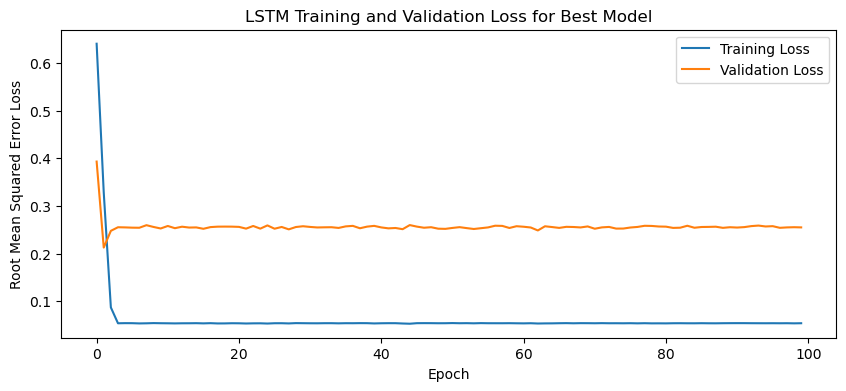

1/1 - 2s - loss: 0.0444 - 2s/epoch - 2s/step
Test Loss: 0.044439345598220825
1/1 [==============================] - 0s 81ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

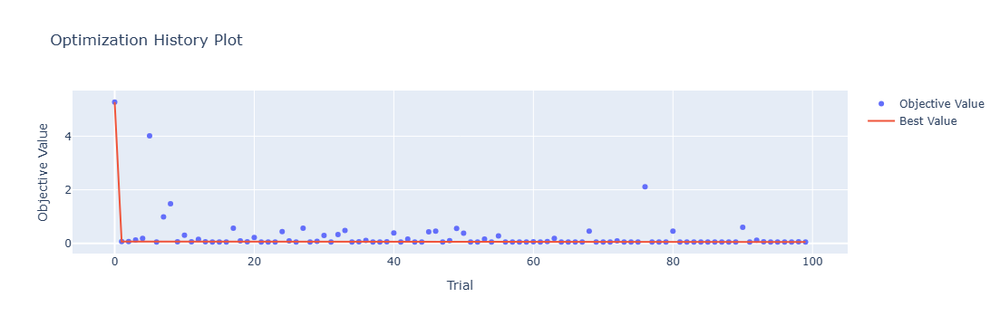

In [4]:
optuna.visualization.plot_optimization_history(study)

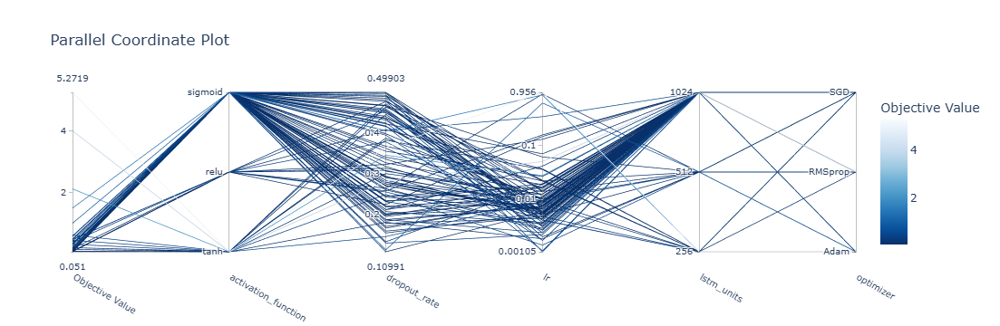

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

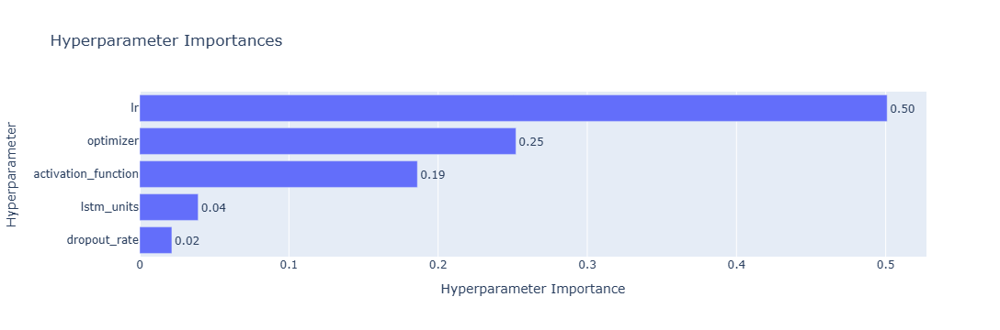

In [6]:
optuna.visualization.plot_param_importances(study)

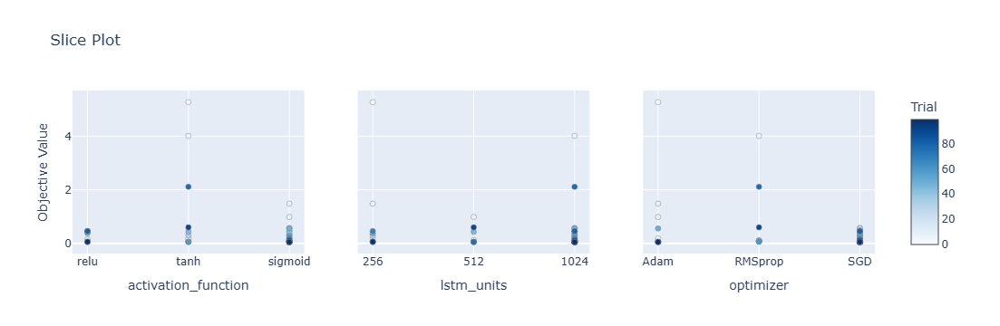

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

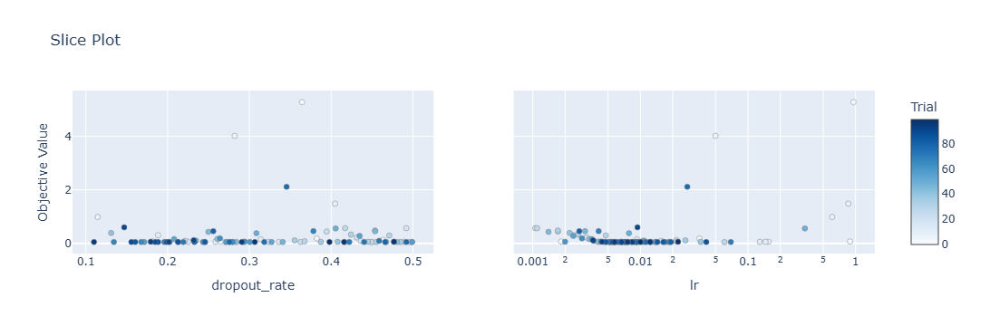

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 9s 53ms/step - loss: 0.5903 - accuracy: 0.0000e+00 - mae: 0.4908 - rmse: 0.5903 - mape: inf - pearson: 0.0042 - val_loss: 0.4305 - val_accuracy: 0.0000e+00 - val_mae: 0.3574 - val_rmse: 0.4305 - val_mape: 74.8363 - val_pearson: 0.0111
Epoch 2/100
84/84 [==============================] - 4s 45ms/step - loss: 0.2812 - accuracy: 0.0000e+00 - mae: 0.2332 - rmse: 0.2812 - mape: inf - pearson: 0.1387 - val_loss: 0.1351 - val_accuracy: 0.0000e+00 - val_mae: 0.1104 - val_rmse: 0.1351 - val_mape: 23.1154 - val_pearson: 0.5061
Epoch 3/100
84/84 [==============================] - 4s 44ms/step - loss: 0.0698 - accuracy: 0.5595 - mae: 0.0562 - rmse: 0.0698 - mape: inf - pearson: 0.7987 - val_loss: 0.0604 - val_accuracy: 0.4000 - val_mae: 0.0483 - val_rmse: 0.0604 - val_mape: 10.8442 - val_pearson: 0.8248
Epoch 4/100
84/84 [==============================] - 3s 41ms/step - loss: 0.0535 - accuracy: 0.5833 - mae: 0.0423 - rmse: 0.0535 - mape: inf - p

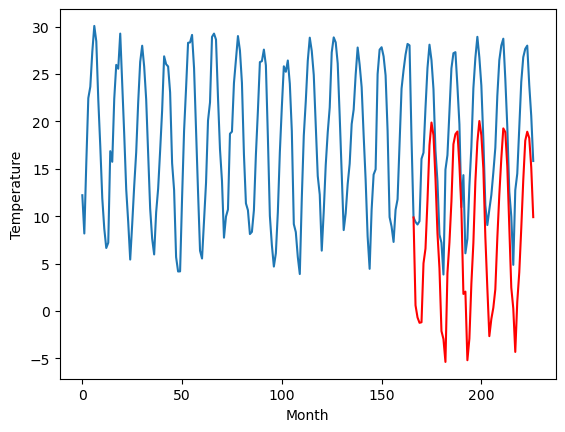

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.38		0.57
-1.85		-1.66		0.19
-2.23		-2.21		0.02
-1.48		-2.14		-0.66
4.35		4.08		-0.27
4.84		5.63		0.79
7.61		10.71		3.10
11.36		16.55		5.19
11.84		18.93		7.09
12.47		17.60		5.13
9.49		13.07		3.58
6.86		7.27		0.41
3.44		3.56		0.12
-3.77		-3.07		0.70
-3.11		-3.92		-0.81
-3.20		-6.33		-3.13
1.86		3.03		1.17
3.26		6.26		3.00
7.28		10.60		3.32
10.76		16.62		5.86
11.98		17.67		5.69
12.32		17.95		5.63
10.19		14.42		4.23
7.56		9.76		2.20
2.05		0.83		-1.22
1.81		1.07		-0.74
-4.87		-6.15		-1.28
-2.10		-3.87		-1.77
1.76		1.94		0.18
4.73		6.23		1.50
9.04		12.72		3.68
12.73		16.87		4.14
12.87		19.09		6.22
12.32		17.60		5.28
11.30		14.08		2.78
5.70		6.86		1.16
3.01		1.46		-1.55
-0.84		-3.61		-2.77
-0.05		-1.79		-1.74
1.05		-0.60		-1.65
2.64		1.36		-1.28
4.79		6.74		1.95
7.97		11.34		3.37
11.05		15.14		4.09
12.88		18.34		5.46
14.47		17.94		3.47
11.09		14.34		3.25
5.98		7.94		1.96
0.74		1.52		0.78
-

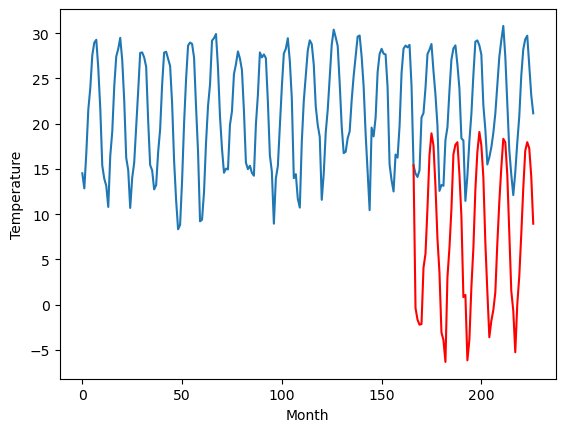

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.10		-1.76		1.34
-3.21		-3.04		0.17
-3.83		-3.60		0.23
-3.21		-3.52		-0.31
3.04		2.70		-0.34
2.80		4.25		1.45
6.49		9.33		2.84
10.21		15.16		4.95
12.58		17.55		4.97
11.82		16.22		4.40
8.43		11.68		3.25
4.71		5.89		1.18
-0.22		2.18		2.40
-7.22		-4.45		2.77
-6.40		-5.30		1.10
-5.54		-7.71		-2.17
0.44		1.64		1.20
2.08		4.87		2.79
6.06		9.21		3.15
10.20		15.23		5.03
11.96		16.28		4.32
12.24		16.57		4.33
8.67		13.03		4.36
4.79		8.38		3.59
-3.57		-0.55		3.02
-1.39		-0.30		1.09
-7.40		-7.53		-0.13
-3.45		-5.26		-1.81
0.05		0.55		0.50
2.79		4.86		2.07
8.55		11.34		2.79
12.33		15.50		3.17
13.25		17.70		4.45
12.02		16.22		4.20
8.90		12.69		3.79
1.76		5.48		3.72
-0.72		0.08		0.80
-5.24		-4.99		0.25
-3.29		-3.17		0.12
-0.51		-1.98		-1.47
-0.53		-0.02		0.51
2.54		5.37		2.83
5.95		9.96		4.01
9.27		13.77		4.50
12.37		16.96		4.59
11.98		16.56		4.58
8.53		12.96		4.43
2.55		6.57		4.02
-2.54		0.14		2.68
-5.57

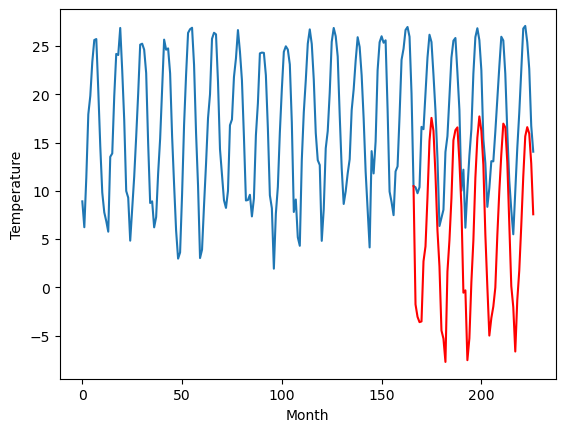

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.49		-2.96		-0.47
-2.51		-4.24		-1.73
-2.47		-4.79		-2.32
-2.47		-4.71		-2.24
4.45		1.51		-2.94
4.53		3.05		-1.48
7.42		8.13		0.71
10.33		13.97		3.64
11.30		16.36		5.06
11.64		15.03		3.39
9.31		10.50		1.19
5.25		4.70		-0.55
2.41		0.98		-1.43
-5.05		-5.65		-0.60
-4.96		-6.51		-1.55
-6.53		-8.93		-2.40
1.38		0.43		-0.95
3.17		3.65		0.48
7.14		7.99		0.85
10.42		14.01		3.59
11.05		15.06		4.01
11.10		15.34		4.24
8.59		11.79		3.20
6.28		7.14		0.86
-1.81		-1.78		0.03
0.96		-1.54		-2.50
-6.39		-8.76		-2.37
-3.95		-6.49		-2.54
-0.16		-0.69		-0.53
4.63		3.62		-1.01
9.15		10.11		0.96
11.58		14.25		2.67
11.56		16.46		4.90
10.37		14.98		4.61
9.13		11.46		2.33
3.51		4.25		0.74
-0.60		-1.15		-0.55
-2.78		-6.22		-3.44
-1.34		-4.40		-3.06
-0.93		-3.20		-2.27
2.59		-1.24		-3.83
4.01		4.13		0.12
8.44		8.72		0.28
12.19		12.52		0.33
13.31		15.72		2.41
14.84		15.32		0.48
11.40		11.72		0.32
5.15		5.32		0.17
-0.71

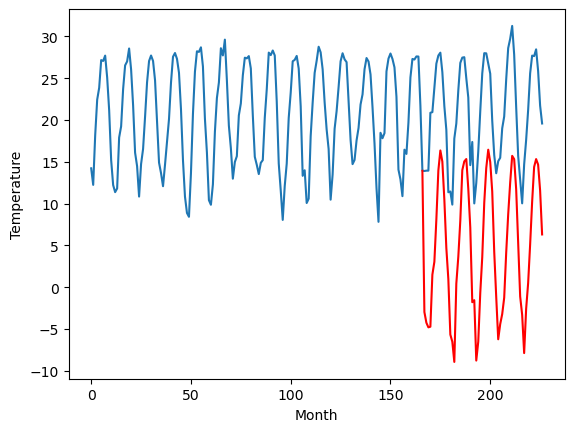

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.32		3.96		-1.36
3.27		2.68		-0.59
4.01		2.12		-1.89
3.34		2.20		-1.14
11.09		8.42		-2.67
11.34		9.97		-1.37
16.32		15.05		-1.27
20.52		20.88		0.36
22.13		23.27		1.14
22.62		21.93		-0.69
16.91		17.39		0.48
12.03		11.59		-0.44
9.51		7.88		-1.63
3.04		1.25		-1.79
2.16		0.40		-1.76
-0.93		-2.01		-1.08
8.97		7.35		-1.62
10.90		10.57		-0.33
14.76		14.91		0.15
19.96		20.94		0.98
20.39		22.00		1.61
21.15		22.28		1.13
19.14		18.73		-0.41
14.79		14.07		-0.72
7.22		5.14		-2.08
9.55		5.38		-4.17
1.10		-1.85		-2.95
0.87		0.42		-0.45
7.36		6.24		-1.12
13.40		10.54		-2.86
18.11		17.03		-1.08
22.45		21.18		-1.27
24.81		23.38		-1.43
22.45		21.90		-0.55
19.50		18.38		-1.12
13.58		11.16		-2.42
6.65		5.76		-0.89
3.92		0.70		-3.22
4.89		2.52		-2.37
5.02		3.71		-1.31
9.74		5.66		-4.08
11.24		11.04		-0.20
16.77		15.62		-1.15
21.32		19.43		-1.89
24.31		22.62		-1.69
26.05		22.24		-3.81
21.57		18.64		-2.93
13.91		12

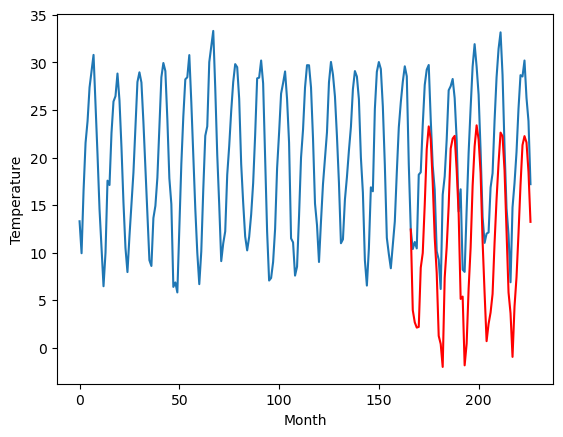

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.85		6.27		0.42
5.28		4.99		-0.29
4.75		4.44		-0.31
4.44		4.52		0.08
8.03		10.74		2.71
10.00		12.29		2.29
13.69		17.36		3.67
18.04		23.20		5.16
21.78		25.59		3.81
20.93		24.26		3.33
17.90		19.72		1.82
13.81		13.92		0.11
9.69		10.21		0.52
2.94		3.58		0.64
1.16		2.72		1.56
1.81		0.30		-1.51
6.71		9.66		2.95
10.08		12.87		2.79
13.59		17.21		3.62
18.16		23.23		5.07
20.15		24.27		4.12
20.63		24.56		3.93
17.62		21.02		3.40
14.02		16.36		2.34
5.85		7.44		1.59
6.90		7.69		0.79
0.52		0.46		-0.06
4.13		2.73		-1.40
8.05		8.54		0.49
10.92		12.84		1.92
15.55		19.33		3.78
19.12		23.48		4.36
21.26		25.70		4.44
20.41		24.22		3.81
17.76		20.70		2.94
11.20		13.48		2.28
9.51		8.08		-1.43
2.99		3.01		0.02
4.68		4.83		0.15
6.17		6.02		-0.15
7.08		7.98		0.90
11.76		13.37		1.61
13.28		17.96		4.68
17.10		21.77		4.67
20.93		24.96		4.03
20.45		24.57		4.12
16.93		20.97		4.04
12.58		14.58		2.00
7.14		8.16		1.02
5.00		5

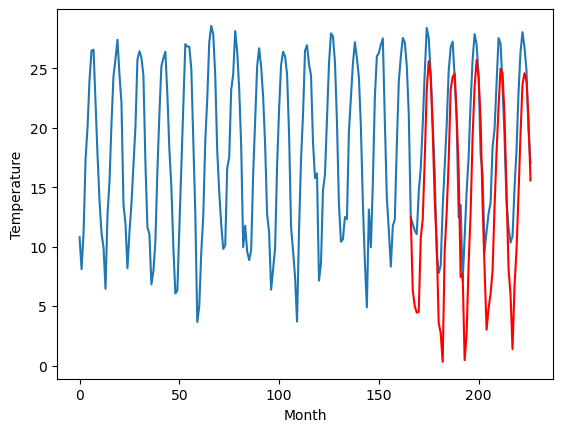

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.20		0.66		1.86
-1.56		-0.62		0.94
-2.03		-1.17		0.86
-0.92		-1.10		-0.18
4.50		5.12		0.62
5.74		6.67		0.93
8.08		11.75		3.67
13.33		17.59		4.26
16.40		19.97		3.57
15.37		18.64		3.27
11.48		14.11		2.63
7.48		8.31		0.83
3.30		4.59		1.29
-3.63		-2.04		1.59
-4.21		-2.90		1.31
-3.57		-5.32		-1.75
3.41		4.04		0.63
4.44		7.25		2.81
8.15		11.58		3.43
12.48		17.60		5.12
14.10		18.65		4.55
14.04		18.94		4.90
9.99		15.41		5.42
6.76		10.76		4.00
-1.89		1.83		3.72
0.05		2.08		2.03
-6.60		-5.15		1.45
-2.62		-2.87		-0.25
1.72		2.93		1.21
4.64		7.23		2.59
9.71		13.73		4.02
13.62		17.88		4.26
14.72		20.10		5.38
13.43		18.61		5.18
10.37		15.08		4.71
3.43		7.87		4.44
1.20		2.47		1.27
-5.31		-2.60		2.71
-2.12		-0.79		1.33
0.88		0.41		-0.47
1.36		2.38		1.02
4.92		7.76		2.84
7.61		12.37		4.76
10.96		16.18		5.22
14.67		19.37		4.70
13.98		18.97		4.99
10.47		15.38		4.91
5.26		8.99		3.73
-0.61		2.57		3.18
-2.90		0.

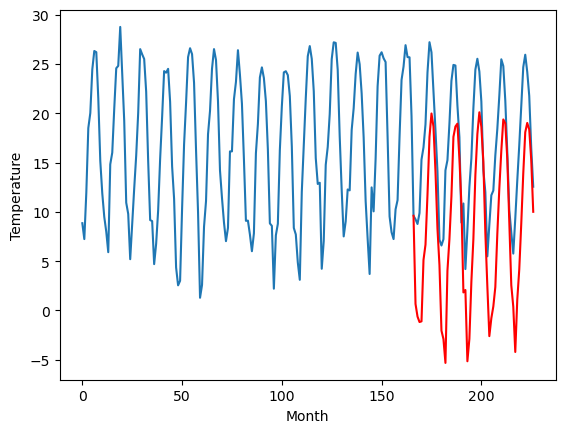

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.01		5.98		1.97
3.64		4.71		1.07
3.52		4.15		0.63
4.56		4.22		-0.34
10.14		10.45		0.31
11.04		12.00		0.96
14.16		17.08		2.92
19.68		22.92		3.24
22.94		25.30		2.36
21.57		23.97		2.40
16.70		19.44		2.74
12.86		13.64		0.78
8.63		9.92		1.29
1.70		3.29		1.59
0.76		2.43		1.67
1.38		0.01		-1.37
7.90		9.37		1.47
11.53		12.58		1.05
14.55		16.91		2.36
19.34		22.93		3.59
21.46		23.99		2.53
21.41		24.28		2.87
16.90		20.75		3.85
13.05		16.10		3.05
3.55		7.17		3.62
5.61		7.42		1.81
-1.57		0.19		1.76
2.67		2.47		-0.20
7.51		8.27		0.76
10.83		12.57		1.74
15.81		19.07		3.26
19.81		23.22		3.41
21.68		25.44		3.76
20.00		23.96		3.96
16.30		20.43		4.13
9.11		13.21		4.10
6.91		7.82		0.91
-0.26		2.75		3.01
2.91		4.56		1.65
5.88		5.77		-0.11
6.56		7.73		1.17
11.18		13.12		1.94
13.47		17.72		4.25
17.22		21.53		4.31
21.36		24.73		3.37
20.22		24.33		4.11
16.46		20.74		4.28
11.07		14.35		3.28
4.62		7.93		3.31
3.03		5.7

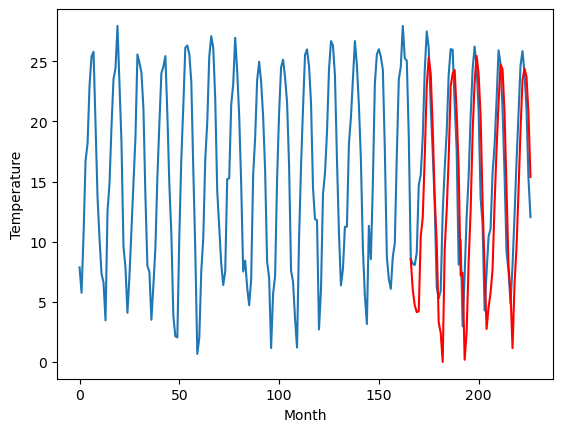

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.48		5.05		0.57
4.32		3.77		-0.55
3.13		3.21		0.08
3.63		3.28		-0.35
10.20		9.51		-0.69
12.48		11.06		-1.42
17.36		16.15		-1.21
23.29		21.98		-1.31
26.03		24.36		-1.67
23.02		23.02		0.00
19.46		18.48		-0.98
12.20		12.68		0.48
9.34		8.97		-0.37
2.63		2.34		-0.29
1.84		1.48		-0.36
-2.43		-0.94		1.49
10.04		8.43		-1.61
12.64		11.65		-0.99
17.33		15.98		-1.35
23.52		22.01		-1.51
24.09		23.06		-1.03
24.03		23.34		-0.69
20.29		19.80		-0.49
16.33		15.14		-1.19
6.29		6.21		-0.08
8.09		6.45		-1.64
-0.42		-0.79		-0.37
1.62		1.49		-0.13
8.84		7.30		-1.54
12.79		11.60		-1.19
19.63		18.08		-1.55
24.15		22.24		-1.91
26.48		24.46		-2.02
23.60		22.98		-0.62
19.96		19.44		-0.52
13.40		12.23		-1.17
7.43		6.83		-0.60
2.14		1.77		-0.37
4.70		3.59		-1.11
6.31		4.79		-1.52
8.13		6.75		-1.38
13.91		12.13		-1.78
19.50		16.74		-2.76
23.37		20.55		-2.82
24.86		23.74		-1.12
23.60		23.34		-0.26
20.43		19.74		-0.69
14.8

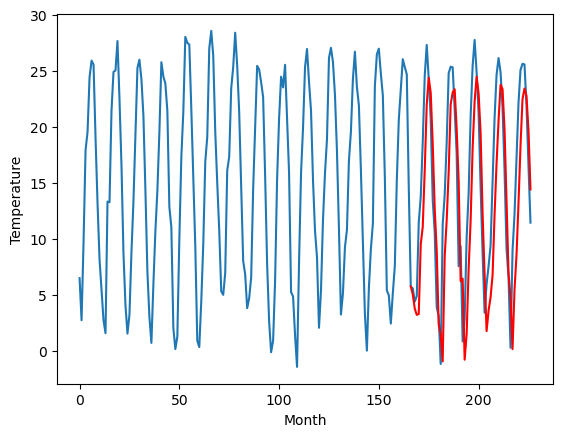

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.26		2.54		2.80
-0.08		1.27		1.35
-1.36		0.70		2.06
-2.23		0.77		3.00
4.96		7.00		2.04
6.62		8.55		1.93
11.71		13.64		1.93
18.69		19.46		0.77
21.32		21.84		0.52
18.94		20.51		1.57
15.27		15.96		0.69
8.88		10.17		1.29
5.20		6.45		1.25
-2.31		-0.19		2.12
-3.90		-1.05		2.85
-6.07		-3.46		2.61
4.68		5.90		1.22
7.74		9.11		1.37
12.21		13.44		1.23
18.69		19.46		0.77
19.70		20.51		0.81
20.30		20.79		0.49
16.44		17.26		0.82
11.97		12.59		0.62
1.31		3.66		2.35
2.54		3.89		1.35
-6.43		-3.34		3.09
-2.85		-1.06		1.79
4.13		4.76		0.63
6.86		9.04		2.18
15.03		15.53		0.50
18.93		19.69		0.76
20.96		21.91		0.95
19.05		20.43		1.38
15.32		16.90		1.58
8.28		9.68		1.40
3.26		4.28		1.02
-2.45		-0.78		1.67
-0.56		1.04		1.60
1.48		2.24		0.76
1.82		4.19		2.37
8.10		9.59		1.49
13.06		14.19		1.13
16.90		18.01		1.11
19.73		21.19		1.46
18.93		20.79		1.86
16.32		17.19		0.87
9.74		10.79		1.05
3.24		4.37		1.13
0.81		2.18

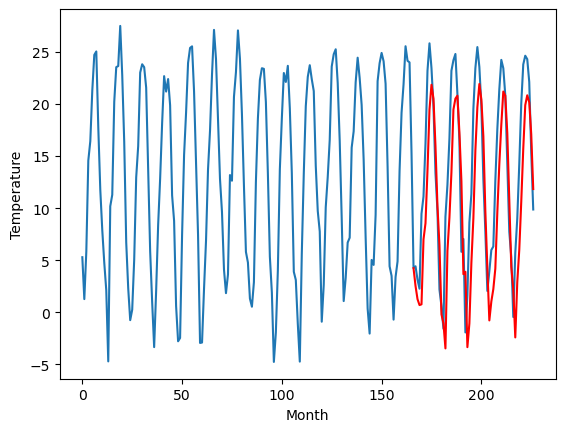

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.50		0.60		2.10
-2.17		-0.67		1.50
-3.20		-1.24		1.96
-4.66		-1.16		3.50
1.48		5.07		3.59
4.13		6.62		2.49
10.56		11.70		1.14
18.52		17.54		-0.98
21.68		19.92		-1.76
18.99		18.59		-0.40
14.16		14.04		-0.12
7.41		8.23		0.82
3.93		4.51		0.58
-3.10		-2.13		0.97
-4.71		-2.99		1.72
-9.02		-5.40		3.62
2.71		3.96		1.25
6.68		7.17		0.49
11.83		11.50		-0.33
19.14		17.52		-1.62
19.73		18.57		-1.16
20.44		18.84		-1.60
16.39		15.30		-1.09
12.04		10.64		-1.40
1.18		1.70		0.52
0.28		1.94		1.66
-8.67		-5.30		3.37
-5.43		-3.01		2.42
1.48		2.80		1.32
5.09		7.08		1.99
14.41		13.58		-0.83
19.17		17.73		-1.44
20.28		19.96		-0.32
19.16		18.47		-0.69
15.32		14.95		-0.37
8.08		7.73		-0.35
3.05		2.33		-0.72
-3.13		-2.73		0.40
-2.00		-0.91		1.09
-1.59		0.28		1.87
0.27		2.23		1.96
7.12		7.63		0.51
12.14		12.23		0.09
17.65		16.04		-1.61
20.11		19.23		-0.88
18.30		18.82		0.52
15.92		15.23		-0.69
9.96		8.82		-1.14
2.3

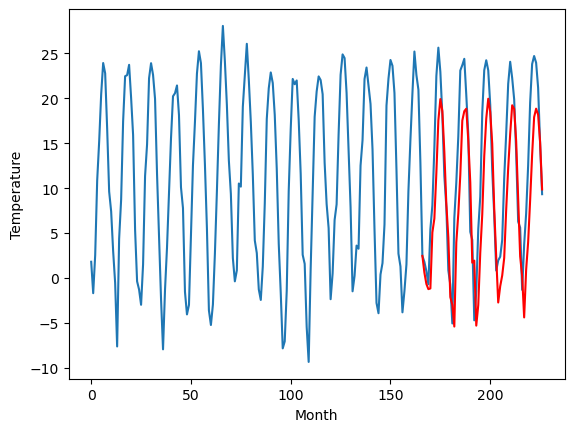

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[0.590810394287109, -0.38075435638427724, -1.7587487792968748, -2.9601649856567382, 3.9591989135742196, 6.274065513610839, 0.6620761489868165, 5.980729560852051, 5.04985694885254, 2.538499870300292, 0.6005292892456051]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   0.590810
1                 1   -0.95  -0.380754
2                 2   -3.10  -1.758749
3                 3   -2.49  -2.960165
4                 4    5.32   3.959199
5                 5    5.85   6.274066
6                 6   -1.20   0.662076
7                 7    4.01   5.980730
8                 8    4.48   5.049857
9                 9   -0.26   2.538500
10               10   -1.50   0.600529


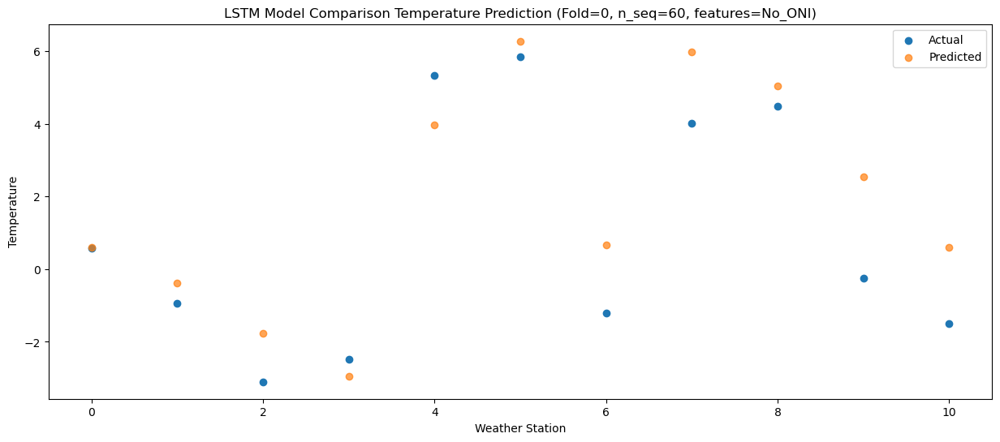

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11  -0.687686
1                 1   -1.85  -1.657451
2                 2   -3.21  -3.039593
3                 3   -2.51  -4.240559
4                 4    3.27   2.675768
5                 5    5.28   4.993603
6                 6   -1.56  -0.615849
7                 7    3.64   4.706704
8                 8    4.32   3.774349
9                 9   -0.08   1.266739
10               10   -2.17  -0.666269


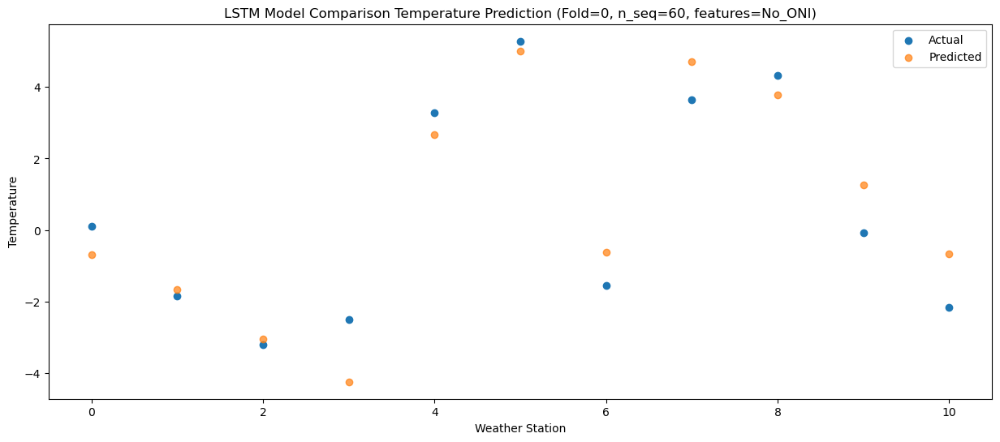

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -1.258195
1                 1   -2.23  -2.214072
2                 2   -3.83  -3.595119
3                 3   -2.47  -4.788564
4                 4    4.01   2.123052
5                 5    4.75   4.441199
6                 6   -2.03  -1.172270
7                 7    3.52   4.148558
8                 8    3.13   3.213290
9                 9   -1.36   0.696303
10               10   -3.20  -1.238459


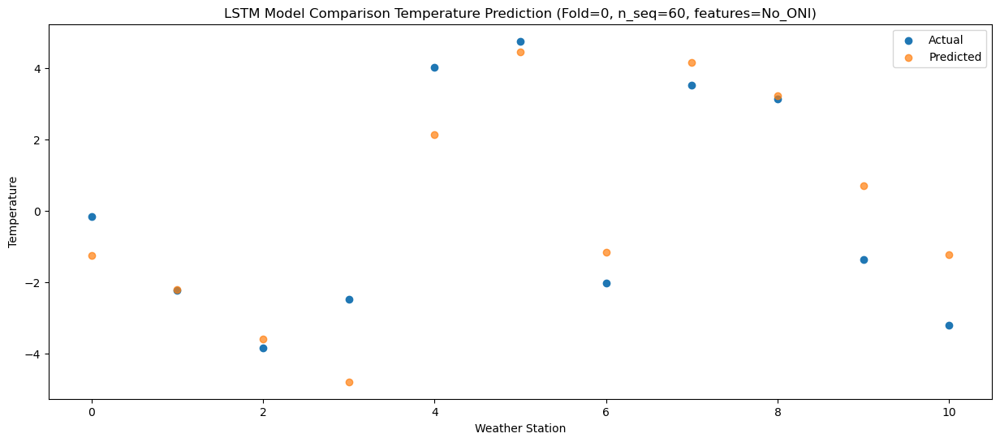

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -1.200266
1                 1   -1.48  -2.144196
2                 2   -3.21  -3.521863
3                 3   -2.47  -4.714540
4                 4    3.34   2.195685
5                 5    4.44   4.515915
6                 6   -0.92  -1.101573
7                 7    4.56   4.221401
8                 8    3.63   3.283160
9                 9   -2.23   0.768505
10               10   -4.66  -1.161121


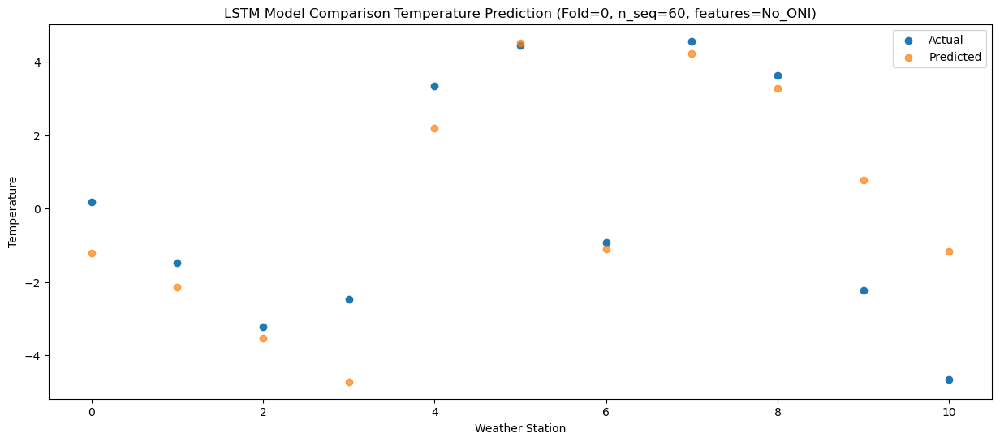

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   5.023051
1                 1    4.35   4.084875
2                 2    3.04   2.702521
3                 3    4.45   1.507648
4                 4   11.09   8.418328
5                 5    8.03  10.740483
6                 6    4.50   5.124746
7                 7   10.14  10.447635
8                 8   10.20   9.512497
9                 9    4.96   7.001745
10               10    1.48   5.070733


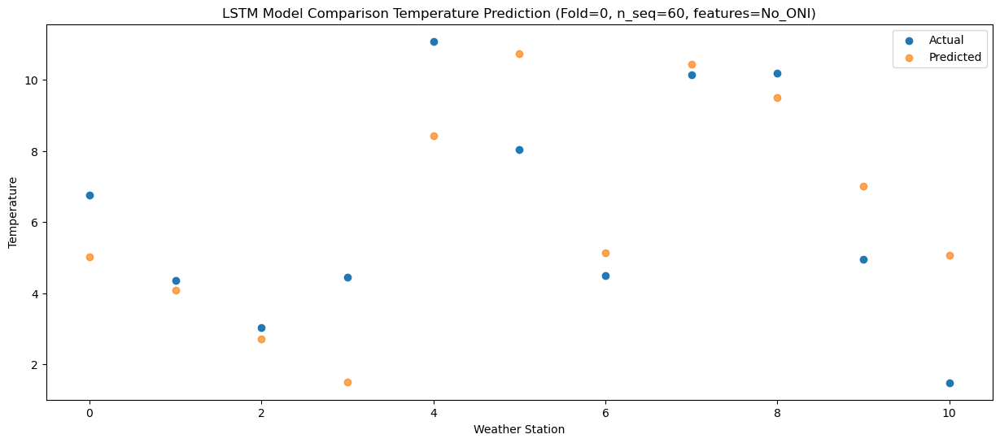

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   6.577129
1                 1    4.84   5.625581
2                 2    2.80   4.246225
3                 3    4.53   3.050159
4                 4   11.34   9.965001
5                 5   10.00  12.285608
6                 6    5.74   6.674768
7                 7   11.04  11.998420
8                 8   12.48  11.062707
9                 9    6.62   8.550205
10               10    4.13   6.617408


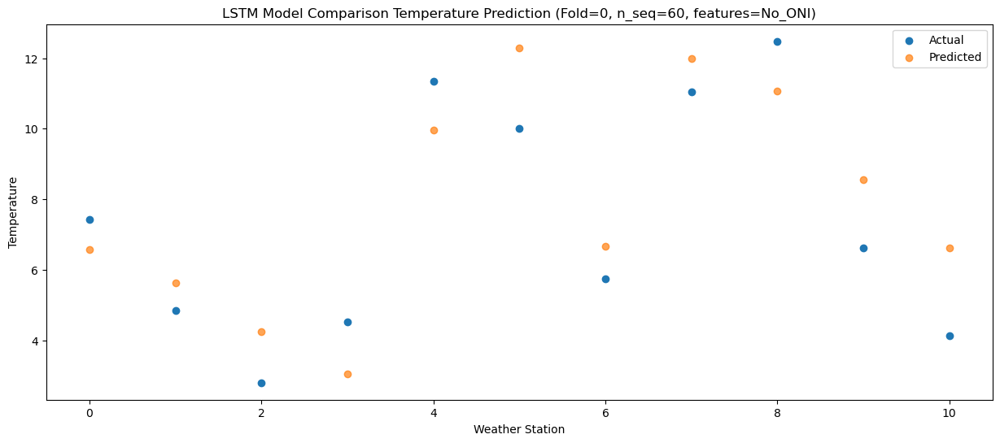

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  11.663091
1                 1    7.61  10.711131
2                 2    6.49   9.326644
3                 3    7.42   8.132000
4                 4   16.32  15.045582
5                 5   13.69  17.358482
6                 6    8.08  11.750625
7                 7   14.16  17.077513
8                 8   17.36  16.149454
9                 9   11.71  13.635358
10               10   10.56  11.702765


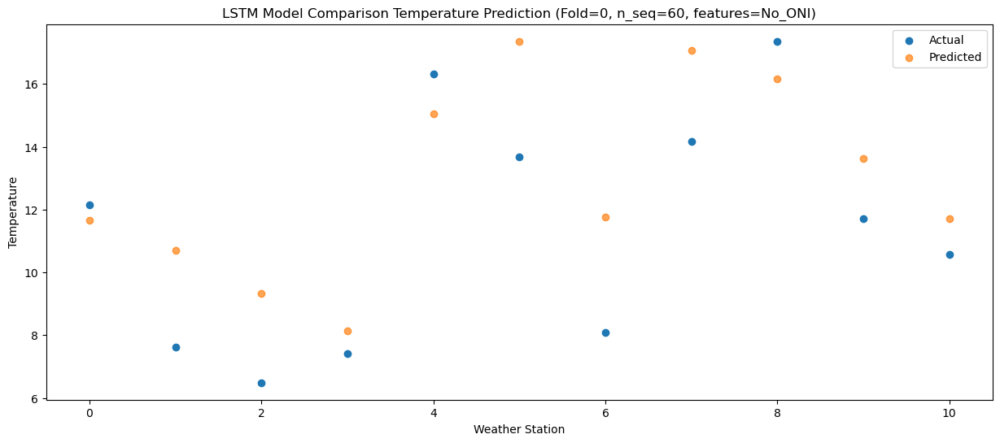

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  17.494214
1                 1   11.36  16.545865
2                 2   10.21  15.163708
3                 3   10.33  13.974863
4                 4   20.52  20.881630
5                 5   18.04  23.202928
6                 6   13.33  17.593156
7                 7   19.68  22.920089
8                 8   23.29  21.977357
9                 9   18.69  19.461490
10               10   18.52  17.535204


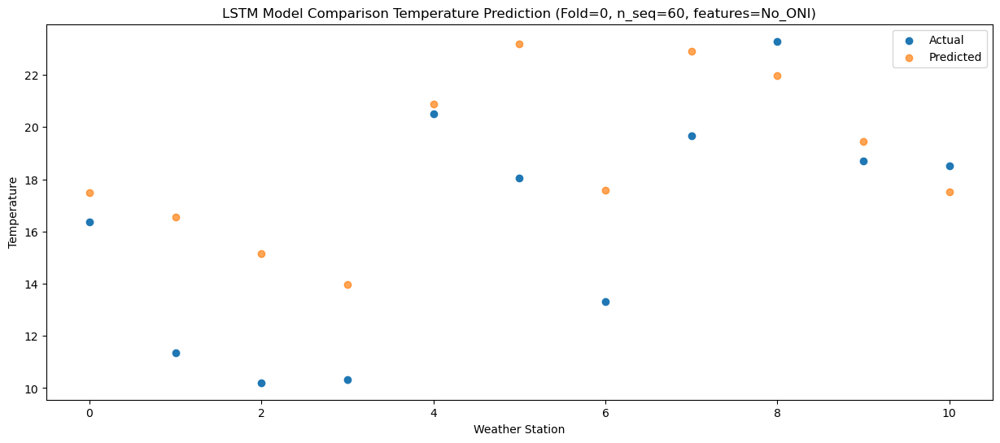

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  19.882061
1                 1   11.84  18.934895
2                 2   12.58  17.549448
3                 3   11.30  16.364352
4                 4   22.13  23.271615
5                 5   21.78  25.587402
6                 6   16.40  19.972731
7                 7   22.94  25.298805
8                 8   26.03  24.359976
9                 9   21.32  21.842211
10               10   21.68  19.917589


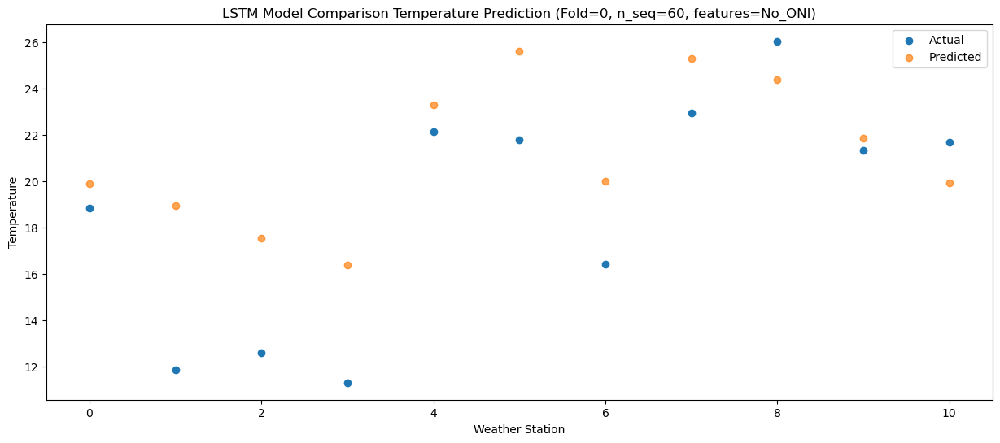

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  18.553150
1                 1   12.47  17.604509
2                 2   11.82  16.215473
3                 3   11.64  15.030560
4                 4   22.62  21.934958
5                 5   20.93  24.260033
6                 6   15.37  18.644889
7                 7   21.57  23.971460
8                 8   23.02  23.024816
9                 9   18.94  20.509500
10               10   18.99  18.585412


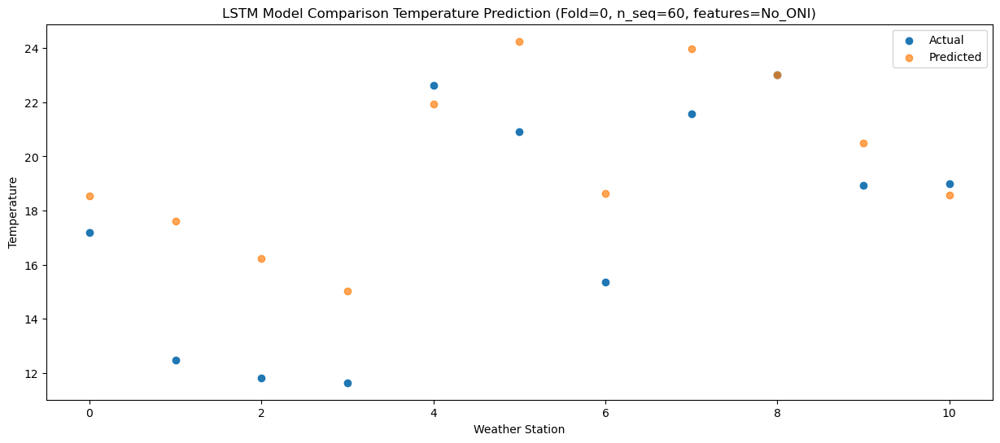

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  14.007312
1                 1    9.49  13.067674
2                 2    8.43  11.681668
3                 3    9.31  10.495136
4                 4   16.91  17.387320
5                 5   17.90  19.720651
6                 6   11.48  14.109352
7                 7   16.70  19.440103
8                 8   19.46  18.480359
9                 9   15.27  15.964338
10               10   14.16  14.038273


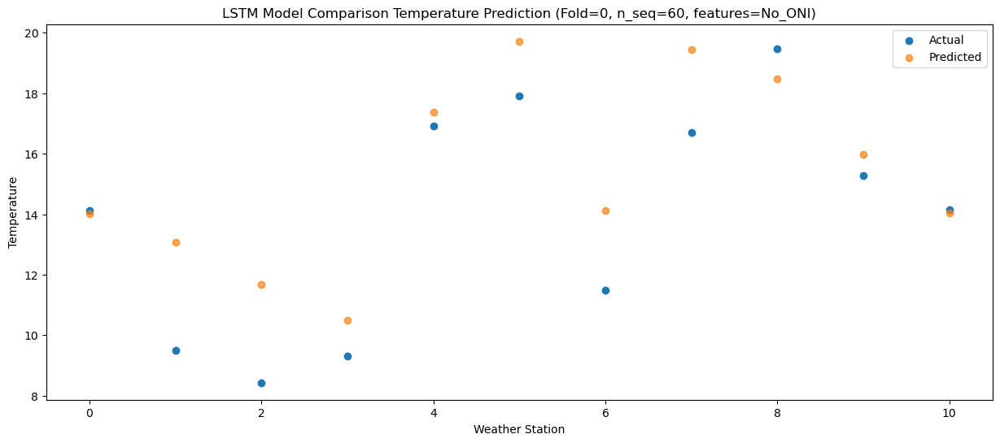

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   8.208325
1                 1    6.86   7.273438
2                 2    4.71   5.885852
3                 3    5.25   4.695223
4                 4   12.03  11.592229
5                 5   13.81  13.923497
6                 6    7.48   8.306798
7                 7   12.86  13.638010
8                 8   12.20  12.684101
9                 9    8.88  10.166504
10               10    7.41   8.234286


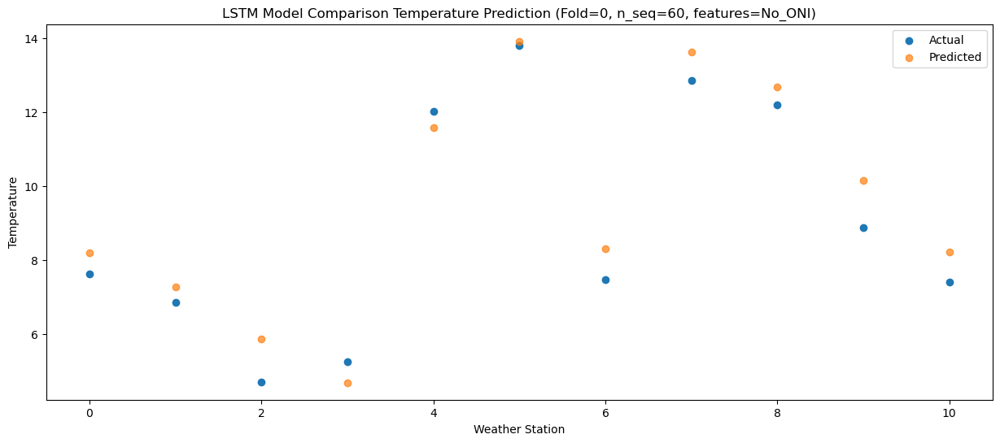

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   4.491268
1                 1    3.44   3.559494
2                 2   -0.22   2.177915
3                 3    2.41   0.980146
4                 4    9.51   7.881219
5                 5    9.69  10.209592
6                 6    3.30   4.594196
7                 7    8.63   9.924145
8                 8    9.34   8.970074
9                 9    5.20   6.451452
10               10    3.93   4.509363


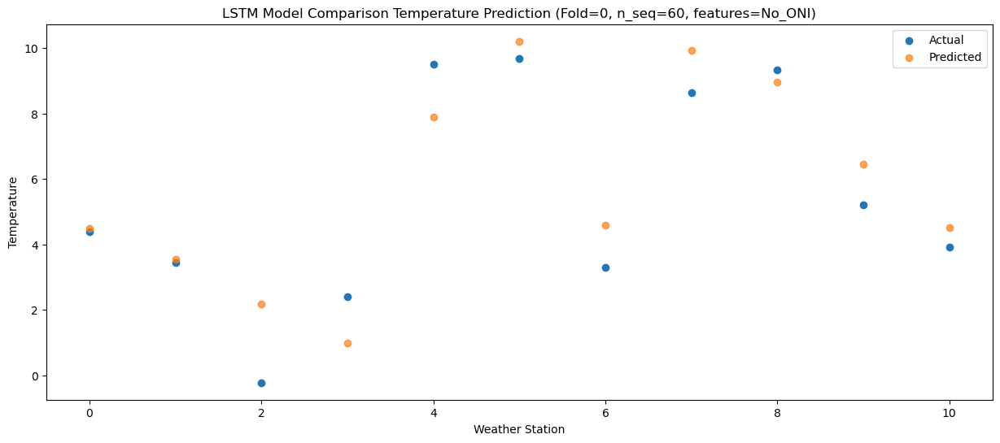

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -2.126409
1                 1   -3.77  -3.070330
2                 2   -7.22  -4.453110
3                 3   -5.05  -5.654491
4                 4    3.04   1.250495
5                 5    2.94   3.577755
6                 6   -3.63  -2.038834
7                 7    1.70   3.291681
8                 8    2.63   2.339140
9                 9   -2.31  -0.190941
10               10   -3.10  -2.129191


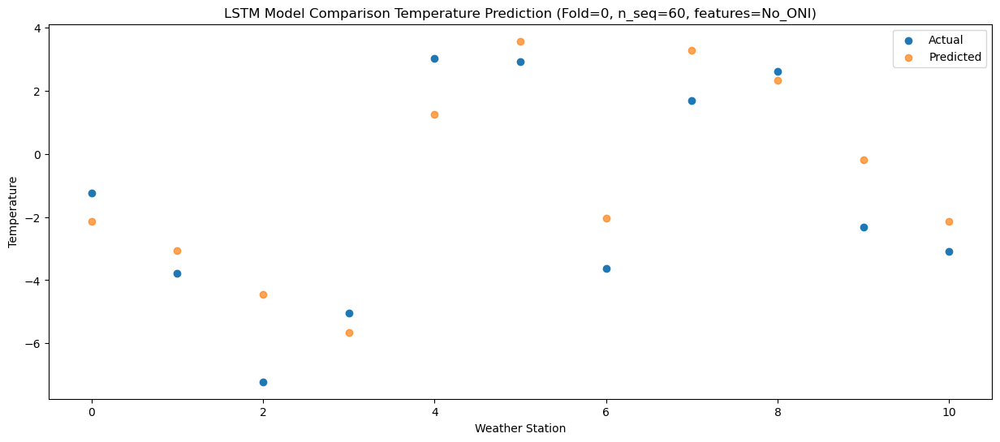

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -2.971892
1                 1   -3.11  -3.916068
2                 2   -6.40  -5.302700
3                 3   -4.96  -6.513409
4                 4    2.16   0.401424
5                 5    1.16   2.723875
6                 6   -4.21  -2.900164
7                 7    0.76   2.427411
8                 8    1.84   1.480980
9                 9   -3.90  -1.048266
10               10   -4.71  -2.987092


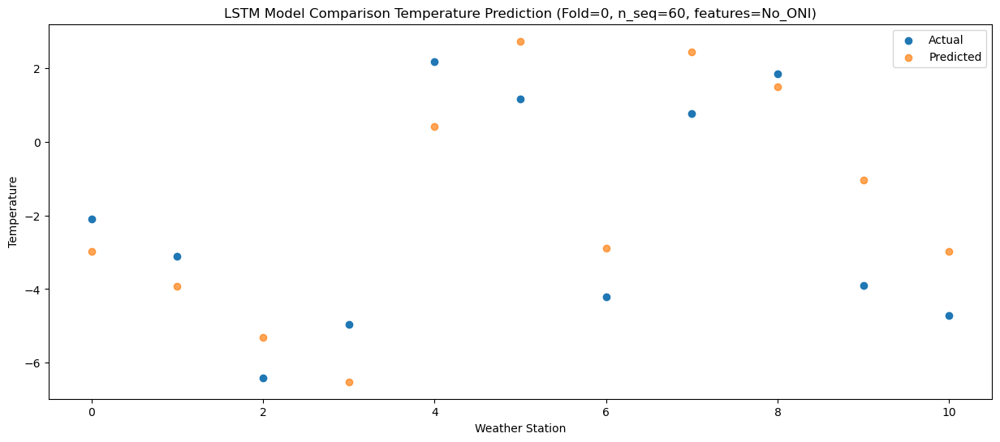

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -5.386031
1                 1   -3.20  -6.329631
2                 2   -5.54  -7.713244
3                 3   -6.53  -8.925072
4                 4   -0.93  -2.010962
5                 5    1.81   0.304987
6                 6   -3.57  -5.316485
7                 7    1.38   0.012103
8                 8   -2.43  -0.936694
9                 9   -6.07  -3.462531
10               10   -9.02  -5.403194


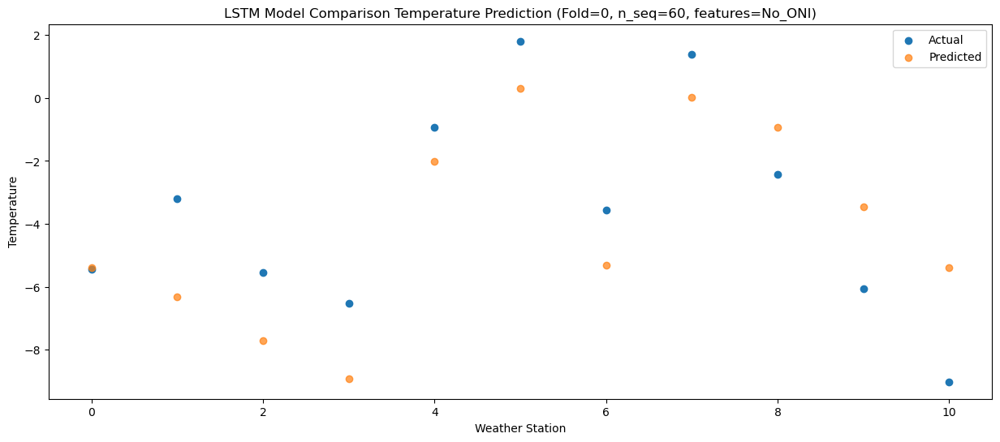

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   3.987233
1                 1    1.86   3.030436
2                 2    0.44   1.644866
3                 3    1.38   0.433326
4                 4    8.97   7.354770
5                 5    6.71   9.658902
6                 6    3.41   4.036303
7                 7    7.90   9.366996
8                 8   10.04   8.429437
9                 9    4.68   5.904012
10               10    2.71   3.964807


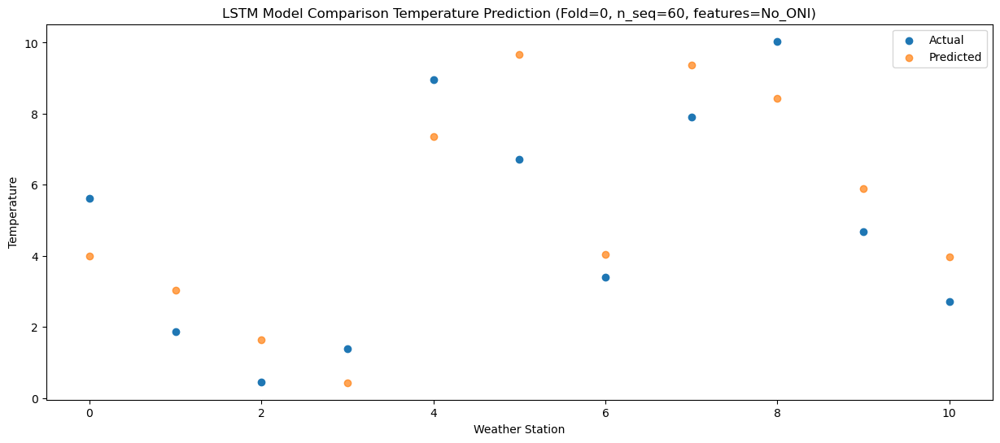

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   7.217513
1                 1    3.26   6.257365
2                 2    2.08   4.868063
3                 3    3.17   3.654847
4                 4   10.90  10.574935
5                 5   10.08  12.873996
6                 6    4.44   7.251496
7                 7   11.53  12.579901
8                 8   12.64  11.646061
9                 9    7.74   9.113046
10               10    6.68   7.174421


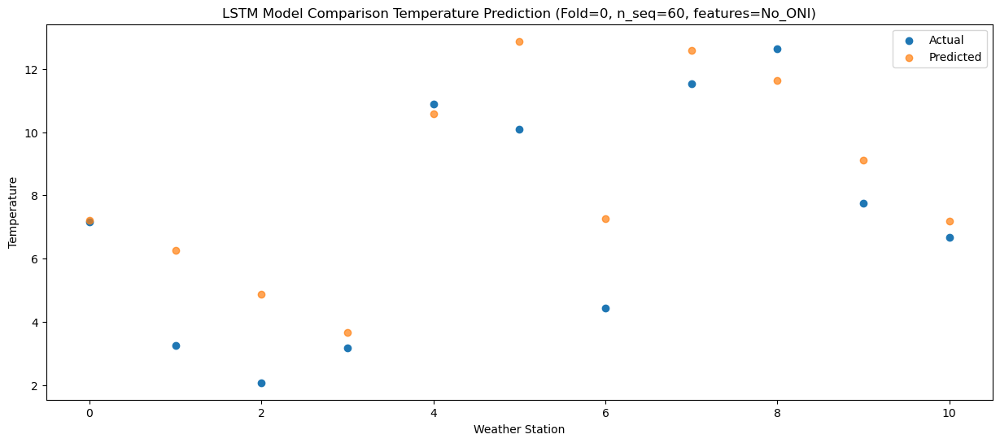

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  11.564233
1                 1    7.28  10.595813
2                 2    6.06   9.209852
3                 3    7.14   7.985032
4                 4   14.76  14.909460
5                 5   13.59  17.205614
6                 6    8.15  11.581697
7                 7   14.55  16.914022
8                 8   17.33  15.978749
9                 9   12.21  13.440794
10               10   11.83  11.498468


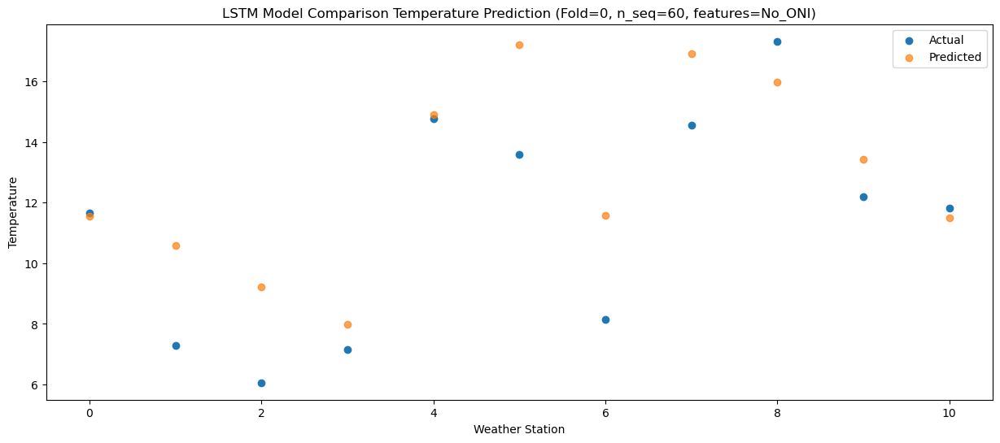

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  17.596562
1                 1   10.76  16.623050
2                 2   10.20  15.232396
3                 3   10.42  14.010276
4                 4   19.96  20.941160
5                 5   18.16  23.225517
6                 6   12.48  17.602224
7                 7   19.34  22.933413
8                 8   23.52  22.005477
9                 9   18.69  19.464305
10               10   19.14  17.519444


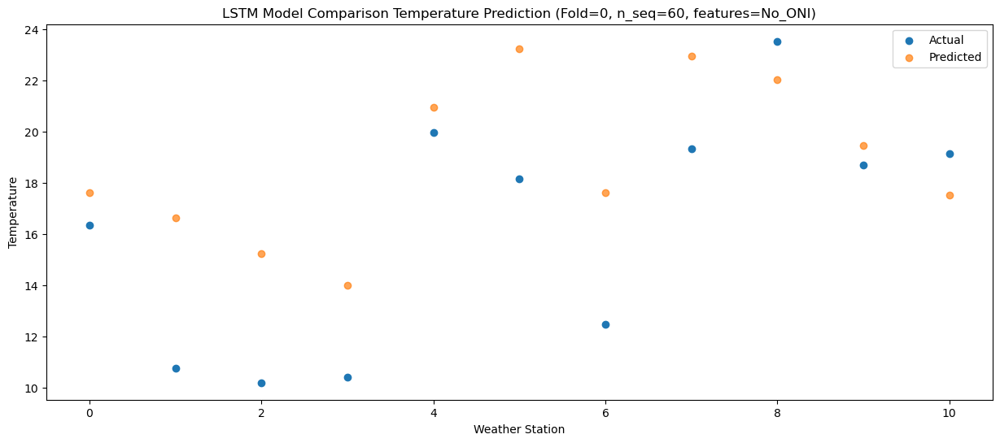

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  18.654969
1                 1   11.98  17.674100
2                 2   11.96  16.283423
3                 3   11.05  15.060127
4                 4   20.39  21.995677
5                 5   20.15  24.272219
6                 6   14.10  18.654459
7                 7   21.46  23.986596
8                 8   24.09  23.055885
9                 9   19.70  20.512241
10               10   19.73  18.567444


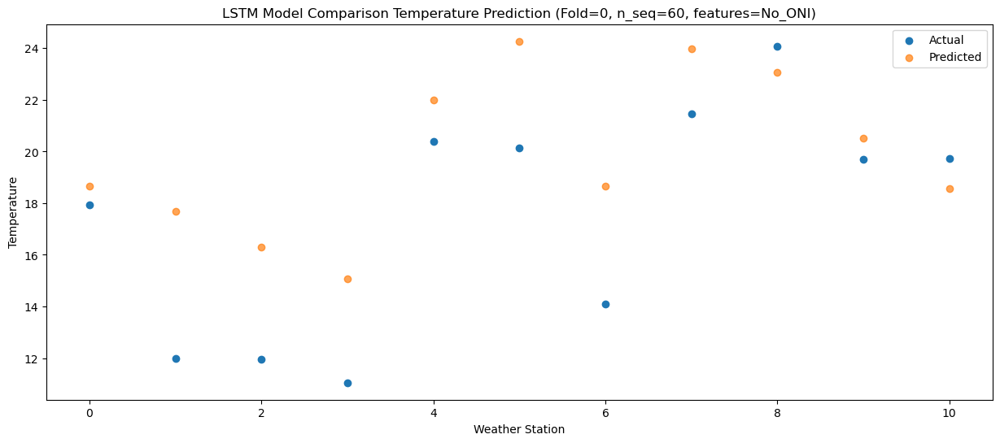

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  18.934781
1                 1   12.32  17.954371
2                 2   12.24  16.567033
3                 3   11.10  15.337926
4                 4   21.15  22.277406
5                 5   20.63  24.555762
6                 6   14.04  18.942353
7                 7   21.41  24.275543
8                 8   24.03  23.339568
9                 9   20.30  20.792985
10               10   20.44  18.844277


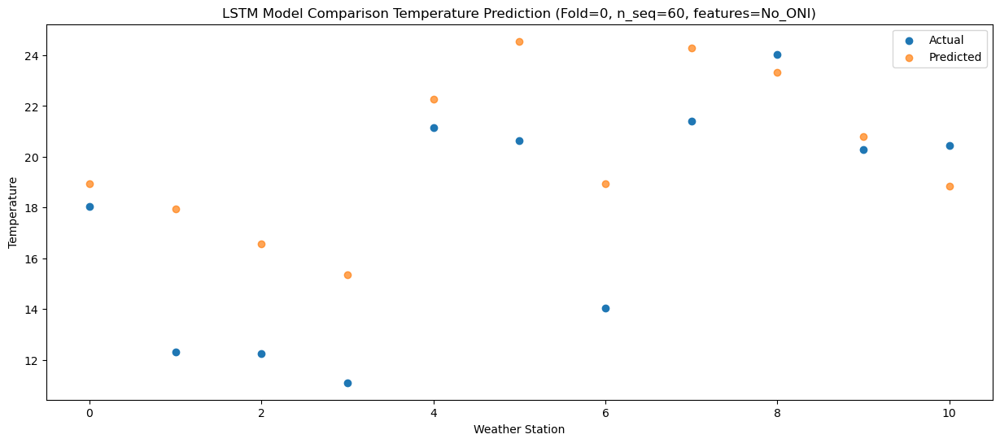

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  15.391027
1                 1   10.19  14.418088
2                 2    8.67  13.030243
3                 3    8.59  11.793348
4                 4   19.14  18.733477
5                 5   17.62  21.020377
6                 6    9.99  15.409383
7                 7   16.90  20.748813
8                 8   20.29  19.801682
9                 9   16.44  17.256668
10               10   16.39  15.302752


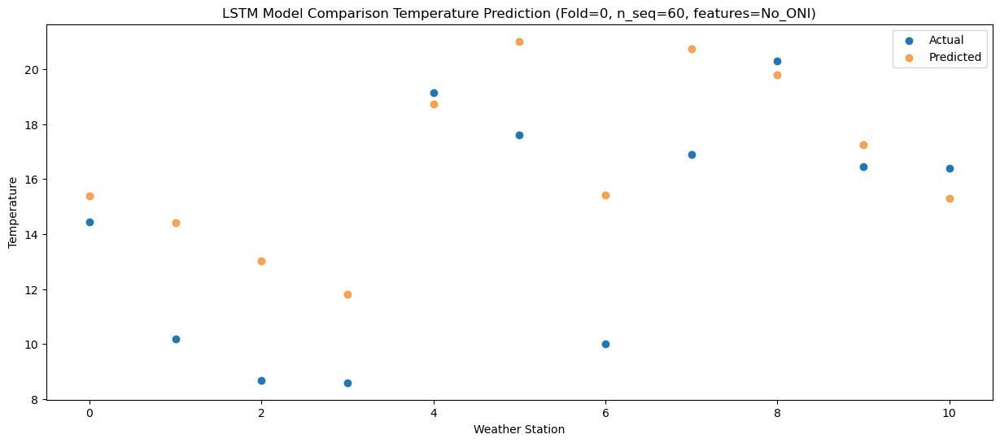

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43  10.724697
1                 1    7.56   9.762250
2                 2    4.79   8.378156
3                 3    6.28   7.144185
4                 4   14.79  14.073450
5                 5   14.02  16.363286
6                 6    6.76  10.755468
7                 7   13.05  16.096292
8                 8   16.33  15.137594
9                 9   11.97  12.590613
10               10   12.04  10.640070


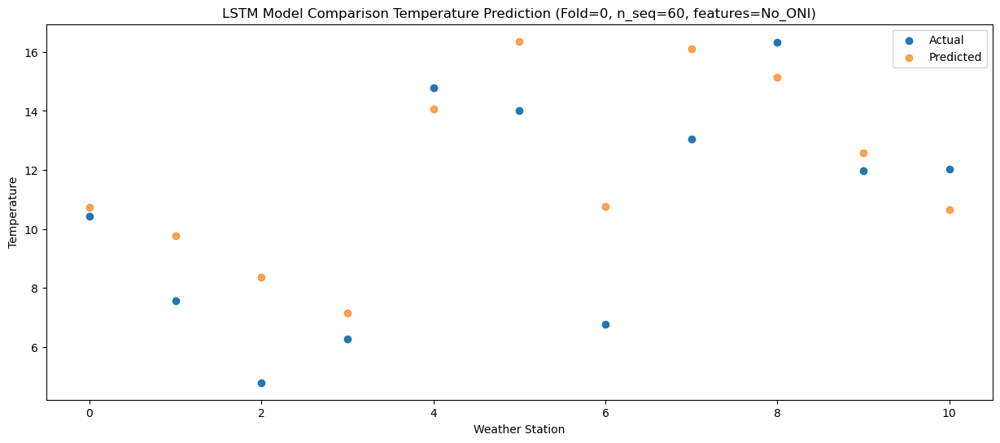

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   1.789168
1                 1    2.05   0.833535
2                 2   -3.57  -0.547225
3                 3   -1.81  -1.784117
4                 4    7.22   5.138126
5                 5    5.85   7.438862
6                 6   -1.89   1.829308
7                 7    3.55   7.170596
8                 8    6.29   6.208180
9                 9    1.31   3.658950
10               10    1.18   1.704954


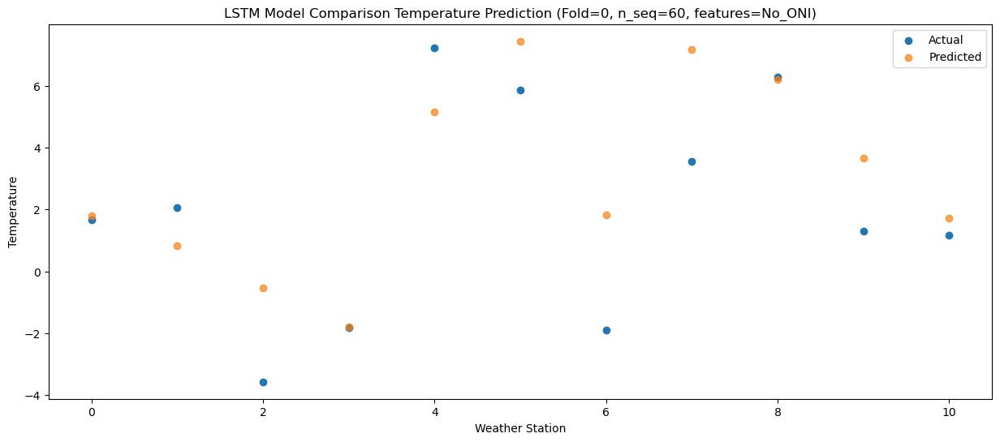

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    5.05   2.035118
1                 1    1.81   1.074268
2                 2   -1.39  -0.304685
3                 3    0.96  -1.541138
4                 4    9.55   5.383747
5                 5    6.90   7.685073
6                 6    0.05   2.075655
7                 7    5.61   7.416542
8                 8    8.09   6.448053
9                 9    2.54   3.892666
10               10    0.28   1.936906


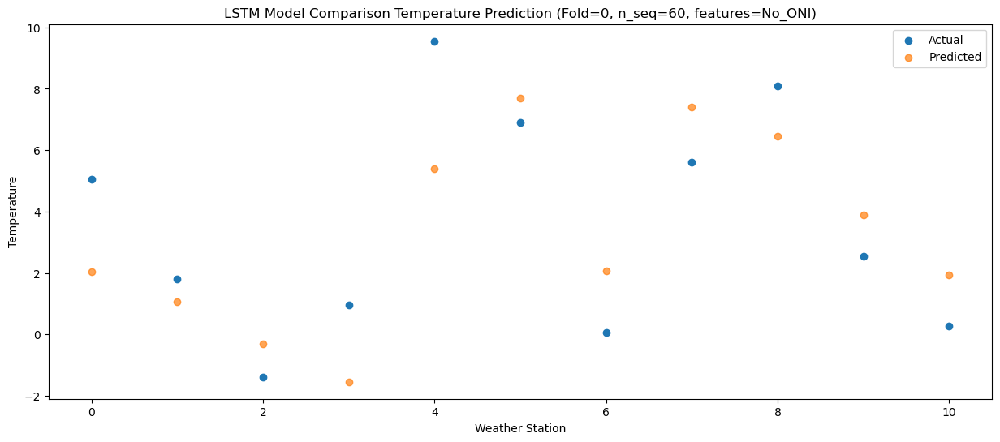

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -5.206406
1                 1   -4.87  -6.152273
2                 2   -7.40  -7.532632
3                 3   -6.39  -8.761786
4                 4    1.10  -1.845459
5                 5    0.52   0.455472
6                 6   -6.60  -5.148229
7                 7   -1.57   0.190224
8                 8   -0.42  -0.785474
9                 9   -6.43  -3.343175
10               10   -8.67  -5.299250


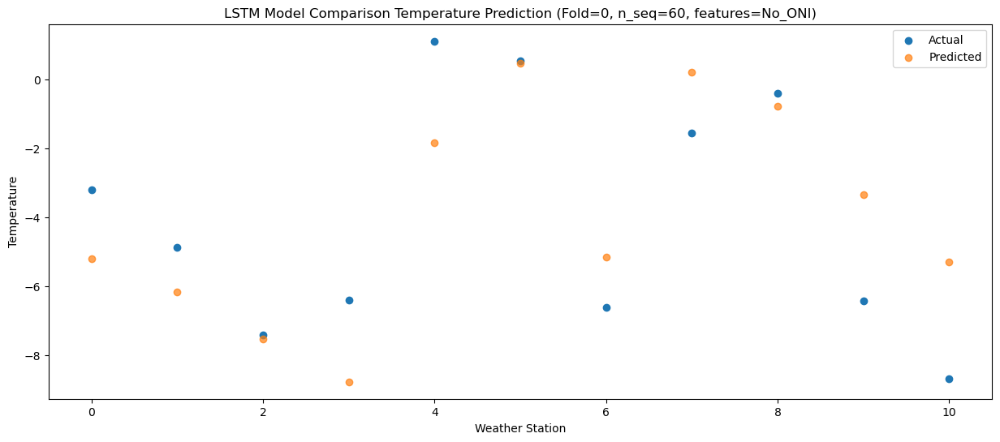

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -2.924812
1                 1   -2.10  -3.873757
2                 2   -3.45  -5.261067
3                 3   -3.95  -6.493422
4                 4    0.87   0.421624
5                 5    4.13   2.728520
6                 6   -2.62  -2.871355
7                 7    2.67   2.470038
8                 8    1.62   1.494042
9                 9   -2.85  -1.058558
10               10   -5.43  -3.013181


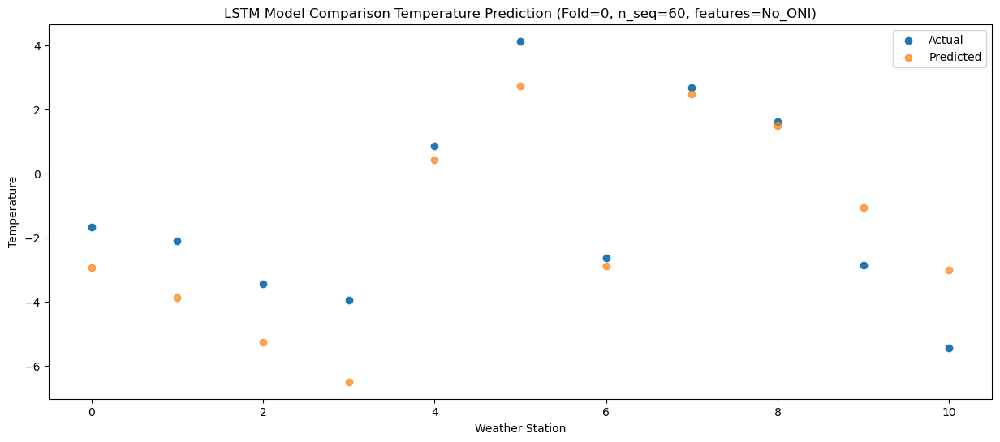

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.90   2.887986
1                 1    1.76   1.937097
2                 2    0.05   0.549675
3                 3   -0.16  -0.686461
4                 4    7.36   6.239317
5                 5    8.05   8.541732
6                 6    1.72   2.932419
7                 7    7.51   8.271237
8                 8    8.84   7.300996
9                 9    4.13   4.756481
10               10    1.48   2.804672


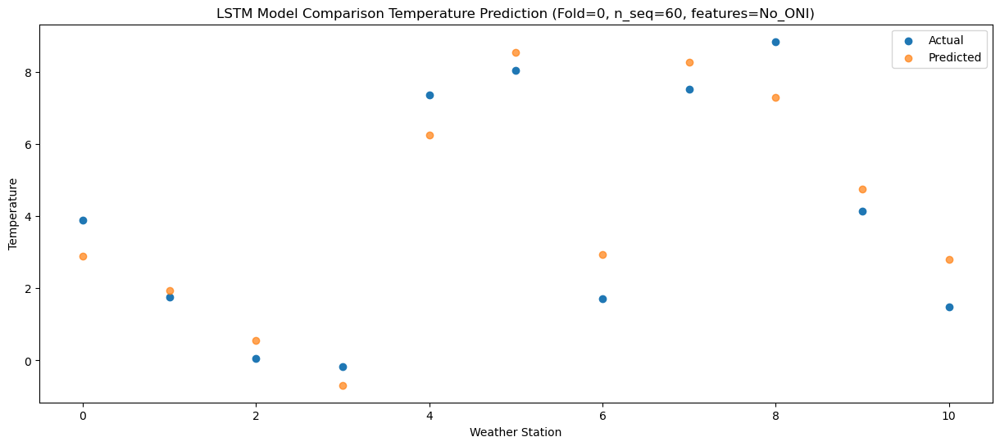

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    8.03   7.169292
1                 1    4.73   6.234574
2                 2    2.79   4.857024
3                 3    4.63   3.618845
4                 4   13.40  10.540491
5                 5   10.92  12.843744
6                 6    4.64   7.234410
7                 7   10.83  12.573663
8                 8   12.79  11.595941
9                 9    6.86   9.035203
10               10    5.09   7.077777


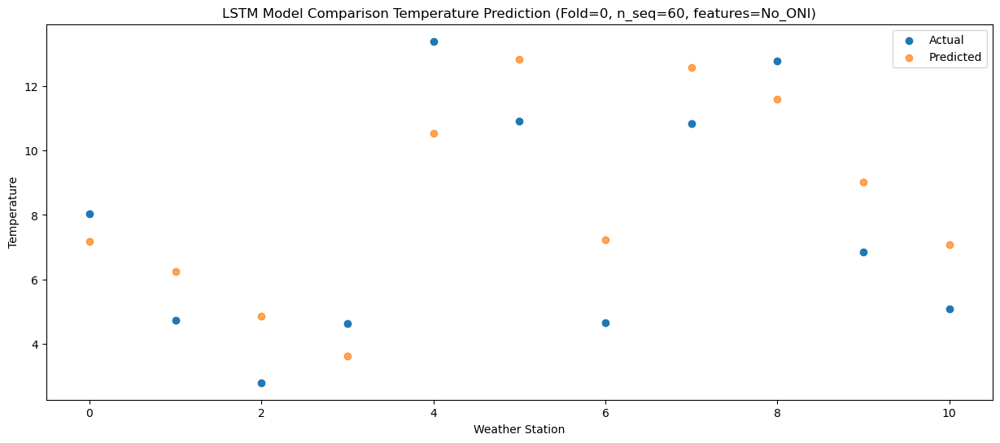

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.22  13.652385
1                 1    9.04  12.719597
2                 2    8.55  11.340393
3                 3    9.15  10.107398
4                 4   18.11  17.028672
5                 5   15.55  19.328920
6                 6    9.71  13.729833
7                 7   15.81  19.067695
8                 8   19.63  18.084947
9                 9   15.03  15.530620
10               10   14.41  13.576569


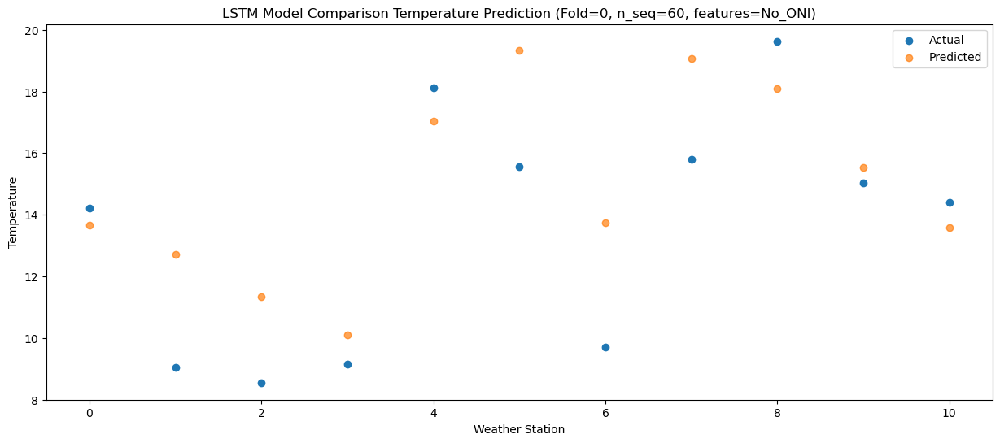

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   17.43  17.821716
1                 1   12.73  16.874376
2                 2   12.33  15.496236
3                 3   11.58  14.251552
4                 4   22.45  21.177547
5                 5   19.12  23.481078
6                 6   13.62  17.881742
7                 7   19.81  23.222763
8                 8   24.15  22.240816
9                 9   18.93  19.686971
10               10   19.17  17.729934


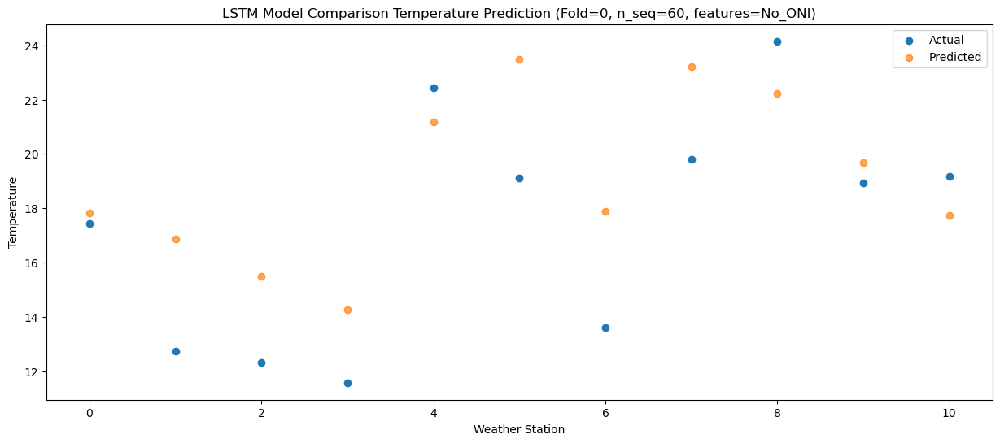

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   19.65  20.041689
1                 1   12.87  19.088449
2                 2   13.25  17.700958
3                 3   11.56  16.455233
4                 4   24.81  23.384946
5                 5   21.26  25.695337
6                 6   14.72  20.095590
7                 7   21.68  25.440642
8                 8   26.48  24.460084
9                 9   20.96  21.914508
10               10   20.28  19.955560


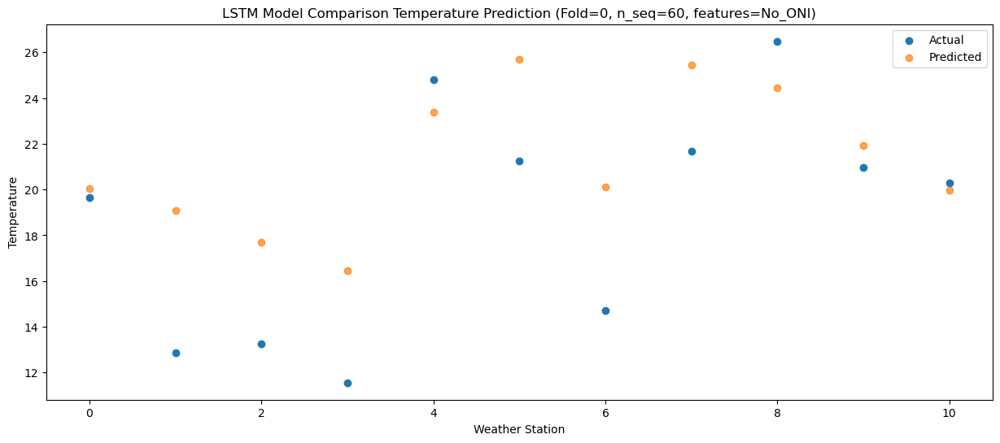

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.47  18.545198
1                 1   12.32  17.602907
2                 2   12.02  16.216512
3                 3   10.37  14.979789
4                 4   22.45  21.899460
5                 5   20.41  24.218414
6                 6   13.43  18.614404
7                 7   20.00  23.960934
8                 8   23.60  22.975861
9                 9   19.05  20.430185
10               10   19.16  18.474944


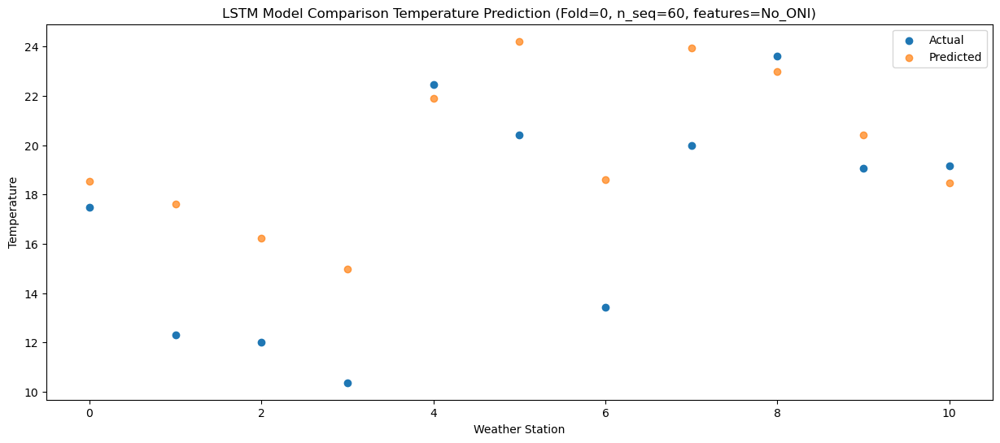

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   14.50  15.019374
1                 1   11.30  14.082163
2                 2    8.90  12.693509
3                 3    9.13  11.458421
4                 4   19.50  18.378241
5                 5   17.76  20.696534
6                 6   10.37  15.082790
7                 7   16.30  20.428467
8                 8   19.96  19.442552
9                 9   15.32  16.896701
10               10   15.32  14.945020


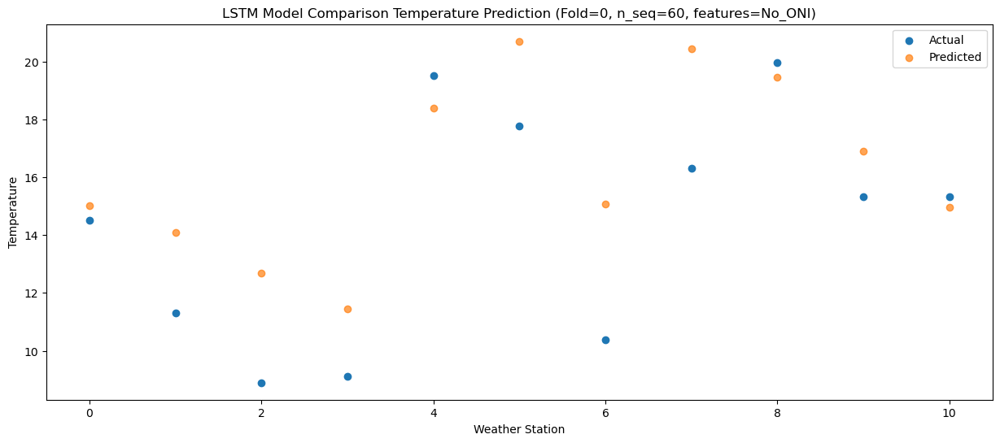

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    8.82   7.794339
1                 1    5.70   6.861824
2                 2    1.76   5.476139
3                 3    3.51   4.247064
4                 4   13.58  11.162927
5                 5   11.20  13.479592
6                 6    3.43   7.866164
7                 7    9.11  13.211261
8                 8   13.40  12.227702
9                 9    8.28   9.679905
10               10    8.08   7.727753


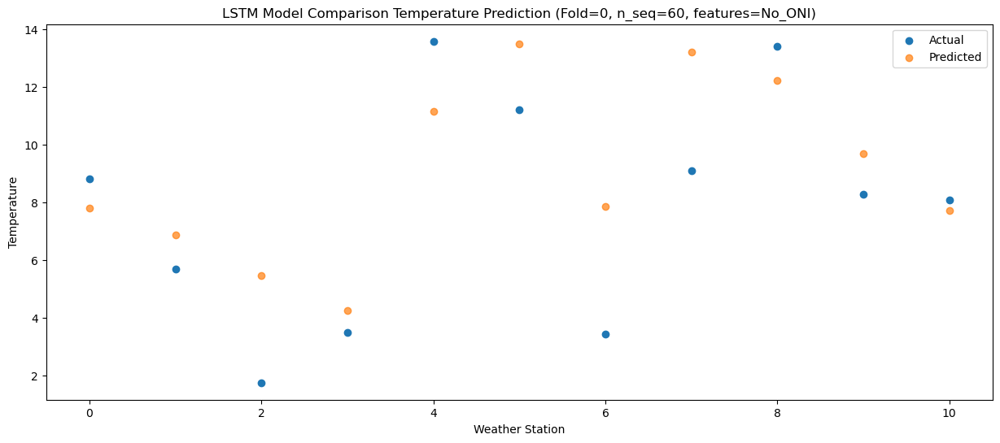

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.87   2.398374
1                 1    3.01   1.459883
2                 2   -0.72   0.080494
3                 3   -0.60  -1.152546
4                 4    6.65   5.762013
5                 5    9.51   8.079911
6                 6    1.20   2.466701
7                 7    6.91   7.815233
8                 8    7.43   6.829784
9                 9    3.26   4.283695
10               10    3.05   2.330883


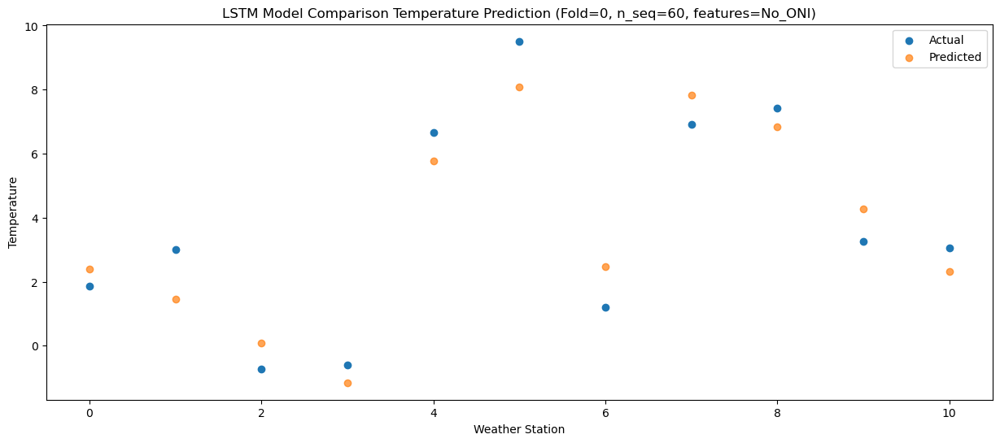

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -0.22  -2.665547
1                 1   -0.84  -3.605747
2                 2   -5.24  -4.986395
3                 3   -2.78  -6.217667
4                 4    3.92   0.697534
5                 5    2.99   3.009458
6                 6   -5.31  -2.601038
7                 7   -0.26   2.748185
8                 8    2.14   1.765129
9                 9   -2.45  -0.776527
10               10   -3.13  -2.726063


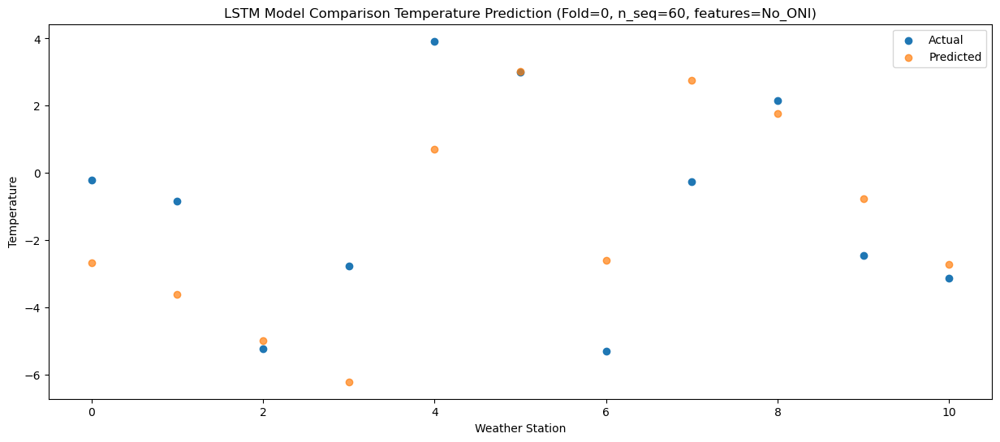

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.42  -0.857321
1                 1   -0.05  -1.790070
2                 2   -3.29  -3.174688
3                 3   -1.34  -4.398290
4                 4    4.89   2.518122
5                 5    4.68   4.826257
6                 6   -2.12  -0.787979
7                 7    2.91   4.560408
8                 8    4.70   3.586229
9                 9   -0.56   1.039415
10               10   -2.00  -0.913375


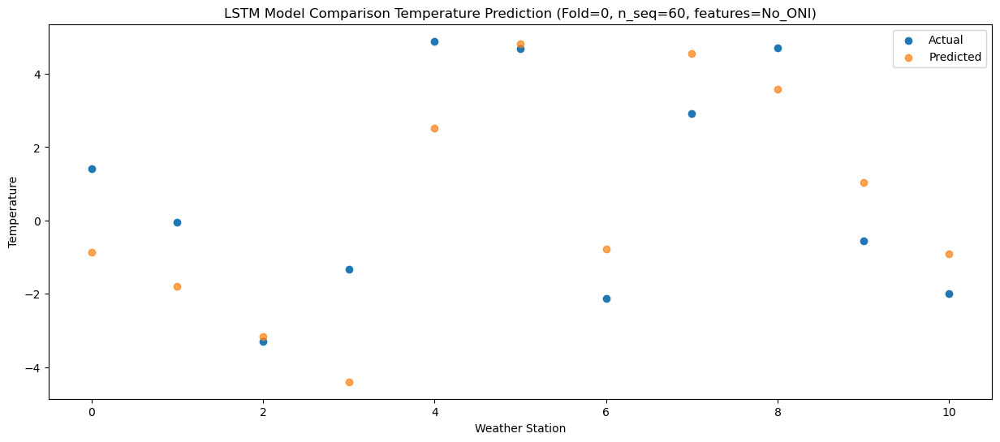

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.95   0.329890
1                 1    1.05  -0.597626
2                 2   -0.51  -1.975375
3                 3   -0.93  -3.203898
4                 4    5.02   3.709890
5                 5    6.17   6.024863
6                 6    0.88   0.413375
7                 7    5.88   5.765123
8                 8    6.31   4.787135
9                 9    1.48   2.235431
10               10   -1.59   0.279035


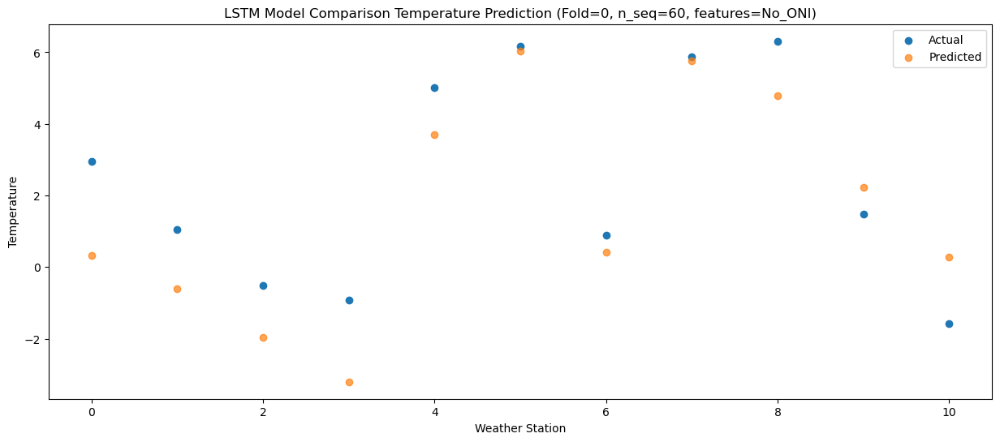

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    5.32   2.280570
1                 1    2.64   1.362547
2                 2   -0.53  -0.016347
3                 3    2.59  -1.242563
4                 4    9.74   5.663479
5                 5    7.08   7.984541
6                 6    1.36   2.377206
7                 7    6.56   7.727084
8                 8    8.13   6.747368
9                 9    1.82   4.194024
10               10    0.27   2.230271


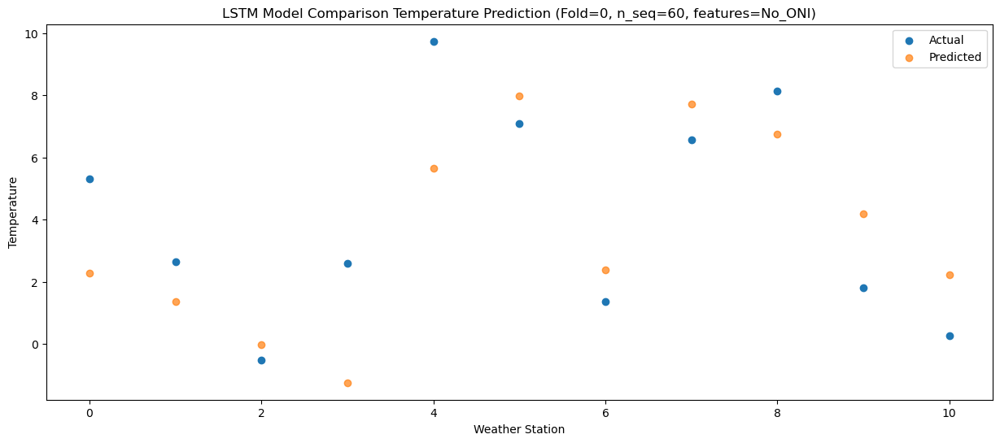

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.94   7.667627
1                 1    4.79   6.743710
2                 2    2.54   5.368940
3                 3    4.01   4.132945
4                 4   11.24  11.036210
5                 5   11.76  13.368668
6                 6    4.92   7.763406
7                 7   11.18  13.115002
8                 8   13.91  12.131264
9                 9    8.10   9.586881
10               10    7.12   7.627140


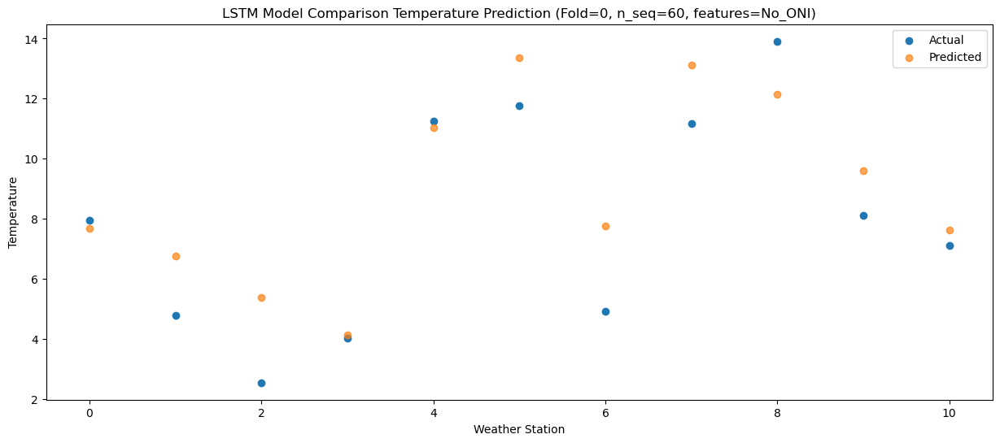

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.41  12.267169
1                 1    7.97  11.339149
2                 2    5.95   9.962160
3                 3    8.44   8.719660
4                 4   16.77  15.624556
5                 5   13.28  17.964355
6                 6    7.61  12.367965
7                 7   13.47  17.720974
8                 8   19.50  16.737610
9                 9   13.06  14.194658
10               10   12.14  12.234044


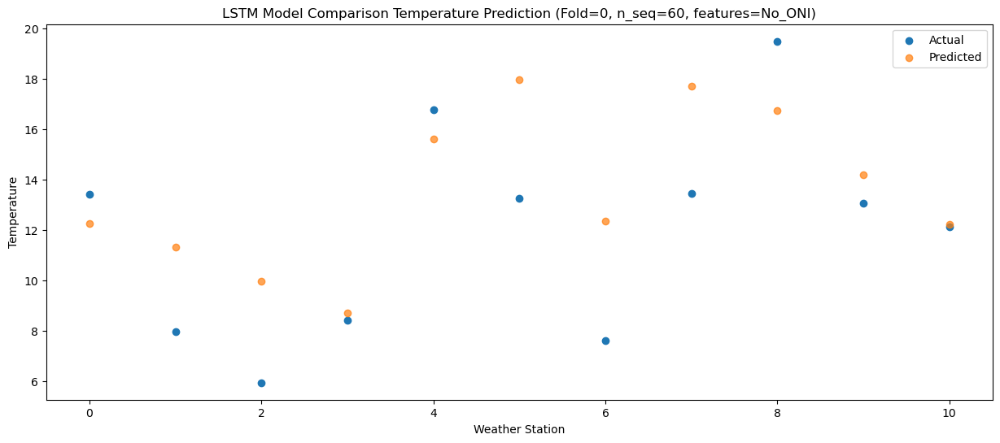

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   17.19  16.074412
1                 1   11.05  15.140319
2                 2    9.27  13.765369
3                 3   12.19  12.523283
4                 4   21.32  19.427486
5                 5   17.10  21.770083
6                 6   10.96  16.177965
7                 7   17.22  21.533937
8                 8   23.37  20.551229
9                 9   16.90  18.005784
10               10   17.65  16.039304


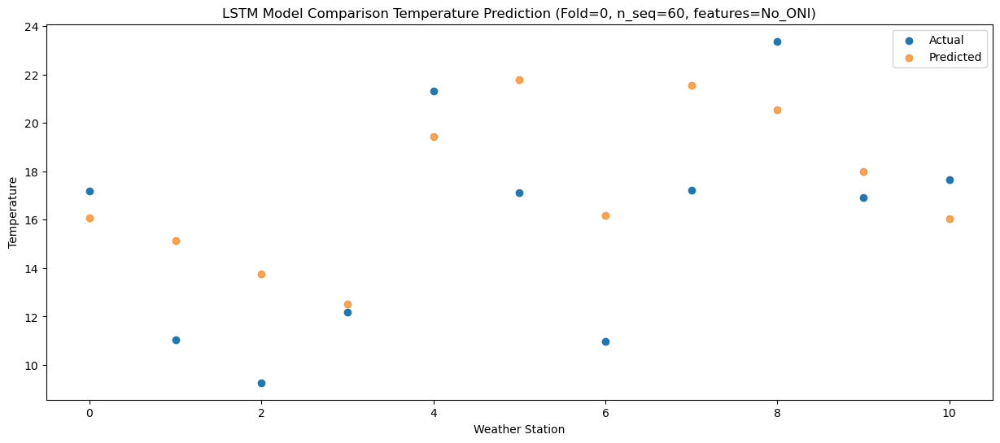

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.73  19.263728
1                 1   12.88  18.335231
2                 2   12.37  16.955267
3                 3   13.31  15.720300
4                 4   24.31  22.622250
5                 5   20.93  24.960698
6                 6   14.67  19.369844
7                 7   21.36  24.726883
8                 8   24.86  23.740578
9                 9   19.73  21.193703
10               10   20.11  19.228101


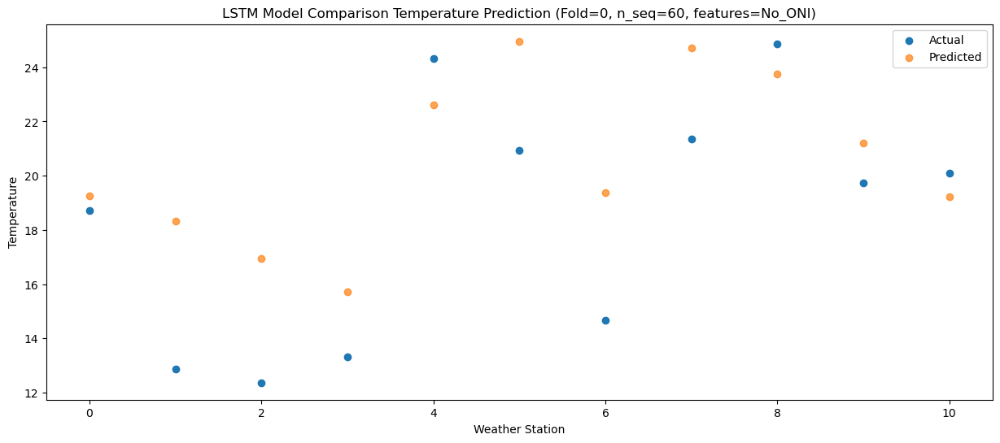

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   19.45  18.869690
1                 1   14.47  17.937913
2                 2   11.98  16.563820
3                 3   14.84  15.324764
4                 4   26.05  22.237885
5                 5   20.45  24.571875
6                 6   13.98  18.974941
7                 7   20.22  24.331410
8                 8   23.60  23.342699
9                 9   18.93  20.788121
10               10   18.30  18.821868


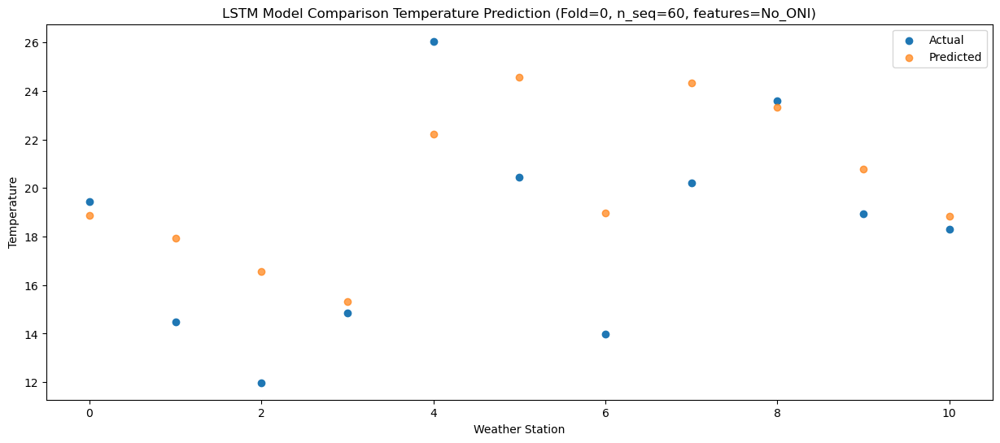

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   15.22  15.274865
1                 1   11.09  14.336932
2                 2    8.53  12.964811
3                 3   11.40  11.723871
4                 4   21.57  18.638478
5                 5   16.93  20.973008
6                 6   10.47  15.378516
7                 7   16.46  20.735020
8                 8   20.43  19.744683
9                 9   16.32  17.193343
10               10   15.92  15.229623


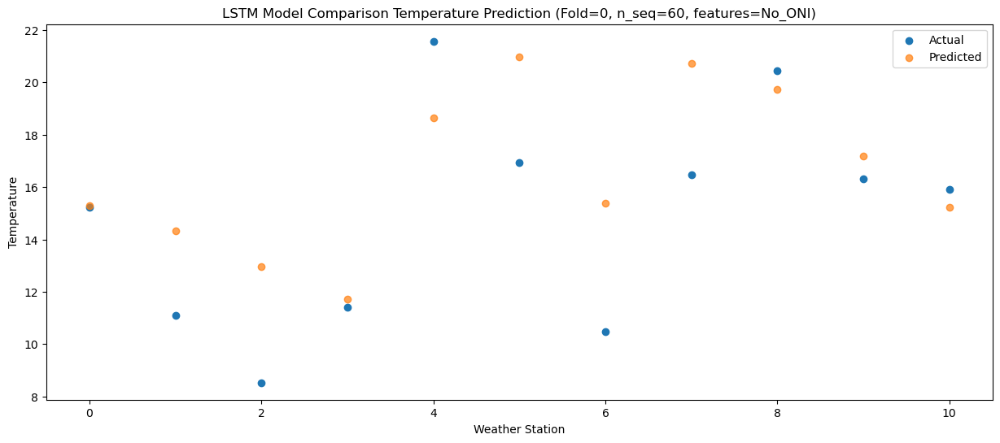

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   10.16   8.874212
1                 1    5.98   7.939797
2                 2    2.55   6.565704
3                 3    5.15   5.323868
4                 4   13.91  12.234542
5                 5   12.58  14.577742
6                 6    5.26   8.988239
7                 7   11.07  14.348169
8                 8   14.83  13.348015
9                 9    9.74  10.792974
10               10    9.96   8.824525


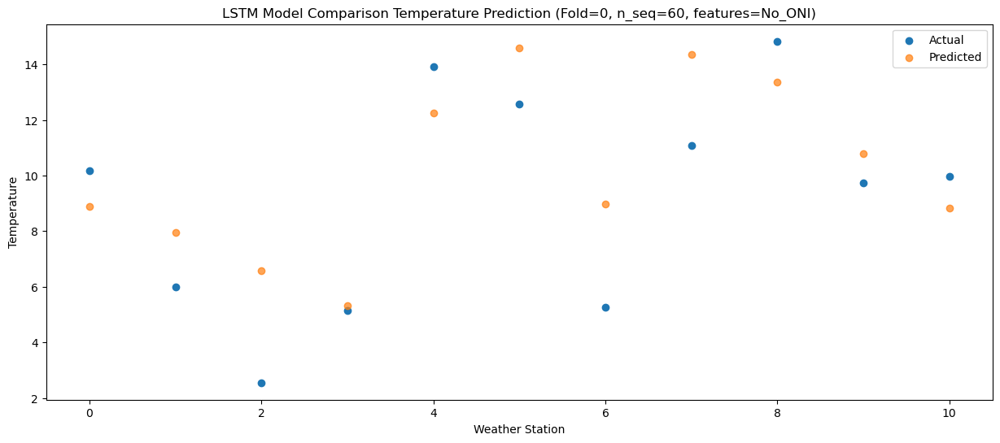

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.30   2.456440
1                 1    0.74   1.516884
2                 2   -2.54   0.142776
3                 3   -0.71  -1.097788
4                 4    7.55   5.818097
5                 5    7.14   8.156674
6                 6   -0.61   2.569200
7                 7    4.62   7.927443
8                 8    7.84   6.935474
9                 9    3.24   4.372482
10               10    2.32   2.399981


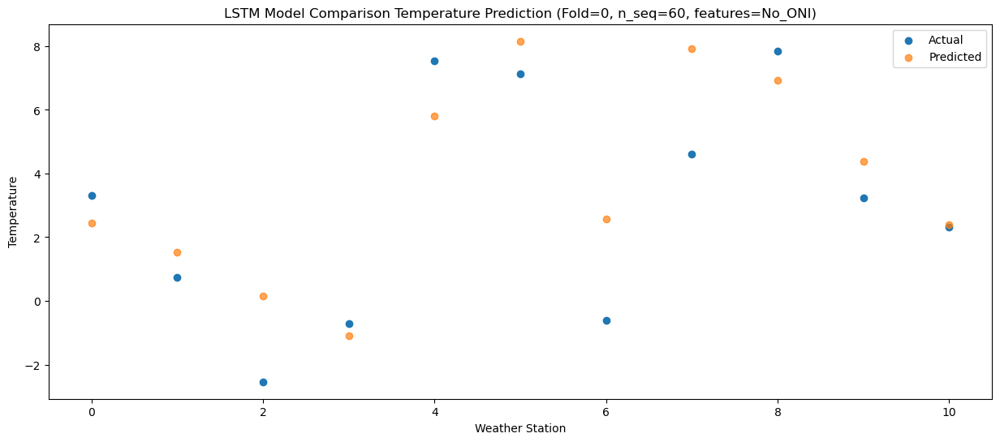

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.70   0.259399
1                 1   -1.96  -0.672345
2                 2   -5.57  -2.048861
3                 3   -3.50  -3.286618
4                 4    4.76   3.628797
5                 5    5.00   5.963804
6                 6   -2.90   0.378091
7                 7    3.03   5.738193
8                 8    5.28   4.744213
9                 9    0.81   2.183126
10               10    1.64   0.206416


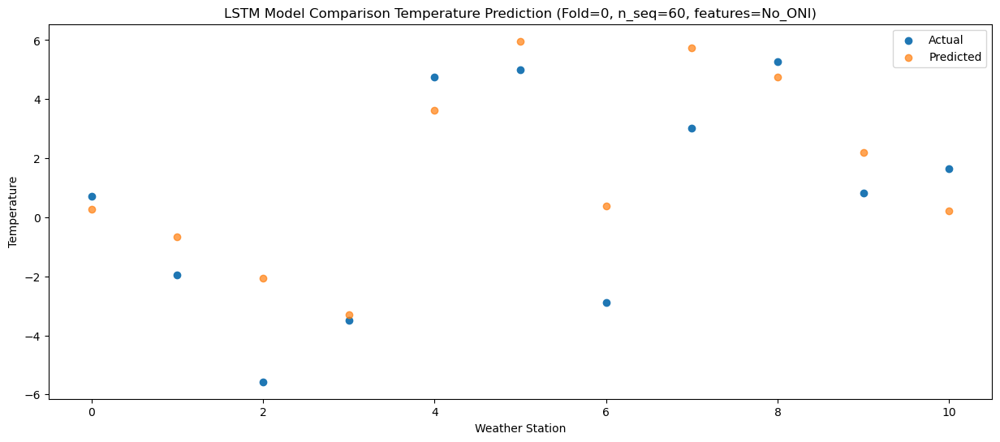

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.42  -4.330526
1                 1   -4.23  -5.262316
2                 2   -8.08  -6.636789
3                 3   -6.38  -7.868383
4                 4   -0.22  -0.956305
5                 5    3.73   1.373782
6                 6   -5.03  -4.206717
7                 7    0.33   1.156155
8                 8   -0.98   0.158091
9                 9   -4.95  -2.409096
10               10   -5.28  -4.388130


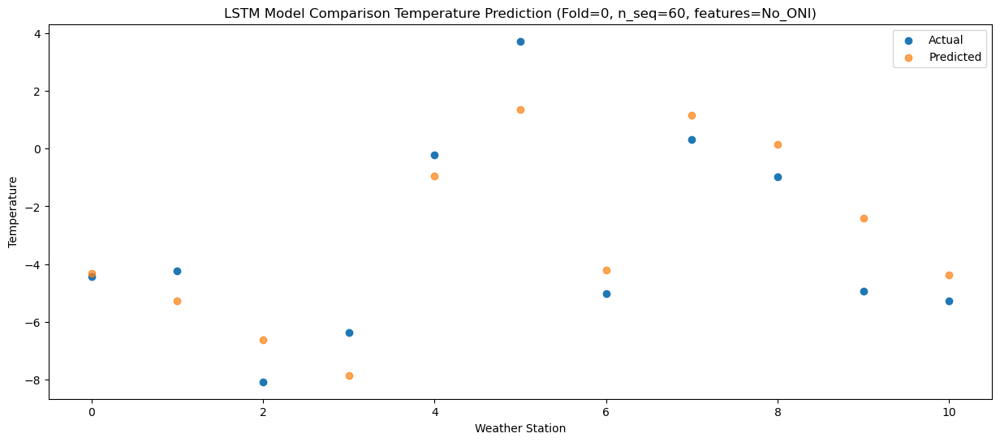

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    3.46   0.974400
1                 1   -1.73   0.044604
2                 2   -3.57  -1.333618
3                 3   -1.73  -2.570347
4                 4    7.65   4.346388
5                 5    4.25   6.675168
6                 6   -1.47   1.096445
7                 7    3.47   6.457863
8                 8    7.64   5.467587
9                 9    1.19   2.902413
10               10   -0.27   0.926801


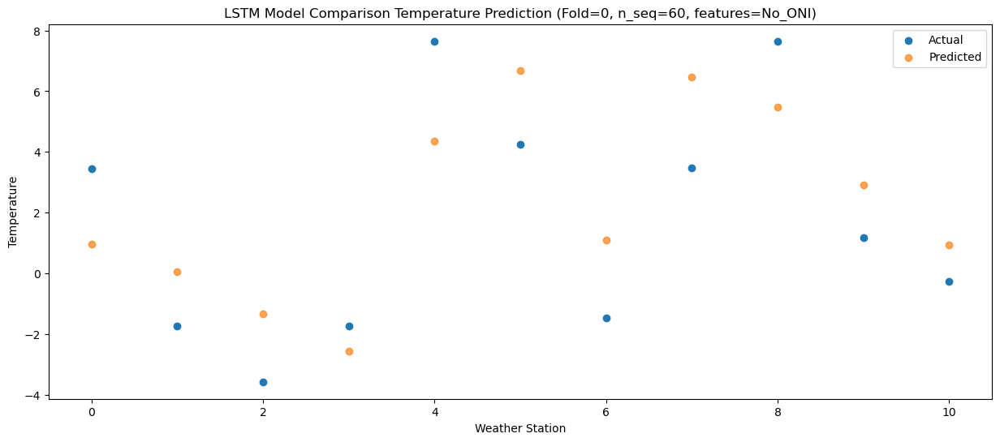

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    5.21   4.064712
1                 1    1.57   3.122779
2                 2    0.81   1.751714
3                 3    1.21   0.506901
4                 4   10.20   7.424993
5                 5    8.30   9.756126
6                 6    2.37   4.177991
7                 7    7.62   9.542835
8                 8   10.92   8.554765
9                 9    4.51   5.987594
10               10    3.23   4.006725


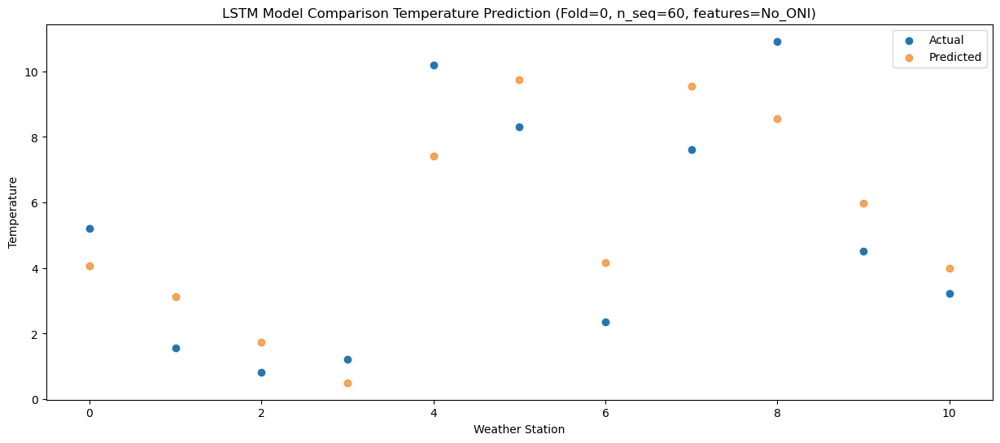

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.98   8.708397
1                 1    4.45   7.756151
2                 2    4.50   6.383132
3                 3    4.78   5.127148
4                 4   13.47  12.047920
5                 5   11.52  14.387863
6                 6    5.96   8.809181
7                 7   12.10  14.183175
8                 8   15.80  13.196690
9                 9    9.73  10.628550
10               10    8.57   8.650599


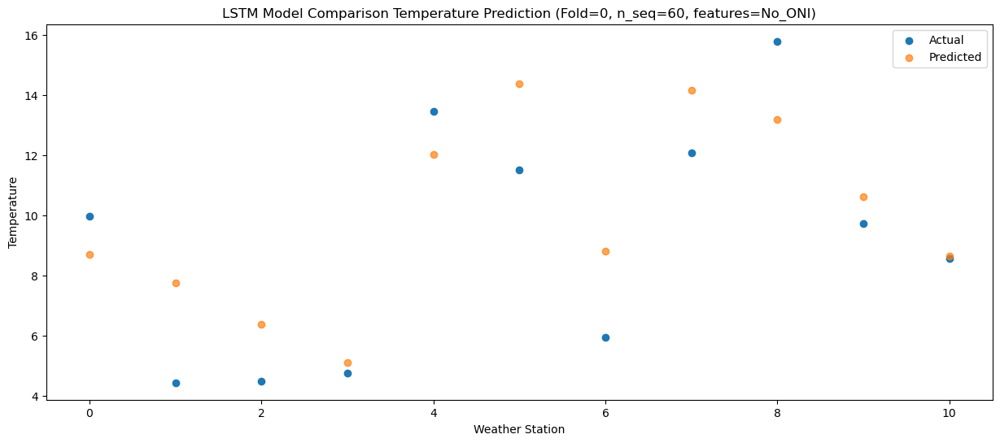

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.89  13.780017
1                 1    8.94  12.824763
2                 2    8.98  11.452972
3                 3    9.17  10.199663
4                 4   18.05  17.114633
5                 5   16.33  19.455779
6                 6    9.96  13.880387
7                 7   16.06  19.256591
8                 8   20.87  18.267783
9                 9   15.53  15.698047
10               10   15.54  13.720029


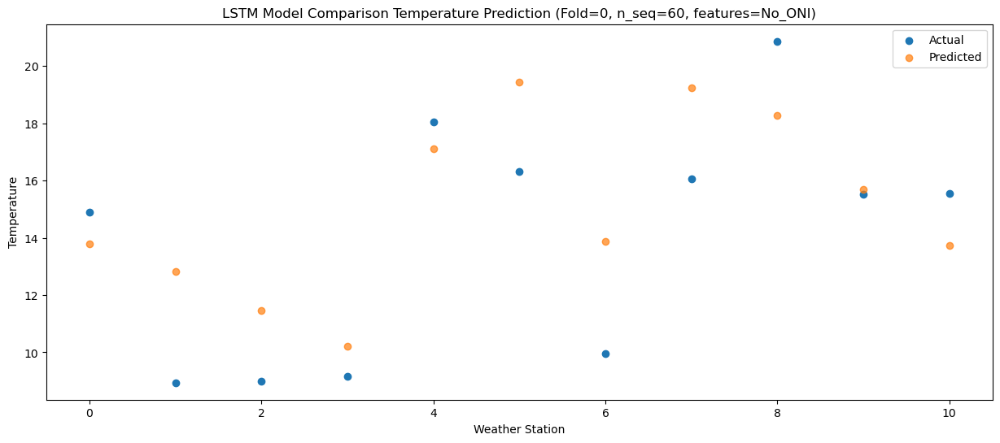

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.50  17.968432
1                 1   11.87  17.016426
2                 2   13.22  15.646660
3                 3   11.29  14.395030
4                 4   21.55  21.308829
5                 5   19.76  23.640793
6                 6   13.87  18.072283
7                 7   20.08  23.444604
8                 8   23.80  22.456632
9                 9   19.29  19.885871
10               10   19.86  17.904995


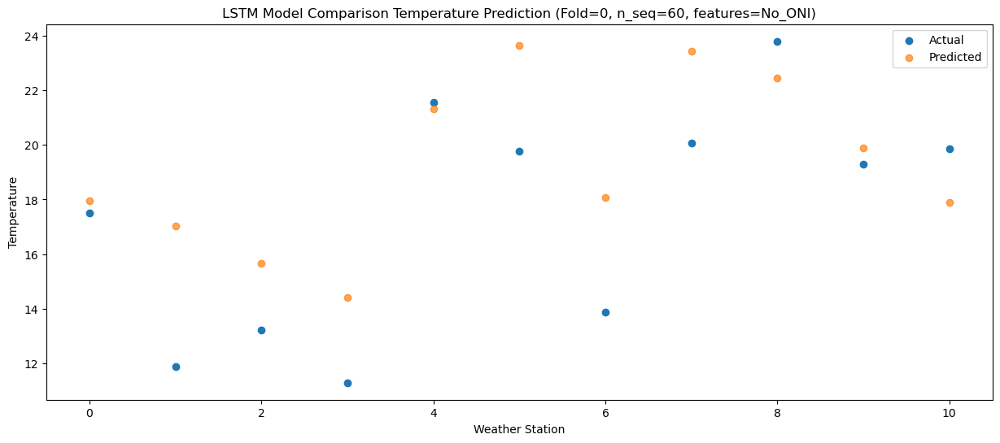

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.38  18.912749
1                 1   13.00  17.958699
2                 2   13.49  16.590897
3                 3   11.23  15.333545
4                 4   21.41  22.251086
5                 5   21.42  24.585697
6                 6   15.13  19.015604
7                 7   21.30  24.388111
8                 8   24.35  23.400927
9                 9   20.13  20.832663
10               10   20.75  18.850988


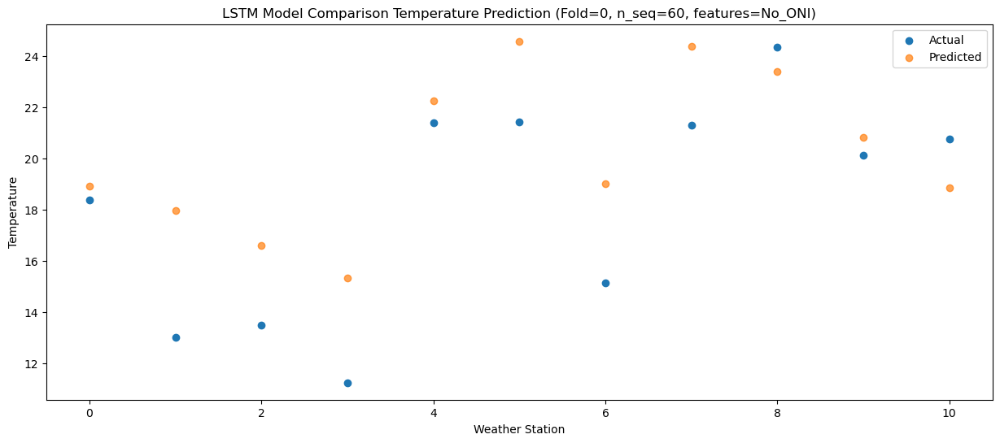

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.72  18.244953
1                 1   13.39  17.293518
2                 2   11.81  15.922922
3                 3   12.04  14.670494
4                 4   23.09  21.590643
5                 5   20.15  23.915620
6                 6   13.38  18.348333
7                 7   19.46  23.719886
8                 8   24.29  22.737487
9                 9   19.80  20.162751
10               10   20.00  18.180048


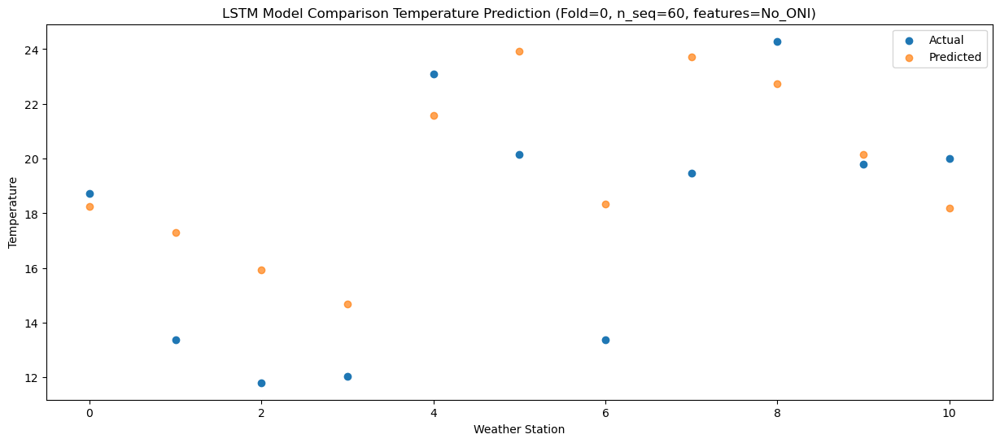

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.58  15.159355
1                 1   10.15  14.204029
2                 2    9.04  12.835597
3                 3    9.45  11.579042
4                 4   19.17  18.496913
5                 5   18.21  20.829806
6                 6   10.95  15.267948
7                 7   16.53  20.644078
8                 8   20.67  19.662217
9                 9   17.61  17.093414
10               10   17.22  15.112448


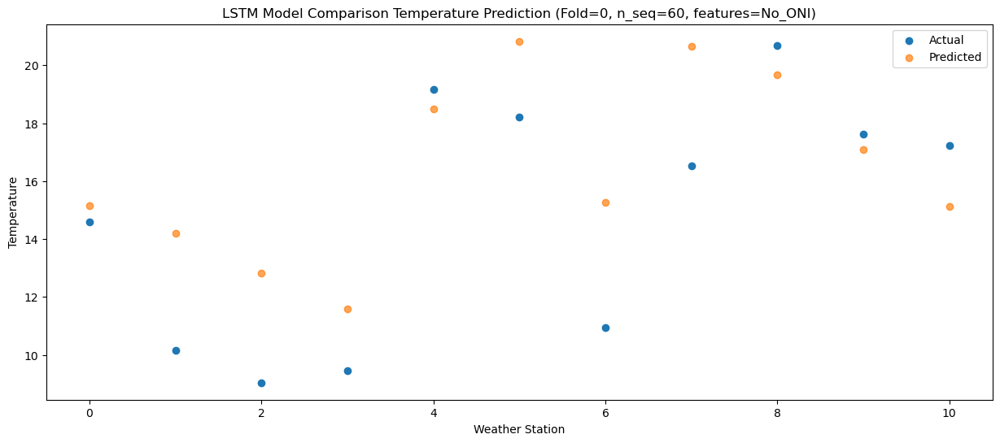

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   11.31   9.896061
1                 1    6.83   8.945458
2                 2    3.14   7.570598
3                 3    5.31   6.320506
4                 4   16.72  13.238824
5                 5   13.18  15.571385
6                 6    5.68  10.005659
7                 7   10.70  15.378772
8                 8   15.24  14.399228
9                 9   10.87  11.832025
10               10   10.99   9.859326


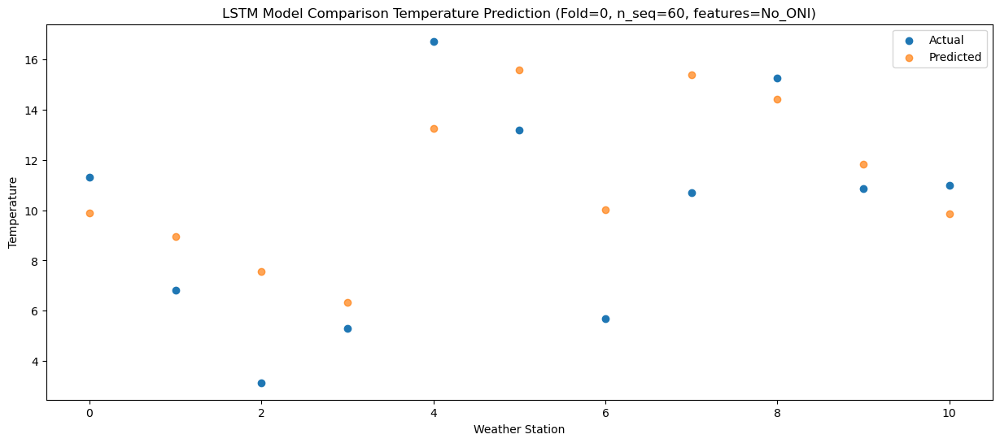

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_10 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_11 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_11 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_15 (Dense)            (1, 256)                  262400    
                                                                 
 dense_16 (Dense)            (1, 128)                  32896     
                                                                 
 dense_17 (Dense)            (1, 60)                  

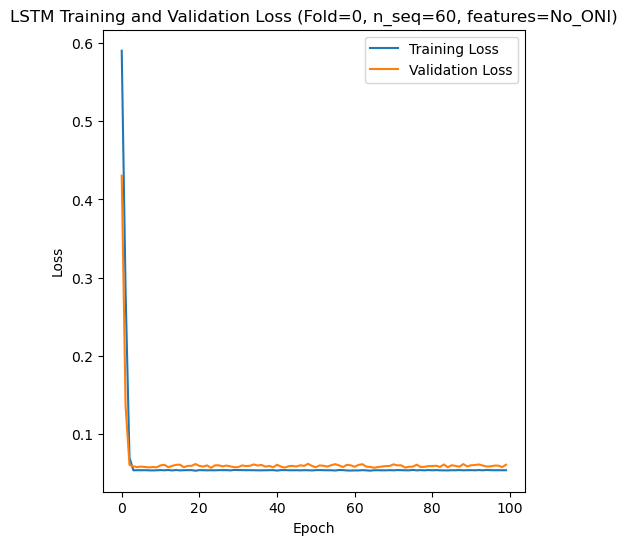

Epoch 1/100
84/84 [==============================] - 23s 97ms/step - loss: 0.6576 - accuracy: 0.0000e+00 - mae: 0.5373 - rmse: 0.6576 - mape: inf - pearson: 0.0024 - val_loss: 0.4978 - val_accuracy: 0.0000e+00 - val_mae: 0.4048 - val_rmse: 0.4978 - val_mape: 85.3419 - val_pearson: 0.0020
Epoch 2/100
84/84 [==============================] - 4s 49ms/step - loss: 0.3391 - accuracy: 0.0119 - mae: 0.2744 - rmse: 0.3391 - mape: inf - pearson: 0.0675 - val_loss: 0.1903 - val_accuracy: 0.0000e+00 - val_mae: 0.1527 - val_rmse: 0.1903 - val_mape: 31.8587 - val_pearson: 0.2550
Epoch 3/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0894 - accuracy: 0.4167 - mae: 0.0712 - rmse: 0.0894 - mape: inf - pearson: 0.6966 - val_loss: 0.0537 - val_accuracy: 0.6000 - val_mae: 0.0432 - val_rmse: 0.0537 - val_mape: 9.5718 - val_pearson: 0.8801
Epoch 4/100
84/84 [==============================] - 4s 49ms/step - loss: 0.0538 - accuracy: 0.6071 - mae: 0.0425 - rmse: 0.0538 - mape: inf - pears

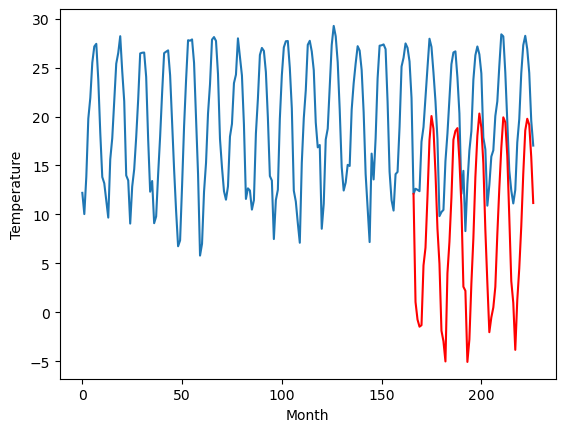

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.99		-0.38		0.61
-1.90		-2.18		-0.28
-3.01		-2.91		0.10
-2.92		-2.76		0.16
3.08		3.35		0.27
4.30		5.17		0.87
7.65		10.40		2.75
12.00		16.16		4.16
15.37		18.62		3.25
13.96		17.32		3.36
10.42		12.84		2.42
6.70		7.09		0.39
2.60		3.52		0.92
-4.29		-3.31		0.98
-4.49		-4.40		0.09
-3.83		-6.46		-2.63
2.94		2.57		-0.37
5.08		5.76		0.68
8.81		10.30		1.49
12.95		16.21		3.26
14.33		17.11		2.78
14.60		17.40		2.80
10.86		14.11		3.25
7.08		9.54		2.46
-0.58		1.20		1.78
1.05		0.79		-0.26
-5.68		-6.48		-0.80
-1.45		-4.17		-2.72
2.12		1.53		-0.59
5.12		6.16		1.04
11.00		12.39		1.39
14.97		16.63		1.66
15.47		18.90		3.43
14.01		17.46		3.45
10.92		13.80		2.88
4.58		7.01		2.43
1.58		1.62		0.04
-4.23		-3.46		0.77
-2.04		-1.94		0.10
1.33		-0.93		-2.26
2.10		1.18		-0.92
5.37		6.54		1.17
8.65		11.25		2.60
11.84		15.38		3.54
15.44		18.51		3.07
14.90		18.01		3.11
11.39		14.57		3.18
6.38		8.31		1.93
0.76		1.77		1.01
-2

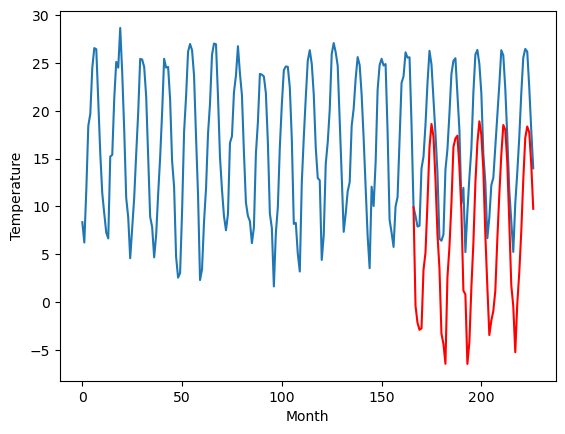

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.90		0.86		1.76
-0.47		-0.94		-0.47
-1.00		-1.67		-0.67
-0.72		-1.53		-0.81
6.38		4.58		-1.80
5.41		6.39		0.98
9.56		11.63		2.07
13.79		17.39		3.60
15.26		19.84		4.58
15.25		18.54		3.29
12.45		14.06		1.61
8.10		8.31		0.21
3.30		4.73		1.43
-3.76		-2.10		1.66
-3.34		-3.19		0.15
-2.85		-5.26		-2.41
4.21		3.78		-0.43
5.61		6.97		1.36
9.73		11.51		1.78
13.61		17.42		3.81
14.38		18.33		3.95
15.04		18.62		3.58
12.02		15.33		3.31
8.24		10.76		2.52
0.50		2.42		1.92
3.10		2.02		-1.08
-3.79		-5.25		-1.46
-0.44		-2.95		-2.51
3.56		2.76		-0.80
7.15		7.38		0.23
12.51		13.61		1.10
15.48		17.85		2.37
16.19		20.12		3.93
14.58		18.68		4.10
12.19		15.02		2.83
5.50		8.22		2.72
2.18		2.83		0.65
-0.98		-2.25		-1.27
0.02		-0.73		-0.75
2.61		0.27		-2.34
4.04		2.37		-1.67
6.73		7.74		1.01
9.97		12.45		2.48
13.72		16.58		2.86
16.09		19.71		3.62
16.53		19.21		2.68
13.57		15.78		2.21
7.53		9.51		1.98
0.97		2.97		2.00


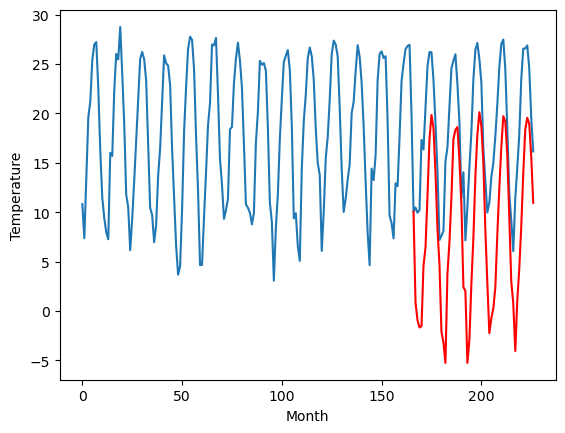

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.19		-0.10		-1.29
-0.23		-1.91		-1.68
0.52		-2.63		-3.15
-0.01		-2.50		-2.49
7.63		3.61		-4.02
7.51		5.43		-2.08
11.26		10.65		-0.61
14.04		16.41		2.37
15.69		18.86		3.17
15.93		17.57		1.64
12.52		13.09		0.57
7.98		7.34		-0.64
5.08		3.75		-1.33
-1.10		-3.09		-1.99
-1.20		-4.17		-2.97
-2.79		-6.24		-3.45
4.58		2.80		-1.78
6.92		5.99		-0.93
10.81		10.52		-0.29
14.70		16.44		1.74
14.58		17.34		2.76
15.55		17.62		2.07
12.54		14.33		1.79
9.85		9.75		-0.10
2.69		1.41		-1.28
6.06		1.00		-5.06
-1.99		-6.28		-4.29
-2.46		-3.98		-1.52
3.38		1.72		-1.66
9.38		6.34		-3.04
13.81		12.58		-1.23
16.81		16.82		0.01
17.75		19.09		1.34
16.11		17.65		1.54
13.34		13.98		0.64
7.78		7.19		-0.59
2.73		1.79		-0.94
0.64		-3.28		-3.92
1.35		-1.77		-3.12
2.35		-0.77		-3.12
6.18		1.33		-4.85
7.02		6.70		-0.32
11.61		11.40		-0.21
15.76		15.54		-0.22
17.48		18.67		1.19
19.45		18.17		-1.28
16.37		14.73		-1.64
9.11		8.47		-

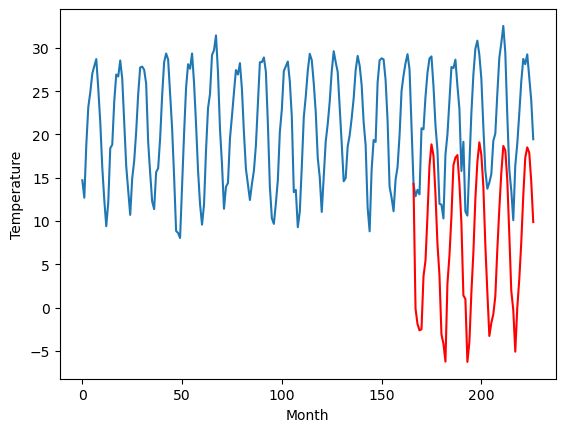

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.60		4.14		-1.46
3.71		2.34		-1.37
4.52		1.62		-2.90
4.14		1.75		-2.39
12.18		7.87		-4.31
11.92		9.67		-2.25
15.72		14.91		-0.81
18.75		20.66		1.91
20.79		23.12		2.33
21.03		21.82		0.79
17.45		17.34		-0.11
12.51		11.59		-0.92
9.41		8.00		-1.41
3.05		1.16		-1.89
3.04		0.08		-2.96
1.34		-1.99		-3.33
8.95		7.05		-1.90
11.25		10.24		-1.01
15.37		14.77		-0.60
18.84		20.69		1.85
18.93		21.59		2.66
19.90		21.86		1.96
16.32		18.57		2.25
13.28		13.99		0.71
5.73		5.65		-0.08
9.61		5.24		-4.37
1.13		-2.04		-3.17
0.82		0.25		-0.57
6.60		5.95		-0.65
12.87		10.58		-2.29
17.49		16.82		-0.67
20.86		21.06		0.20
21.95		23.32		1.37
19.94		21.88		1.94
16.76		18.21		1.45
11.37		11.42		0.05
6.37		6.02		-0.35
4.35		0.95		-3.40
4.83		2.46		-2.37
6.01		3.46		-2.55
9.83		5.55		-4.28
10.79		10.92		0.13
15.43		15.62		0.19
20.32		19.76		-0.56
22.27		22.89		0.62
23.70		22.38		-1.32
19.85		18.94		-0.91
12.45		12.68		0.23


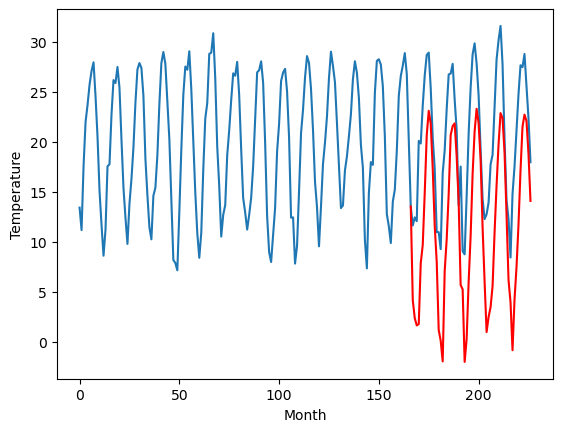

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.73		0.29		-2.44
0.70		-1.52		-2.22
0.04		-2.23		-2.27
-0.48		-2.09		-1.61
6.87		4.02		-2.85
9.66		5.82		-3.84
14.85		11.06		-3.79
17.57		16.81		-0.76
20.27		19.27		-1.00
20.12		17.98		-2.14
12.59		13.49		0.90
9.75		7.74		-2.01
6.03		4.15		-1.88
-0.72		-2.69		-1.97
-2.23		-3.76		-1.53
-1.85		-5.83		-3.98
5.49		3.20		-2.29
7.76		6.39		-1.37
13.35		10.91		-2.44
17.62		16.83		-0.79
16.96		17.73		0.77
16.37		18.00		1.63
16.01		14.71		-1.30
11.69		10.14		-1.55
5.22		1.80		-3.42
5.48		1.38		-4.10
-1.84		-5.89		-4.05
-1.95		-3.60		-1.65
5.00		2.11		-2.89
11.91		6.73		-5.18
17.31		12.98		-4.33
19.37		17.22		-2.15
20.29		19.49		-0.80
17.44		18.05		0.61
14.39		14.38		-0.01
8.31		7.59		-0.72
1.35		2.19		0.84
0.23		-2.87		-3.10
0.69		-1.36		-2.05
0.83		-0.37		-1.20
5.89		1.72		-4.17
9.05		7.09		-1.96
13.66		11.78		-1.88
20.35		15.93		-4.42
21.45		19.06		-2.39
20.64		18.55		-2.09
18.36		15.13		-3.23
10.7

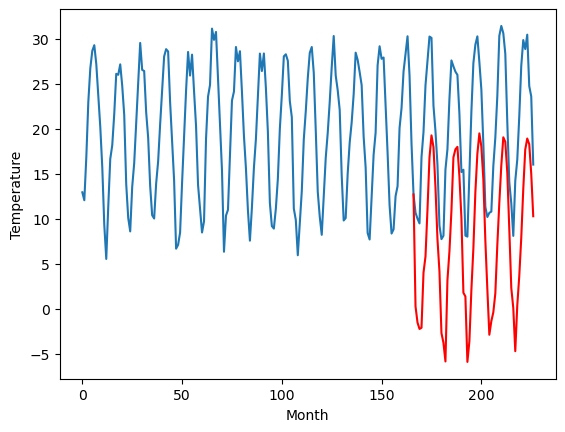

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.75		2.75		1.00
1.02		0.95		-0.07
0.21		0.24		0.03
0.28		0.38		0.10
5.95		6.48		0.53
7.58		8.29		0.71
10.36		13.53		3.17
15.03		19.28		4.25
18.21		21.74		3.53
16.58		20.45		3.87
13.16		15.96		2.80
9.67		10.21		0.54
5.52		6.63		1.11
-1.69		-0.21		1.48
-1.89		-1.29		0.60
-1.11		-3.36		-2.25
5.17		5.68		0.51
7.74		8.87		1.13
11.51		13.40		1.89
15.52		19.31		3.79
16.88		20.22		3.34
17.14		20.49		3.35
13.81		17.21		3.40
9.86		12.63		2.77
2.26		4.29		2.03
3.78		3.88		0.10
-2.61		-3.39		-0.78
1.20		-1.10		-2.30
5.04		4.61		-0.43
7.80		9.23		1.43
13.72		15.48		1.76
17.30		19.71		2.41
18.04		21.99		3.95
16.54		20.54		4.00
13.65		16.87		3.22
7.31		10.08		2.77
4.42		4.68		0.26
-1.59		-0.39		1.20
0.54		1.13		0.59
4.13		2.13		-2.00
4.80		4.23		-0.57
8.06		9.59		1.53
11.06		14.29		3.23
14.34		18.44		4.10
17.79		21.57		3.78
17.37		21.06		3.69
14.20		17.63		3.43
9.19		11.36		2.17
3.50		4.82		1.32
0.76		2.61

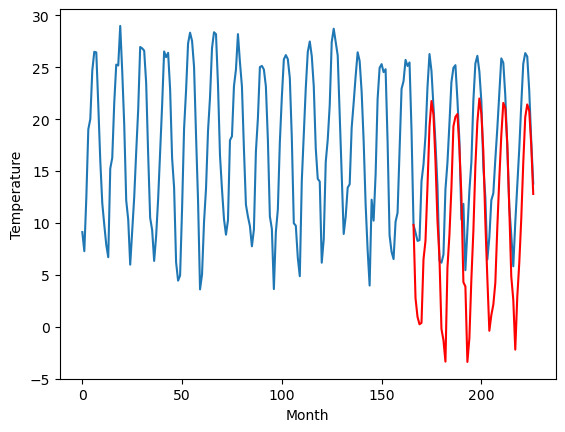

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.51		6.65		0.14
5.89		4.84		-1.05
5.04		4.13		-0.91
5.72		4.27		-1.45
12.64		10.38		-2.26
13.78		12.19		-1.59
18.28		17.43		-0.85
23.84		23.18		-0.66
26.38		25.63		-0.75
24.36		24.33		-0.03
21.06		19.84		-1.22
14.29		14.10		-0.19
10.62		10.52		-0.10
4.02		3.68		-0.34
3.71		2.60		-1.11
0.71		0.53		-0.18
12.03		9.57		-2.46
13.74		12.76		-0.98
18.40		17.30		-1.10
24.48		23.22		-1.26
25.47		24.13		-1.34
26.69		24.41		-2.28
22.98		21.13		-1.85
17.78		16.55		-1.23
8.48		8.20		-0.28
10.89		7.80		-3.09
2.06		0.53		-1.53
4.11		2.83		-1.28
10.06		8.53		-1.53
15.25		13.15		-2.10
20.72		19.40		-1.32
24.78		23.64		-1.14
28.91		25.91		-3.00
26.04		24.47		-1.57
22.20		20.80		-1.40
15.53		14.01		-1.52
8.93		8.61		-0.32
5.19		3.54		-1.65
6.38		5.05		-1.33
7.88		6.06		-1.82
10.71		8.15		-2.56
15.11		13.52		-1.59
20.46		18.23		-2.23
24.27		22.37		-1.90
26.57		25.50		-1.07
27.07		24.99		-2.08
23.45		21.56		-1.8

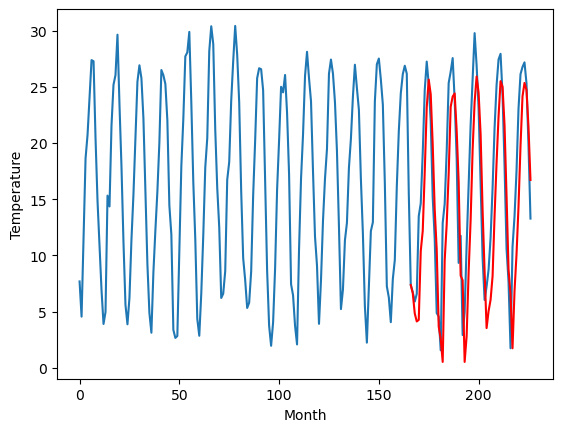

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.17		5.36		-0.81
4.32		3.56		-0.76
4.50		2.86		-1.64
3.99		2.99		-1.00
11.82		9.11		-2.71
13.20		10.92		-2.28
19.31		16.15		-3.16
24.42		21.90		-2.52
26.96		24.35		-2.61
26.03		23.04		-2.99
19.38		18.55		-0.83
13.20		12.80		-0.40
10.32		9.22		-1.10
3.64		2.39		-1.25
3.29		1.30		-1.99
-1.49		-0.76		0.73
11.07		8.28		-2.79
12.87		11.47		-1.40
17.68		16.00		-1.68
23.71		21.93		-1.78
25.22		22.84		-2.38
25.61		23.12		-2.49
23.10		19.84		-3.26
16.85		15.26		-1.59
9.10		6.91		-2.19
8.29		6.51		-1.78
0.67		-0.76		-1.43
1.65		1.53		-0.12
8.90		7.23		-1.67
16.01		11.86		-4.15
21.37		18.11		-3.26
25.66		22.35		-3.31
29.81		24.62		-5.19
27.14		23.18		-3.96
23.31		19.51		-3.80
15.08		12.73		-2.35
7.23		7.33		0.10
3.60		2.26		-1.34
4.46		3.77		-0.69
4.83		4.77		-0.06
9.26		6.86		-2.40
13.59		12.23		-1.36
19.28		16.93		-2.35
24.21		21.07		-3.14
27.09		24.19		-2.90
28.90		23.69		-5.21
24.26		20.25		-4.01
1

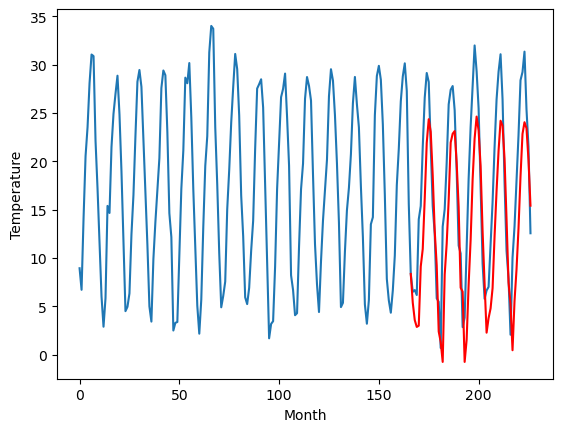

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.70		4.89		-3.81
7.34		3.10		-4.24
6.89		2.39		-4.50
5.65		2.54		-3.11
13.61		8.65		-4.96
15.92		10.46		-5.46
22.45		15.70		-6.75
28.83		21.45		-7.38
30.41		23.91		-6.50
29.18		22.60		-6.58
22.43		18.11		-4.32
15.83		12.37		-3.46
12.65		8.79		-3.86
5.38		1.95		-3.43
5.49		0.87		-4.62
1.12		-1.21		-2.33
11.83		7.83		-4.00
15.59		11.03		-4.56
20.14		15.55		-4.59
27.25		21.48		-5.77
27.92		22.39		-5.53
27.77		22.67		-5.10
25.82		19.39		-6.43
18.38		14.81		-3.57
12.13		6.46		-5.67
10.52		6.06		-4.46
3.60		-1.22		-4.82
3.66		1.07		-2.59
10.59		6.78		-3.81
17.07		11.41		-5.66
22.52		17.66		-4.86
27.09		21.90		-5.19
30.69		24.18		-6.51
27.86		22.74		-5.12
25.45		19.07		-6.38
16.91		12.29		-4.62
7.92		6.89		-1.03
5.57		1.83		-3.74
5.85		3.34		-2.51
7.00		4.34		-2.66
10.73		6.43		-4.30
16.08		11.80		-4.28
21.19		16.50		-4.69
24.42		20.64		-3.78
29.04		23.76		-5.28
29.44		23.24		-6.20
25.92		19.82		-

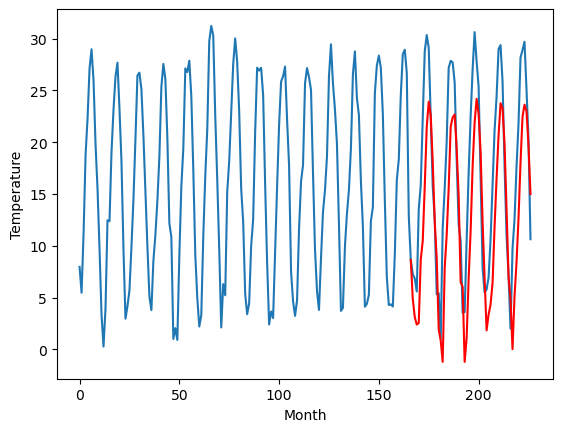

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.40		1.05		1.45
-3.21		-0.74		2.47
-2.87		-1.45		1.42
-2.13		-1.30		0.83
2.19		4.81		2.62
3.82		6.62		2.80
9.28		11.86		2.58
16.60		17.61		1.01
20.47		20.07		-0.40
18.28		18.76		0.48
13.75		14.28		0.53
8.21		8.54		0.33
4.01		4.96		0.95
-3.00		-1.87		1.13
-4.84		-2.96		1.88
-5.80		-5.03		0.77
1.42		4.01		2.59
6.07		7.20		1.13
10.61		11.74		1.13
16.70		17.67		0.97
18.93		18.58		-0.35
18.71		18.86		0.15
15.01		15.58		0.57
10.59		11.01		0.42
1.27		2.66		1.39
0.50		2.26		1.76
-6.52		-5.00		1.52
-2.62		-2.70		-0.08
1.94		3.01		1.07
5.29		7.63		2.34
12.27		13.88		1.61
16.66		18.12		1.46
20.60		20.40		-0.20
20.06		18.96		-1.10
15.15		15.28		0.13
7.05		8.50		1.45
3.54		3.11		-0.43
-3.61		-1.96		1.65
-0.65		-0.44		0.21
-0.97		0.58		1.55
0.15		2.67		2.52
7.37		8.03		0.66
9.93		12.74		2.81
14.30		16.87		2.57
19.44		20.00		0.56
17.70		19.49		1.79
14.51		16.06		1.55
9.16		9.79		0.63
1.22		3.25		2.03
-0.

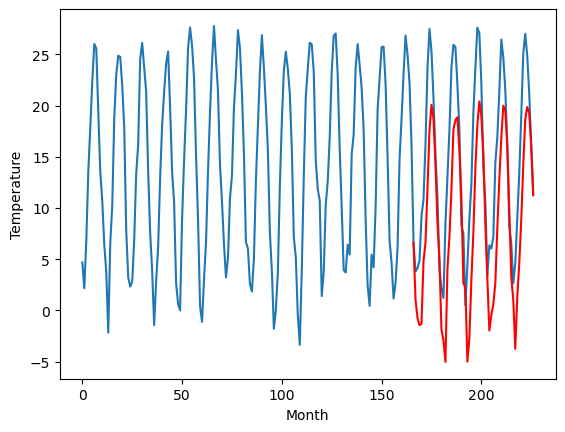

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[1.0473242950439445, -0.3828740692138668, 0.8578831481933591, -0.10293869018554691, 4.143808555603027, 0.2857728958129879, 2.7526457977294925, 6.647942504882813, 5.361727638244629, 4.8882352828979485, 1.0523015213012687]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68   1.047324
1                 1   -0.99  -0.382874
2                 2   -0.90   0.857883
3                 3    1.19  -0.102939
4                 4    5.60   4.143809
5                 5    2.73   0.285773
6                 6    1.75   2.752646
7                 7    6.51   6.647943
8                 8    6.17   5.361728
9                 9    8.70   4.888235
10               10   -0.40   1.052302


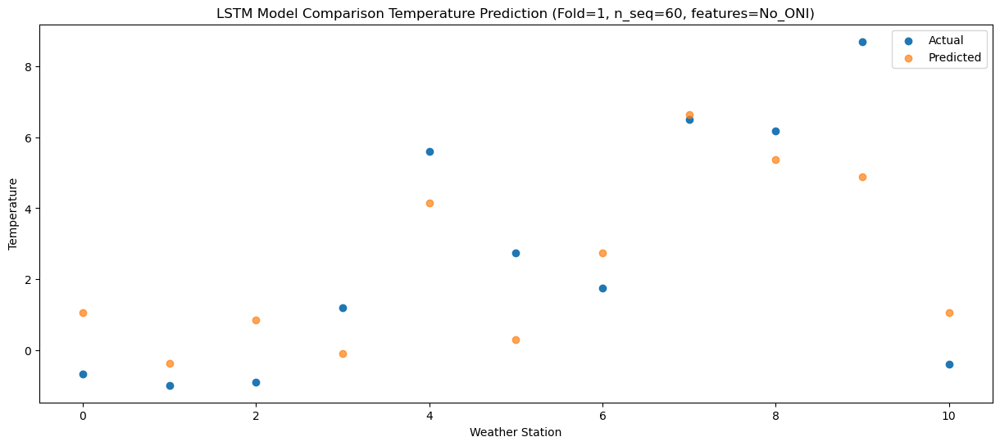

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -0.748908
1                 1   -1.90  -2.181201
2                 2   -0.47  -0.941973
3                 3   -0.23  -1.906169
4                 4    3.71   2.340016
5                 5    0.70  -1.516491
6                 6    1.02   0.951244
7                 7    5.89   4.841756
8                 8    4.32   3.563224
9                 9    7.34   3.096734
10               10   -3.21  -0.743599


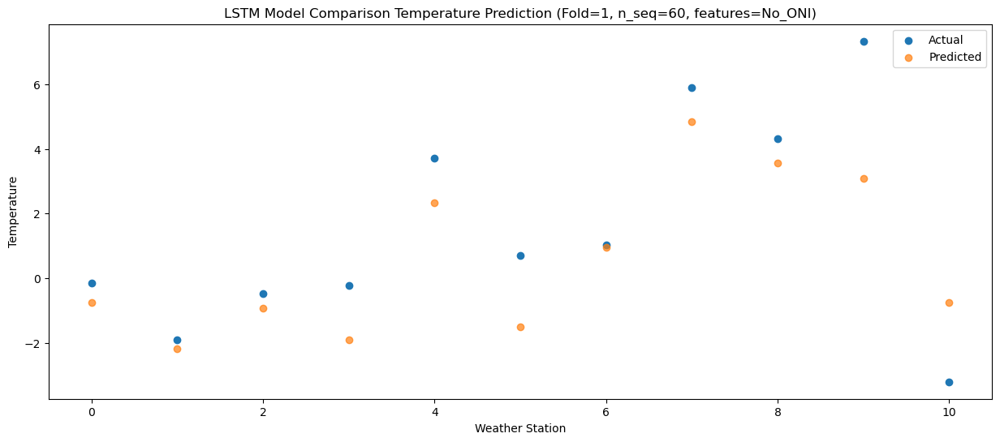

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -1.476165
1                 1   -3.01  -2.906699
2                 2   -1.00  -1.670443
3                 3    0.52  -2.631041
4                 4    4.52   1.621232
5                 5    0.04  -2.227551
6                 6    0.21   0.238209
7                 7    5.04   4.134410
8                 8    4.50   2.856123
9                 9    6.89   2.394168
10               10   -2.87  -1.448748


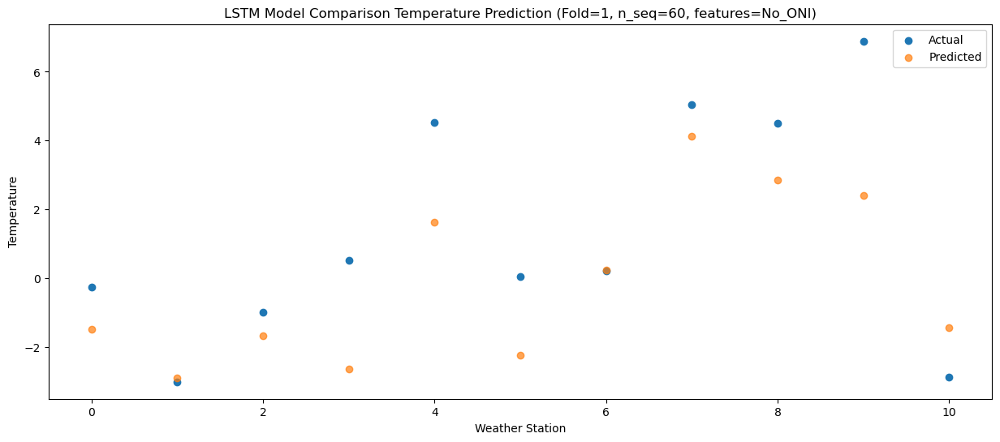

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40  -1.326233
1                 1   -2.92  -2.760995
2                 2   -0.72  -1.531845
3                 3   -0.01  -2.497236
4                 4    4.14   1.753442
5                 5   -0.48  -2.091989
6                 6    0.28   0.375249
7                 7    5.72   4.269653
8                 8    3.99   2.988848
9                 9    5.65   2.538261
10               10   -2.13  -1.301729


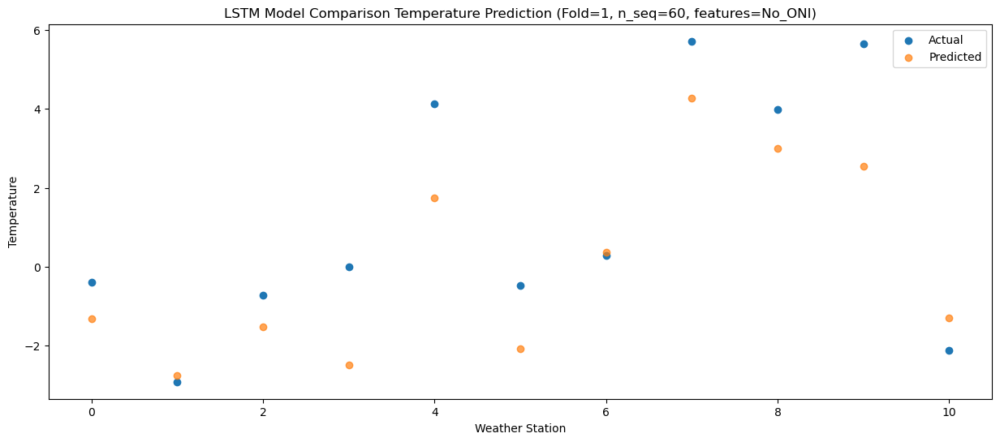

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   4.783975
1                 1    3.08   3.351497
2                 2    6.38   4.578177
3                 3    7.63   3.614836
4                 4   12.18   7.865412
5                 5    6.87   4.020568
6                 6    5.95   6.483252
7                 7   12.64  10.383506
8                 8   11.82   9.109013
9                 9   13.61   8.654144
10               10    2.19   4.806844


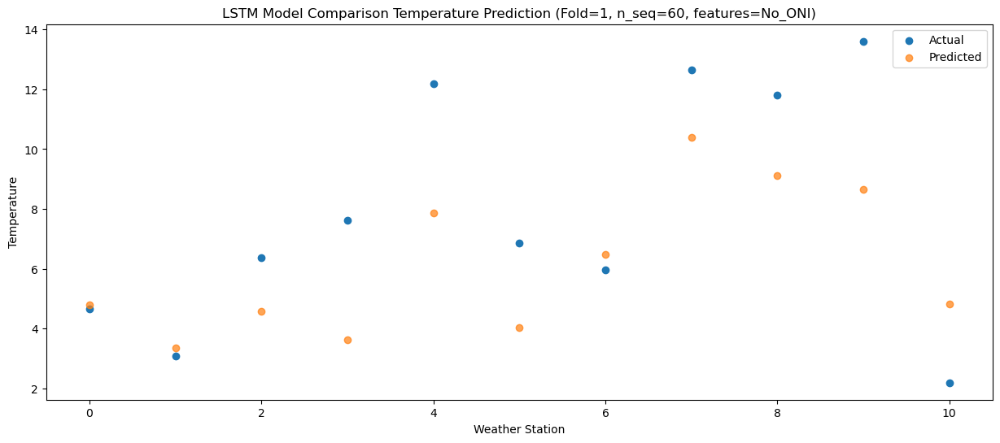

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   6.593956
1                 1    4.30   5.167211
2                 2    5.41   6.394175
3                 3    7.51   5.425294
4                 4   11.92   9.673741
5                 5    9.66   5.822042
6                 6    7.58   8.291311
7                 7   13.78  12.193328
8                 8   13.20  10.918166
9                 9   15.92  10.462982
10               10    3.82   6.617893


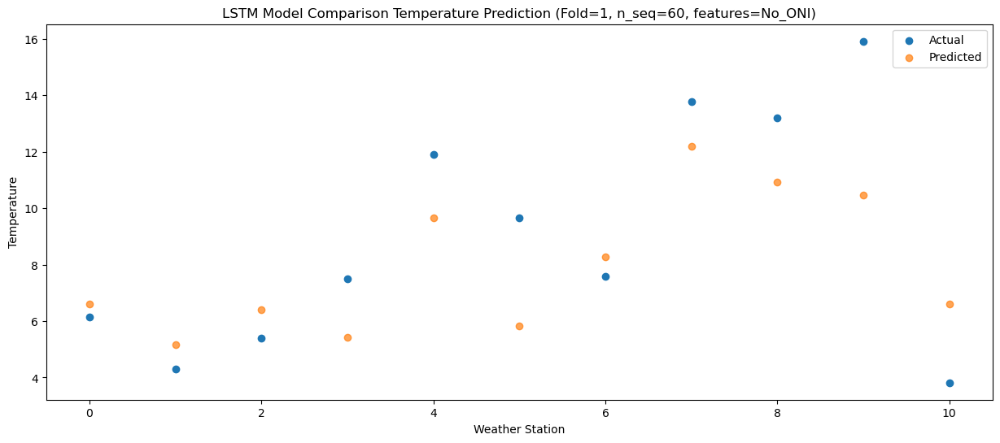

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  11.825824
1                 1    7.65  10.399850
2                 2    9.56  11.626094
3                 3   11.26  10.653726
4                 4   15.72  14.908092
5                 5   14.85  11.061523
6                 6   10.36  13.528508
7                 7   18.28  17.428722
8                 8   19.31  16.153666
9                 9   22.45  15.704618
10               10    9.28  11.859403


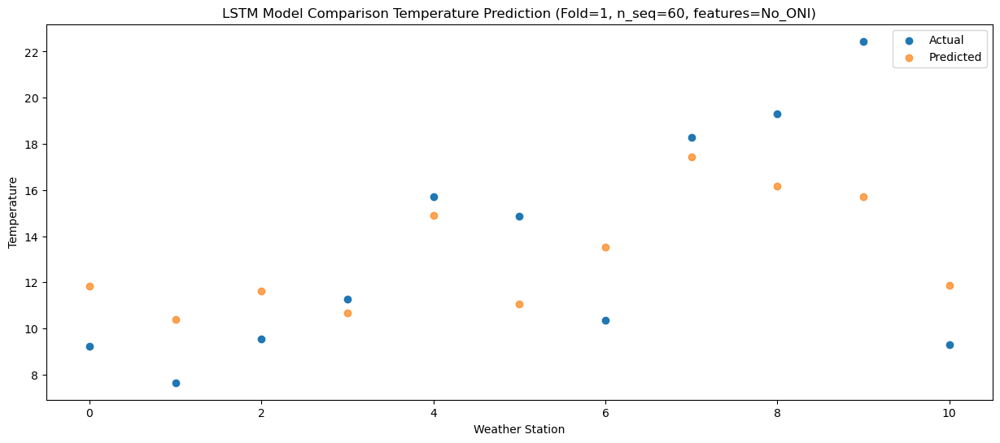

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  17.585221
1                 1   12.00  16.162336
2                 2   13.79  17.386273
3                 3   14.04  16.405181
4                 4   18.75  20.658996
5                 5   17.57  16.811068
6                 6   15.03  19.283604
7                 7   23.84  23.179866
8                 8   24.42  21.897296
9                 9   28.83  21.446066
10               10   16.60  17.609359


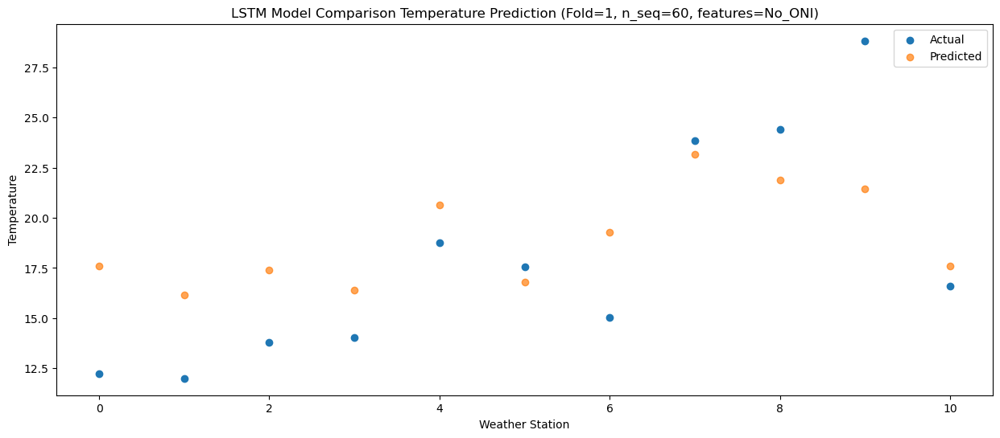

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  20.049347
1                 1   15.37  18.619924
2                 2   15.26  19.837020
3                 3   15.69  18.859409
4                 4   20.79  23.116762
5                 5   20.27  19.271556
6                 6   18.21  21.742052
7                 7   26.38  25.633437
8                 8   26.96  24.348507
9                 9   30.41  23.906654
10               10   20.47  20.071228


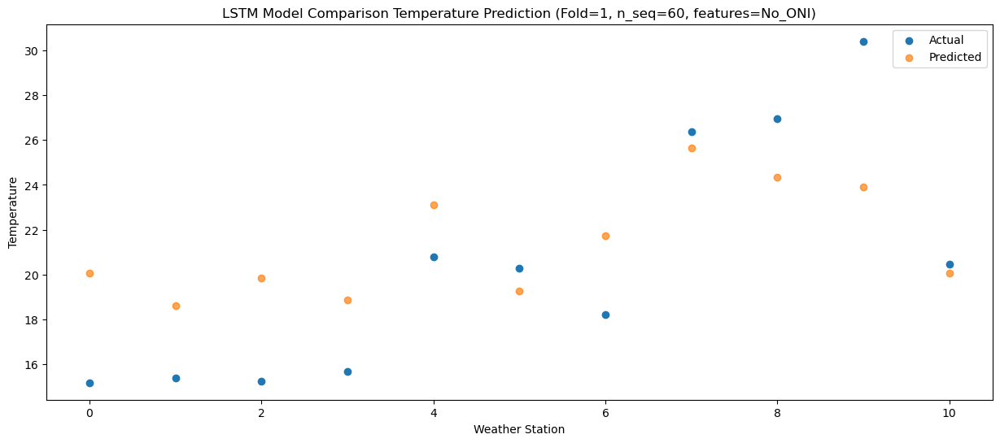

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  18.746203
1                 1   13.96  17.318467
2                 2   15.25  18.536576
3                 3   15.93  17.566730
4                 4   21.03  21.824202
5                 5   20.12  17.981290
6                 6   16.58  20.446163
7                 7   24.36  24.334675
8                 8   26.03  23.043755
9                 9   29.18  22.601468
10               10   18.28  18.764763


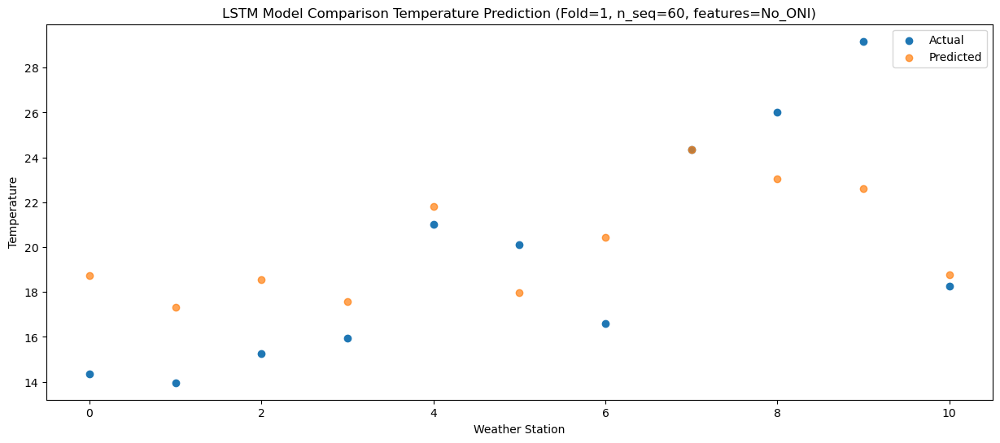

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  14.268297
1                 1   10.42  12.839039
2                 2   12.45  14.060913
3                 3   12.52  13.086585
4                 4   17.45  17.341050
5                 5   12.59  13.493669
6                 6   13.16  15.962152
7                 7   21.06  19.844788
8                 8   19.38  18.549054
9                 9   22.43  18.105744
10               10   13.75  14.275223


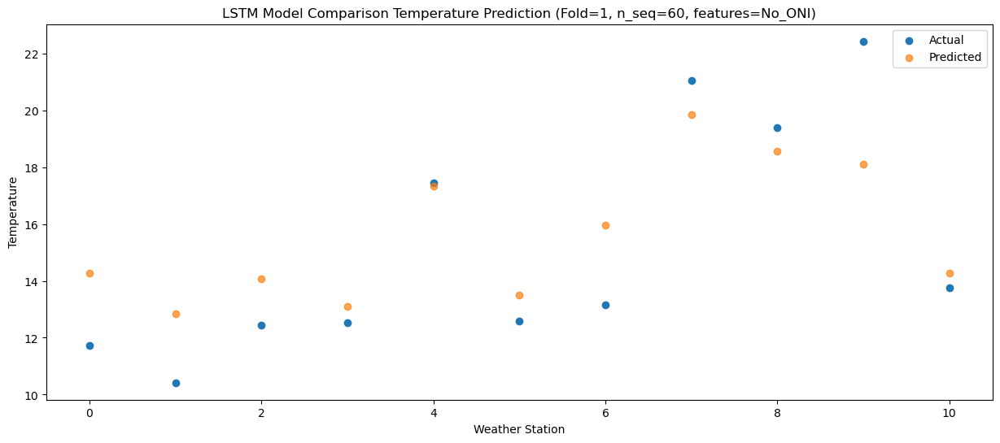

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79   8.526655
1                 1    6.70   7.093378
2                 2    8.10   8.314106
3                 3    7.98   7.336398
4                 4   12.51  11.591222
5                 5    9.75   7.744317
6                 6    9.67  10.213941
7                 7   14.29  14.097016
8                 8   13.20  12.803538
9                 9   15.83  12.365183
10               10    8.21   8.539624


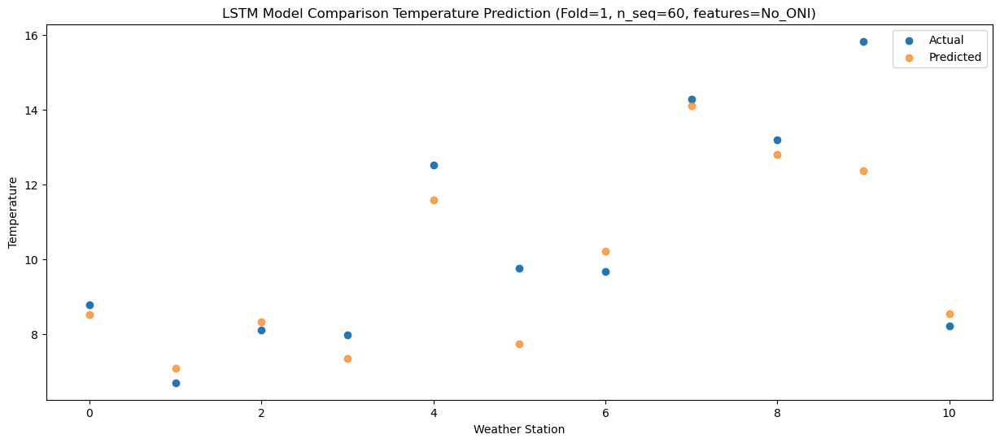

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   4.945082
1                 1    2.60   3.517066
2                 2    3.30   4.732769
3                 3    5.08   3.747504
4                 4    9.41   7.997591
5                 5    6.03   4.147084
6                 6    5.52   6.625166
7                 7   10.62  10.515141
8                 8   10.32   9.223998
9                 9   12.65   8.786200
10               10    4.01   4.959510


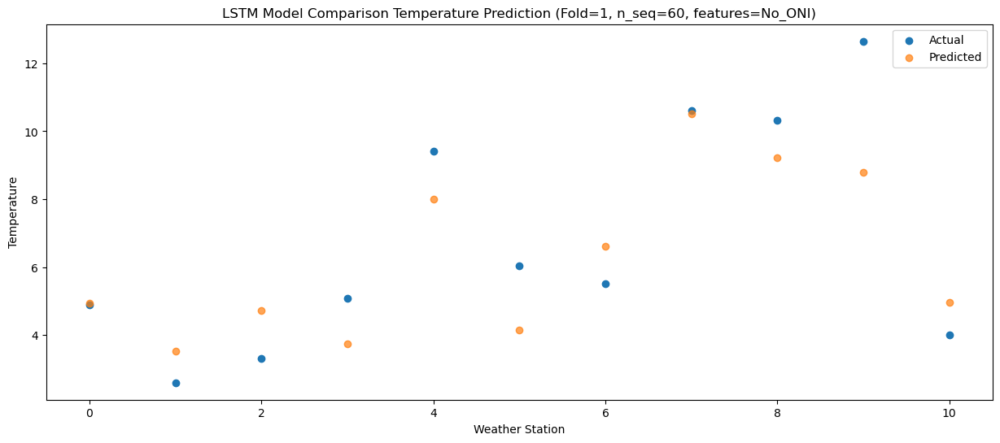

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -1.884497
1                 1   -4.29  -3.310502
2                 2   -3.76  -2.098548
3                 3   -1.10  -3.086051
4                 4    3.05   1.160333
5                 5   -0.72  -2.685434
6                 6   -1.69  -0.209620
7                 7    4.02   3.678549
8                 8    3.64   2.388095
9                 9    5.38   1.949838
10               10   -3.00  -1.865294


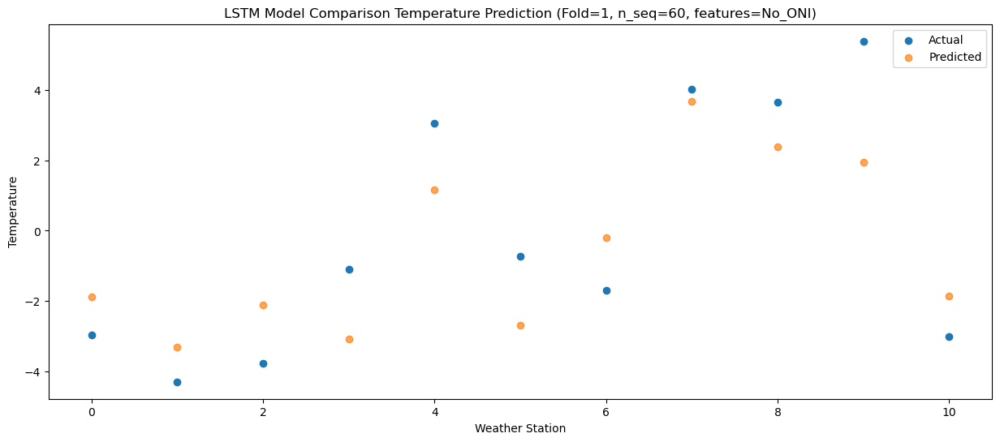

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -2.966383
1                 1   -4.49  -4.397176
2                 2   -3.34  -3.188735
3                 3   -1.20  -4.169541
4                 4    3.04   0.082976
5                 5   -2.23  -3.764359
6                 6   -1.89  -1.294793
7                 7    3.71   2.595875
8                 8    3.29   1.302855
9                 9    5.49   0.865445
10               10   -4.84  -2.956237


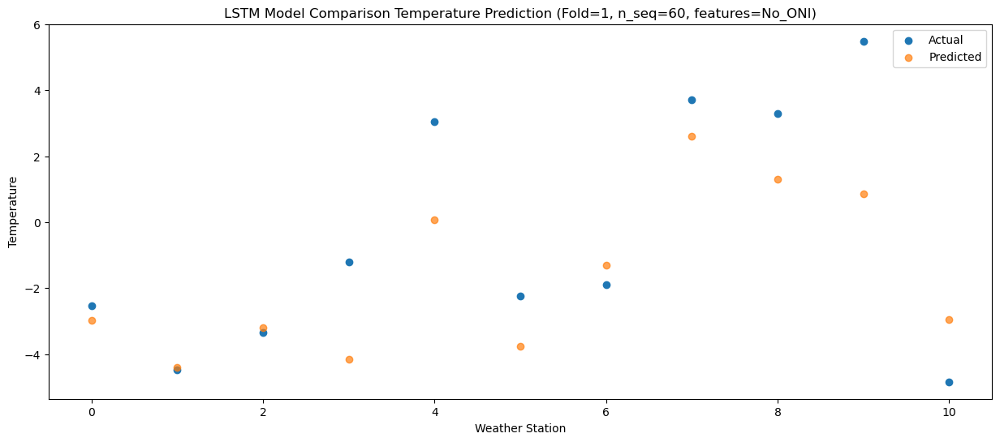

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -5.030161
1                 1   -3.83  -6.462384
2                 2   -2.85  -5.256891
3                 3   -2.79  -6.238409
4                 4    1.34  -1.987410
5                 5   -1.85  -5.834902
6                 6   -1.11  -3.359150
7                 7    0.71   0.534538
8                 8   -1.49  -0.761802
9                 9    1.12  -1.207550
10               10   -5.80  -5.029696


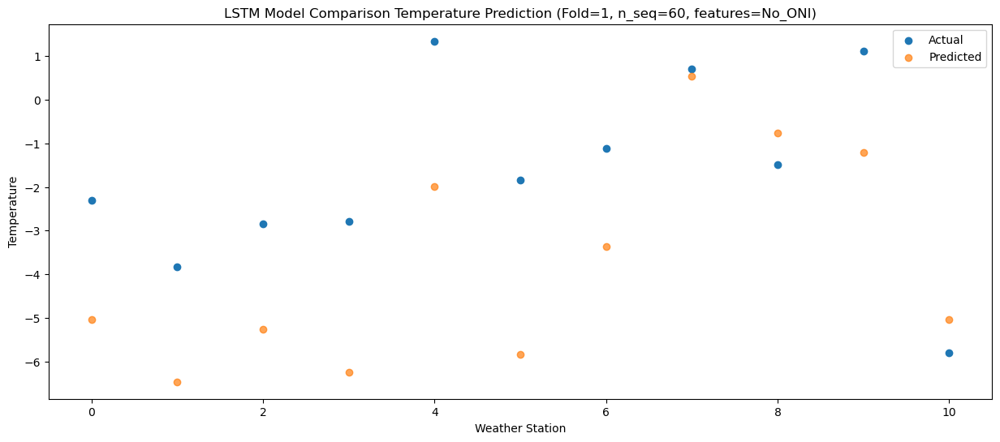

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   3.994886
1                 1    2.94   2.567967
2                 2    4.21   3.777370
3                 3    4.58   2.796427
4                 4    8.95   7.048293
5                 5    5.49   3.196864
6                 6    5.17   5.678329
7                 7   12.03   9.574127
8                 8   11.07   8.280047
9                 9   11.83   7.831083
10               10    1.42   4.010715


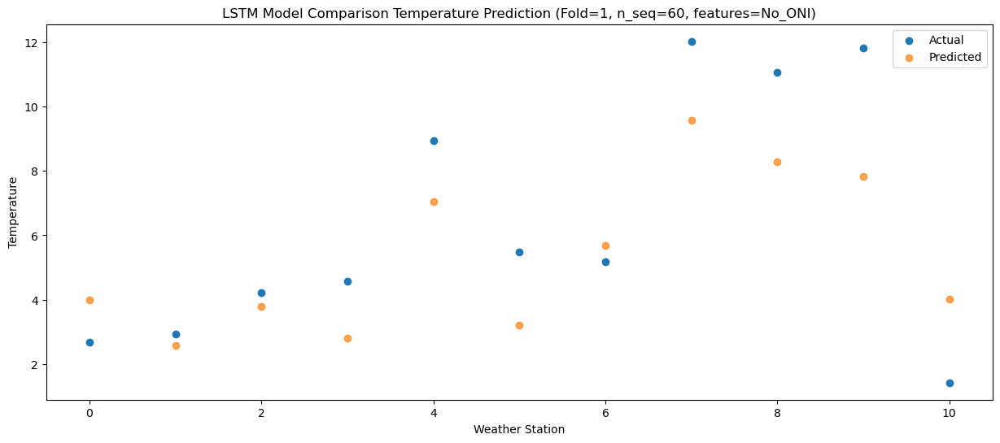

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48   7.187274
1                 1    5.08   5.758535
2                 2    5.61   6.968088
3                 3    6.92   5.987455
4                 4   11.25  10.239392
5                 5    7.76   6.387982
6                 6    7.74   8.866786
7                 7   13.74  12.761903
8                 8   12.87  11.474532
9                 9   15.59  11.029251
10               10    6.07   7.204768


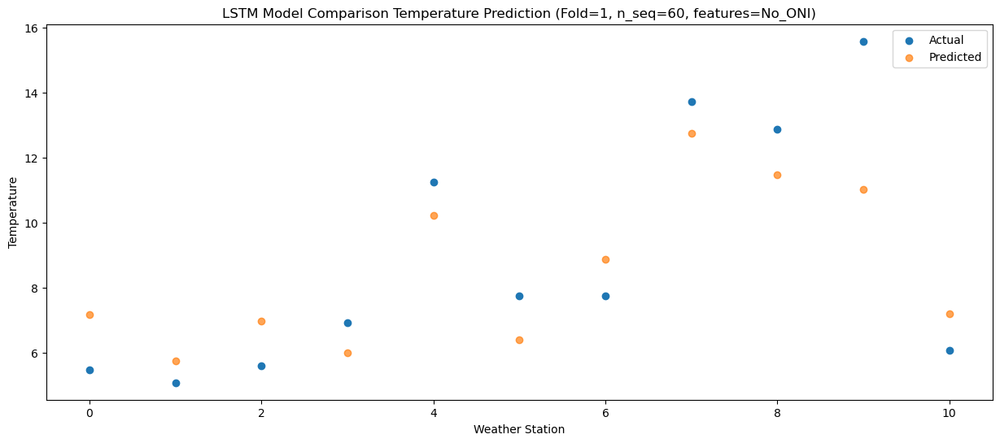

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09  11.724615
1                 1    8.81  10.297646
2                 2    9.73  11.508454
3                 3   10.81  10.522930
4                 4   15.37  14.773397
5                 5   13.35  10.913477
6                 6   11.51  13.400392
7                 7   18.40  17.297521
8                 8   17.68  16.003959
9                 9   20.14  15.553187
10               10   10.61  11.743786


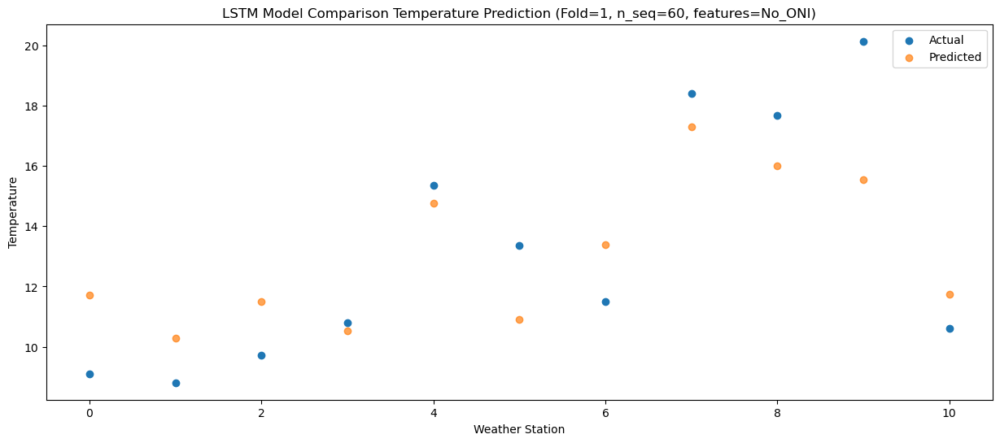

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  17.629818
1                 1   12.95  16.206089
2                 2   13.61  17.422336
3                 3   14.70  16.436011
4                 4   18.84  20.688661
5                 5   17.62  16.831066
6                 6   15.52  19.314173
7                 7   24.48  23.220209
8                 8   23.71  21.933794
9                 9   27.25  21.482357
10               10   16.70  17.672972


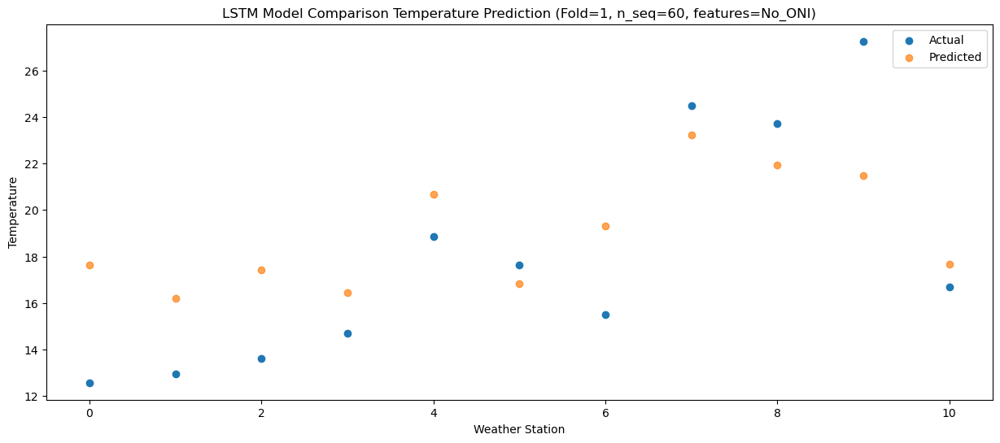

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  18.526562
1                 1   14.33  17.108967
2                 2   14.38  18.328514
3                 3   14.58  17.335997
4                 4   18.93  21.589194
5                 5   16.96  17.731452
6                 6   16.88  20.217899
7                 7   25.47  24.129303
8                 8   25.22  22.844860
9                 9   27.92  22.390955
10               10   18.93  18.584145


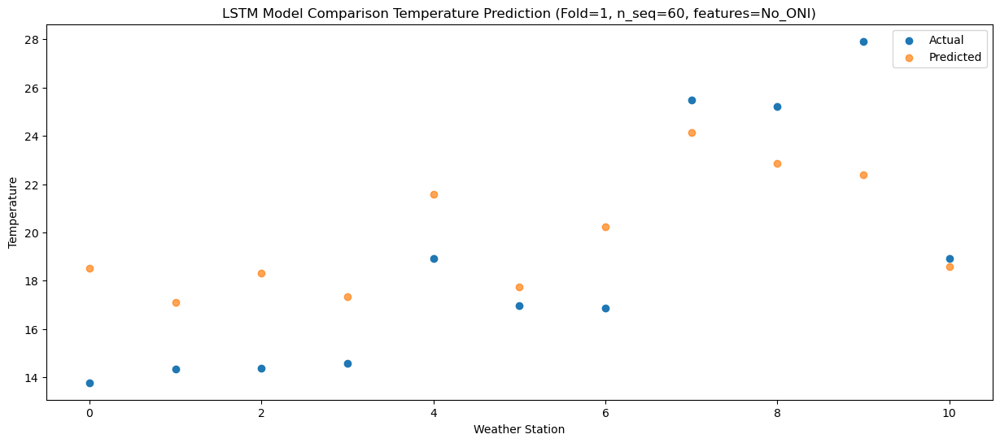

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  18.813835
1                 1   14.60  17.396581
2                 2   15.04  18.616865
3                 3   15.55  17.615359
4                 4   19.90  21.860249
5                 5   16.37  18.000068
6                 6   17.14  20.493128
7                 7   26.69  24.408603
8                 8   25.61  23.118542
9                 9   27.77  22.667403
10               10   18.71  18.858760


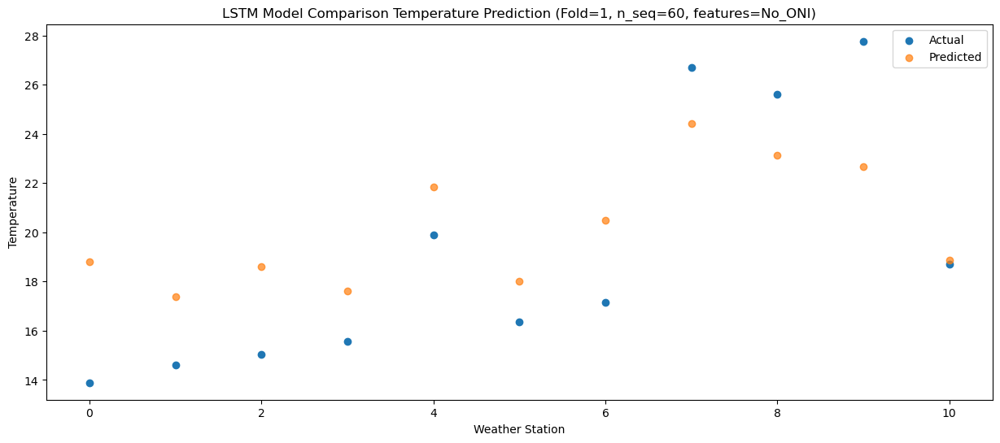

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  15.525173
1                 1   10.86  14.114226
2                 2   12.02  15.332197
3                 3   12.54  14.325582
4                 4   16.32  18.566745
5                 5   16.01  14.713129
6                 6   13.81  17.208894
7                 7   22.98  21.125393
8                 8   23.10  19.837670
9                 9   25.82  19.388077
10               10   15.01  15.581358


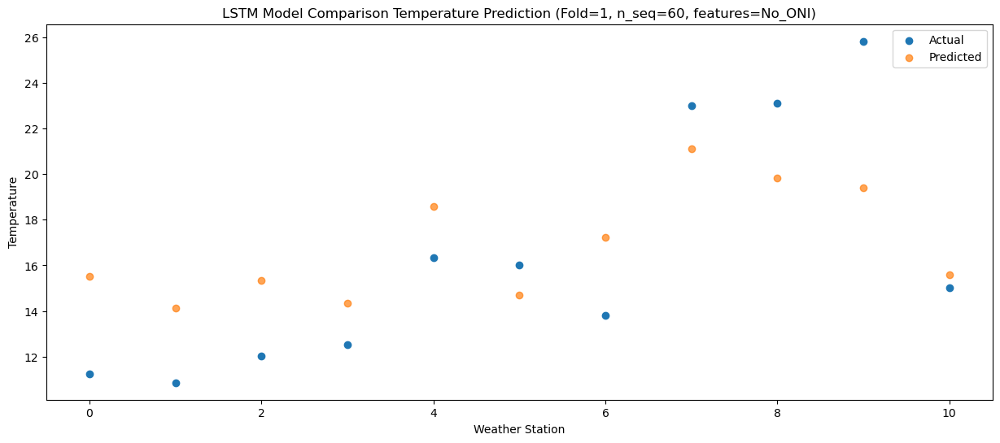

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54  10.948327
1                 1    7.08   9.541484
2                 2    8.24  10.762825
3                 3    9.85   9.746603
4                 4   13.28  13.989728
5                 5   11.69  10.140138
6                 6    9.86  12.634235
7                 7   17.78  16.548160
8                 8   16.85  15.262401
9                 9   18.38  14.813505
10               10   10.59  11.006704


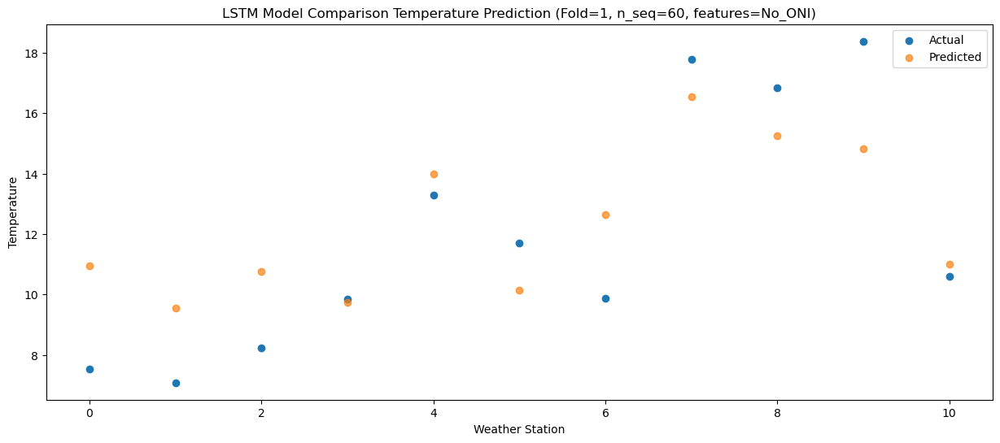

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67   2.603376
1                 1   -0.58   1.198215
2                 2    0.50   2.422170
3                 3    2.69   1.406238
4                 4    5.73   5.653653
5                 5    5.22   1.798733
6                 6    2.26   4.290417
7                 7    8.48   8.204276
8                 8    9.10   6.912346
9                 9   12.13   6.461985
10               10    1.27   2.655457


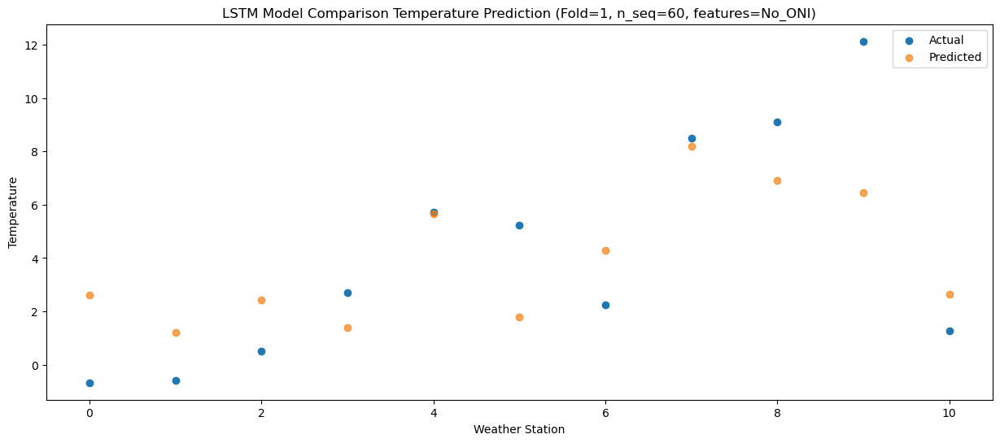

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68   2.191097
1                 1    1.05   0.790362
2                 2    3.10   2.018876
3                 3    6.06   0.995240
4                 4    9.61   5.236974
5                 5    5.48   1.384187
6                 6    3.78   3.879534
7                 7   10.89   7.797217
8                 8    8.29   6.507625
9                 9   10.52   6.055515
10               10    0.50   2.255331


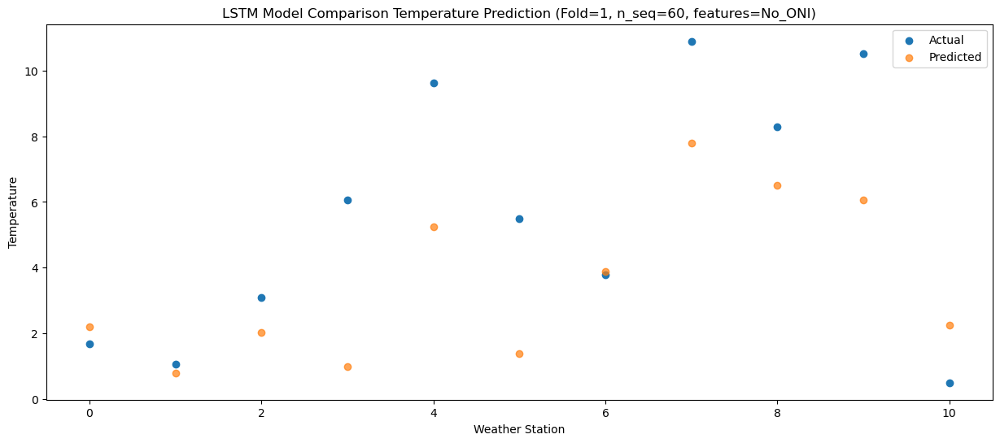

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48  -5.078731
1                 1   -5.68  -6.475520
2                 2   -3.79  -5.249914
3                 3   -1.99  -6.276464
4                 4    1.13  -2.038708
5                 5   -1.84  -5.886885
6                 6   -2.61  -3.388212
7                 7    2.06   0.534652
8                 8    0.67  -0.761436
9                 9    3.60  -1.216676
10               10   -6.52  -5.004280


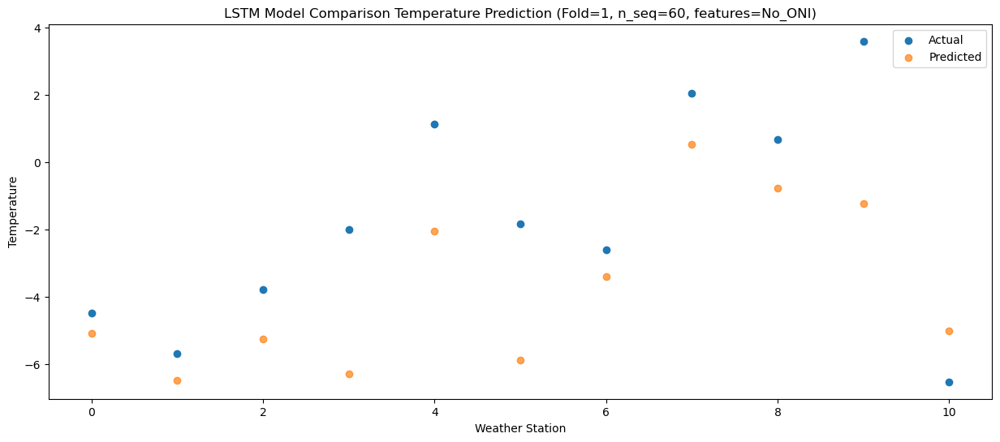

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36  -2.777064
1                 1   -1.45  -4.172328
2                 2   -0.44  -2.947989
3                 3   -2.46  -3.983680
4                 4    0.82   0.252148
5                 5   -1.95  -3.604428
6                 6    1.20  -1.096763
7                 7    4.11   2.827402
8                 8    1.65   1.526285
9                 9    3.66   1.071360
10               10   -2.62  -2.700635


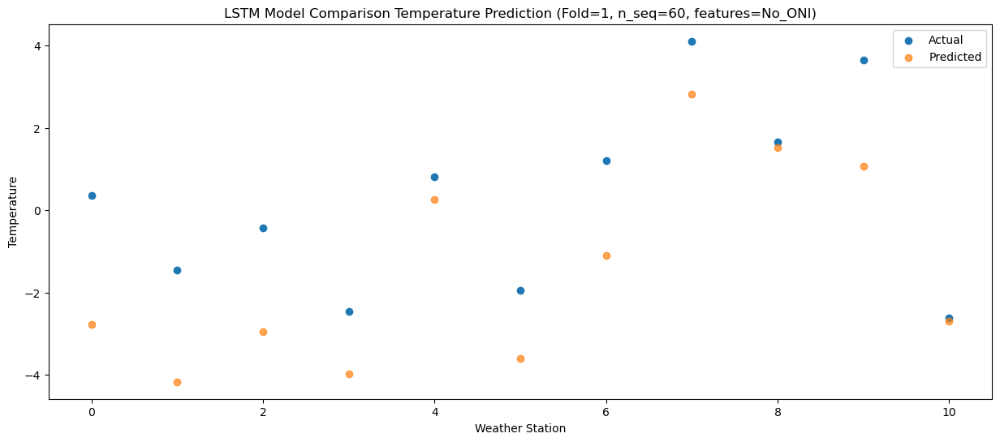

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75   2.933889
1                 1    2.12   1.531658
2                 2    3.56   2.757234
3                 3    3.38   1.718957
4                 4    6.60   5.951199
5                 5    5.00   2.108479
6                 6    5.04   4.608595
7                 7   10.06   8.525443
8                 8    8.90   7.230649
9                 9   10.59   6.784477
10               10    1.94   3.008474


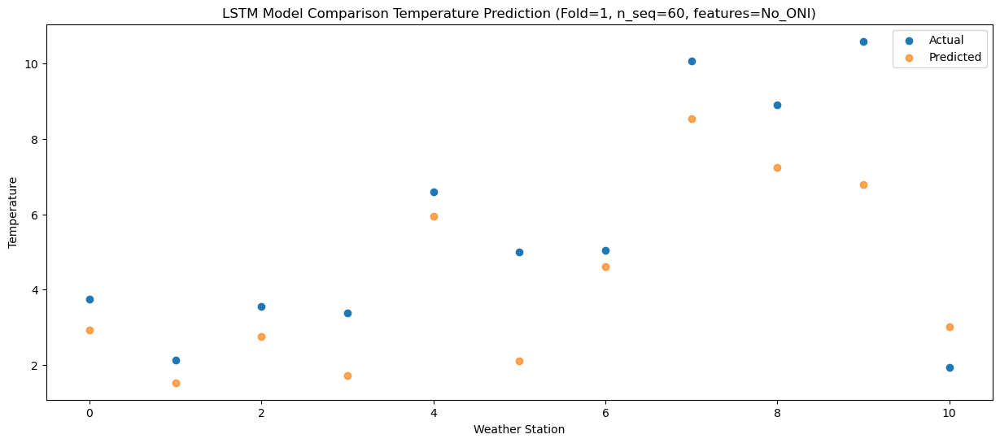

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74   7.562365
1                 1    5.12   6.156953
2                 2    7.15   7.378587
3                 3    9.38   6.341467
4                 4   12.87  10.575048
5                 5   11.91   6.729810
6                 6    7.80   9.228432
7                 7   15.25  13.150915
8                 8   16.01  11.856658
9                 9   17.07  11.406969
10               10    5.29   7.631067


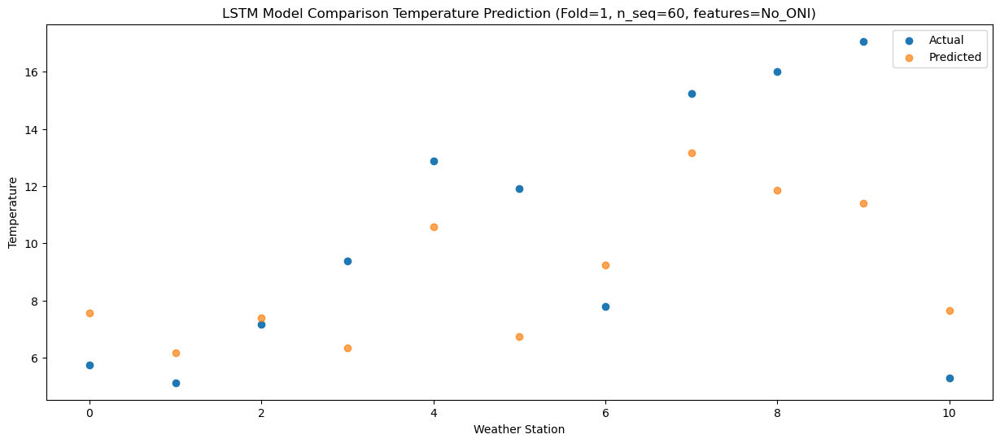

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  13.800088
1                 1   11.00  12.393724
2                 2   12.51  13.613451
3                 3   13.81  12.580560
4                 4   17.49  16.818117
5                 5   17.31  12.979567
6                 6   13.72  15.478184
7                 7   20.72  19.401541
8                 8   21.37  18.108871
9                 9   22.52  17.660165
10               10   12.27  13.880452


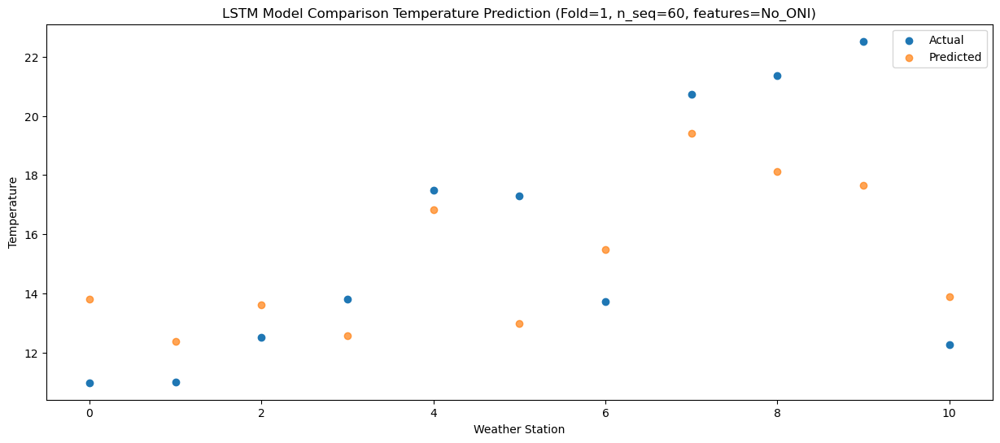

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  18.033041
1                 1   14.97  16.626969
2                 2   15.48  17.851000
3                 3   16.81  16.817179
4                 4   20.86  21.058175
5                 5   19.37  17.224834
6                 6   17.30  19.714835
7                 7   24.78  23.644058
8                 8   25.66  22.350207
9                 9   27.09  21.898669
10               10   16.66  18.118498


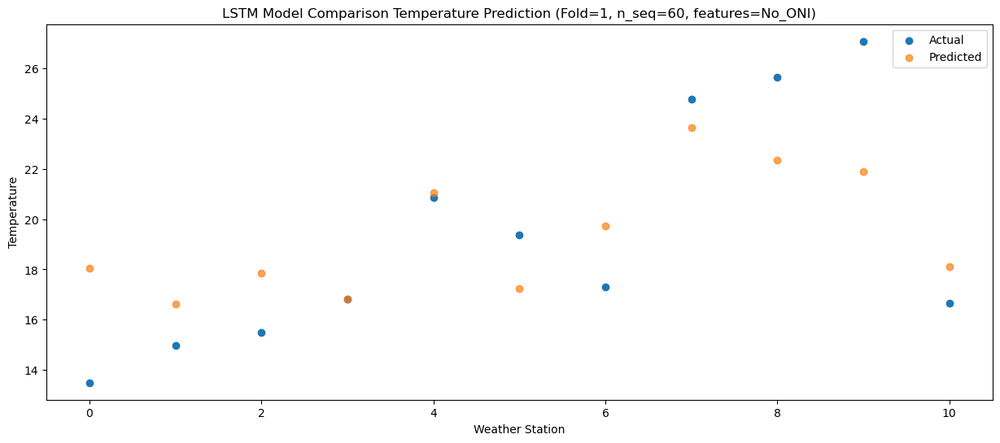

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  20.304473
1                 1   15.47  18.899221
2                 2   16.19  20.118712
3                 3   17.75  19.087786
4                 4   21.95  23.322367
5                 5   20.29  19.493505
6                 6   18.04  21.985605
7                 7   28.91  25.914193
8                 8   29.81  24.620607
9                 9   30.69  24.180752
10               10   20.60  20.400119


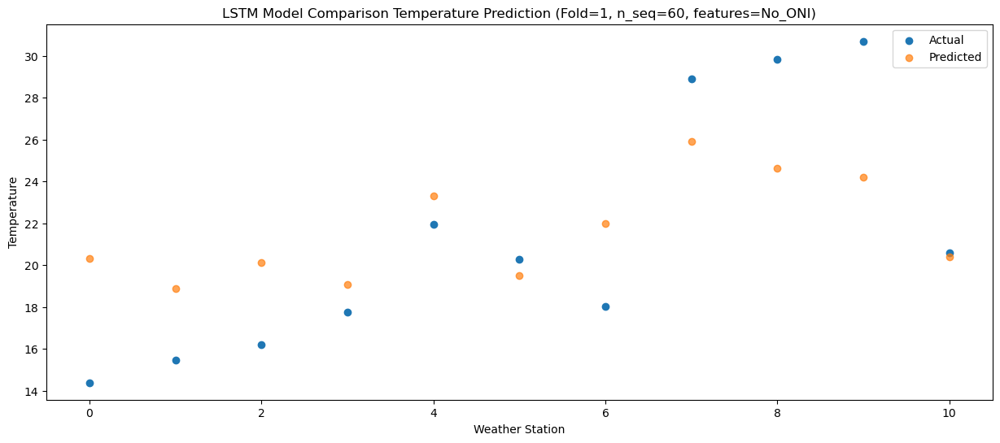

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  18.869642
1                 1   14.01  17.464568
2                 2   14.58  18.684535
3                 3   16.11  17.645902
4                 4   19.94  21.875638
5                 5   17.44  18.046518
6                 6   16.54  20.539499
7                 7   26.04  24.469836
8                 8   27.14  23.177323
9                 9   27.86  22.735379
10               10   20.06  18.958870


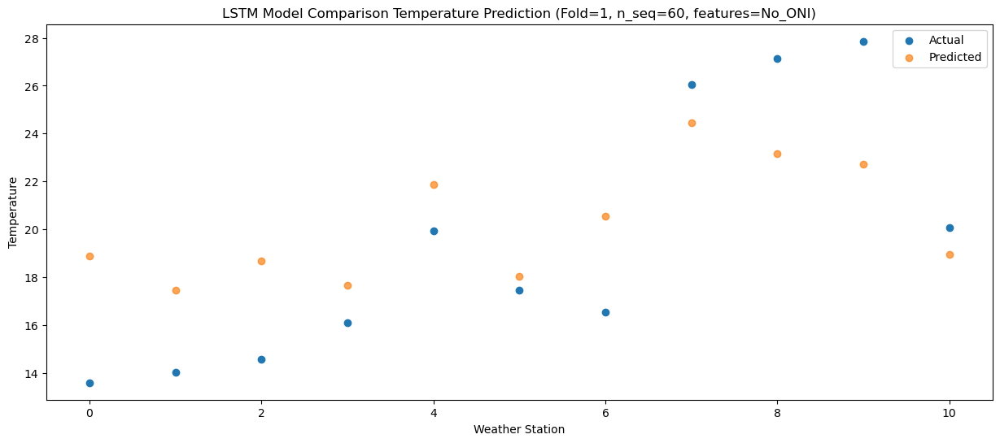

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  15.208738
1                 1   10.92  13.803272
2                 2   12.19  15.020099
3                 3   13.34  13.984006
4                 4   16.76  18.213698
5                 5   14.39  14.381008
6                 6   13.65  16.869164
7                 7   22.20  20.798082
8                 8   23.31  19.510230
9                 9   25.45  19.067819
10               10   15.15  15.284467


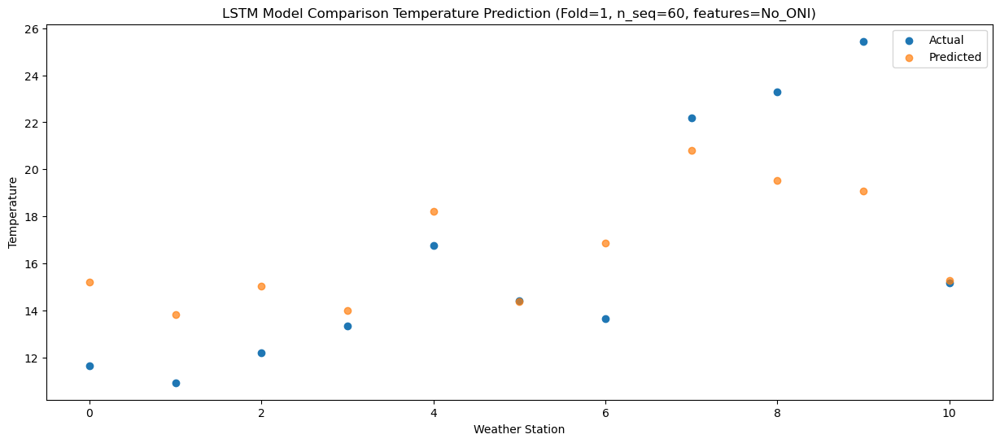

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08   8.416290
1                 1    4.58   7.007145
2                 2    5.50   8.222978
3                 3    7.78   7.188586
4                 4   11.37  11.420886
5                 5    8.31   7.594921
6                 6    7.31  10.079747
7                 7   15.53  14.008115
8                 8   15.08  12.728364
9                 9   16.91  12.293937
10               10    7.05   8.499041


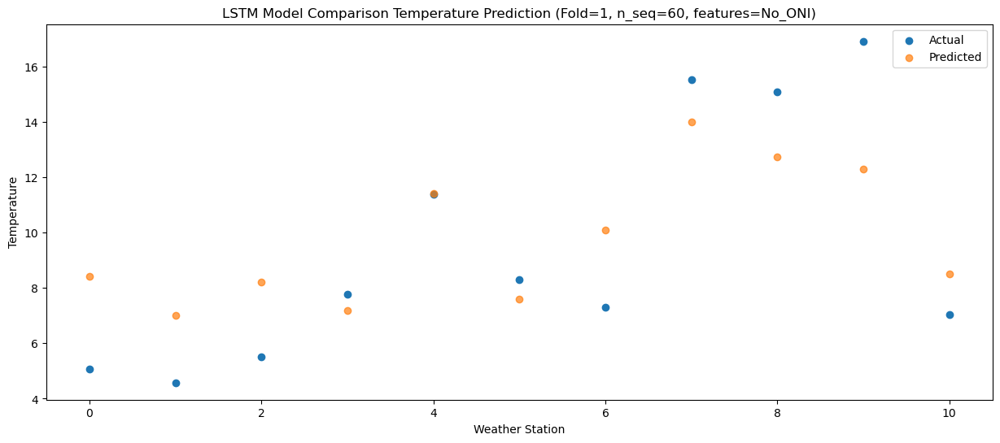

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88   3.029433
1                 1    1.58   1.615957
2                 2    2.18   2.827003
3                 3    2.73   1.792166
4                 4    6.37   6.021836
5                 5    1.35   2.191909
6                 6    4.42   4.679763
7                 7    8.93   8.611403
8                 8    7.23   7.326622
9                 9    7.92   6.889148
10               10    3.54   3.105732


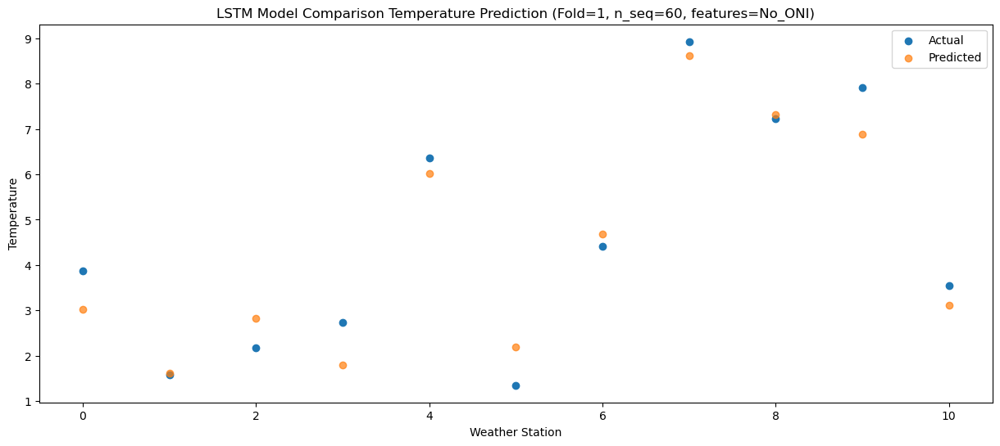

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88  -2.041408
1                 1   -4.23  -3.457486
2                 2   -0.98  -2.246470
3                 3    0.64  -3.277988
4                 4    4.35   0.952986
5                 5    0.23  -2.868848
6                 6   -1.59  -0.387163
7                 7    5.19   3.543704
8                 8    3.60   2.264534
9                 9    5.57   1.833214
10               10   -3.61  -1.962103


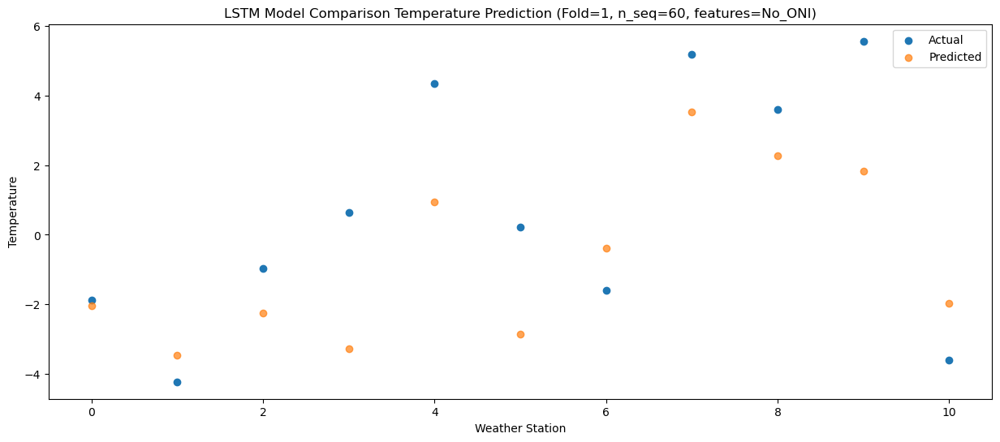

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23  -0.527021
1                 1   -2.04  -1.941764
2                 2    0.02  -0.733975
3                 3    1.35  -1.769288
4                 4    4.83   2.456511
5                 5    0.69  -1.362605
6                 6    0.54   1.126142
7                 7    6.38   5.052407
8                 8    4.46   3.774440
9                 9    5.85   3.344973
10               10   -0.65  -0.440498


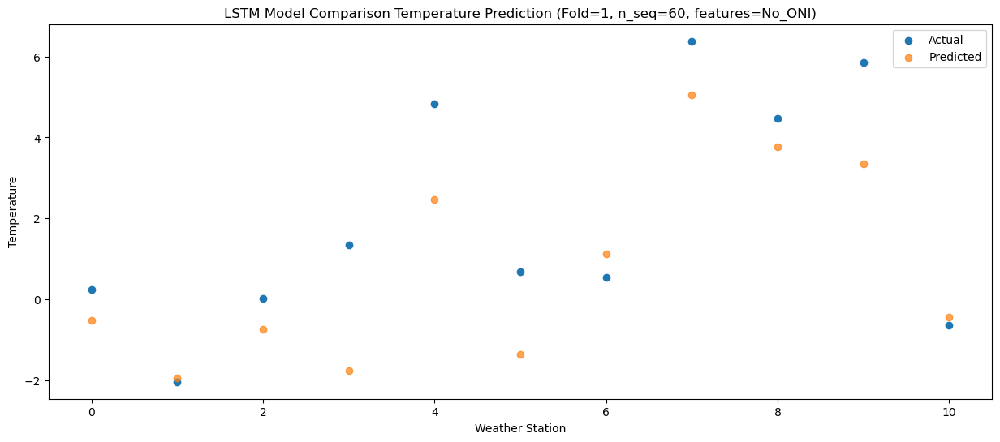

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14   0.488882
1                 1    1.33  -0.927648
2                 2    2.61   0.272118
3                 3    2.35  -0.765334
4                 4    6.01   3.455549
5                 5    0.83  -0.367437
6                 6    4.13   2.130417
7                 7    7.88   6.055328
8                 8    4.83   4.774119
9                 9    7.00   4.343421
10               10   -0.97   0.575935


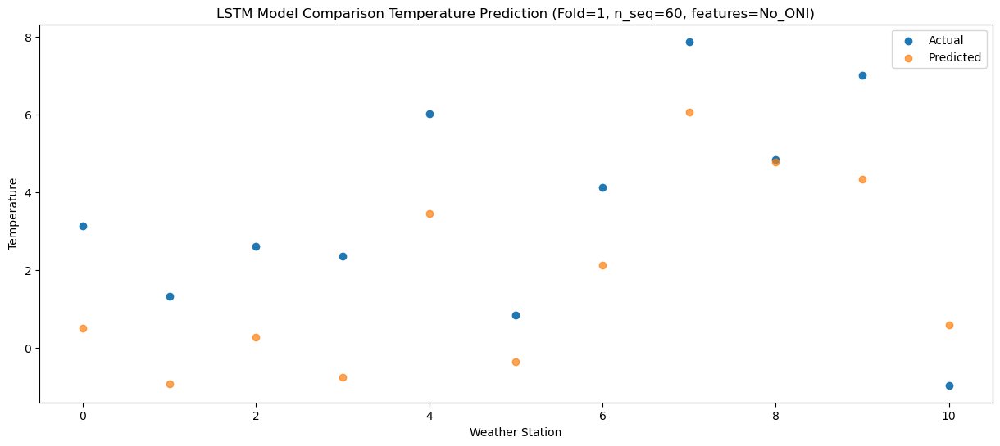

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78   2.590225
1                 1    2.10   1.175893
2                 2    4.04   2.374019
3                 3    6.18   1.331820
4                 4    9.83   5.549335
5                 5    5.89   1.722870
6                 6    4.80   4.225880
7                 7   10.71   8.151521
8                 8    9.26   6.862737
9                 9   10.73   6.431698
10               10    0.15   2.665021


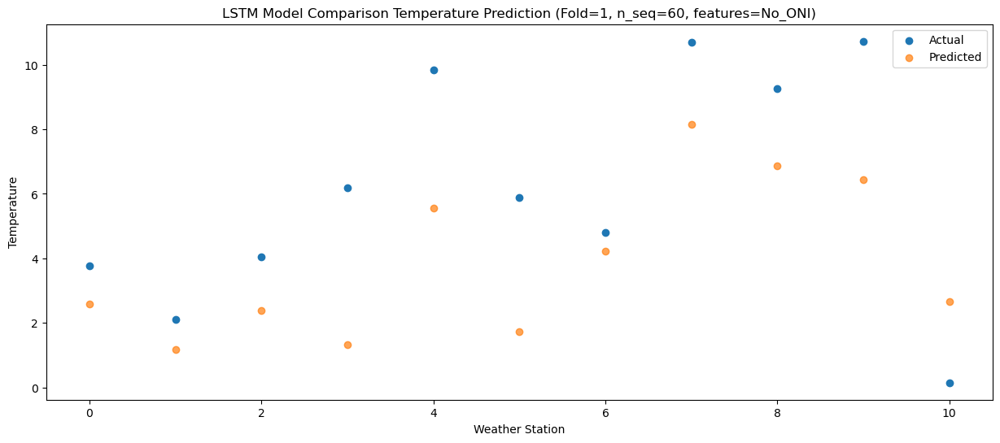

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28   7.955953
1                 1    5.37   6.537795
2                 2    6.73   7.735650
3                 3    7.02   6.696670
4                 4   10.79  10.915784
5                 5    9.05   7.088706
6                 6    8.06   9.585396
7                 7   15.11  13.518952
8                 8   13.59  12.233943
9                 9   16.08  11.802998
10               10    7.37   8.032767


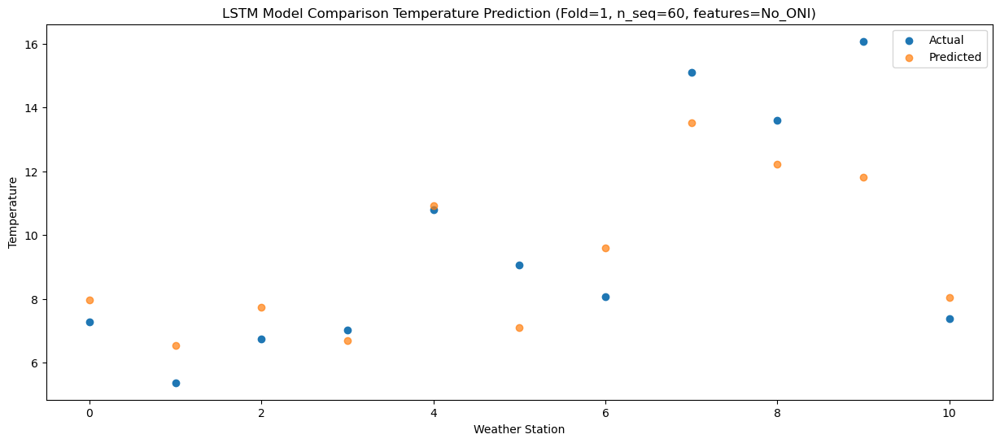

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78  12.665836
1                 1    8.65  11.250944
2                 2    9.97  12.446460
3                 3   11.61  11.402590
4                 4   15.43  15.620011
5                 5   13.66  11.784908
6                 6   11.06  14.292750
7                 7   20.46  18.228873
8                 8   19.28  16.934602
9                 9   21.19  16.497105
10               10    9.93  12.736601


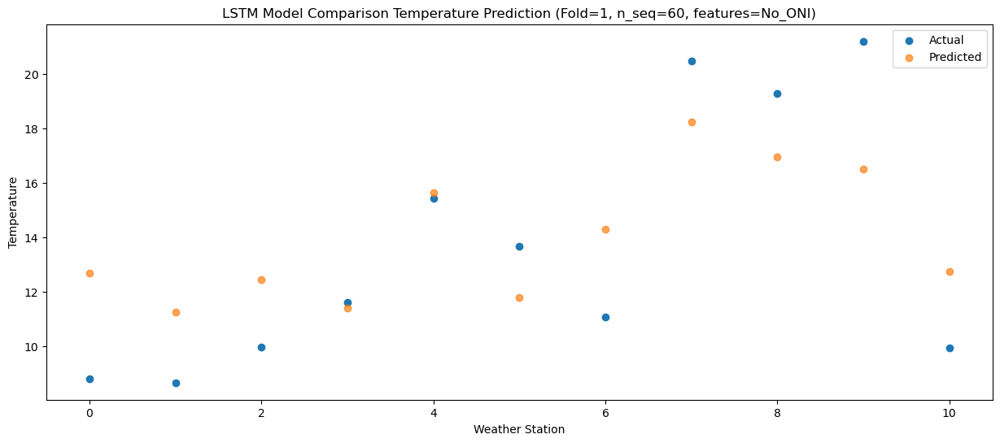

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  16.794247
1                 1   11.84  15.384572
2                 2   13.72  16.584119
3                 3   15.76  15.539345
4                 4   20.32  19.758860
5                 5   20.35  15.928391
6                 6   14.34  18.438947
7                 7   24.27  22.374284
8                 8   24.21  21.071485
9                 9   24.42  20.636141
10               10   14.30  16.872096


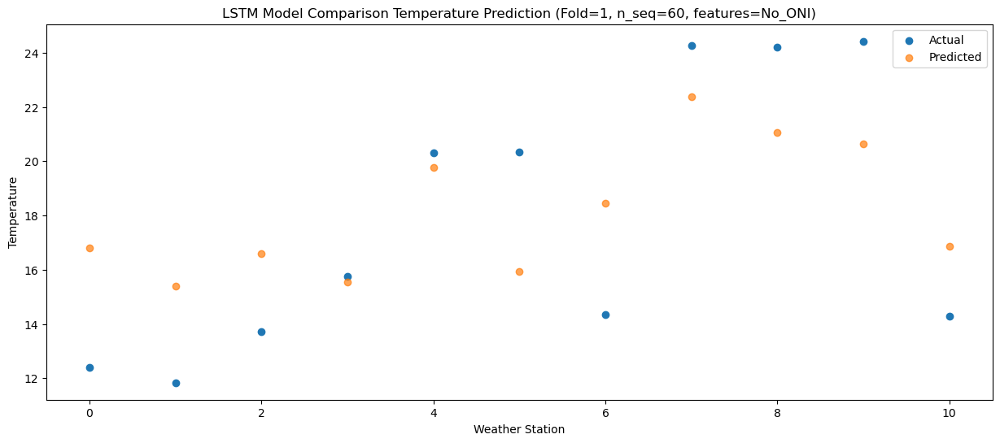

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  19.919543
1                 1   15.44  18.513121
2                 2   16.09  19.713656
3                 3   17.48  18.670801
4                 4   22.27  22.885832
5                 5   21.45  19.059245
6                 6   17.79  21.565844
7                 7   26.57  25.499772
8                 8   27.09  24.193331
9                 9   29.04  23.755953
10               10   19.44  19.997375


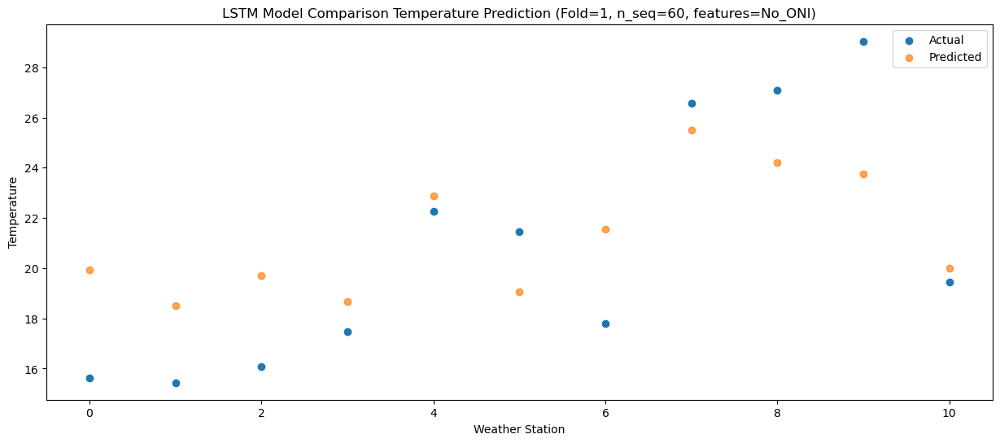

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  19.412732
1                 1   14.90  18.006997
2                 2   16.53  19.210684
3                 3   19.45  18.165008
4                 4   23.70  22.376469
5                 5   20.64  18.554500
6                 6   17.37  21.060070
7                 7   27.07  24.992800
8                 8   28.90  23.686757
9                 9   29.44  23.244548
10               10   17.70  19.488854


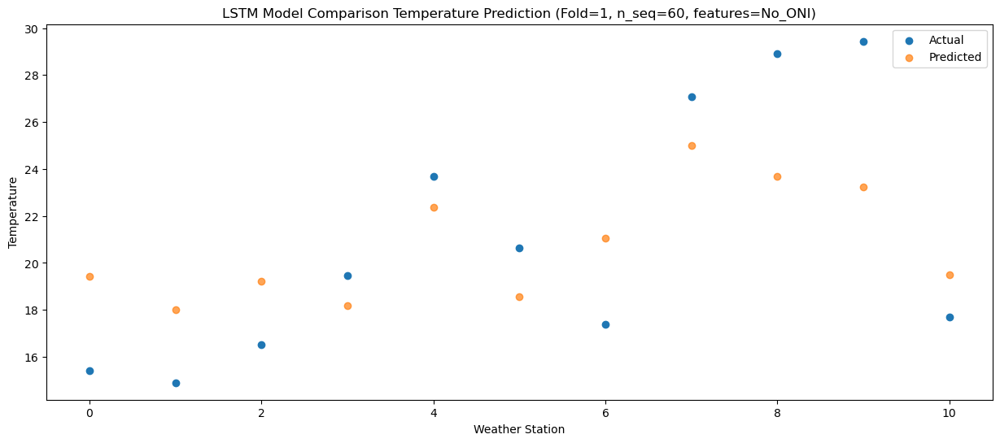

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73  15.974843
1                 1   11.39  14.574629
2                 2   13.57  15.775923
3                 3   16.37  14.730730
4                 4   19.85  18.943328
5                 5   18.36  15.125011
6                 6   14.20  17.633431
7                 7   23.45  21.564067
8                 8   24.26  20.254676
9                 9   25.92  19.815043
10               10   14.51  16.058601


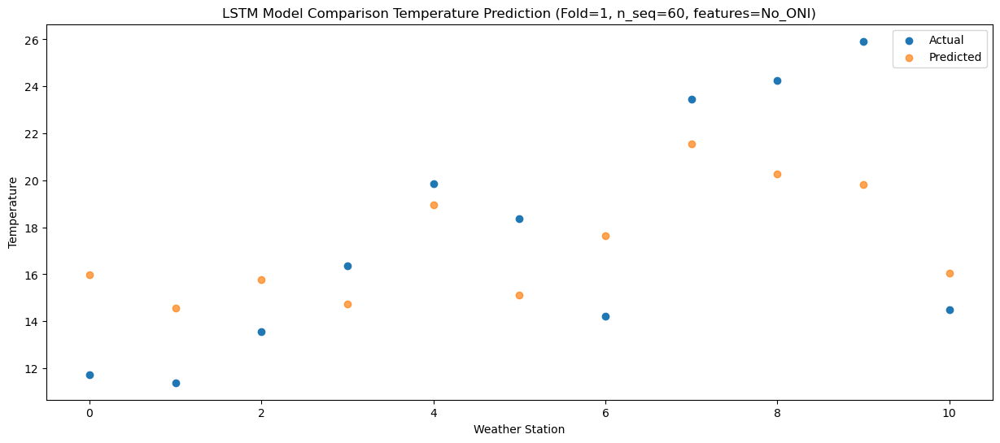

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85   9.714688
1                 1    6.38   8.311781
2                 2    7.53   9.512674
3                 3    9.11   8.469446
4                 4   12.45  12.682195
5                 5   10.76   8.862668
6                 6    9.19  11.361905
7                 7   17.14  15.300527
8                 8   15.68  13.995139
9                 9   17.82  13.560156
10               10    9.16   9.794032


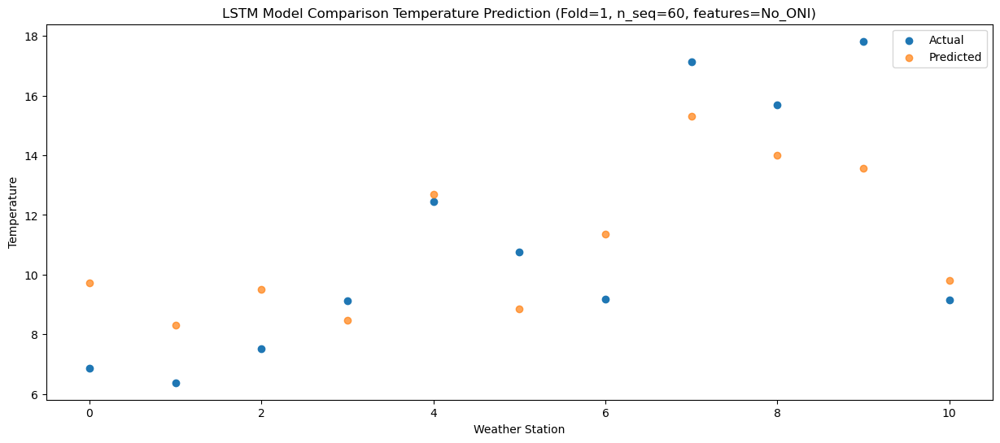

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70   3.173614
1                 1    0.76   1.769835
2                 2    0.97   2.970659
3                 3    2.83   1.932614
4                 4    6.25   6.151501
5                 5    4.10   2.324750
6                 6    3.50   4.818926
7                 7    9.74   8.761684
8                 8    8.56   7.459862
9                 9   11.07   7.024248
10               10    1.22   3.249552


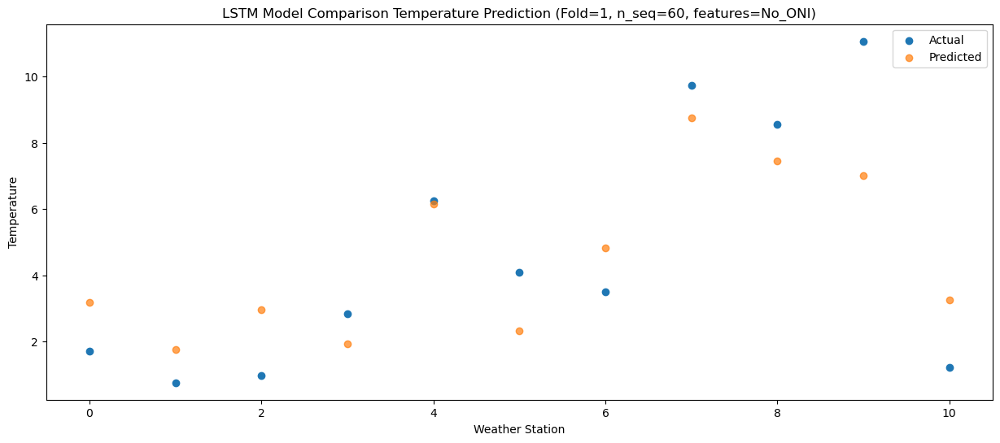

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33   0.957214
1                 1   -2.38  -0.446446
2                 2   -1.81   0.753772
3                 3    0.43  -0.283868
4                 4    4.35   3.936196
5                 5    1.74   0.108888
6                 6    0.76   2.606734
7                 7    6.82   6.550543
8                 8    5.71   5.247129
9                 9    7.24   4.807706
10               10   -0.47   1.038725


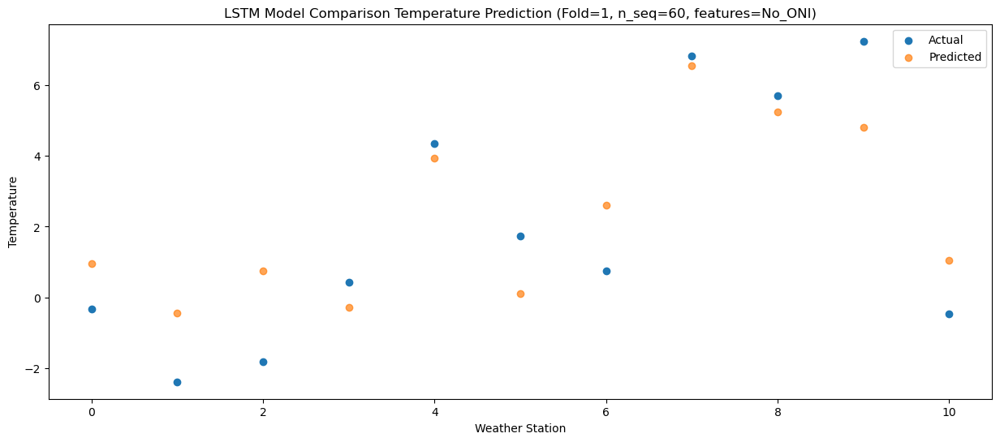

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -3.845016
1                 1   -5.66  -5.252742
2                 2   -4.89  -4.054050
3                 3   -2.99  -5.092334
4                 4    0.50  -0.868691
5                 5   -1.87  -4.695678
6                 6   -2.24  -2.202068
7                 7    0.89   1.746924
8                 8   -0.12   0.447076
9                 9    2.07   0.013211
10               10   -4.37  -3.756959


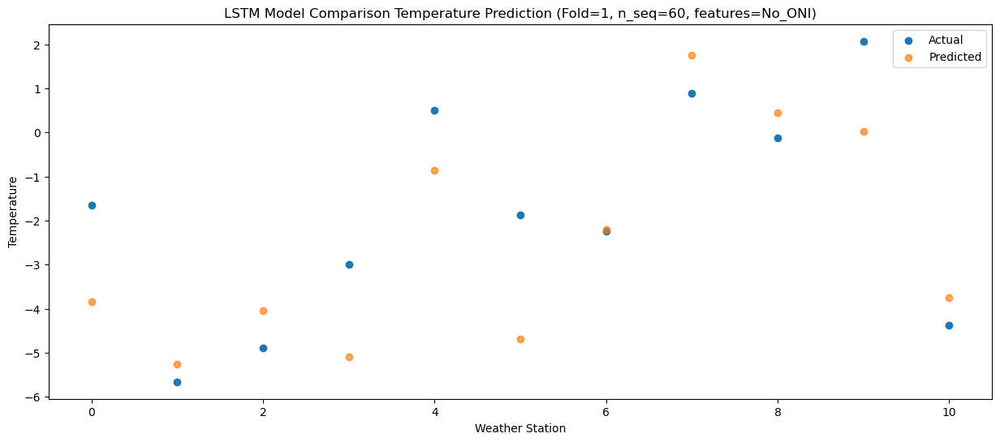

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27   1.231220
1                 1   -0.58  -0.177750
2                 2    0.45   1.019262
3                 3    3.32  -0.011229
4                 4    6.87   4.217434
5                 5    4.25   0.395329
6                 6    1.97   2.876834
7                 7    9.89   6.830281
8                 8    7.83   5.534779
9                 9    9.78   5.106765
10               10   -2.42   1.331210


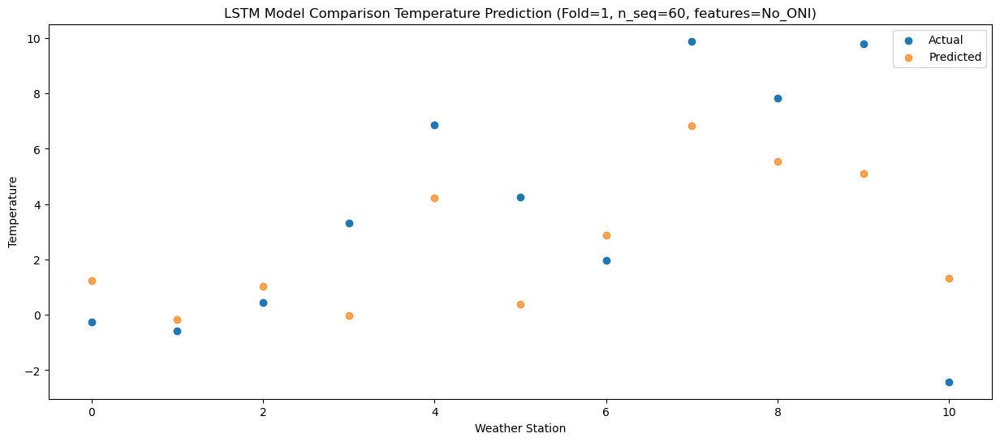

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58   4.489346
1                 1    2.64   3.079636
2                 2    3.55   4.278732
3                 3    5.83   3.245305
4                 4    9.61   7.472282
5                 5    6.60   3.653781
6                 6    5.63   6.136153
7                 7   12.61  10.086242
8                 8   11.07   8.789678
9                 9   12.61   8.364241
10               10    1.98   4.587447


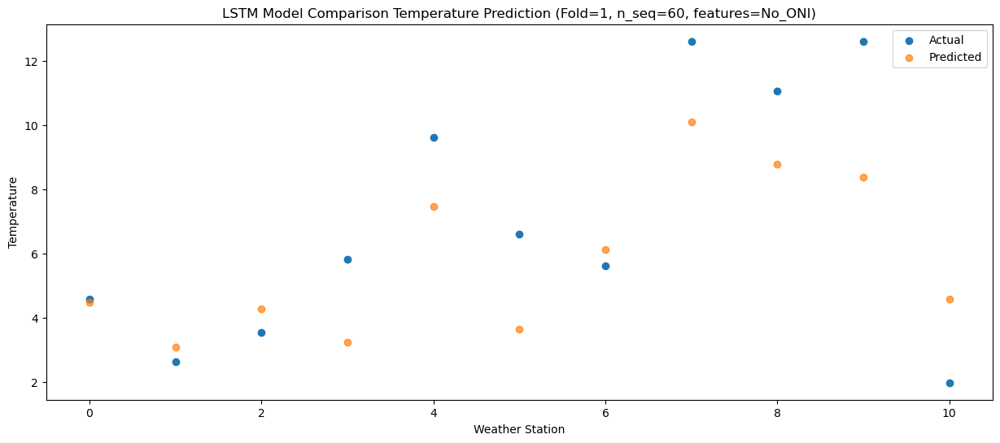

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98   8.758566
1                 1    6.31   7.353468
2                 2    6.89   8.551308
3                 3    9.31   7.512457
4                 4   13.17  11.738570
5                 5   11.40   7.912125
6                 6    9.10  10.409093
7                 7   16.65  14.358670
8                 8   15.75  13.058978
9                 9   17.68  12.630440
10               10    6.37   8.864442


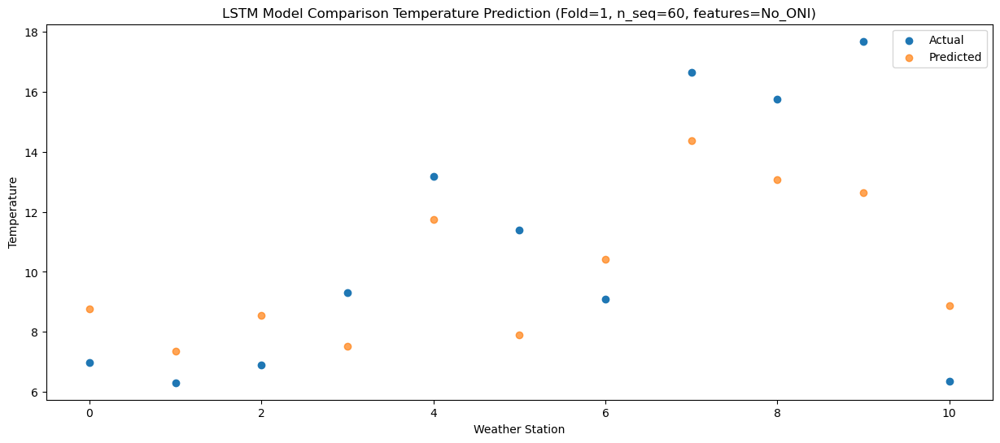

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  14.134936
1                 1   10.88  12.725284
2                 2   12.50  13.922156
3                 3   13.01  12.880685
4                 4   16.87  17.105486
5                 5   17.02  13.284517
6                 6   13.34  15.782137
7                 7   22.19  19.722586
8                 8   20.51  18.423869
9                 9   21.82  18.001452
10               10   11.96  14.236686


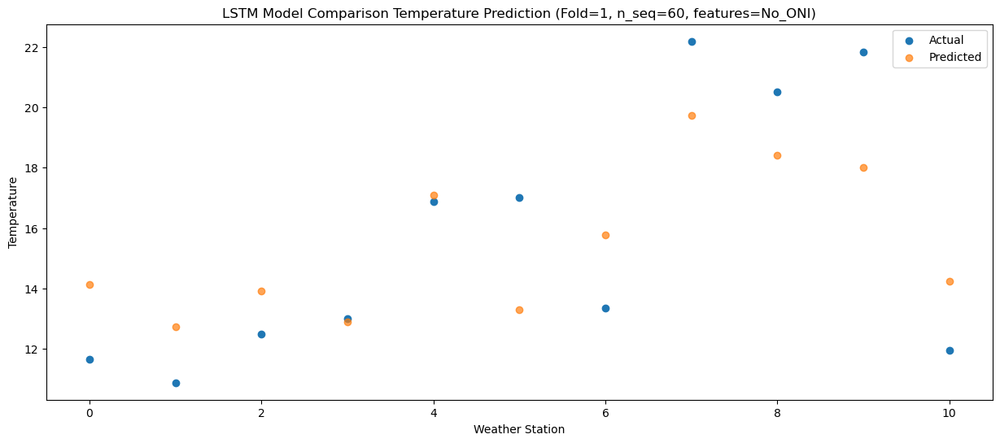

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  18.573390
1                 1   14.64  17.155508
2                 2   15.61  18.350065
3                 3   15.64  17.305347
4                 4   19.76  21.524757
5                 5   19.88  17.703582
6                 6   17.27  20.199964
7                 7   25.26  24.135884
8                 8   26.21  22.828830
9                 9   28.23  22.415211
10               10   18.07  18.658584


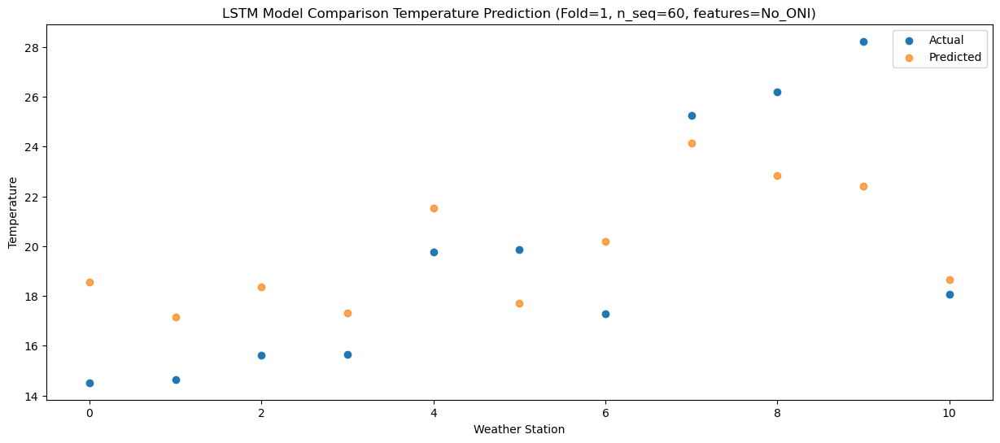

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  19.771873
1                 1   15.57  18.359054
2                 2   15.63  19.554910
3                 3   15.03  18.511452
4                 4   19.57  22.733610
5                 5   18.88  18.925233
6                 6   18.30  21.416585
7                 7   25.90  25.344954
8                 8   27.06  24.038454
9                 9   28.96  23.621804
10               10   20.00  19.865106


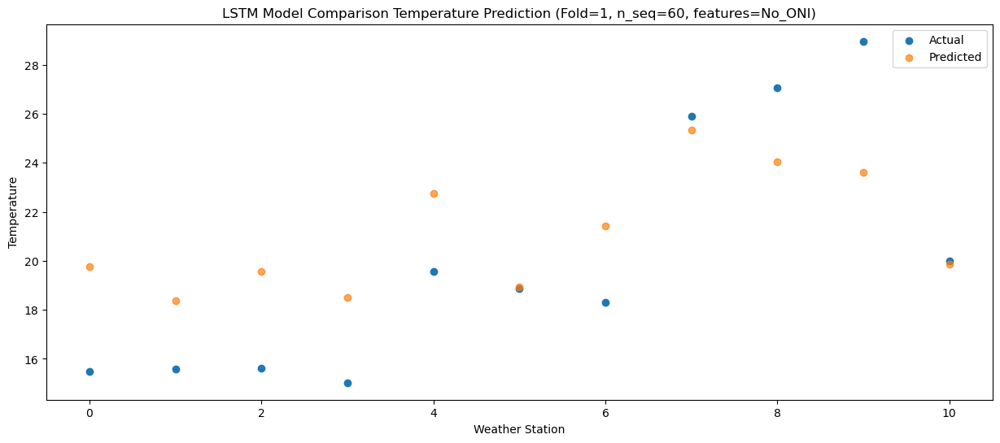

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  19.155113
1                 1   15.29  17.742385
2                 2   15.94  18.940672
3                 3   16.16  17.893036
4                 4   20.89  22.107457
5                 5   20.48  18.297818
6                 6   17.97  20.792453
7                 7   26.31  24.720534
8                 8   29.17  23.413276
9                 9   29.76  22.994470
10               10   17.85  19.243116


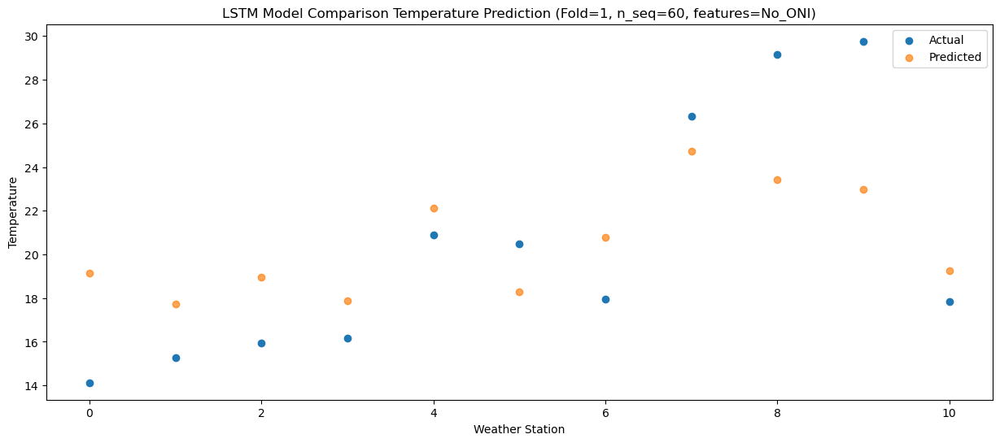

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  15.864188
1                 1   11.57  14.453148
2                 2   13.63  15.650966
3                 3   13.56  14.601673
4                 4   17.60  18.810691
5                 5   14.77  15.014167
6                 6   14.67  17.508730
7                 7   24.44  21.434263
8                 8   23.20  20.124493
9                 9   25.20  19.709534
10               10   14.12  15.960739


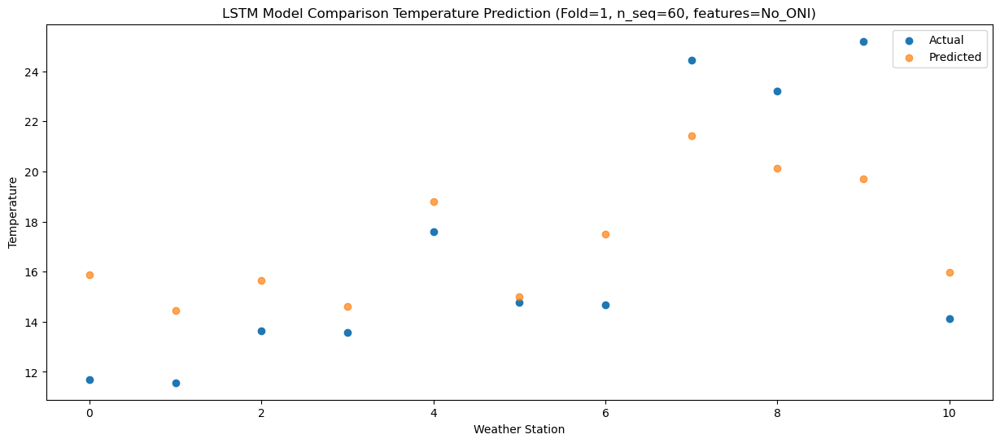

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81  11.160835
1                 1    7.12   9.749555
2                 2    8.63  10.947617
3                 3   10.87   9.887979
4                 4   14.45  14.091117
5                 5   13.62  10.292620
6                 6    9.87  12.792158
7                 7   18.97  16.712309
8                 8   19.34  15.404031
9                 9   20.35  14.992830
10               10    9.25  11.241609


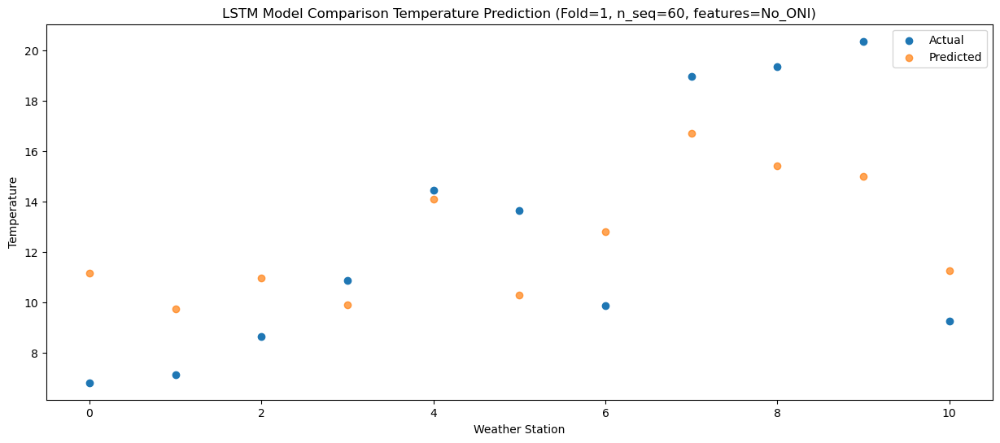

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_12 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_12 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_13 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_13 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_18 (Dense)            (1, 256)                  262400    
                                                                 
 dense_19 (Dense)            (1, 128)                  32896     
                                                                 
 dense_20 (Dense)            (1, 60)                  

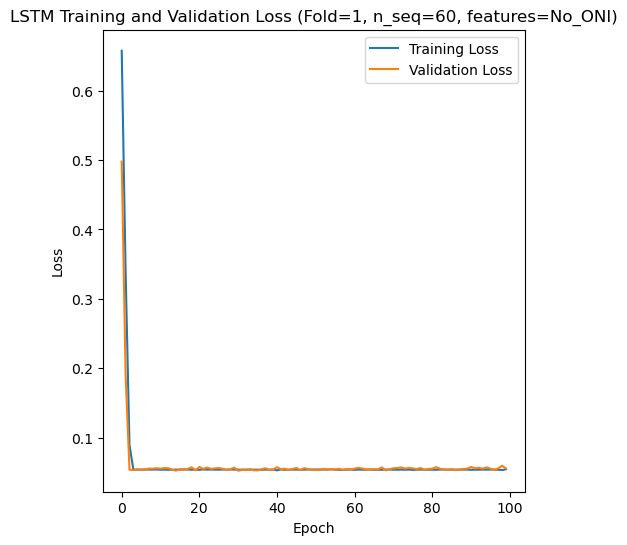

Epoch 1/100
84/84 [==============================] - 16s 96ms/step - loss: 0.6942 - accuracy: 0.0000e+00 - mae: 0.5332 - rmse: 0.6942 - mape: inf - pearson: 0.0317 - val_loss: 0.5315 - val_accuracy: 0.0000e+00 - val_mae: 0.4073 - val_rmse: 0.5315 - val_mape: 85.3704 - val_pearson: 0.0688
Epoch 2/100
84/84 [==============================] - 4s 47ms/step - loss: 0.3858 - accuracy: 0.0238 - mae: 0.2999 - rmse: 0.3858 - mape: inf - pearson: 0.1284 - val_loss: 0.2327 - val_accuracy: 0.6000 - val_mae: 0.1795 - val_rmse: 0.2327 - val_mape: 37.1033 - val_pearson: 0.3088
Epoch 3/100
84/84 [==============================] - 4s 45ms/step - loss: 0.1210 - accuracy: 0.5595 - mae: 0.0955 - rmse: 0.1210 - mape: inf - pearson: 0.6214 - val_loss: 0.0386 - val_accuracy: 0.6000 - val_mae: 0.0311 - val_rmse: 0.0386 - val_mape: 6.9042 - val_pearson: 0.9414
Epoch 4/100
84/84 [==============================] - 4s 48ms/step - loss: 0.0543 - accuracy: 0.5952 - mae: 0.0430 - rmse: 0.0543 - mape: inf - pearson: 

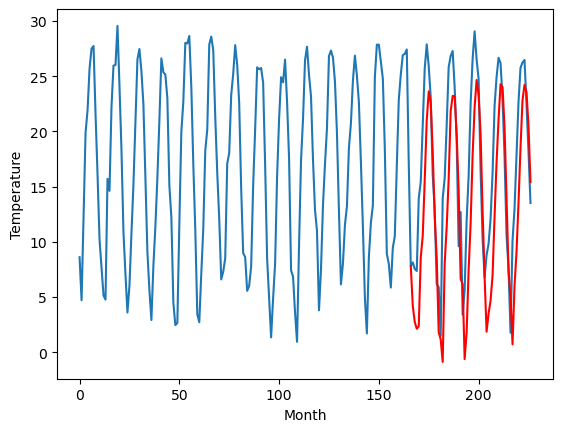

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.57		-1.16		-2.73
-0.71		-2.63		-1.92
-0.95		-3.25		-2.30
-1.68		-3.03		-1.35
6.33		3.19		-3.14
8.56		5.18		-3.38
15.36		10.26		-5.10
22.56		15.61		-6.95
22.59		18.25		-4.34
21.26		17.22		-4.04
15.13		12.81		-2.32
8.14		6.88		-1.26
5.02		3.17		-1.85
-1.61		-3.56		-1.95
-1.69		-4.22		-2.53
-5.73		-6.26		-0.53
4.46		2.65		-1.81
8.22		5.95		-2.27
13.40		10.32		-3.08
20.65		16.43		-4.22
21.34		17.81		-3.53
22.10		17.76		-4.34
19.86		14.29		-5.57
11.60		9.26		-2.34
4.89		1.22		-3.67
2.50		0.74		-1.76
-2.19		-6.04		-3.85
-2.20		-3.64		-1.44
4.78		2.05		-2.73
11.46		6.24		-5.22
17.26		12.45		-4.81
21.06		16.75		-4.31
24.30		19.22		-5.08
21.99		17.85		-4.14
19.23		14.28		-4.95
10.85		7.34		-3.51
0.86		1.37		0.51
-1.85		-3.59		-1.74
-2.10		-1.96		0.14
-0.50		-0.76		-0.26
3.57		1.51		-2.06
9.43		6.84		-2.59
14.92		11.74		-3.18
17.53		15.64		-1.89
21.63		18.80		-2.83
22.12		18.56		-3.56
19.25		14.90		-

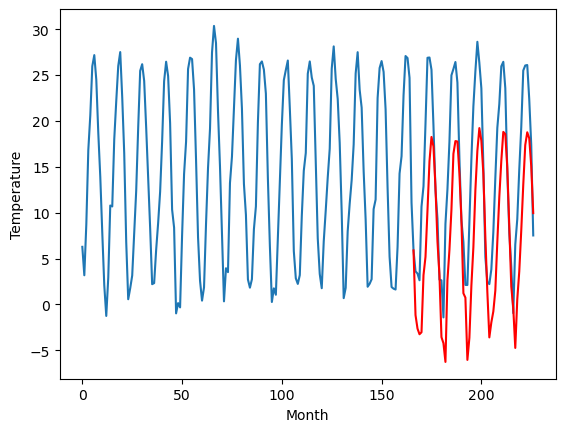

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.66		4.10		-1.56
4.54		2.64		-1.90
3.39		2.02		-1.37
4.43		2.23		-2.20
8.05		8.44		0.39
9.44		10.44		1.00
10.75		15.51		4.76
13.34		20.85		7.51
13.98		23.49		9.51
13.67		22.45		8.78
12.41		18.03		5.62
11.14		12.12		0.98
7.72		8.41		0.69
0.73		1.68		0.95
1.39		1.02		-0.37
4.12		-1.02		-5.14
5.93		7.89		1.96
7.74		11.18		3.44
11.32		15.55		4.23
12.54		21.66		9.12
13.33		23.04		9.71
13.38		22.99		9.61
12.10		19.52		7.42
10.96		14.50		3.54
4.11		6.47		2.36
5.01		6.00		0.99
0.75		-0.78		-1.53
3.08		1.63		-1.45
6.55		7.31		0.76
8.36		11.49		3.13
11.12		17.70		6.58
12.93		22.01		9.08
13.11		24.48		11.37
12.54		23.13		10.59
11.13		19.55		8.42
8.50		12.61		4.11
6.74		6.66		-0.08
2.64		1.70		-0.94
2.44		3.33		0.89
5.50		4.53		-0.97
6.52		6.81		0.29
9.06		12.15		3.09
10.04		17.04		7.00
12.45		20.95		8.50
14.36		24.11		9.75
14.54		23.86		9.32
12.59		20.21		7.62
9.01		13.81		4.80
5.03		7.25		2.22
3.10		4

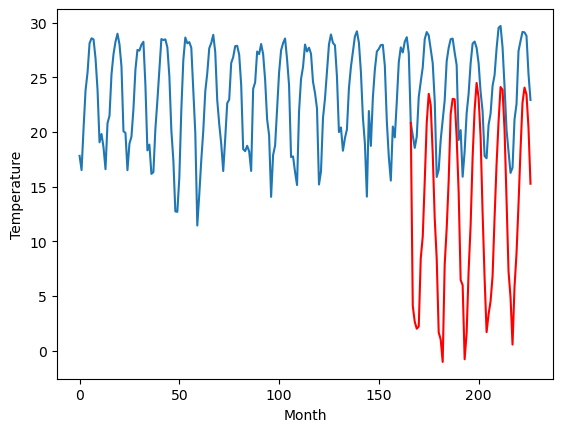

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.01		0.64		0.65
-3.07		-0.83		2.24
-2.80		-1.45		1.35
-2.65		-1.23		1.42
0.90		4.99		4.09
2.13		6.99		4.86
8.02		12.07		4.05
14.08		17.41		3.33
18.36		20.05		1.69
16.51		19.00		2.49
11.93		14.59		2.66
6.71		8.67		1.96
2.75		4.98		2.23
-4.08		-1.76		2.32
-7.16		-2.41		4.75
-7.14		-4.45		2.69
-3.03		4.45		7.48
1.47		7.73		6.26
6.73		12.10		5.37
12.30		18.21		5.91
14.30		19.59		5.29
15.36		19.54		4.18
12.19		16.07		3.88
8.36		11.06		2.70
0.28		3.02		2.74
-1.64		2.55		4.19
-7.79		-4.23		3.56
-5.47		-1.83		3.64
-1.61		3.86		5.47
2.83		8.04		5.21
8.17		14.25		6.08
12.41		18.57		6.16
17.03		21.03		4.00
16.95		19.68		2.73
11.91		16.10		4.19
6.47		9.16		2.69
2.67		3.22		0.55
-3.50		-1.75		1.75
-2.21		-0.11		2.10
-4.09		1.10		5.19
-1.65		3.37		5.02
4.07		8.71		4.64
7.70		13.60		5.90
11.49		17.51		6.02
17.06		20.67		3.61
15.05		20.42		5.37
12.63		16.78		4.15
7.61		10.37		2.76
-0.37		3.82		4.19
-1.11		

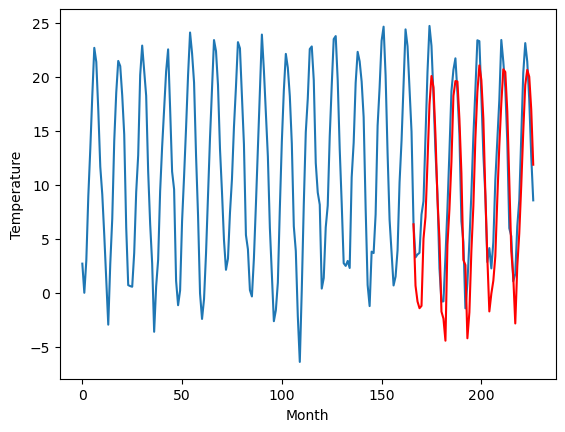

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.32		0.68		1.00
0.03		-0.78		-0.81
0.37		-1.40		-1.77
1.01		-1.18		-2.19
7.70		5.04		-2.66
7.17		7.04		-0.13
10.14		12.10		1.96
13.18		17.44		4.26
13.92		20.08		6.16
14.29		19.02		4.73
11.94		14.62		2.68
8.25		8.70		0.45
4.13		5.01		0.88
-2.17		-1.73		0.44
-1.82		-2.38		-0.56
-2.56		-4.41		-1.85
4.77		4.49		-0.28
5.64		7.78		2.14
10.11		12.14		2.03
13.59		18.25		4.66
14.18		19.63		5.45
14.35		19.59		5.24
11.81		16.12		4.31
9.07		11.11		2.04
0.80		3.07		2.27
4.21		2.60		-1.61
-3.52		-4.18		-0.66
-0.38		-1.77		-1.39
3.38		3.90		0.52
7.18		8.08		0.90
12.34		14.29		1.95
14.93		18.61		3.68
14.76		21.08		6.32
13.94		19.73		5.79
11.97		16.14		4.17
5.78		9.20		3.42
2.71		3.26		0.55
0.20		-1.70		-1.90
1.37		-0.07		-1.44
3.50		1.13		-2.37
5.33		3.41		-1.92
7.25		8.75		1.50
11.28		13.65		2.37
14.93		17.55		2.62
16.37		20.72		4.35
17.67		20.47		2.80
13.24		16.82		3.58
7.08		10.41		3.33
1.97		3.84		1.87

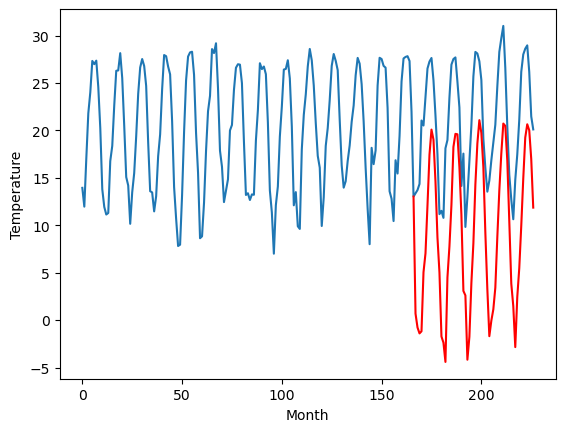

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.39		-1.65		-1.26
-1.82		-3.11		-1.29
-1.45		-3.73		-2.28
-2.21		-3.50		-1.29
5.88		2.73		-3.15
5.85		4.72		-1.13
9.69		9.78		0.09
13.30		15.11		1.81
15.00		17.76		2.76
15.30		16.70		1.40
10.90		12.29		1.39
6.43		6.38		-0.05
3.75		2.68		-1.07
-2.36		-4.07		-1.71
-2.95		-4.72		-1.77
-5.30		-6.75		-1.45
3.08		2.16		-0.92
5.20		5.45		0.25
9.24		9.81		0.57
13.79		15.92		2.13
13.87		17.31		3.44
14.98		17.26		2.28
12.24		13.80		1.56
8.94		8.80		-0.14
1.30		0.77		-0.53
4.54		0.29		-4.25
-3.89		-6.48		-2.59
-4.27		-4.08		0.19
1.85		1.60		-0.25
8.00		5.78		-2.22
12.60		12.00		-0.60
16.32		16.32		-0.00
17.68		18.79		1.11
14.96		17.43		2.47
12.30		13.84		1.54
6.73		6.90		0.17
0.85		0.95		0.10
-1.38		-4.02		-2.64
-0.62		-2.38		-1.76
0.57		-1.18		-1.75
4.37		1.09		-3.28
5.29		6.42		1.13
10.37		11.32		0.95
15.29		15.22		-0.07
17.45		18.39		0.94
19.15		18.14		-1.01
14.67		14.49		-0.18
6.78		8.08		1.30
0.5

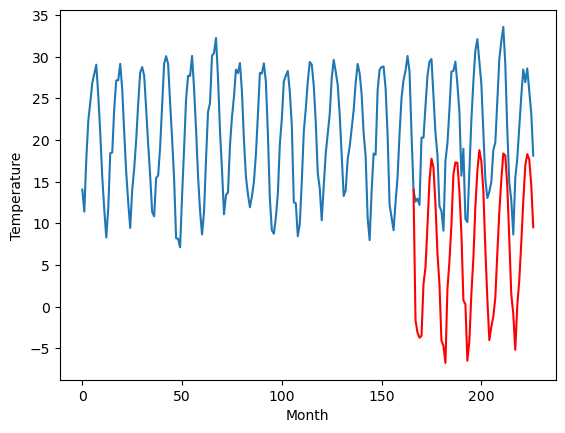

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
10.42		9.89		-0.53
8.61		8.43		-0.18
8.96		7.82		-1.14
8.40		8.05		-0.35
16.05		14.26		-1.79
16.36		16.26		-0.10
21.26		21.32		0.06
26.00		26.65		0.65
27.18		29.30		2.12
27.41		28.24		0.83
21.47		23.84		2.37
15.99		17.93		1.94
13.50		14.23		0.73
7.04		7.49		0.45
6.34		6.84		0.50
3.23		4.81		1.58
13.60		13.72		0.12
15.30		17.01		1.71
19.38		21.37		1.99
24.94		27.48		2.54
25.83		28.87		3.04
26.39		28.82		2.43
24.12		25.35		1.23
19.61		20.35		0.74
11.64		12.32		0.68
13.93		11.85		-2.08
5.45		5.07		-0.38
5.28		7.47		2.19
11.86		13.14		1.28
18.13		17.33		-0.80
23.15		23.55		0.40
27.86		27.86		0.00
30.65		30.34		-0.31
27.84		28.98		1.14
24.01		25.39		1.38
17.63		18.46		0.83
10.96		12.50		1.54
8.34		7.53		-0.81
9.22		9.16		-0.06
9.41		10.36		0.95
14.06		12.63		-1.43
15.88		17.96		2.08
21.62		22.85		1.23
25.77		26.76		0.99
28.33		29.92		1.59
30.67		29.68		-0.99
25.89		26.02		0.13
17.17		19.62		2.45
1

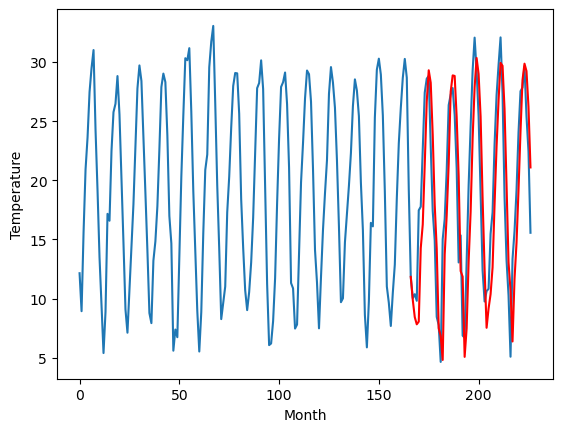

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.43		-5.25		-1.82
-7.96		-6.72		1.24
-6.71		-7.32		-0.61
-5.90		-7.09		-1.19
-1.40		-0.87		0.53
3.58		1.12		-2.46
9.87		6.18		-3.69
13.39		11.52		-1.87
15.49		14.16		-1.33
15.93		13.11		-2.82
9.68		8.71		-0.97
4.08		2.79		-1.29
-1.48		-0.90		0.58
-9.13		-7.65		1.48
-8.59		-8.31		0.28
-5.67		-10.34		-4.67
-2.57		-1.42		1.15
4.09		1.85		-2.24
9.10		6.21		-2.89
14.09		12.31		-1.78
12.89		13.69		0.80
12.37		13.64		1.27
10.19		10.17		-0.02
3.63		5.18		1.55
-1.77		-2.86		-1.09
-5.12		-3.33		1.79
-8.12		-10.12		-2.00
-7.15		-7.72		-0.57
-2.09		-2.05		0.04
5.10		2.13		-2.97
9.80		8.34		-1.46
13.66		12.65		-1.01
14.80		15.13		0.33
11.78		13.76		1.98
10.05		10.18		0.13
1.84		3.24		1.40
-5.05		-2.71		2.34
-7.22		-7.68		-0.46
-7.93		-6.06		1.87
-6.72		-4.85		1.87
-2.02		-2.58		-0.56
3.62		2.76		-0.86
8.27		7.64		-0.63
12.93		11.54		-1.39
17.68		14.70		-2.98
14.68		14.45		-0.23
12.02		10.80		-1.22
5.28	

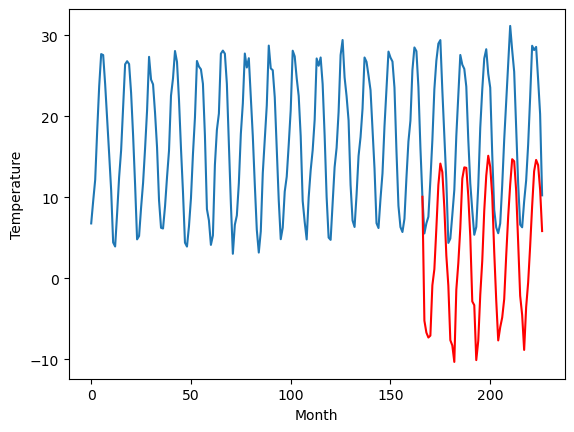

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.34		6.01		-3.33
5.80		4.54		-1.26
6.34		3.93		-2.41
8.45		4.16		-4.29
8.52		10.38		1.86
11.73		12.37		0.64
15.78		17.43		1.65
17.07		22.77		5.70
19.48		25.41		5.93
21.88		24.35		2.47
20.28		19.95		-0.33
17.04		14.03		-3.01
10.32		10.34		0.02
8.27		3.59		-4.68
8.21		2.92		-5.29
7.29		0.89		-6.40
6.89		9.81		2.92
10.75		13.08		2.33
12.97		17.43		4.46
17.21		23.53		6.32
20.19		24.91		4.72
19.79		24.85		5.06
18.01		21.38		3.37
13.03		16.39		3.36
11.77		8.34		-3.43
5.26		7.88		2.62
7.67		1.09		-6.58
8.54		3.49		-5.05
10.33		9.15		-1.18
12.45		13.34		0.89
13.41		19.55		6.14
18.33		23.86		5.53
19.14		26.34		7.20
21.18		24.97		3.79
20.77		21.39		0.62
14.50		14.45		-0.05
8.27		8.49		0.22
5.57		3.52		-2.05
5.23		5.14		-0.09
4.91		6.34		1.43
5.92		8.62		2.70
9.76		13.96		4.20
10.97		18.84		7.87
12.93		22.73		9.80
19.85		25.90		6.05
19.48		25.64		6.16
15.98		22.00		6.02
14.39		15.59		1.20
10.00		9.04		

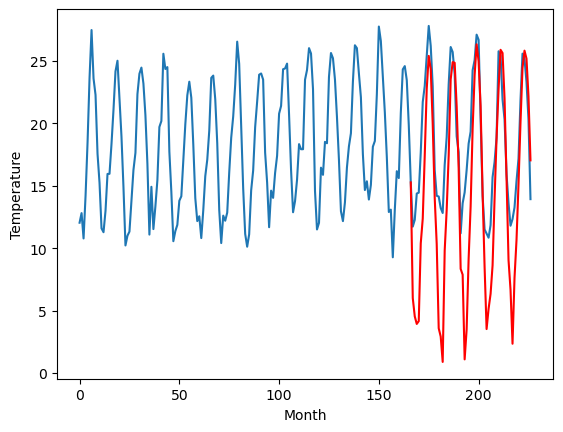

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		6.11		2.06
3.64		4.64		1.00
3.35		4.03		0.68
4.39		4.26		-0.13
9.62		10.48		0.86
10.92		12.47		1.55
13.52		17.53		4.01
18.81		22.87		4.06
21.80		25.50		3.70
20.80		24.44		3.64
16.77		20.05		3.28
12.85		14.14		1.29
8.24		10.44		2.20
1.24		3.70		2.46
0.83		3.05		2.22
1.33		1.02		-0.31
8.21		9.93		1.72
11.00		13.21		2.21
15.02		17.56		2.54
19.31		23.66		4.35
20.88		25.05		4.17
20.97		25.00		4.03
16.86		21.53		4.67
13.58		16.54		2.96
4.67		8.49		3.82
6.59		8.02		1.43
0.11		1.24		1.13
4.13		3.64		-0.49
8.24		9.31		1.07
11.53		13.49		1.96
16.38		19.70		3.32
20.14		24.01		3.87
21.58		26.48		4.90
20.20		25.13		4.93
16.89		21.55		4.66
9.58		14.61		5.03
7.46		8.66		1.20
0.93		3.69		2.76
4.13		5.32		1.19
7.15		6.52		-0.63
7.60		8.79		1.19
11.12		14.13		3.01
13.90		19.03		5.13
17.56		22.93		5.37
21.15		26.10		4.95
20.60		25.84		5.24
16.64		22.20		5.56
11.35		15.80		4.45
5.45		9.24		3.79
2.98		6.88

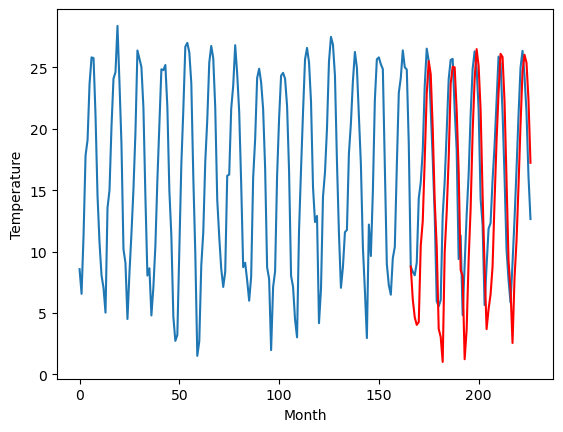

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		4.20		2.55
2.25		2.73		0.48
1.81		2.12		0.31
1.61		2.35		0.74
7.65		8.57		0.92
8.08		10.56		2.48
12.12		15.62		3.50
17.49		20.96		3.47
20.78		23.60		2.82
19.52		22.55		3.03
15.57		18.15		2.58
10.91		12.24		1.33
5.86		8.54		2.68
-1.20		1.81		3.01
-0.87		1.15		2.02
0.48		-0.88		-1.36
6.69		8.04		1.35
8.66		11.31		2.65
13.57		15.68		2.11
18.98		21.78		2.80
20.29		23.16		2.87
20.37		23.11		2.74
15.88		19.64		3.76
12.12		14.65		2.53
1.90		6.61		4.71
4.00		6.15		2.15
-2.87		-0.63		2.24
1.72		1.77		0.05
6.27		7.45		1.18
9.43		11.63		2.20
15.67		17.84		2.17
19.32		22.15		2.83
20.67		24.62		3.95
19.42		23.27		3.85
15.27		19.69		4.42
7.99		12.75		4.76
5.54		6.80		1.26
0.08		1.84		1.76
2.00		3.47		1.47
4.79		4.68		-0.11
5.32		6.95		1.63
10.21		12.28		2.07
13.56		17.18		3.62
16.47		21.09		4.62
20.02		24.26		4.24
19.31		24.02		4.71
16.53		20.37		3.84
10.48		13.97		3.49
4.27		7.41		3.14
1.42		5.04		

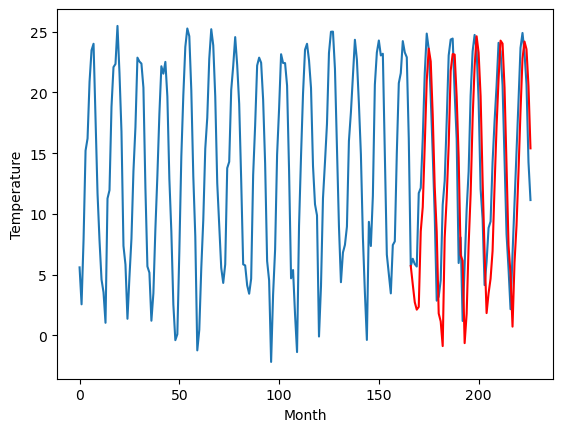

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[4.211359157562256, -1.1608147430419926, 4.1021919631958, 0.6372721862792972, 0.6814740753173822, -1.646847457885742, 9.892372913360596, -5.247979469299317, 6.006125869750976, 6.1130207061767585, 4.202209606170655]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   4.211359
1                 1    1.57  -1.160815
2                 2    5.66   4.102192
3                 3   -0.01   0.637272
4                 4   -0.32   0.681474
5                 5   -0.39  -1.646847
6                 6   10.42   9.892373
7                 7   -3.43  -5.247979
8                 8    9.34   6.006126
9                 9    4.05   6.113021
10               10    1.65   4.202210


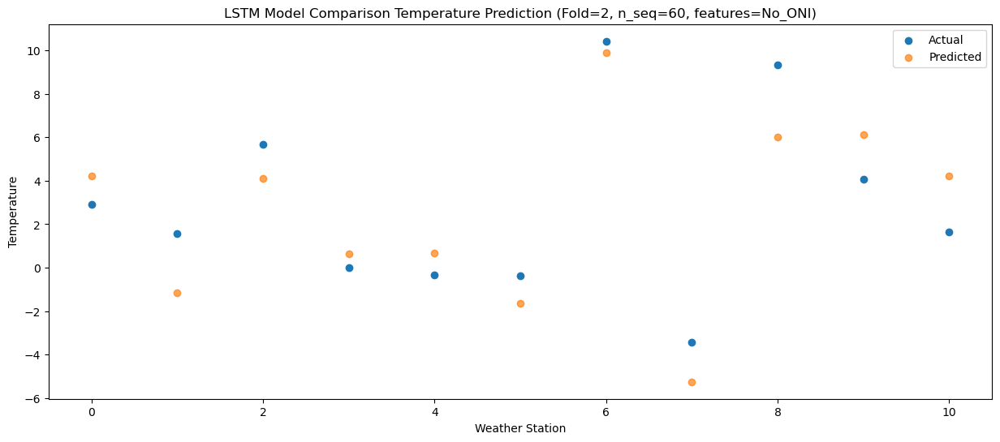

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   2.742089
1                 1   -0.71  -2.631778
2                 2    4.54   2.638125
3                 3   -3.07  -0.826300
4                 4    0.03  -0.781251
5                 5   -1.82  -3.112803
6                 6    8.61   8.429760
7                 7   -7.96  -6.718263
8                 8    5.80   4.535883
9                 9    3.64   4.641671
10               10    2.25   2.733983


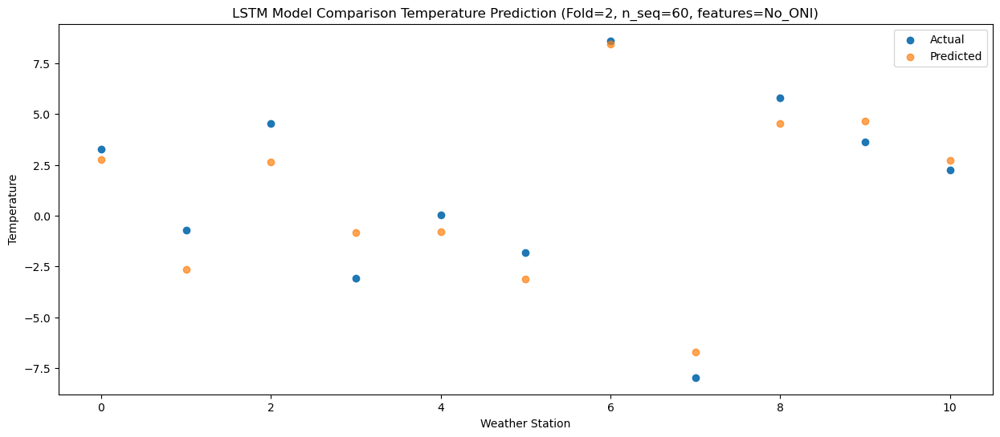

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67   2.130885
1                 1   -0.95  -3.245098
2                 2    3.39   2.015044
3                 3   -2.80  -1.445791
4                 4    0.37  -1.402040
5                 5   -1.45  -3.725804
6                 6    8.96   7.819687
7                 7   -6.71  -7.324629
8                 8    6.34   3.930618
9                 9    3.35   4.033013
10               10    1.81   2.121627


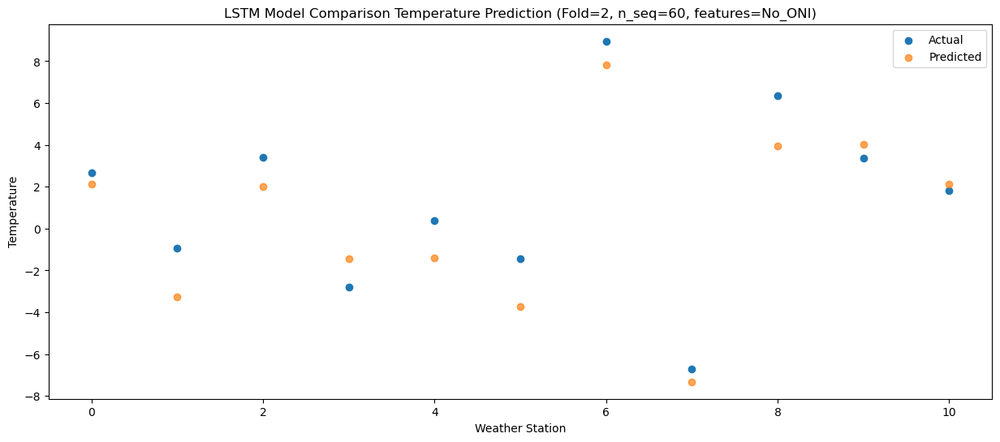

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48   2.349459
1                 1   -1.68  -3.028679
2                 2    4.43   2.225919
3                 3   -2.65  -1.232030
4                 4    1.01  -1.181155
5                 5   -2.21  -3.495896
6                 6    8.40   8.048527
7                 7   -5.90  -7.093458
8                 8    8.45   4.155573
9                 9    4.39   4.258911
10               10    1.61   2.348881


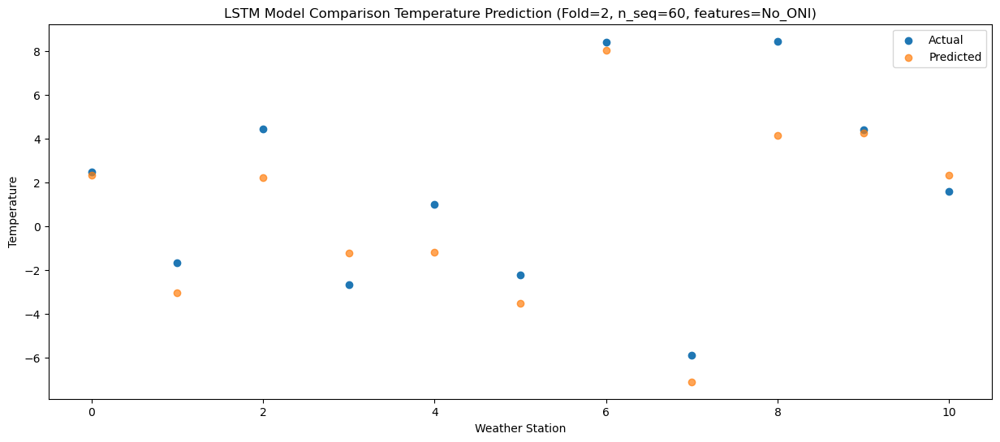

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   8.567674
1                 1    6.33   3.191612
2                 2    8.05   8.444332
3                 3    0.90   4.988993
4                 4    7.70   5.041310
5                 5    5.88   2.725156
6                 6   16.05  14.263157
7                 7   -1.40  -0.867975
8                 8    8.52  10.384431
9                 9    9.62  10.482401
10               10    7.65   8.571203


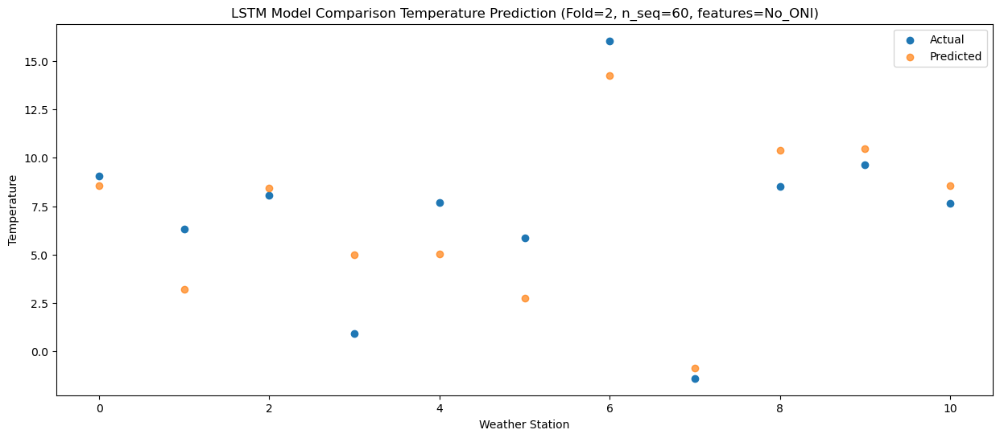

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55  10.557522
1                 1    8.56   5.184291
2                 2    9.44  10.436419
3                 3    2.13   6.992941
4                 4    7.17   7.040621
5                 5    5.85   4.721322
6                 6   16.36  16.256696
7                 7    3.58   1.116981
8                 8   11.73  12.369069
9                 9   10.92  12.471097
10               10    8.08  10.563757


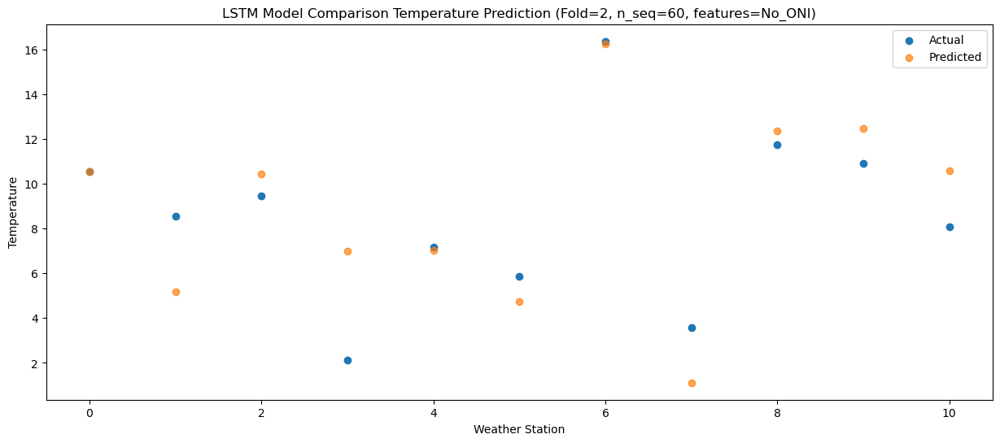

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  15.635693
1                 1   15.36  10.259644
2                 2   10.75  15.509116
3                 3    8.02  12.065856
4                 4   10.14  12.103883
5                 5    9.69   9.784079
6                 6   21.26  21.321945
7                 7    9.87   6.180246
8                 8   15.78  17.430576
9                 9   13.52  17.528940
10               10   12.12  15.622956


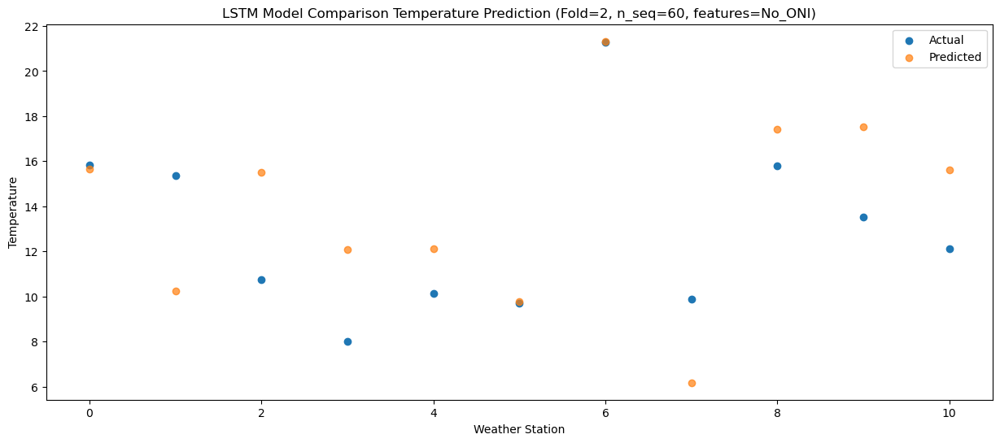

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  20.979416
1                 1   22.56  15.606578
2                 2   13.34  20.846956
3                 3   14.08  17.410824
4                 4   13.18  17.436014
5                 5   13.30  15.112286
6                 6   26.00  26.654535
7                 7   13.39  11.522071
8                 8   17.07  22.768005
9                 9   18.81  22.866229
10               10   17.49  20.960827


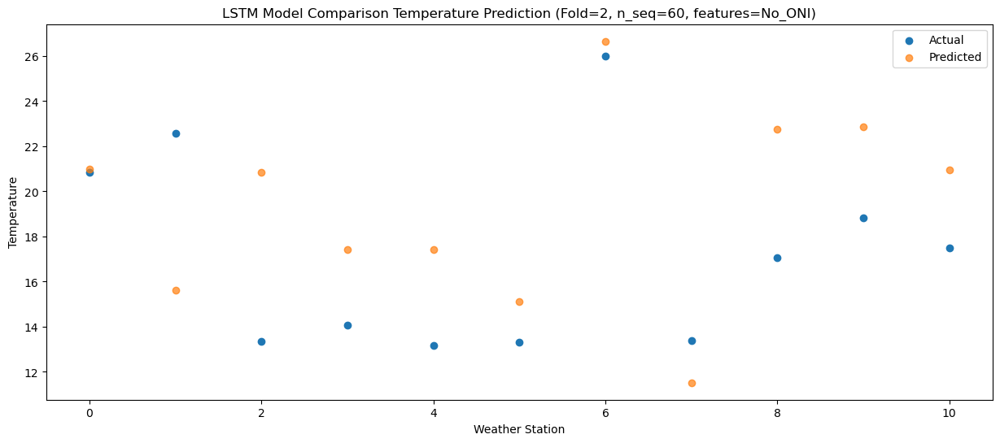

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  23.627139
1                 1   22.59  18.251140
2                 2   13.98  23.490694
3                 3   18.36  20.050920
4                 4   13.92  20.080309
5                 5   15.00  17.757044
6                 6   27.18  29.300329
7                 7   15.49  14.162618
8                 8   19.48  25.408961
9                 9   21.80  25.502422
10               10   20.78  23.603835


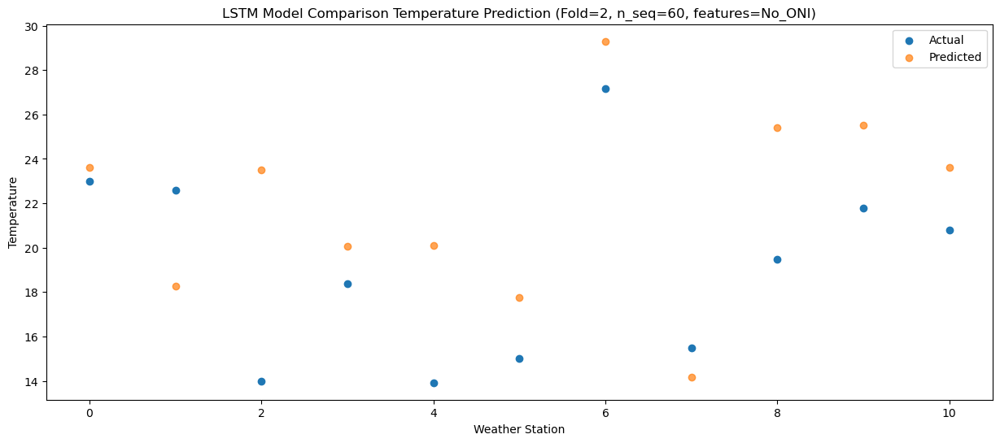

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  22.593037
1                 1   21.26  17.217031
2                 2   13.67  22.445837
3                 3   16.51  19.000916
4                 4   14.29  19.023256
5                 5   15.30  16.696538
6                 6   27.41  28.244242
7                 7   15.93  13.106049
8                 8   21.88  24.347766
9                 9   20.80  24.442453
10               10   19.52  22.549497


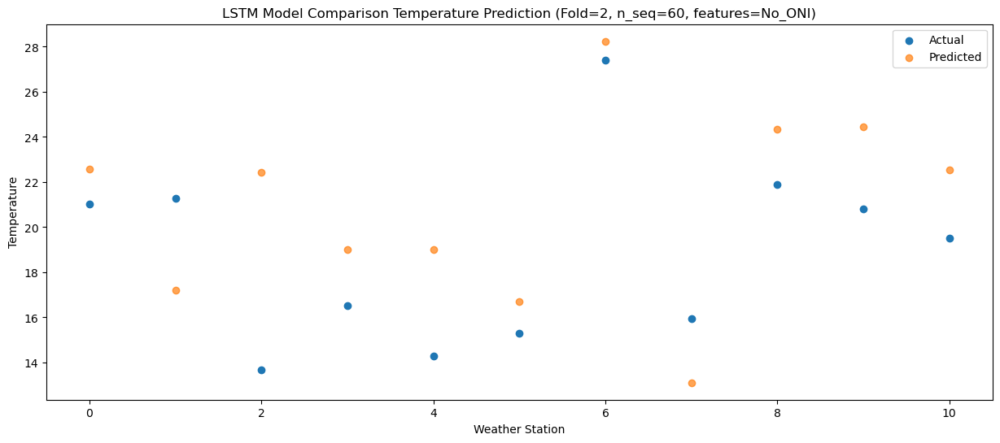

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  18.170101
1                 1   15.13  12.806097
2                 2   12.41  18.033177
3                 3   11.93  14.592067
4                 4   11.94  14.620346
5                 5   10.90  12.293596
6                 6   21.47  23.844972
7                 7    9.68   8.708687
8                 8   20.28  19.953164
9                 9   16.77  20.045655
10               10   15.57  18.148669


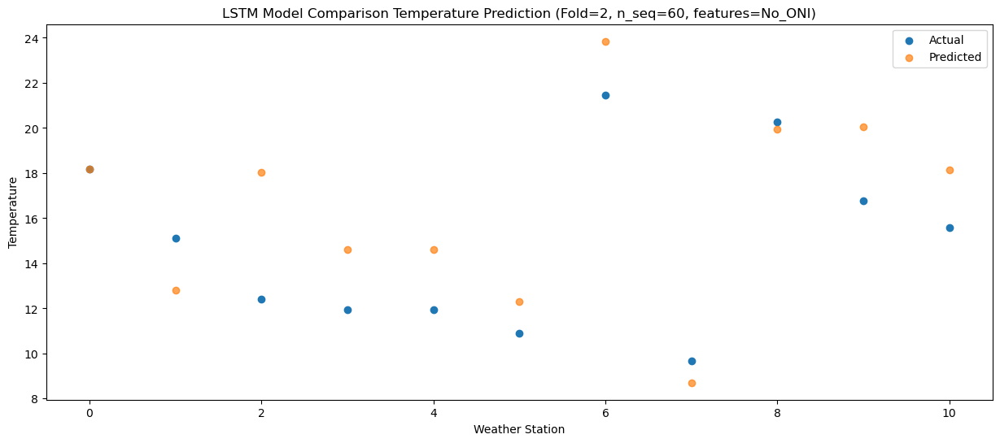

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17  12.257190
1                 1    8.14   6.882947
2                 2   11.14  12.115854
3                 3    6.71   8.673567
4                 4    8.25   8.704637
5                 5    6.43   6.377449
6                 6   15.99  17.929254
7                 7    4.08   2.793855
8                 8   17.04  14.032703
9                 9   12.85  14.137608
10               10   10.91  12.239885


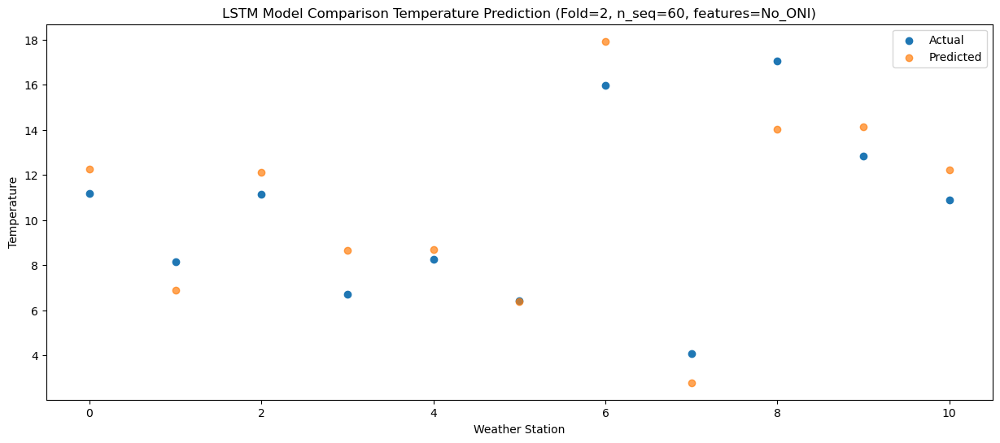

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04   8.545065
1                 1    5.02   3.172023
2                 2    7.72   8.411916
3                 3    2.75   4.975742
4                 4    4.13   5.007588
5                 5    3.75   2.680056
6                 6   13.50  14.233167
7                 7   -1.48  -0.902924
8                 8   10.32  10.335399
9                 9    8.24  10.440407
10               10    5.86   8.536516


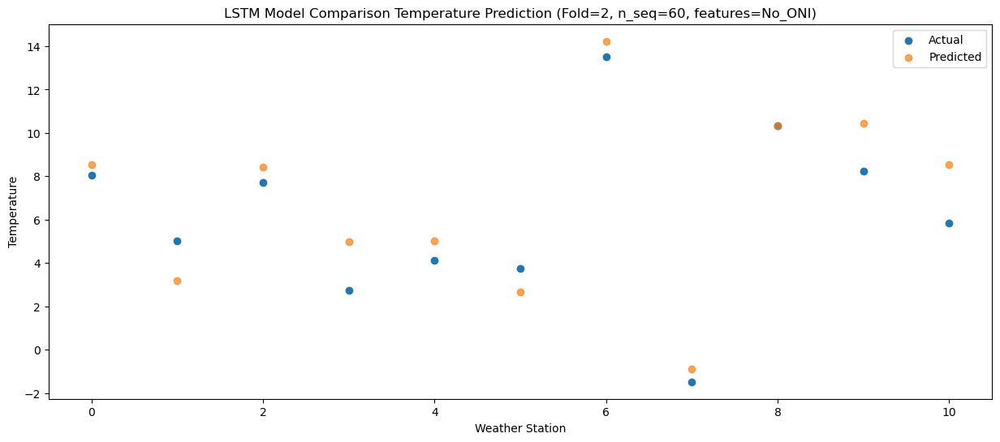

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28   1.817690
1                 1   -1.61  -3.558450
2                 2    0.73   1.678976
3                 3   -4.08  -1.757471
4                 4   -2.17  -1.729872
5                 5   -2.36  -4.066330
6                 6    7.04   7.492084
7                 7   -9.13  -7.651884
8                 8    8.27   3.585705
9                 9    1.24   3.704809
10               10   -1.20   1.807120


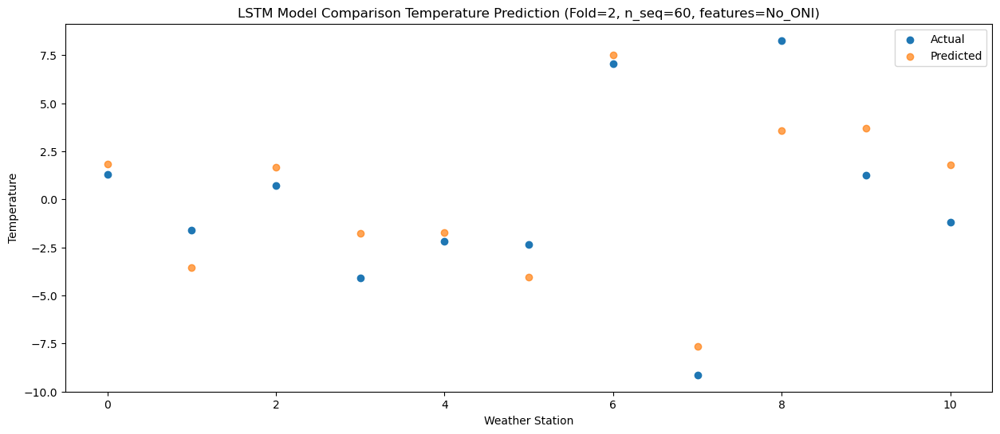

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02   1.166893
1                 1   -1.69  -4.221020
2                 2    1.39   1.022098
3                 3   -7.16  -2.412077
4                 4   -1.82  -2.381053
5                 5   -2.95  -4.715107
6                 6    6.34   6.838188
7                 7   -8.59  -8.309020
8                 8    8.21   2.920723
9                 9    0.83   3.049832
10               10   -0.87   1.152761


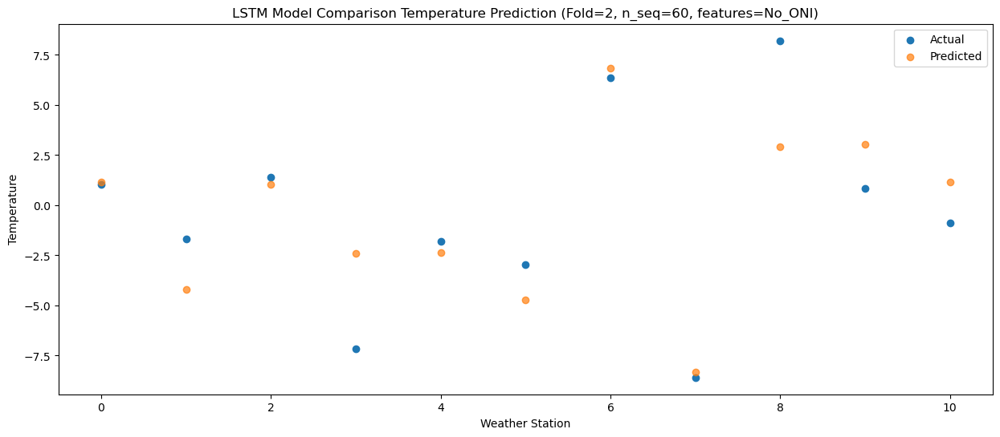

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38  -0.872163
1                 1   -5.73  -6.260013
2                 2    4.12  -1.020933
3                 3   -7.14  -4.454732
4                 4   -2.56  -4.409402
5                 5   -5.30  -6.747838
6                 6    3.23   4.807519
7                 7   -5.67 -10.340204
8                 8    7.29   0.886771
9                 9    1.33   1.017690
10               10    0.48  -0.876498


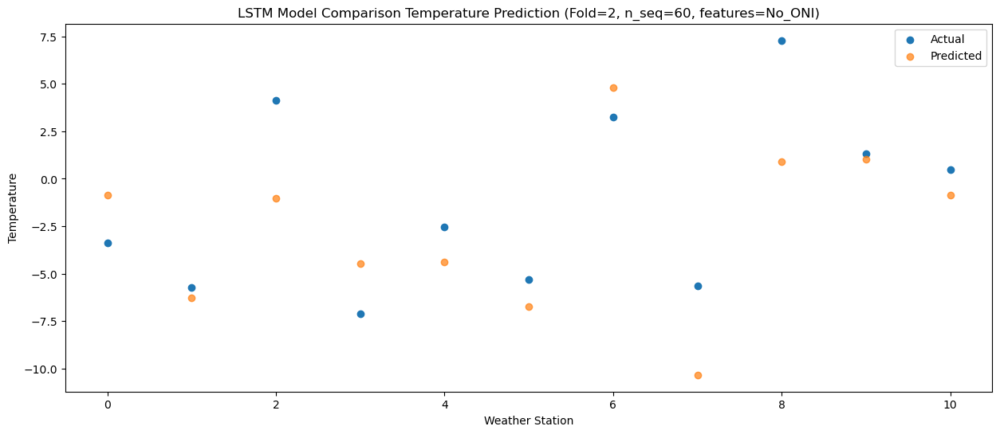

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04   8.036565
1                 1    4.46   2.645442
2                 2    5.93   7.885214
3                 3   -3.03   4.446132
4                 4    4.77   4.494080
5                 5    3.08   2.163345
6                 6   13.60  13.724028
7                 7   -2.57  -1.421944
8                 8    6.89   9.807897
9                 9    8.21   9.934356
10               10    6.69   8.038433


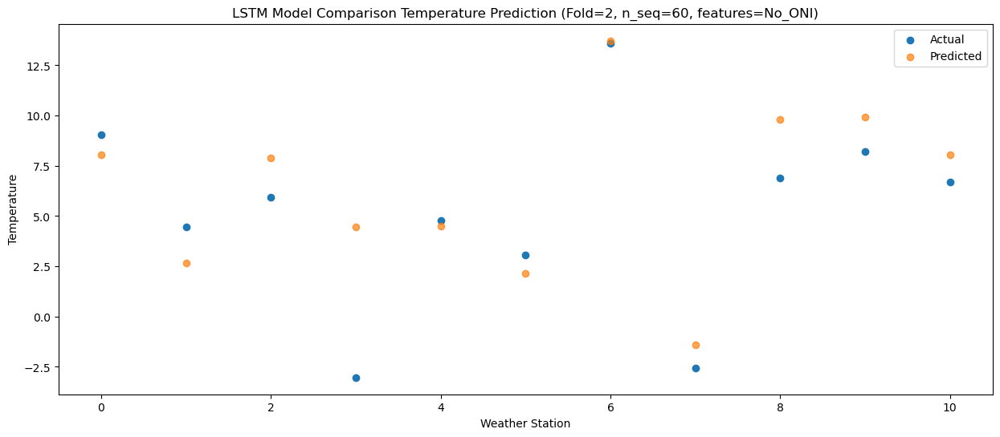

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91  11.348323
1                 1    8.22   5.948953
2                 2    7.74  11.183500
3                 3    1.47   7.732684
4                 4    5.64   7.775711
5                 5    5.20   5.445735
6                 6   15.30  17.007339
7                 7    4.09   1.850035
8                 8   10.75  13.075889
9                 9   11.00  13.207649
10               10    8.66  11.313392


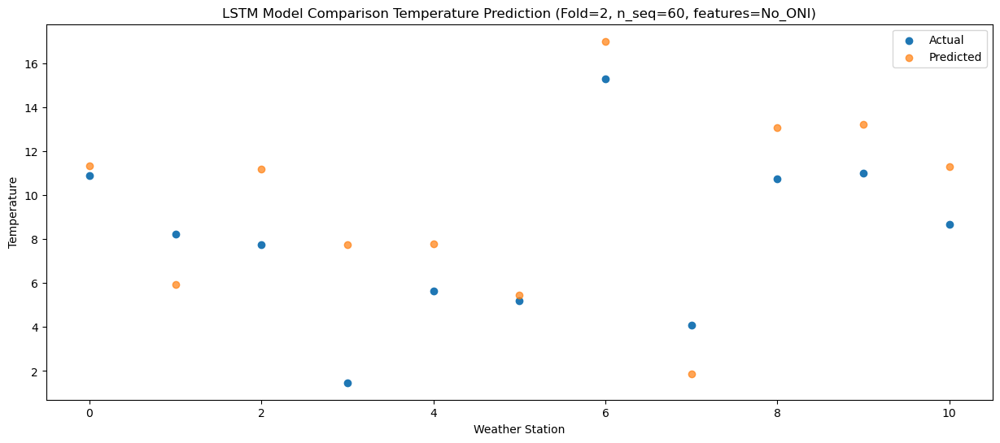

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  15.726634
1                 1   13.40  10.323336
2                 2   11.32  15.552014
3                 3    6.73  12.098478
4                 4   10.11  12.140891
5                 5    9.24   9.812136
6                 6   19.38  21.371634
7                 7    9.10   6.206066
8                 8   12.97  17.426141
9                 9   15.02  17.562969
10               10   13.57  15.675184


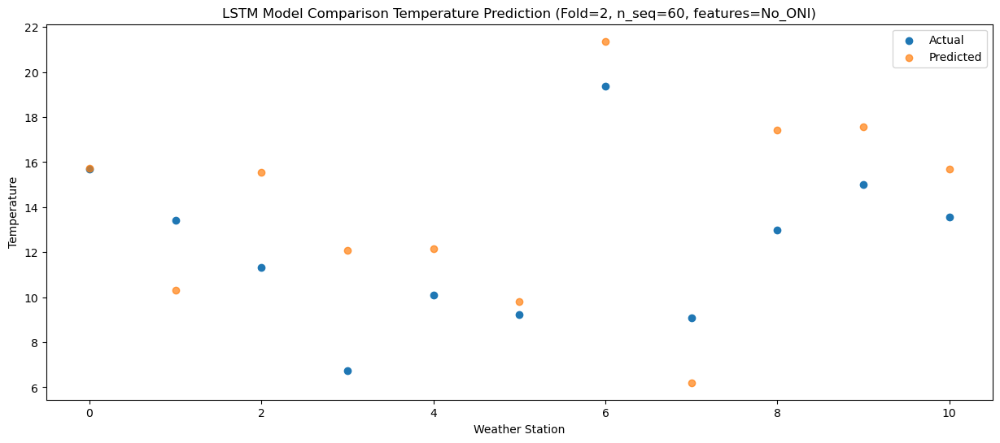

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  21.837406
1                 1   20.65  16.429031
2                 2   12.54  21.657523
3                 3   12.30  18.209103
4                 4   13.59  18.252956
5                 5   13.79  15.922670
6                 6   24.94  27.478191
7                 7   14.09  12.308604
8                 8   17.21  23.527358
9                 9   19.31  23.662394
10               10   18.98  21.775977


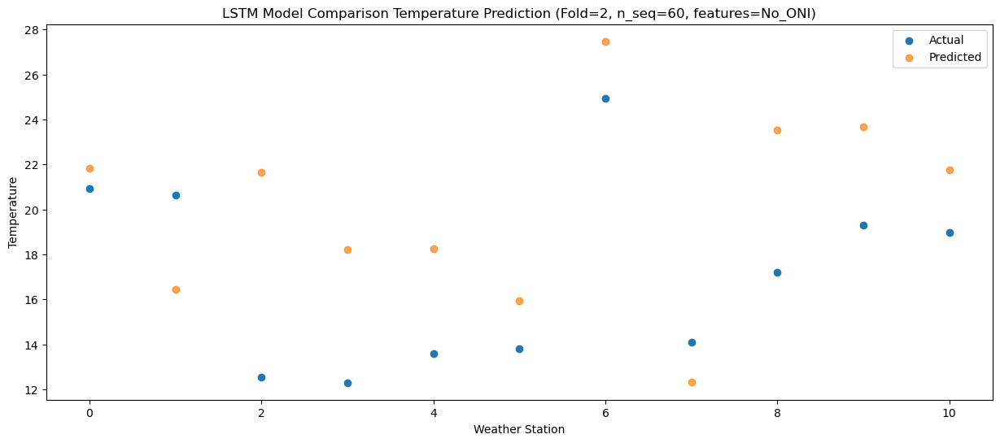

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  23.218084
1                 1   21.34  17.805170
2                 2   13.33  23.037628
3                 3   14.30  19.586431
4                 4   14.18  19.632337
5                 5   13.87  17.309028
6                 6   25.83  28.867196
7                 7   12.89  13.694399
8                 8   20.19  24.910571
9                 9   20.88  25.047276
10               10   20.29  23.156940


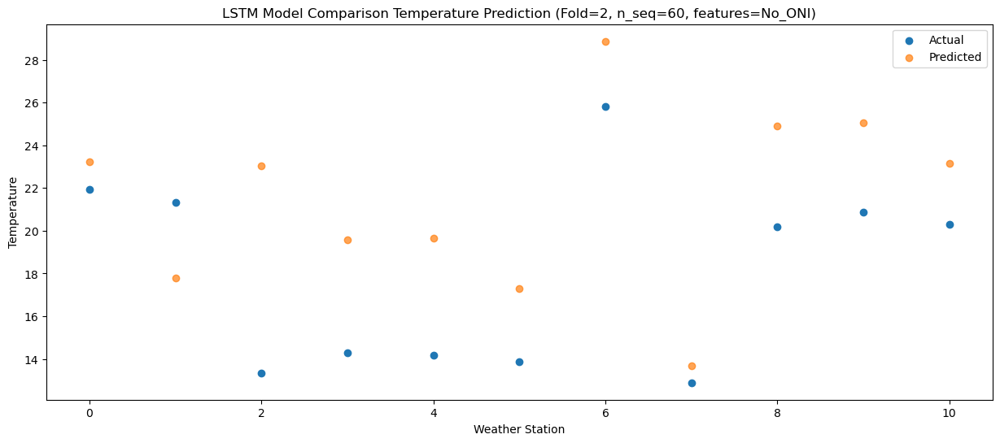

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  23.172124
1                 1   22.10  17.756795
2                 2   13.38  22.991054
3                 3   15.36  19.543346
4                 4   14.35  19.586110
5                 5   14.98  17.263178
6                 6   26.39  28.820406
7                 7   12.37  13.640990
8                 8   19.79  24.854677
9                 9   20.97  24.996583
10               10   20.37  23.111290


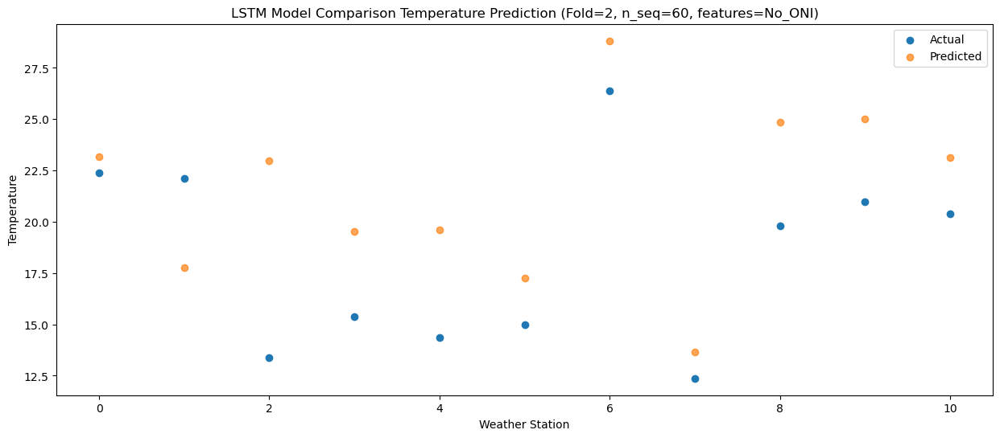

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  19.707309
1                 1   19.86  14.289215
2                 2   12.10  19.524809
3                 3   12.19  16.073795
4                 4   11.81  16.120451
5                 5   12.24  13.799740
6                 6   24.12  25.353827
7                 7   10.19  10.171940
8                 8   18.01  21.378551
9                 9   16.86  21.526485
10               10   15.88  19.643052


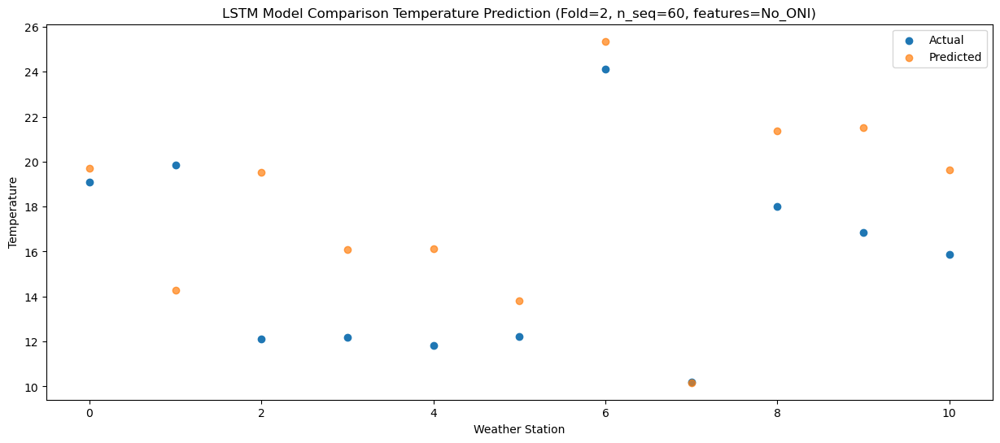

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  14.671947
1                 1   11.60   9.259290
2                 2   10.96  14.502826
3                 3    8.36  11.061708
4                 4    9.07  11.109170
5                 5    8.94   8.795862
6                 6   19.61  20.354992
7                 7    3.63   5.175671
8                 8   13.03  16.390627
9                 9   13.58  16.536944
10               10   12.12  14.651341


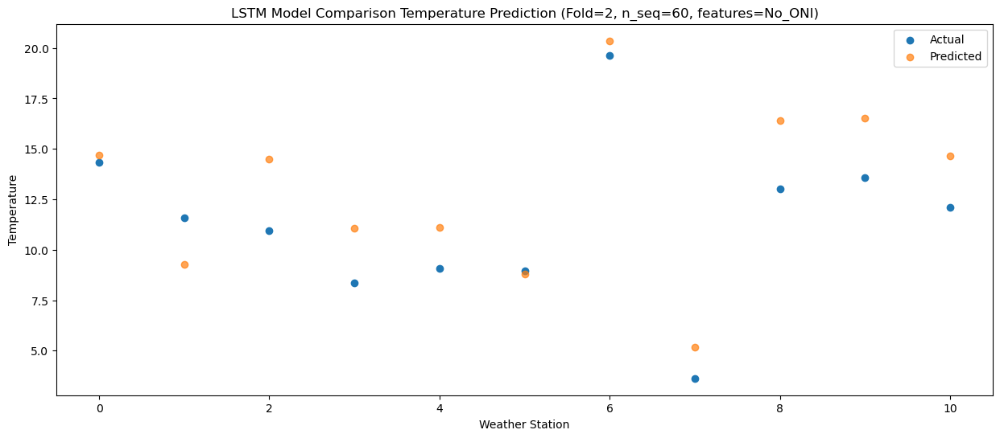

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73   6.648134
1                 1    4.89   1.220905
2                 2    4.11   6.470670
3                 3    0.28   3.022914
4                 4    0.80   3.074931
5                 5    1.30   0.765928
6                 6   11.64  12.322459
7                 7   -1.77  -2.862757
8                 8   11.77   8.342261
9                 9    4.67   8.493490
10               10    1.90   6.613998
84/84 [==============================] - 3s 37ms/step - loss: 0.0530 - accuracy: 0.6190 - mae: 0.0420 - rmse: 0.0530 - mape: 9.8993 - pearson: 0.8816 - val_loss: 0.0701 - val_accuracy: 0.5000 - val_mae: 0.0554 - val_rmse: 0.0701 - val_mape: 12.4199 - val_pearson: 0.7906
Epoch 33/100
84/84 [==============================] - 3s 37ms/step - loss: 0.0525 - accuracy: 0.6190 - mae: 0.0417 - rmse: 0.0525 - mape: 9.8351 - pearson: 0.8825 - val_loss: 0.0712 - val_accuracy: 0.5000 - val_mae: 0.0559 - val_rmse: 0.

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



1/1 [==============================] - 0s 37ms/step
Month at t+1:
t+1 RMSE: 2.955914
t+1 MAE: 2.570353
t+1 MAPE: 9.804586
t+1 R2_SCORE: 0.854514
Month at t+2:
t+2 RMSE: 3.169242
t+2 MAE: 2.341971
t+2 MAPE: 0.758230
t+2 R2_SCORE: 0.825269
Month at t+3:
t+3 RMSE: 2.817245
t+3 MAE: 2.080005
t+3 MAPE: 0.922535
t+3 R2_SCORE: 0.843511
Month at t+4:
t+4 RMSE: 3.421101
t+4 MAE: 2.629434
t+4 MAPE: 6.674448
t+4 R2_SCORE: 0.783914
Month at t+5:
t+5 RMSE: 3.258218
t+5 MAE: 2.267473
t+5 MAPE: 0.742779
t+5 R2_SCORE: 0.800778
Month at t+6:
t+6 RMSE: 3.423811
t+6 MAE: 2.876075
t+6 MAPE: 1.755669
t+6 R2_SCORE: 0.814196
Month at t+7:
t+7 RMSE: 3.616826
t+7 MAE: 3.132298
t+7 MAPE: 0.387307
t+7 R2_SCORE: 0.816158
Month at t+8:
t+8 RMSE: 3.871997
t+8 MAE: 3.269002
t+8 MAPE: 0.467796
t+8 R2_SCORE: 0.788391
Month at t+9:
t+9 RMSE: 4.292606
t+9 MAE: 3.241757
t+9 MAPE: 0.595028
t+9 R2_SCORE: 0.735649
Month at t+10:
t+10 RMSE: 3.712929
t+10 MAE: 2.920663
t+10 MAPE: 0.316737
t+10 R2_SCORE: 0.796605
Month at t+11

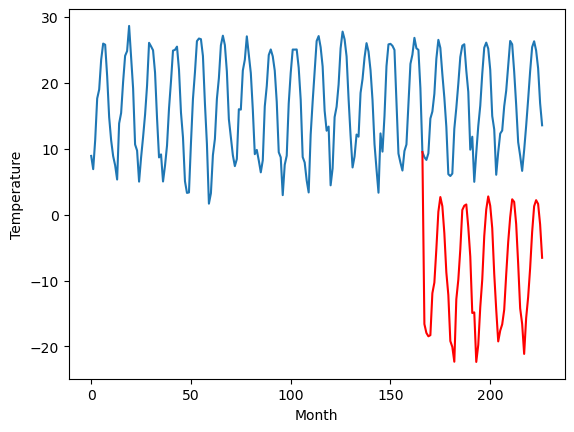

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.89		1.22		-1.67
1.54		-0.12		-1.66
0.70		-0.64		-1.34
0.85		-0.47		-1.32
8.34		5.90		-2.44
9.26		7.51		-1.75
13.66		12.64		-1.02
20.76		18.25		-2.51
22.62		20.48		-2.14
20.76		19.10		-1.66
17.09		14.99		-2.10
9.98		9.04		-0.94
7.16		5.62		-1.54
0.61		-1.36		-1.97
-0.54		-2.24		-1.70
-4.26		-4.48		-0.22
7.71		5.00		-2.71
9.57		7.96		-1.61
13.79		12.58		-1.21
20.50		18.54		-1.96
21.81		19.19		-2.62
22.38		19.39		-2.99
19.65		15.95		-3.70
13.05		11.48		-1.57
5.34		2.93		-2.41
6.65		3.03		-3.62
-2.18		-4.49		-2.31
-0.96		-1.91		-0.95
5.82		3.81		-2.01
10.67		8.00		-2.67
16.10		14.59		-1.51
21.25		18.62		-2.63
25.29		20.61		-4.68
22.21		19.18		-3.03
18.35		15.81		-2.54
11.80		8.90		-2.90
4.57		3.46		-1.11
0.52		-1.36		-1.88
1.22		0.26		-0.96
3.18		1.22		-1.96
5.78		3.44		-2.34
10.83		8.78		-2.05
16.14		13.71		-2.43
20.47		17.48		-2.99
22.73		20.19		-2.54
22.91		19.81		-3.10
18.86		16.45		-2.41
1

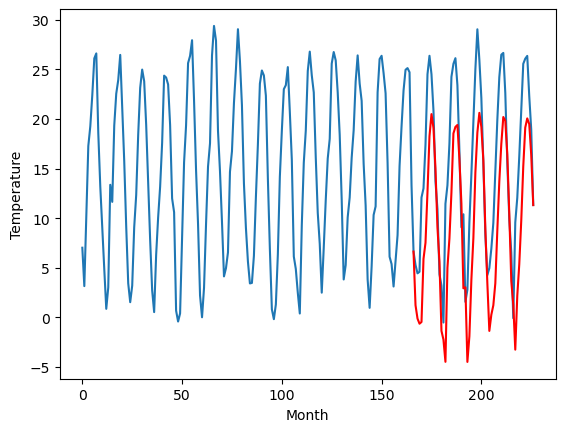

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.73		0.69		-4.04
2.20		-0.66		-2.86
0.98		-1.17		-2.15
3.40		-1.01		-4.41
5.19		5.34		0.15
9.85		6.96		-2.89
15.04		12.07		-2.97
18.39		17.68		-0.71
21.17		19.92		-1.25
21.70		18.53		-3.17
17.37		14.43		-2.94
11.88		8.48		-3.40
3.23		5.05		1.82
0.03		-1.93		-1.96
1.29		-2.81		-4.10
3.59		-5.05		-8.64
4.74		4.43		-0.31
10.47		7.39		-3.08
15.27		12.01		-3.26
20.12		17.99		-2.13
23.25		18.63		-4.62
21.05		18.83		-2.22
17.74		15.39		-2.35
9.08		10.91		1.83
4.74		2.37		-2.37
0.82		2.47		1.65
0.49		-5.04		-5.53
2.19		-2.46		-4.65
6.90		3.25		-3.65
9.97		7.44		-2.53
14.21		14.03		-0.18
19.60		18.05		-1.55
22.17		20.03		-2.14
22.35		18.61		-3.74
19.53		15.24		-4.29
12.35		8.33		-4.02
1.62		2.89		1.27
0.66		-1.93		-2.59
2.05		-0.31		-2.36
1.20		0.65		-0.55
4.07		2.87		-1.20
9.70		8.20		-1.50
14.14		13.12		-1.02
16.94		16.90		-0.04
22.60		19.63		-2.97
20.91		19.23		-1.68
17.14		15.87		-1.27
11.83		9.8

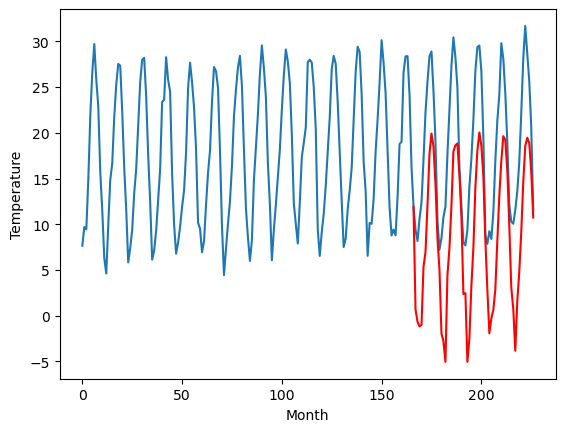

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-7.31		-5.15		2.16
-7.30		-6.50		0.80
-7.85		-7.01		0.84
-8.20		-6.84		1.36
-1.29		-0.47		0.82
-0.65		1.14		1.79
3.92		6.26		2.34
9.74		11.88		2.14
13.54		14.12		0.58
11.12		12.73		1.61
7.06		8.63		1.57
1.64		2.68		1.04
-2.28		-0.74		1.54
-9.48		-7.72		1.76
-10.94		-8.60		2.34
-12.26		-10.83		1.43
-2.05		-1.36		0.69
0.30		1.60		1.30
4.37		6.21		1.84
10.29		12.18		1.89
11.28		12.83		1.55
11.80		13.02		1.22
7.67		9.59		1.92
4.09		5.12		1.03
-5.57		-3.43		2.14
-4.08		-3.33		0.75
-13.03		-10.84		2.19
-8.51		-8.26		0.25
-2.76		-2.55		0.21
0.25		1.65		1.40
7.03		8.24		1.21
10.51		12.26		1.75
12.06		14.25		2.19
10.99		12.81		1.82
7.01		9.45		2.44
-0.26		2.54		2.80
-3.38		-2.90		0.48
-8.65		-7.73		0.92
-6.90		-6.11		0.79
-4.56		-5.15		-0.59
-4.32		-2.94		1.38
1.92		2.40		0.48
4.61		7.33		2.72
8.35		11.10		2.75
11.97		13.82		1.85
10.86		13.43		2.57
8.13		10.07		1.94
2.69		4.06		1.37
-3.70		-2.71		0.99

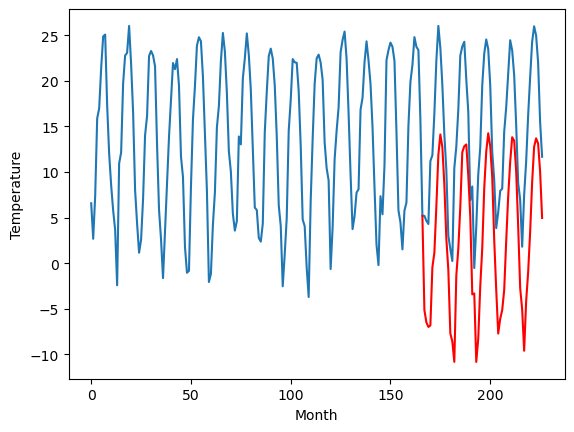

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.64		0.55		-5.09
2.38		-0.79		-3.17
-0.49		-1.30		-0.81
0.66		-1.13		-1.79
8.07		5.24		-2.83
11.10		6.86		-4.24
17.17		11.98		-5.19
24.22		17.59		-6.63
25.68		19.83		-5.85
23.12		18.45		-4.67
19.05		14.34		-4.71
11.32		8.39		-2.93
8.50		4.97		-3.53
1.33		-2.00		-3.33
-0.14		-2.88		-2.74
-4.01		-5.11		-1.10
9.07		4.37		-4.70
12.36		7.33		-5.03
16.93		11.95		-4.98
24.41		17.91		-6.50
24.41		18.56		-5.85
24.53		18.75		-5.78
21.17		15.33		-5.84
15.75		10.86		-4.89
6.01		2.30		-3.71
5.65		2.40		-3.25
-3.82		-5.10		-1.28
-1.30		-2.52		-1.22
7.16		3.20		-3.96
11.29		7.39		-3.90
18.86		13.98		-4.88
24.31		18.01		-6.30
25.43		20.00		-5.43
23.61		18.56		-5.05
19.29		15.19		-4.10
12.02		8.29		-3.73
6.13		2.85		-3.28
0.16		-1.98		-2.14
1.88		-0.35		-2.23
8.40		0.61		-7.79
5.44		2.83		-2.61
12.65		8.17		-4.48
18.65		13.10		-5.55
22.75		16.87		-5.88
24.45		19.58		-4.87
23.16		19.20		-3.96
19.80		15.84		-3

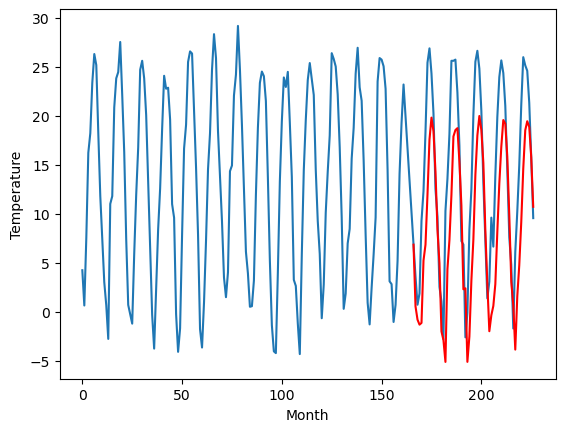

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.05		-1.33		1.72
-2.84		-2.68		0.16
-4.26		-3.19		1.07
-4.67		-3.01		1.66
2.19		3.37		1.18
4.46		4.99		0.53
9.87		10.11		0.24
16.86		15.72		-1.14
18.75		17.96		-0.79
16.24		16.59		0.35
12.61		12.48		-0.13
6.61		6.53		-0.08
2.67		3.11		0.44
-4.94		-3.86		1.08
-6.39		-4.74		1.65
-9.11		-6.98		2.13
2.22		2.50		0.28
5.67		5.46		-0.21
9.95		10.07		0.12
16.66		16.03		-0.63
17.04		16.69		-0.35
17.36		16.88		-0.48
14.10		13.46		-0.64
9.52		8.99		-0.53
-1.33		0.44		1.77
-0.28		0.54		0.82
-9.10		-6.96		2.14
-5.91		-4.38		1.53
1.05		1.34		0.29
4.90		5.54		0.64
12.70		12.12		-0.58
16.64		16.15		-0.49
18.63		18.14		-0.49
16.98		16.71		-0.27
13.03		13.33		0.30
6.99		6.42		-0.57
0.44		0.98		0.54
-5.10		-3.85		1.25
-2.96		-2.21		0.75
-1.24		-1.26		-0.02
-0.34		0.96		1.30
5.89		6.30		0.41
11.30		11.23		-0.07
14.76		14.99		0.23
18.02		17.71		-0.31
16.47		17.33		0.86
13.01		13.97		0.96
7.36		7.95		0.59
0.88		

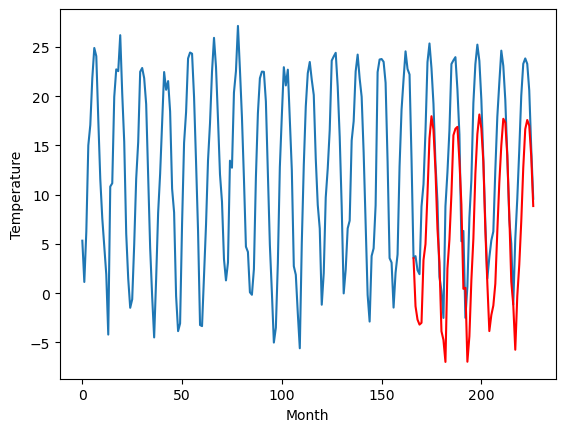

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.14		-0.69		3.45
-9.81		-2.05		7.76
-9.90		-2.56		7.34
-9.71		-2.39		7.32
-4.78		3.98		8.76
-1.80		5.60		7.40
5.31		10.72		5.41
9.52		16.33		6.81
11.51		18.57		7.06
12.26		17.19		4.93
6.76		13.08		6.32
3.02		7.14		4.12
-4.17		3.71		7.88
-9.87		-3.26		6.61
-9.60		-4.15		5.45
-9.50		-6.38		3.12
-6.53		3.10		9.63
-1.75		6.05		7.80
3.30		10.67		7.37
10.69		16.64		5.95
12.53		17.30		4.77
10.61		17.49		6.88
8.74		14.06		5.32
0.77		9.59		8.82
-1.97		1.04		3.01
-6.73		1.15		7.88
-9.02		-6.35		2.67
-10.74		-3.77		6.97
-6.20		1.96		8.16
-1.88		6.15		8.03
4.03		12.73		8.70
9.80		16.75		6.95
11.72		18.74		7.02
10.96		17.31		6.35
8.80		13.94		5.14
0.54		7.03		6.49
-7.14		1.58		8.72
-9.31		-3.24		6.07
-10.04		-1.60		8.44
-10.01		-0.64		9.37
-8.22		1.58		9.80
-2.88		6.92		9.80
4.33		11.85		7.52
8.91		15.61		6.70
15.05		18.33		3.28
12.46		17.95		5.49
8.31		14.59		6.28
2.18		8.58		6.40
-3.68		1.80		5.48
-7.

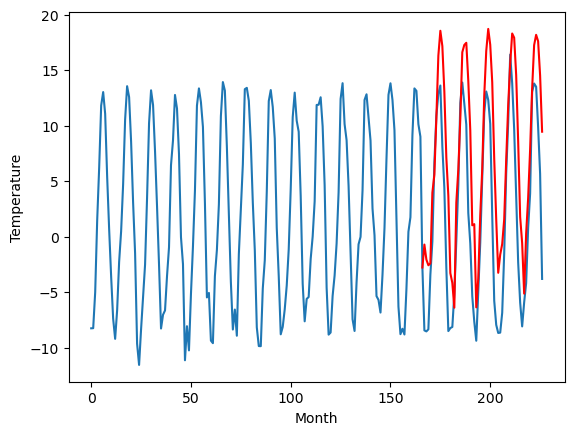

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		-1.77		-3.42
-3.08		-3.12		-0.04
-1.92		-3.63		-1.71
-0.41		-3.47		-3.06
2.70		2.89		0.19
8.61		4.51		-4.10
15.88		9.63		-6.25
19.34		15.24		-4.10
23.57		17.49		-6.08
23.68		16.09		-7.59
18.87		11.99		-6.88
11.93		6.05		-5.88
3.12		2.62		-0.50
-2.57		-4.36		-1.79
-2.02		-5.25		-3.23
0.83		-7.48		-8.31
2.43		2.00		-0.43
10.40		4.97		-5.43
14.83		9.59		-5.24
22.47		15.58		-6.89
23.55		16.23		-7.32
22.32		16.42		-5.90
18.35		12.99		-5.36
8.00		8.50		0.50
5.48		-0.04		-5.52
-1.79		0.07		1.86
-1.86		-7.43		-5.57
0.18		-4.86		-5.04
4.89		0.87		-4.02
9.52		5.06		-4.46
14.19		11.64		-2.55
20.67		15.65		-5.02
22.90		17.64		-5.26
21.31		16.22		-5.09
18.95		12.85		-6.10
11.06		5.94		-5.12
-0.36		0.51		0.87
-2.69		-4.31		-1.62
-3.20		-2.68		0.52
-2.29		-1.72		0.57
0.54		0.51		-0.03
8.49		5.85		-2.64
14.29		10.77		-3.52
16.79		14.53		-2.26
25.15		17.25		-7.90
20.52		16.87		-3.65
15.82		13.51		-2.31


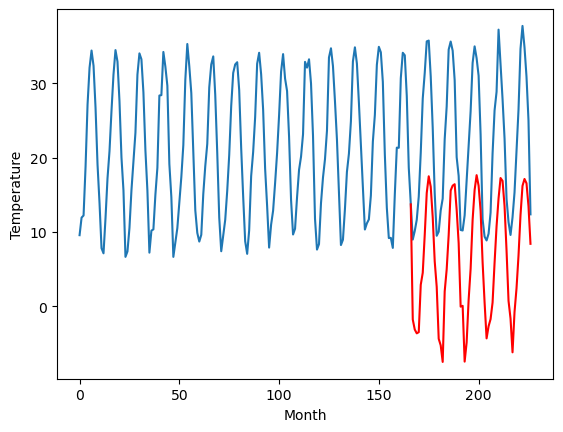

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.04		-4.10		-4.06
-1.29		-5.45		-4.16
-1.92		-5.95		-4.03
0.10		-5.79		-5.89
-0.46		0.56		1.02
3.16		2.17		-0.99
5.56		7.29		1.73
8.10		12.90		4.80
7.29		15.15		7.86
9.17		13.74		4.57
8.59		9.64		1.05
6.37		3.69		-2.68
-0.79		0.26		1.05
-2.84		-6.72		-3.88
-1.62		-7.60		-5.98
-0.69		-9.83		-9.14
-0.91		-0.34		0.57
1.28		2.62		1.34
5.57		7.23		1.66
7.27		13.22		5.95
6.45		13.87		7.42
7.00		14.05		7.05
6.45		10.61		4.16
3.69		6.12		2.43
0.87		-2.42		-3.29
-2.83		-2.32		0.51
-2.21		-9.82		-7.61
-1.25		-7.24		-5.99
0.98		-1.52		-2.50
2.42		2.66		0.24
5.41		9.25		3.84
8.56		13.26		4.70
6.91		15.24		8.33
8.33		13.82		5.49
8.56		10.47		1.91
3.83		3.55		-0.28
-1.90		-1.89		0.01
-3.10		-6.70		-3.60
-1.43		-5.07		-3.64
-3.23		-4.11		-0.88
-1.77		-1.89		-0.12
2.31		3.45		1.14
3.34		8.37		5.03
5.24		12.14		6.90
8.25		14.86		6.61
9.28		14.46		5.18
6.67		11.09		4.42
5.21		5.10		-0.11
1.17		-1.68		-2.85
-

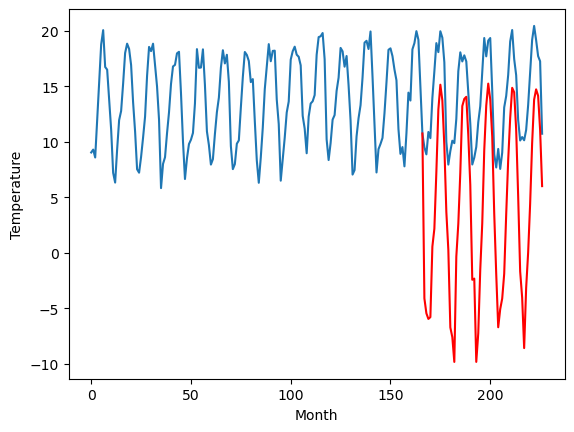

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.08		-3.02		0.06
-5.84		-4.36		1.48
-5.81		-4.88		0.93
-5.37		-4.71		0.66
-1.79		1.65		3.44
-0.35		3.27		3.62
5.21		8.39		3.18
12.19		14.00		1.81
16.14		16.24		0.10
14.96		14.85		-0.11
10.62		10.74		0.12
5.30		4.80		-0.50
1.23		1.37		0.14
-5.11		-5.61		-0.50
-8.13		-6.50		1.63
-8.25		-8.73		-0.48
-3.25		0.75		4.00
1.37		3.72		2.35
6.20		8.33		2.13
12.07		14.30		2.23
14.21		14.96		0.75
14.83		15.15		0.32
11.51		11.71		0.20
7.07		7.23		0.16
-1.85		-1.32		0.53
-3.45		-1.22		2.23
-10.00		-8.72		1.28
-7.24		-6.13		1.11
-3.28		-0.41		2.87
1.01		3.78		2.77
6.80		10.37		3.57
11.12		14.38		3.26
15.67		16.37		0.70
15.59		14.95		-0.64
10.68		11.59		0.91
4.42		4.67		0.25
0.46		-0.77		-1.23
-5.90		-5.59		0.31
-3.92		-3.96		-0.04
-5.65		-3.00		2.65
-3.68		-0.77		2.91
2.37		4.57		2.20
6.01		9.49		3.48
10.00		13.25		3.25
15.68		15.97		0.29
13.43		15.58		2.15
10.86		12.23		1.37
5.43		6.23		0.80
-2.42		-0.5

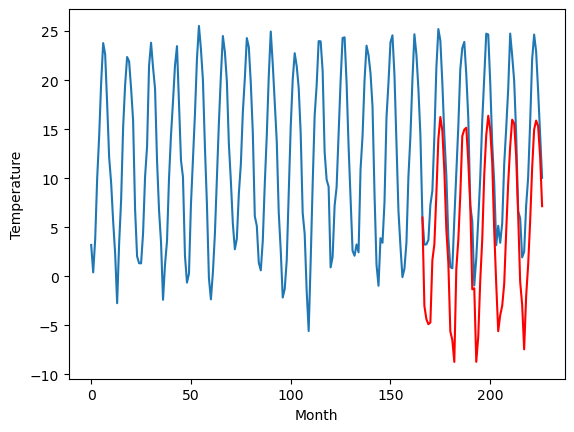

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-17.90		-16.59		1.31
-20.86		-17.93		2.93
-20.45		-18.45		2.00
-19.53		-18.28		1.25
-15.12		-11.92		3.20
-13.18		-10.30		2.88
-7.41		-5.17		2.24
-0.69		0.44		1.13
3.08		2.68		-0.40
1.21		1.28		0.07
-3.76		-2.82		0.94
-9.25		-8.77		0.48
-13.53		-12.19		1.34
-20.35		-19.18		1.17
-21.91		-20.06		1.85
-22.71		-22.29		0.42
-15.52		-12.82		2.70
-10.65		-9.85		0.80
-6.39		-5.24		1.15
-0.22		0.73		0.95
1.42		1.38		-0.04
1.15		1.57		0.42
-3.11		-1.86		1.25
-7.23		-6.34		0.89
-17.45		-14.89		2.56
-17.86		-14.79		3.07
-24.84		-22.28		2.56
-21.03		-19.69		1.34
-15.85		-13.97		1.88
-12.03		-9.77		2.26
-5.25		-3.19		2.06
-1.26		0.83		2.09
2.52		2.83		0.31
1.65		1.41		-0.24
-3.58		-1.96		1.62
-11.19		-8.88		2.31
-14.31		-14.32		-0.01
-21.34		-19.14		2.20
-18.69		-17.51		1.18
-18.48		-16.56		1.92
-16.92		-14.33		2.59
-9.35		-8.98		0.37
-6.88		-4.07		2.81
-2.95		-0.30		2.65
1.89		2.42		0.53
-0.08		2.03		2.11

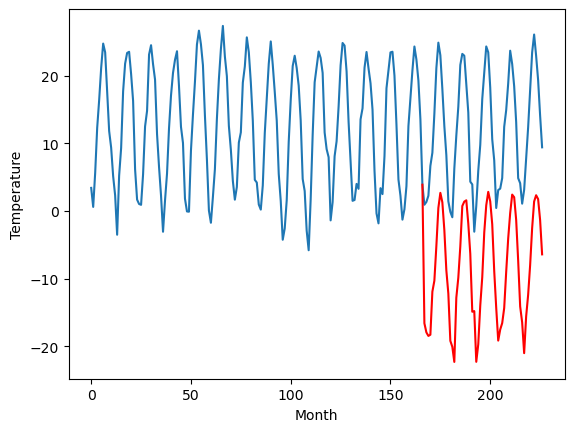

RangeIndex(start=1, stop=12, step=1)
[-17.9, 2.8899999999999997, 4.729999999999999, -7.31, 5.640000000000001, -3.0500000000000007, -4.139999999999999, 1.6500000000000012, -0.03999999999999826, -3.08, -17.9]
[-16.599280586242678, 1.2239859771728518, 0.6887398147582999, -5.150033760070801, 0.5549234390258793, -1.3251633453369145, -0.6926370620727536, -1.7707611846923825, -4.103489875793457, -3.0244025421142577, -16.591198196411135]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0  -17.90 -16.599281
1                 1    2.89   1.223986
2                 2    4.73   0.688740
3                 3   -7.31  -5.150034
4                 4    5.64   0.554923
5                 5   -3.05  -1.325163
6                 6   -4.14  -0.692637
7                 7    1.65  -1.770761
8                 8   -0.04  -4.103490
9                 9   -3.08  -3.024403
10               10  -17.90 -16.591198


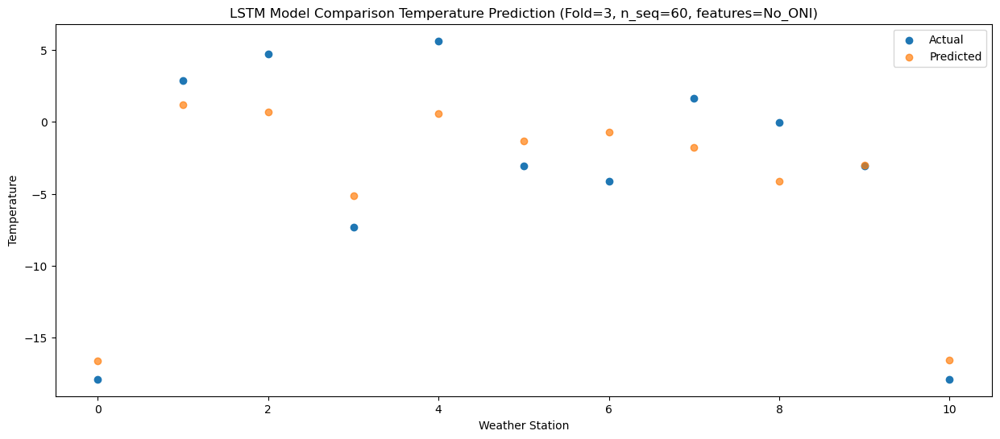

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0  -18.68 -17.940076
1                 1    1.54  -0.122849
2                 2    2.20  -0.660949
3                 3   -7.30  -6.499527
4                 4    2.38  -0.794389
5                 5   -2.84  -2.677257
6                 6   -9.81  -2.050065
7                 7   -3.08  -3.120838
8                 8   -1.29  -5.447270
9                 9   -5.84  -4.364138
10               10  -20.86 -17.933546


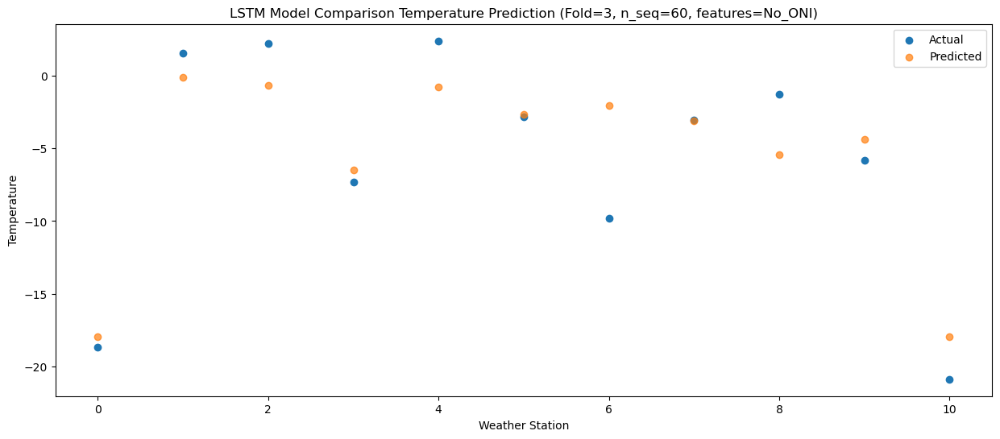

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0  -19.10 -18.451742
1                 1    0.70  -0.637253
2                 2    0.98  -1.170797
3                 3   -7.85  -7.005233
4                 4   -0.49  -1.302598
5                 5   -4.26  -3.185803
6                 6   -9.90  -2.557742
7                 7   -1.92  -3.631405
8                 8   -1.92  -5.951887
9                 9   -5.81  -4.879110
10               10  -20.45 -18.454257


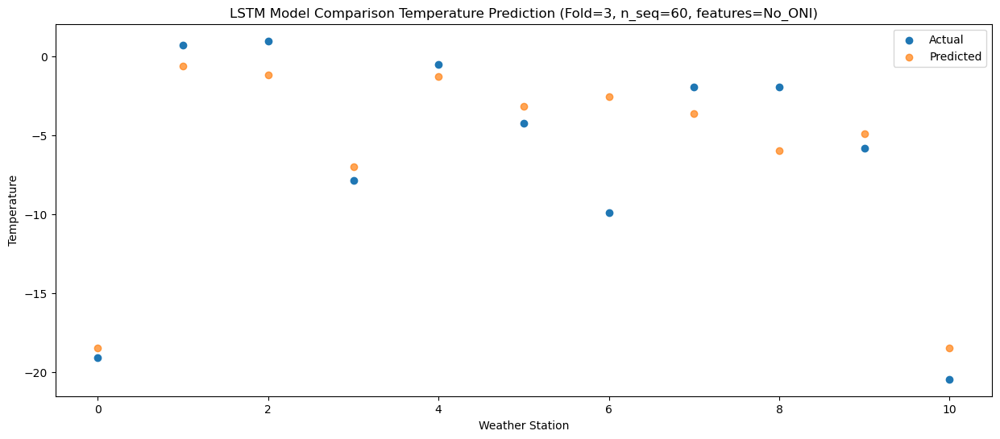

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0  -18.09 -18.281779
1                 1    0.85  -0.466469
2                 2    3.40  -1.012115
3                 3   -8.20  -6.836031
4                 4    0.66  -1.128342
5                 5   -4.67  -3.006916
6                 6   -9.71  -2.389749
7                 7   -0.41  -3.470611
8                 8    0.10  -5.792369
9                 9   -5.37  -4.708866
10               10  -19.53 -18.276347


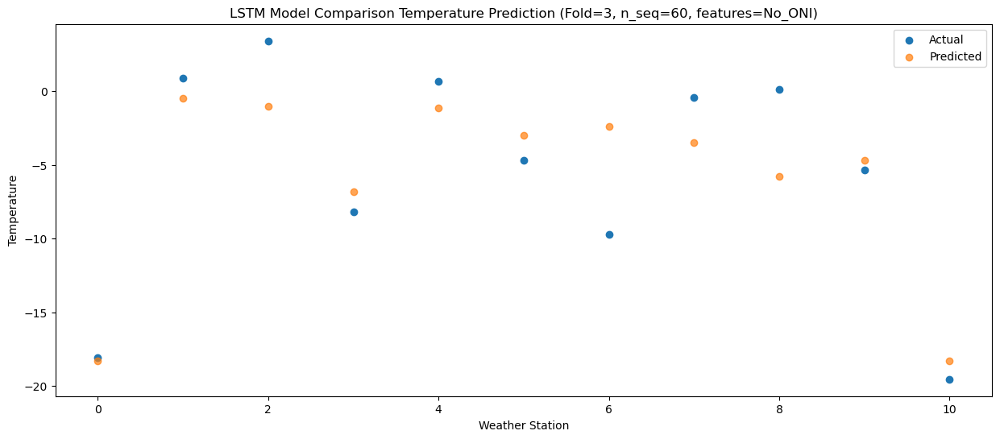

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0  -12.83 -11.922787
1                 1    8.34   5.895734
2                 2    5.19   5.342936
3                 3   -1.29  -0.474810
4                 4    8.07   5.235084
5                 5    2.19   3.365511
6                 6   -4.78   3.980542
7                 7    2.70   2.894166
8                 8   -0.46   0.561976
9                 9   -1.79   1.645647
10               10  -15.12 -11.920161


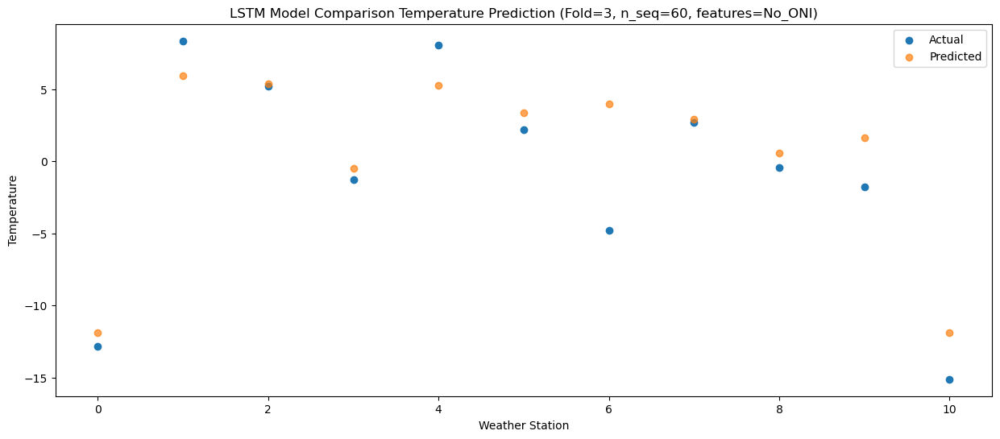

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0  -11.76 -10.309011
1                 1    9.26   7.514273
2                 2    9.85   6.957841
3                 3   -0.65   1.141794
4                 4   11.10   6.856984
5                 5    4.46   4.986951
6                 6   -1.80   5.602297
7                 7    8.61   4.512482
8                 8    3.16   2.170902
9                 9   -0.35   3.265455
10               10  -13.18 -10.298180


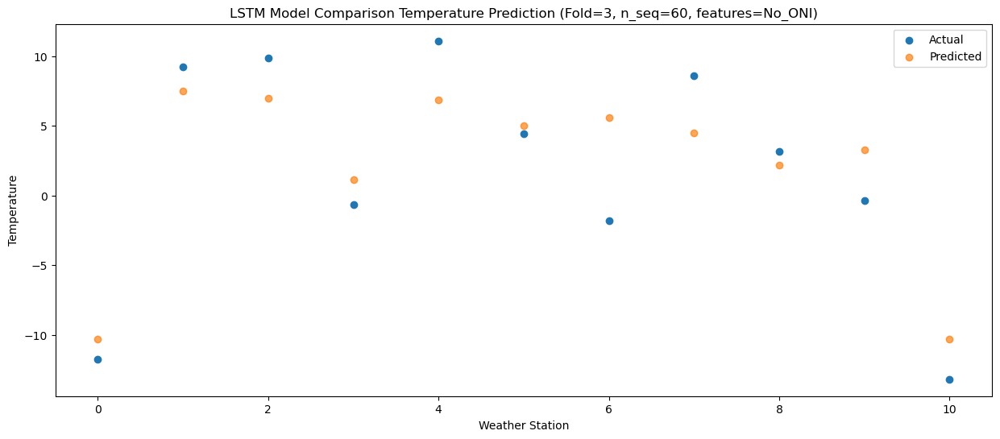

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   -9.07  -5.187179
1                 1   13.66  12.639106
2                 2   15.04  12.070486
3                 3    3.92   6.262761
4                 4   17.17  11.977870
5                 5    9.87  10.109975
6                 6    5.31  10.721110
7                 7   15.88   9.629790
8                 8    5.56   7.286155
9                 9    5.21   8.390709
10               10   -7.41  -5.171001


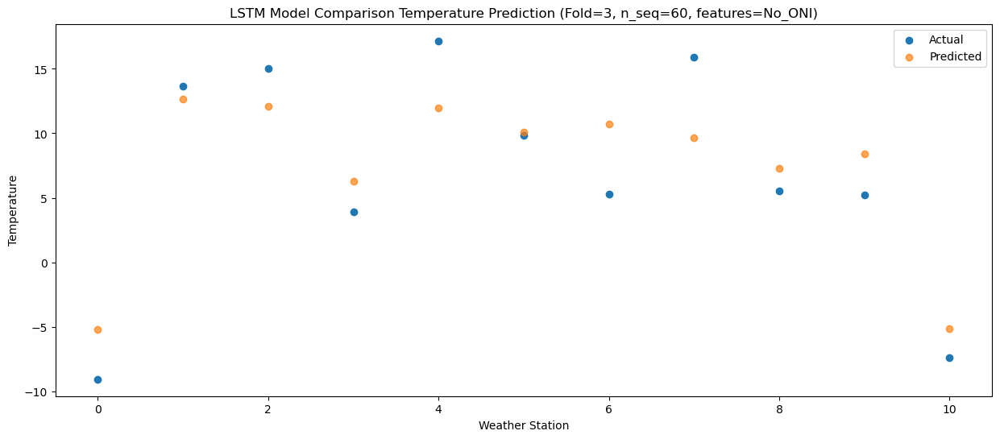

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75   0.424592
1                 1   20.76  18.249365
2                 2   18.39  17.682734
3                 3    9.74  11.877070
4                 4   24.22  17.589090
5                 5   16.86  15.723261
6                 6    9.52  16.333474
7                 7   19.34  15.242383
8                 8    8.10  12.902753
9                 9   12.19  14.004161
10               10   -0.69   0.443800


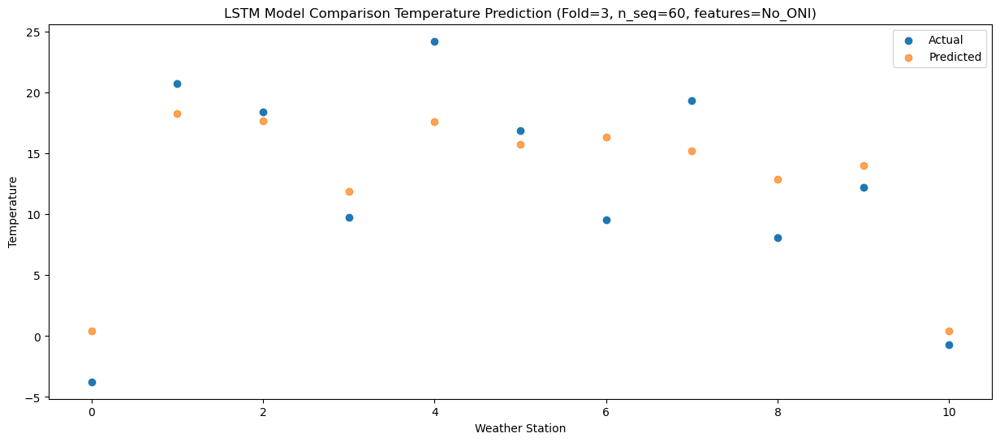

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89   2.664249
1                 1   22.62  20.483776
2                 2   21.17  19.921427
3                 3   13.54  14.116397
4                 4   25.68  19.830494
5                 5   18.75  17.962537
6                 6   11.51  18.573852
7                 7   23.57  17.487845
8                 8    7.29  15.145226
9                 9   16.14  16.244616
10               10    3.08   2.678932


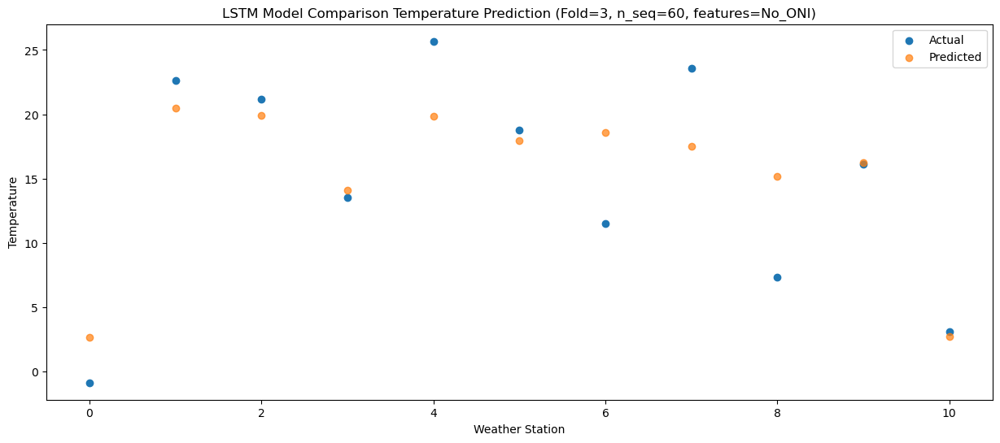

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12   1.275007
1                 1   20.76  19.098101
2                 2   21.70  18.525853
3                 3   11.12  12.727543
4                 4   23.12  18.447468
5                 5   16.24  16.585844
6                 6   12.26  17.192313
7                 7   23.68  16.093903
8                 8    9.17  13.736190
9                 9   14.96  14.847185
10               10    1.21   1.282903


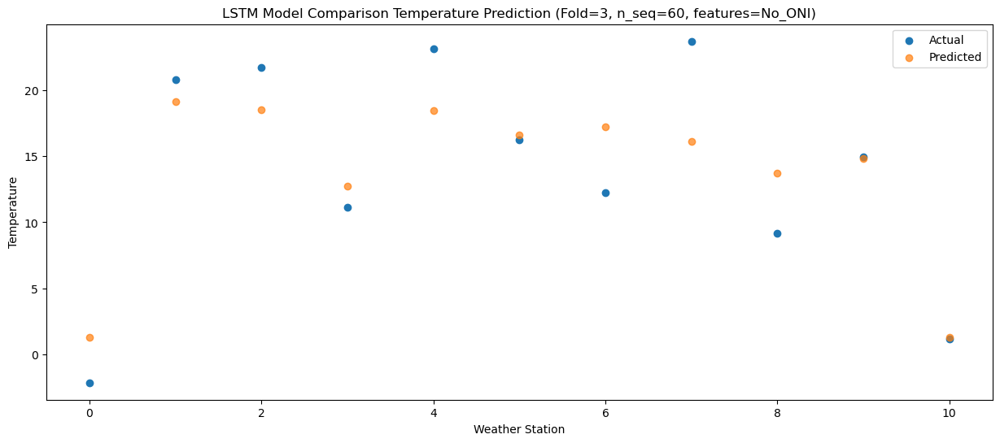

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09  -2.817694
1                 1   17.09  14.994799
2                 2   17.37  14.426044
3                 3    7.06   8.626635
4                 4   19.05  14.340028
5                 5   12.61  12.482655
6                 6    6.76  13.084024
7                 7   18.87  11.988250
8                 8    8.59   9.635569
9                 9   10.62  10.742975
10               10   -3.76  -2.819546


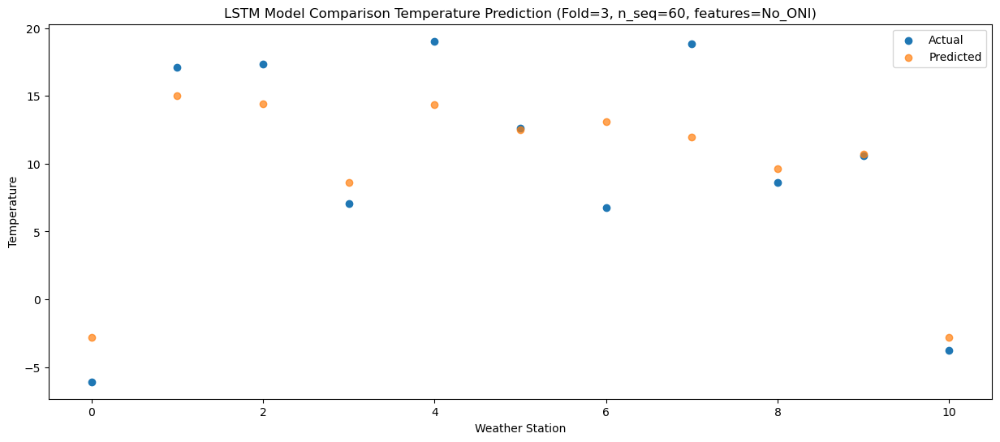

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66  -8.765480
1                 1    9.98   9.044917
2                 2   11.88   8.478074
3                 3    1.64   2.680790
4                 4   11.32   8.393996
5                 5    6.61   6.534271
6                 6    3.02   7.138837
7                 7   11.93   6.046099
8                 8    6.37   3.687027
9                 9    5.30   4.797883
10               10   -9.25  -8.766680


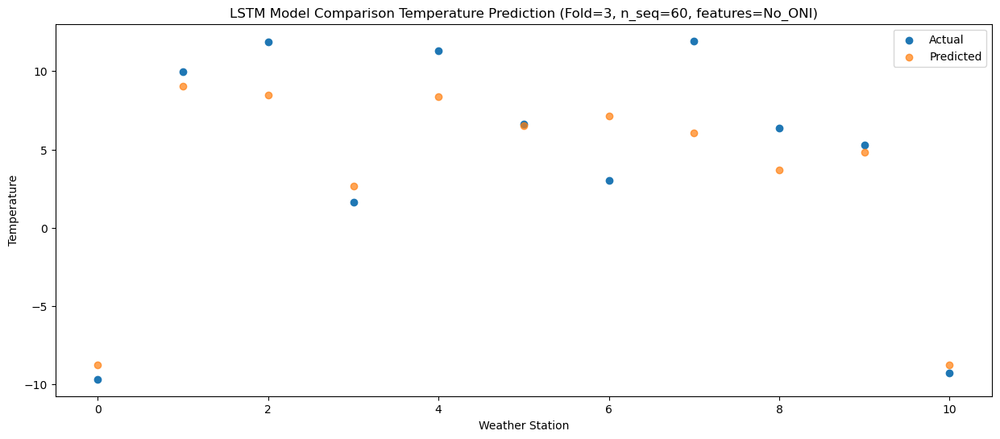

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -12.191438
1                 1    7.16   5.615728
2                 2    3.23   5.052086
3                 3   -2.28  -0.744288
4                 4    8.50   4.966543
5                 5    2.67   3.105900
6                 6   -4.17   3.708548
7                 7    3.12   2.618820
8                 8   -0.79   0.262776
9                 9    1.23   1.372826
10               10  -13.53 -12.193970


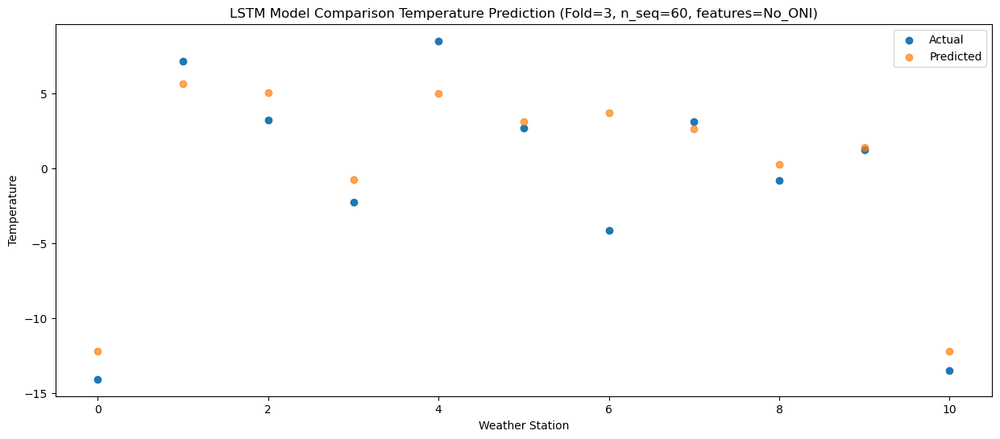

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -19.175680
1                 1    0.61  -1.356795
2                 2    0.03  -1.927616
3                 3   -9.48  -7.715364
4                 4    1.33  -1.997651
5                 5   -4.94  -3.860715
6                 6   -9.87  -3.263683
7                 7   -2.57  -4.362243
8                 8   -2.84  -6.718063
9                 9   -5.11  -5.611758
10               10  -20.35 -19.175882


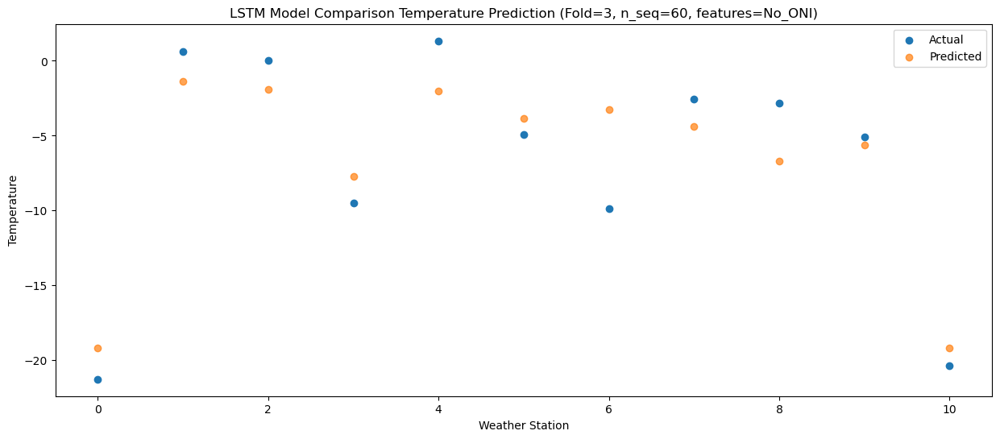

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -20.062450
1                 1   -0.54  -2.243051
2                 2    1.29  -2.813422
3                 3  -10.94  -8.597645
4                 4   -0.14  -2.878616
5                 5   -6.39  -4.743205
6                 6   -9.60  -4.150008
7                 7   -2.02  -5.245859
8                 8   -1.62  -7.597339
9                 9   -8.13  -6.496695
10               10  -21.91 -20.064813


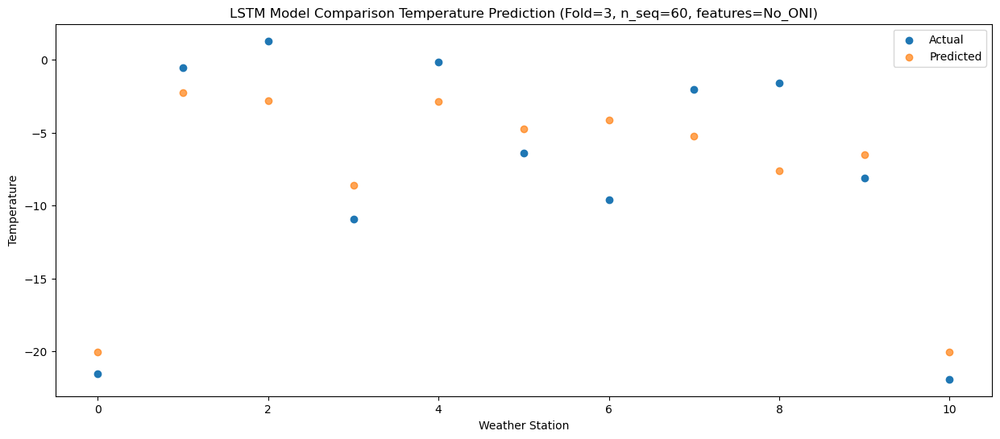

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -22.308434
1                 1   -4.26  -4.479691
2                 2    3.59  -5.049910
3                 3  -12.26 -10.832678
4                 4   -4.01  -5.109104
5                 5   -9.11  -6.975723
6                 6   -9.50  -6.381271
7                 7    0.83  -7.475017
8                 8   -0.69  -9.825721
9                 9   -8.25  -8.726755
10               10  -22.71 -22.294627


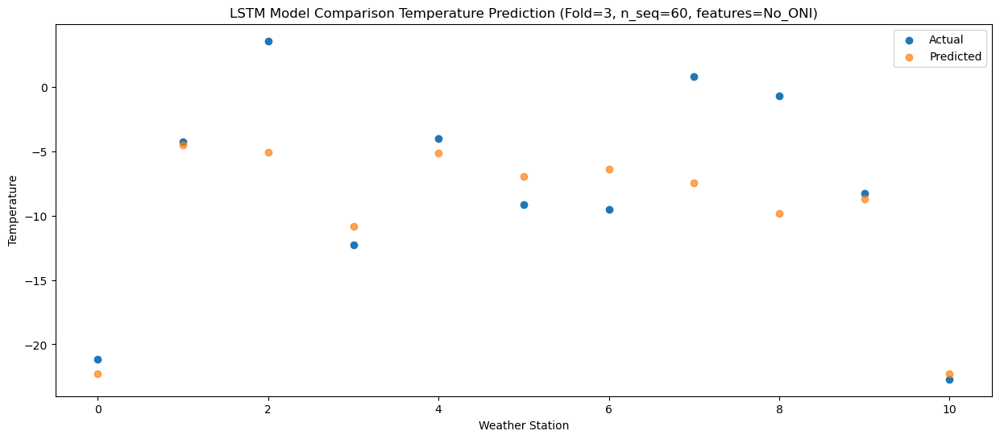

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -12.836701
1                 1    7.71   5.003948
2                 2    4.74   4.432721
3                 3   -2.05  -1.356985
4                 4    9.07   4.369438
5                 5    2.22   2.499448
6                 6   -6.53   3.095367
7                 7    2.43   2.004525
8                 8   -0.91  -0.341366
9                 9   -3.25   0.753968
10               10  -15.52 -12.817655


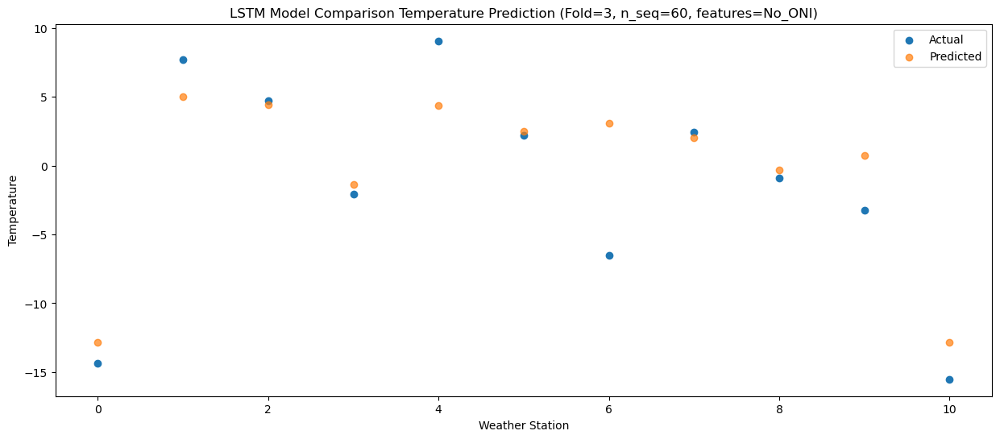

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21  -9.878129
1                 1    9.57   7.963623
2                 2   10.47   7.394666
3                 3    0.30   1.602866
4                 4   12.36   7.332901
5                 5    5.67   5.462597
6                 6   -1.75   6.051538
7                 7   10.40   4.969571
8                 8    1.28   2.619433
9                 9    1.37   3.715793
10               10  -10.65  -9.852120


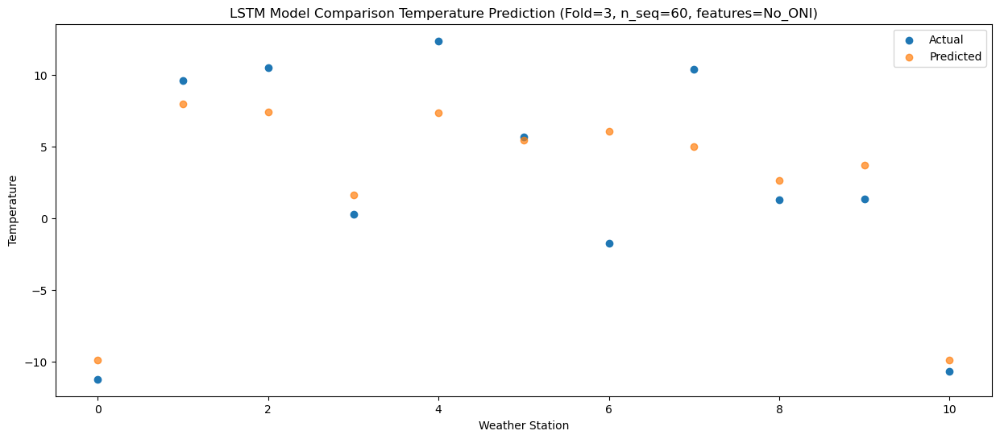

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55  -5.266564
1                 1   13.79  12.579935
2                 2   15.27  12.007074
3                 3    4.37   6.210117
4                 4   16.93  11.945920
5                 5    9.95  10.072775
6                 6    3.30  10.669496
7                 7   14.83   9.591105
8                 8    5.57   7.227770
9                 9    6.20   8.330224
10               10   -6.39  -5.238959


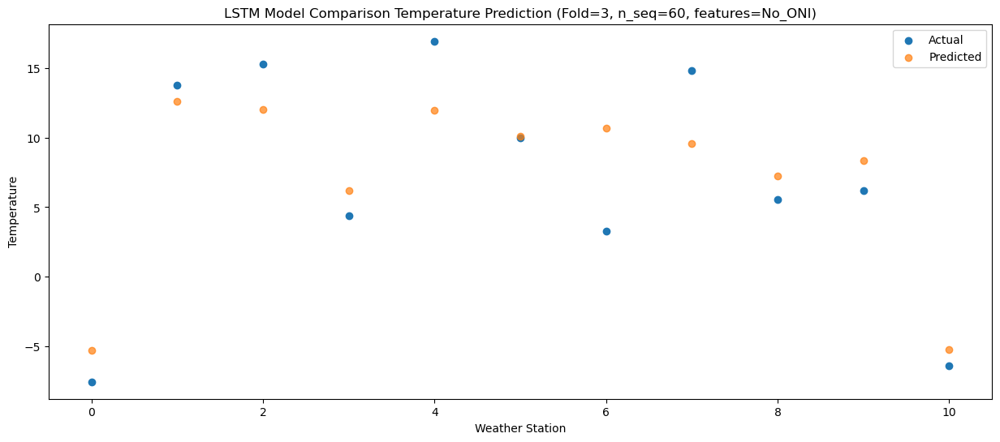

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49   0.695978
1                 1   20.50  18.538501
2                 2   20.12  17.985824
3                 3   10.29  12.175970
4                 4   24.41  17.907105
5                 5   16.66  16.033920
6                 6   10.69  16.642960
7                 7   22.47  15.579075
8                 8    7.27  13.222313
9                 9   12.07  14.304544
10               10   -0.22   0.731253


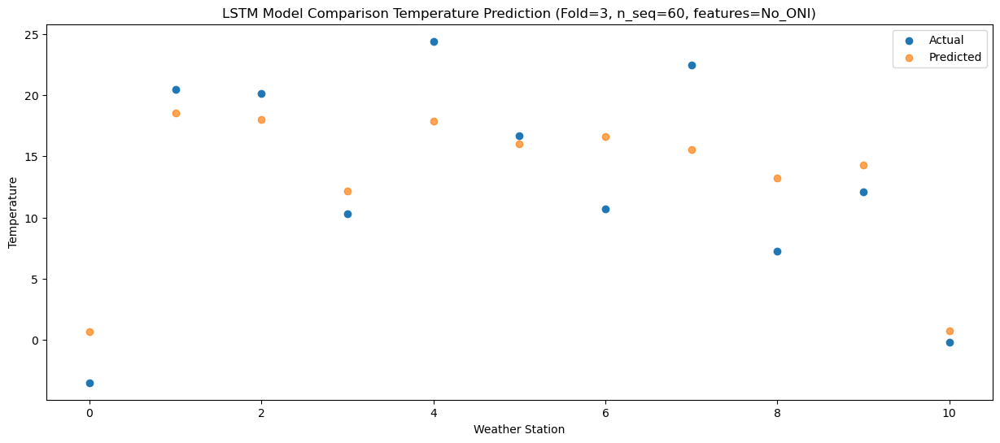

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78   1.351169
1                 1   21.81  19.193848
2                 2   23.25  18.632142
3                 3   11.28  12.830147
4                 4   24.41  18.561429
5                 5   17.04  16.692604
6                 6   12.53  17.295237
7                 7   23.55  16.231367
8                 8    6.45  13.866942
9                 9   14.21  14.958648
10               10    1.42   1.384934


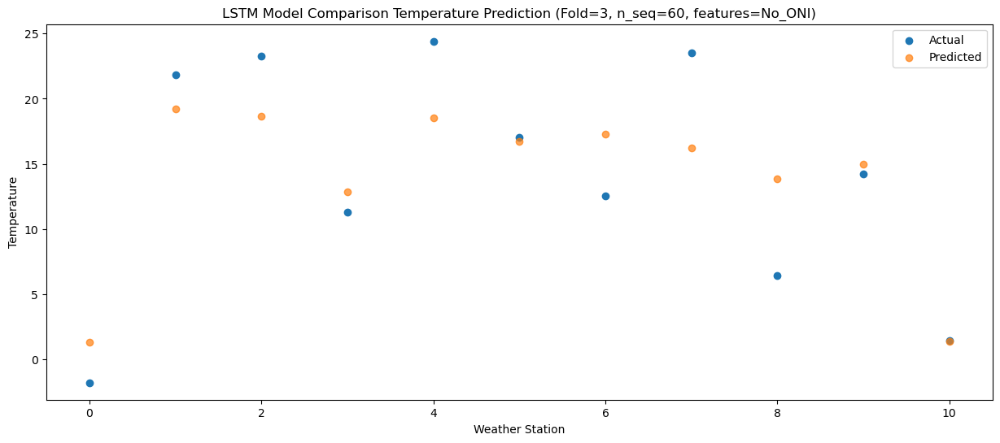

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56   1.536167
1                 1   22.38  19.387505
2                 2   21.05  18.826514
3                 3   11.80  13.022996
4                 4   24.53  18.753516
5                 5   17.36  16.883861
6                 6   10.61  17.491022
7                 7   22.32  16.424816
8                 8    7.00  14.053773
9                 9   14.83  15.148226
10               10    1.15   1.573782


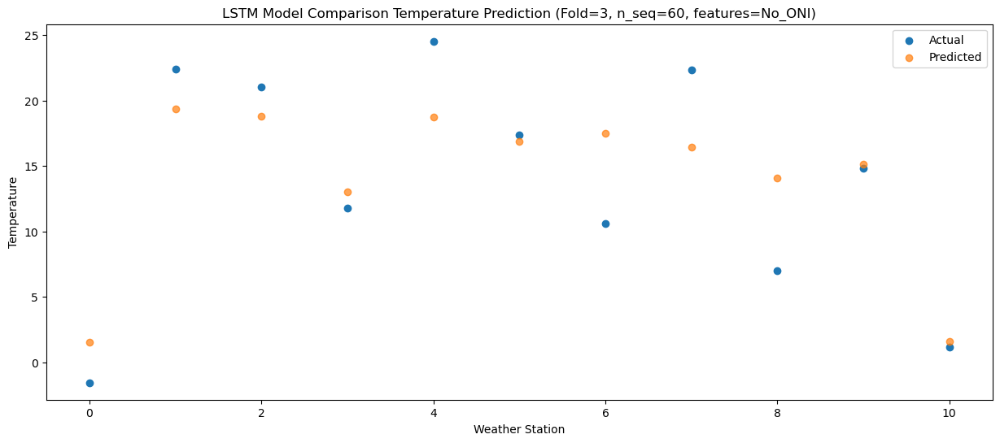

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55  -1.901137
1                 1   19.65  15.954860
2                 2   17.74  15.386906
3                 3    7.67   9.590605
4                 4   21.17  15.326174
5                 5   14.10  13.458958
6                 6    8.74  14.059040
7                 7   18.35  12.986607
8                 8    6.45  10.609077
9                 9   11.51  11.710136
10               10   -3.11  -1.860984


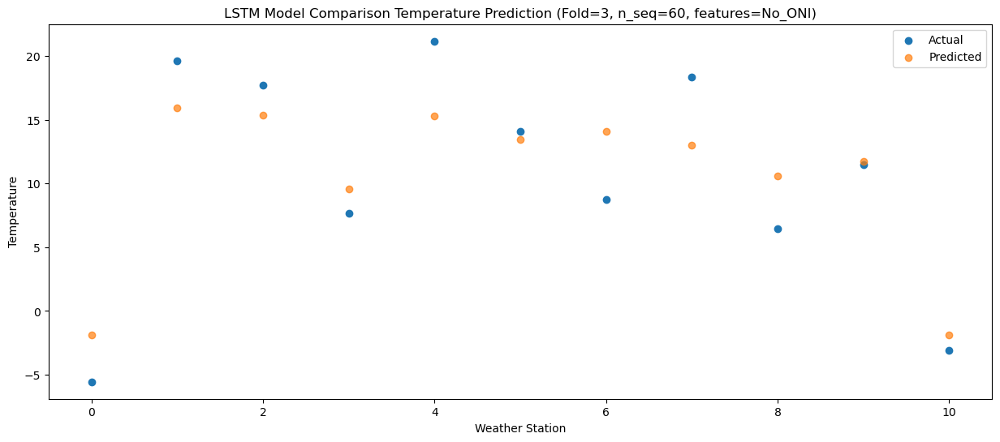

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78  -6.371841
1                 1   13.05  11.482387
2                 2    9.08  10.910011
3                 3    4.09   5.117914
4                 4   15.75  10.856585
5                 5    9.52   8.991681
6                 6    0.77   9.585691
7                 7    8.00   8.501673
8                 8    3.69   6.118811
9                 9    7.07   7.230966
10               10   -7.23  -6.335831


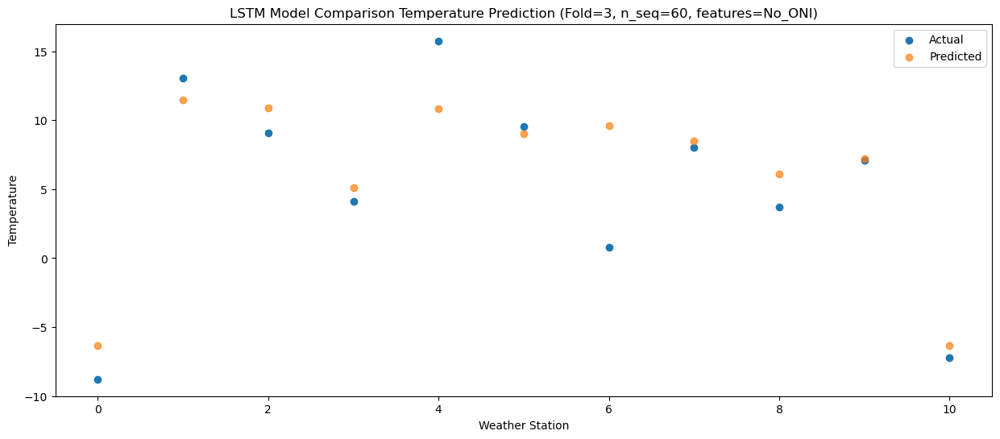

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -14.922193
1                 1    5.34   2.927103
2                 2    4.74   2.366682
3                 3   -5.57  -3.430450
4                 4    6.01   2.303802
5                 5   -1.33   0.441989
6                 6   -1.97   1.043389
7                 7    5.48  -0.041390
8                 8    0.87  -2.424018
9                 9   -1.85  -1.319633
10               10  -17.45 -14.885788


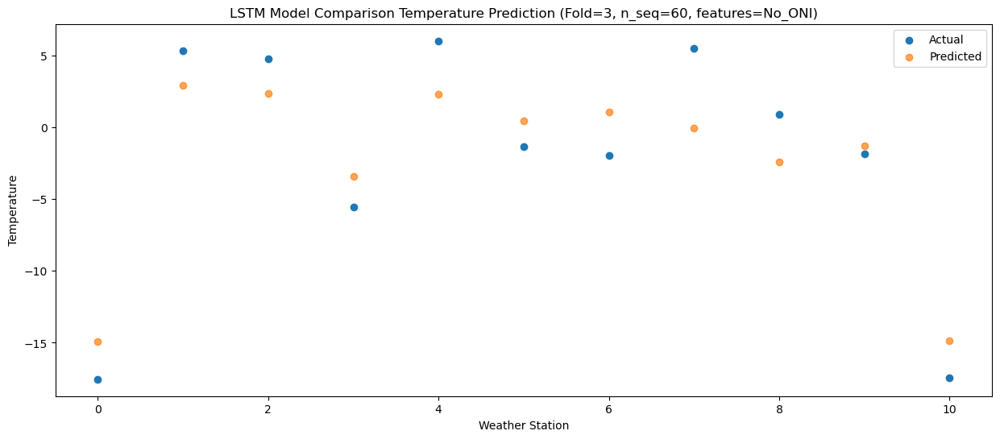

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -14.825591
1                 1    6.65   3.027334
2                 2    0.82   2.467543
3                 3   -4.08  -3.328007
4                 4    5.65   2.404163
5                 5   -0.28   0.544708
6                 6   -6.73   1.147212
7                 7   -1.79   0.065784
8                 8   -2.83  -2.320427
9                 9   -3.45  -1.220625
10               10  -17.86 -14.786329


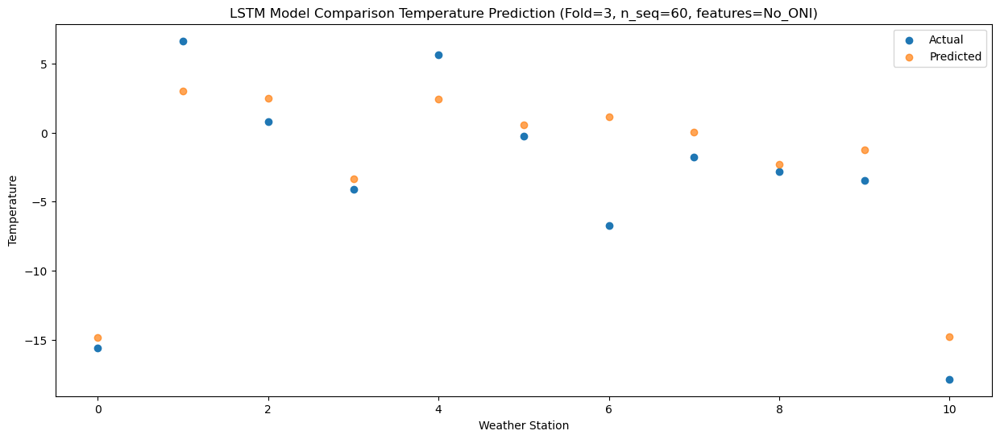

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -22.338760
1                 1   -2.18  -4.489151
2                 2    0.49  -5.043885
3                 3  -13.03 -10.841541
4                 4   -3.82  -5.103462
5                 5   -9.10  -6.957597
6                 6   -9.02  -6.352991
7                 7   -1.86  -7.434366
8                 8   -2.21  -9.822949
9                 9  -10.00  -8.719578
10               10  -24.84 -22.279328


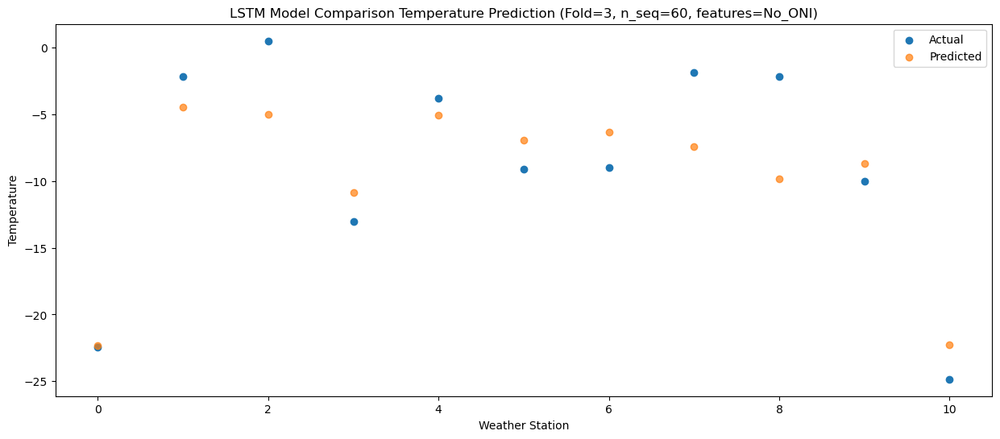

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -19.757165
1                 1   -0.96  -1.908141
2                 2    2.19  -2.459682
3                 3   -8.51  -8.259256
4                 4   -1.30  -2.520390
5                 5   -5.91  -4.377564
6                 6  -10.74  -3.771713
7                 7    0.18  -4.857531
8                 8   -1.25  -7.241260
9                 9   -7.24  -6.132524
10               10  -21.03 -19.691642


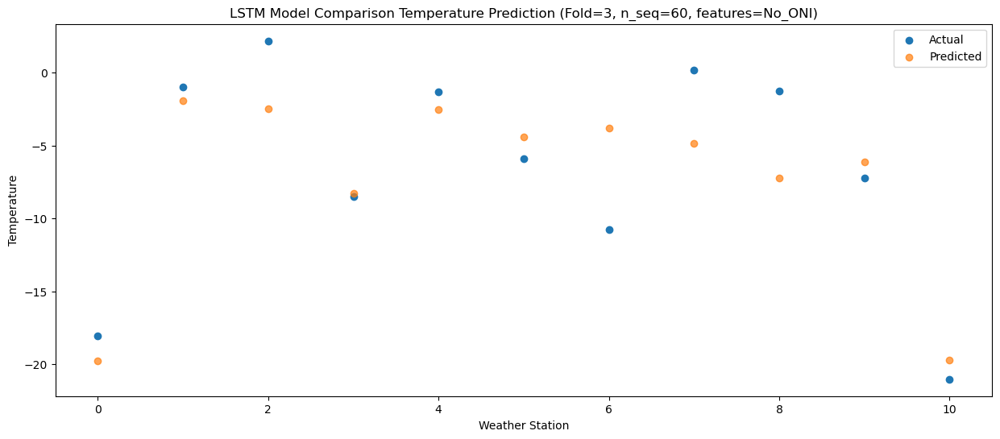

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -14.049719
1                 1    5.82   3.806319
2                 2    6.90   3.252282
3                 3   -2.76  -2.545411
4                 4    7.16   3.197318
5                 5    1.05   1.341385
6                 6   -6.20   1.958935
7                 7    4.89   0.873396
8                 8    0.98  -1.520867
9                 9   -3.28  -0.414149
10               10  -15.85 -13.969056


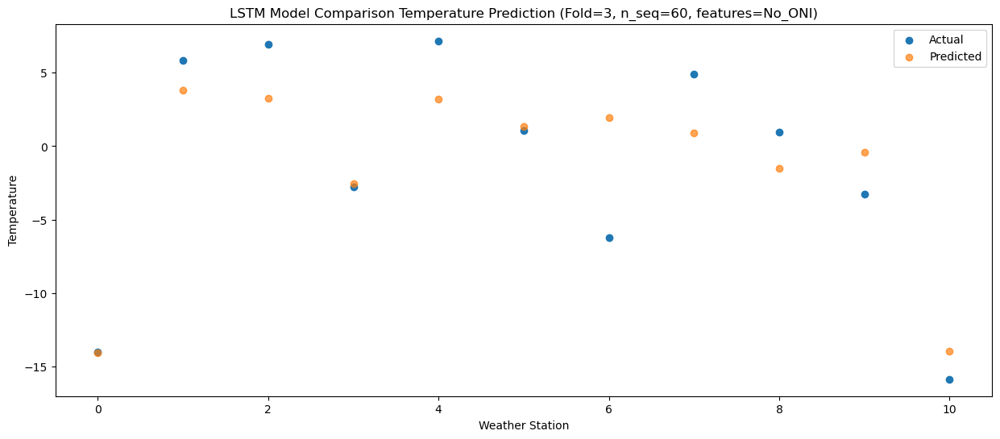

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88  -9.847958
1                 1   10.67   7.999972
2                 2    9.97   7.443281
3                 3    0.25   1.653180
4                 4   11.29   7.394211
5                 5    4.90   5.536639
6                 6   -1.88   6.151707
7                 7    9.52   5.056547
8                 8    2.42   2.660191
9                 9    1.01   3.777526
10               10  -12.03  -9.773777


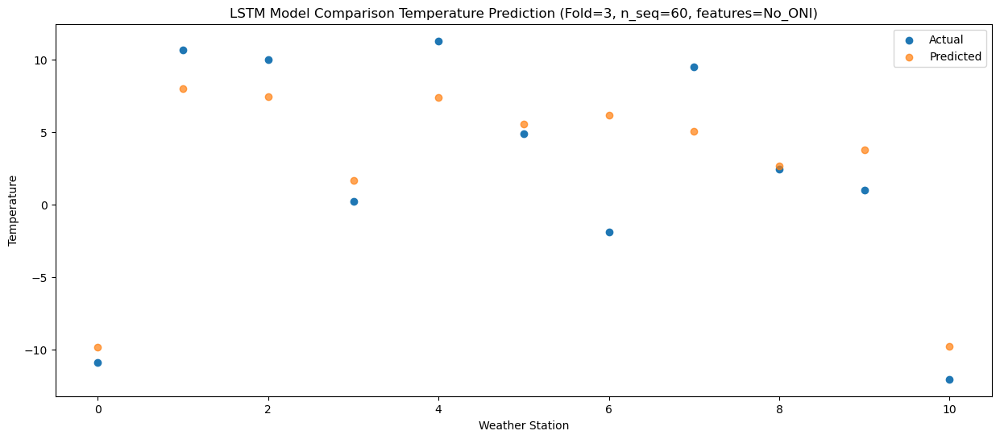

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04  -3.259842
1                 1   16.10  14.586891
2                 2   14.21  14.031275
3                 3    7.03   8.236087
4                 4   18.86  13.975204
5                 5   12.70  12.115931
6                 6    4.03  12.734014
7                 7   14.19  11.641949
8                 8    5.41   9.248291
9                 9    6.80  10.365568
10               10   -5.25  -3.185582


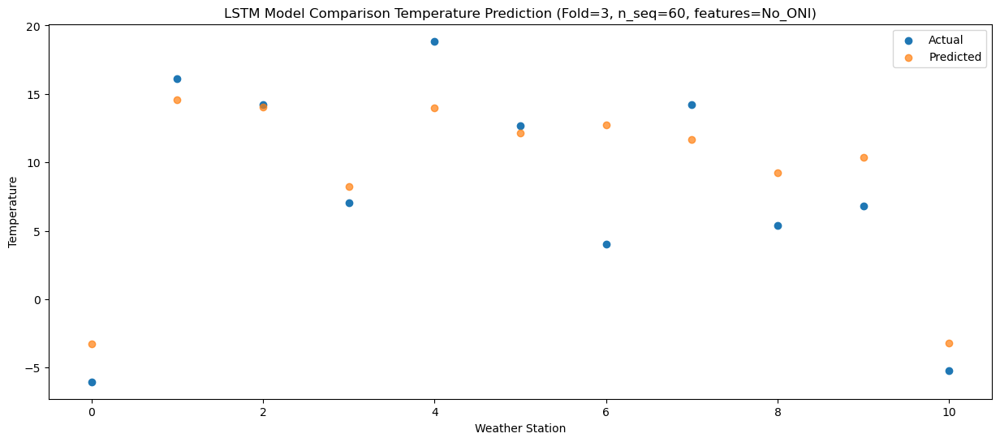

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08   0.773034
1                 1   21.25  18.617616
2                 2   19.60  18.047916
3                 3   10.51  12.261846
4                 4   24.31  18.007357
5                 5   16.64  16.149419
6                 6    9.80  16.754268
7                 7   20.67  15.653238
8                 8    8.56  13.256011
9                 9   11.12  14.383122
10               10   -1.26   0.834597


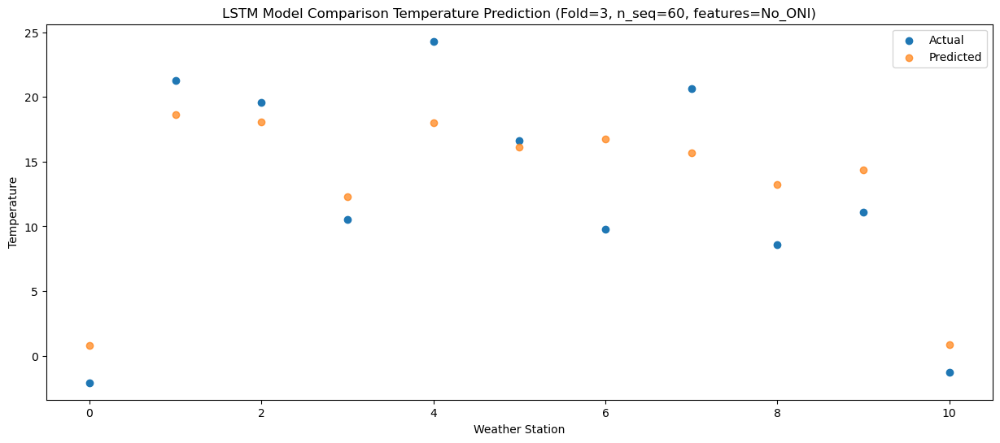

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31   2.759464
1                 1   25.29  20.610245
2                 2   22.17  20.033471
3                 3   12.06  14.248977
4                 4   25.43  19.995879
5                 5   18.63  18.139273
6                 6   11.72  18.741030
7                 7   22.90  17.639377
8                 8    6.91  15.242856
9                 9   15.67  16.370559
10               10    2.52   2.825406


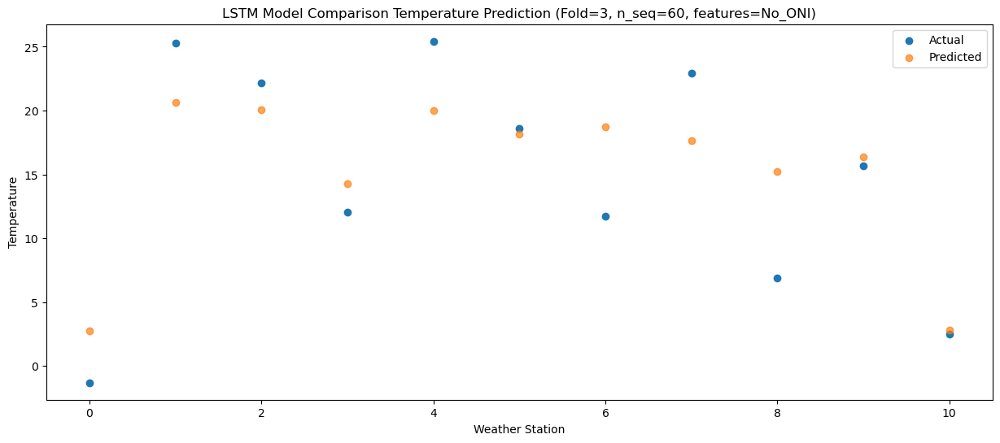

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22   1.326444
1                 1   22.21  19.182822
2                 2   22.35  18.609396
3                 3   10.99  12.814806
4                 4   23.61  18.563335
5                 5   16.98  16.705990
6                 6   10.96  17.313809
7                 7   21.31  16.218027
8                 8    8.33  13.823140
9                 9   15.59  14.950879
10               10    1.65   1.406332


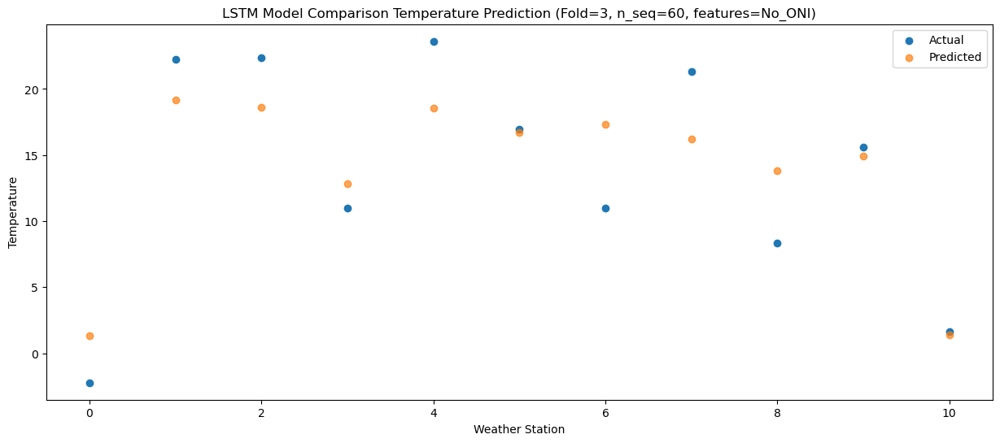

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43  -2.042301
1                 1   18.35  15.809588
2                 2   19.53  15.244945
3                 3    7.01   9.448086
4                 4   19.29  15.194799
5                 5   13.03  13.330796
6                 6    8.80  13.940303
7                 7   18.95  12.849326
8                 8    8.56  10.465705
9                 9   10.68  11.585366
10               10   -3.58  -1.959374


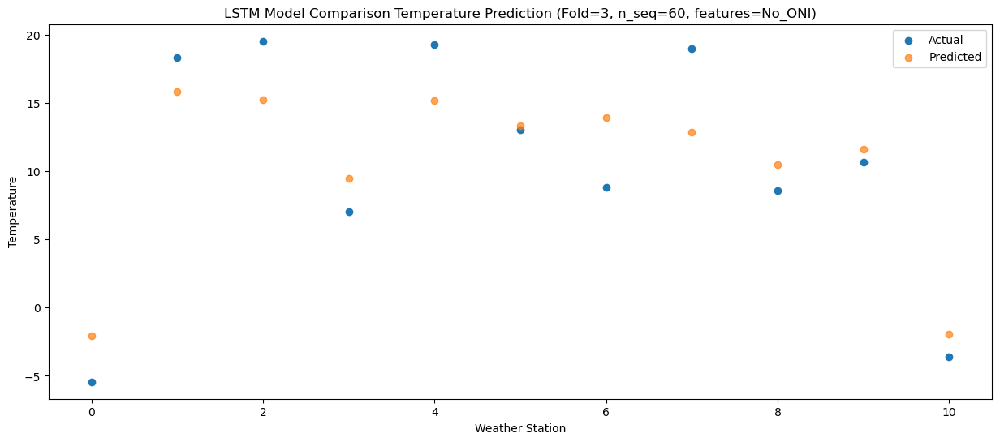

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44  -8.965276
1                 1   11.80   8.895161
2                 2   12.35   8.328417
3                 3   -0.26   2.535162
4                 4   12.02   8.289873
5                 5    6.99   6.422791
6                 6    0.54   7.026035
7                 7   11.06   5.937809
8                 8    3.83   3.547964
9                 9    4.42   4.666128
10               10  -11.19  -8.879657


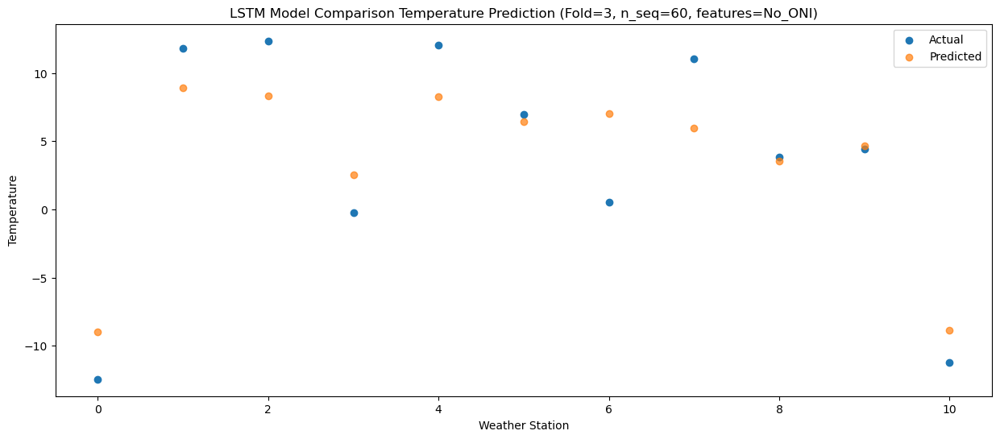

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -14.404958
1                 1    4.57   3.459308
2                 2    1.62   2.892870
3                 3   -3.38  -2.903577
4                 4    6.13   2.845637
5                 5    0.44   0.976397
6                 6   -7.14   1.584784
7                 7   -0.36   0.509872
8                 8   -1.90  -1.888476
9                 9    0.46  -0.765320
10               10  -14.31 -14.315856


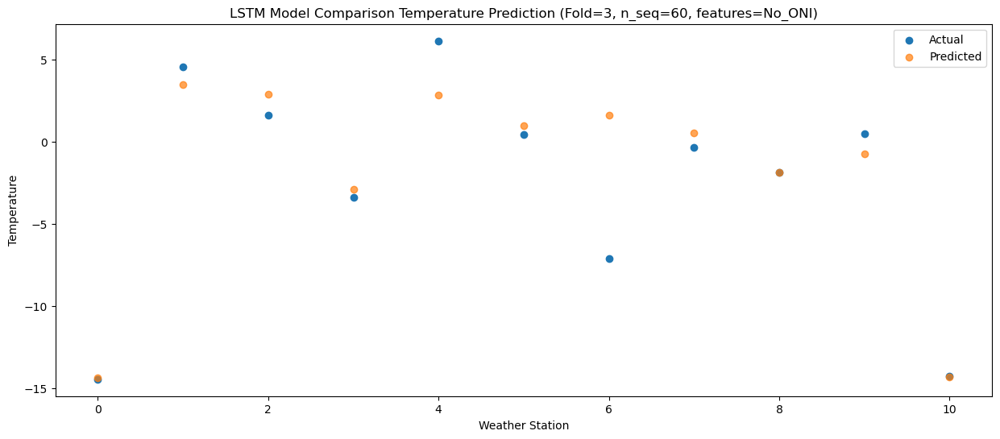

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -19.227583
1                 1    0.52  -1.363708
2                 2    0.66  -1.927382
3                 3   -8.65  -7.727342
4                 4    0.16  -1.975425
5                 5   -5.10  -3.845343
6                 6   -9.31  -3.236009
7                 7   -2.69  -4.310155
8                 8   -3.10  -6.704009
9                 9   -5.90  -5.590684
10               10  -21.34 -19.142876


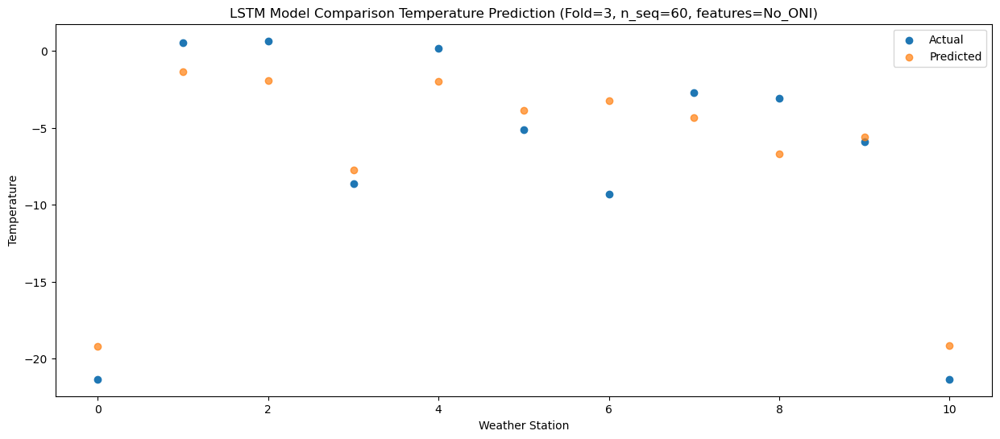

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -17.598503
1                 1    1.22   0.264689
2                 2    2.05  -0.305265
3                 3   -6.90  -6.105625
4                 4    1.88  -0.348092
5                 5   -2.96  -2.214206
6                 6  -10.04  -1.601916
7                 7   -3.20  -2.675976
8                 8   -1.43  -5.070901
9                 9   -3.92  -3.962385
10               10  -18.69 -17.513135


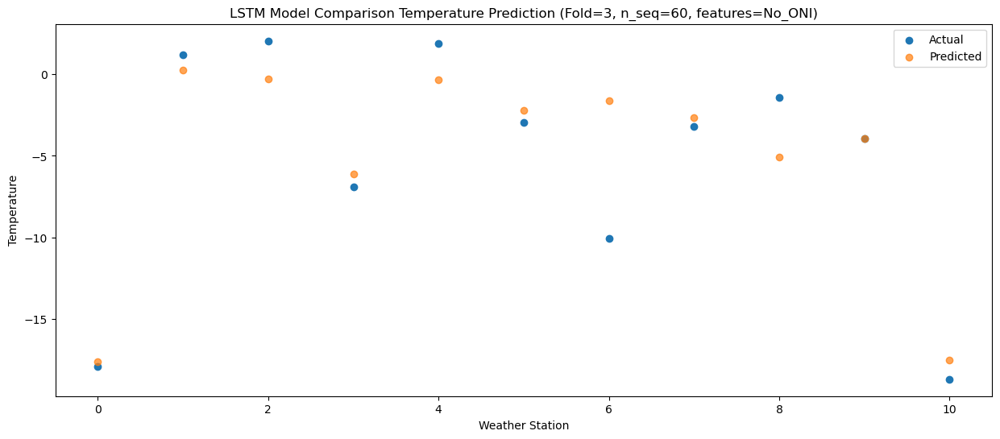

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -16.638913
1                 1    3.18   1.218033
2                 2    1.20   0.650687
3                 3   -4.56  -5.153209
4                 4    8.40   0.605592
5                 5   -1.24  -1.260235
6                 6  -10.01  -0.644432
7                 7   -2.29  -1.716722
8                 8   -3.23  -4.114251
9                 9   -5.65  -3.003287
10               10  -18.48 -16.555413


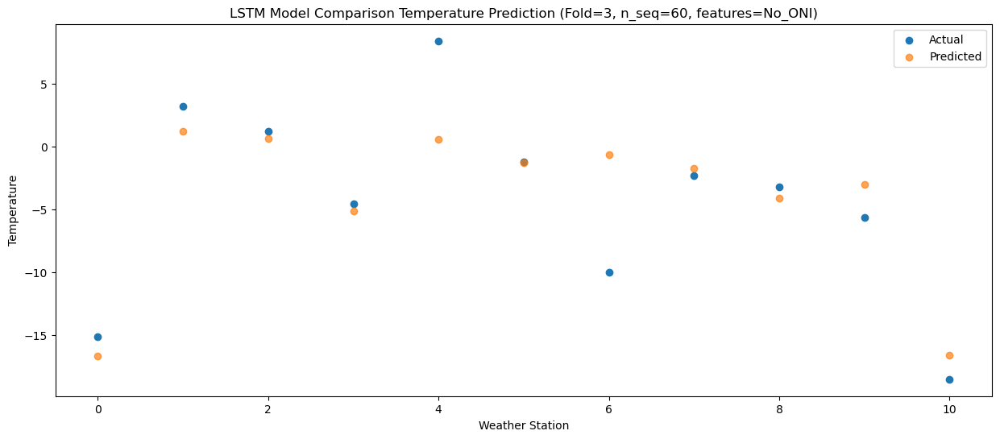

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -14.429107
1                 1    5.78   3.438923
2                 2    4.07   2.867478
3                 3   -4.32  -2.938152
4                 4    5.44   2.828735
5                 5   -0.34   0.960523
6                 6   -8.22   1.580800
7                 7    0.54   0.512798
8                 8   -1.77  -1.886643
9                 9   -3.68  -0.773379
10               10  -16.92 -14.330822


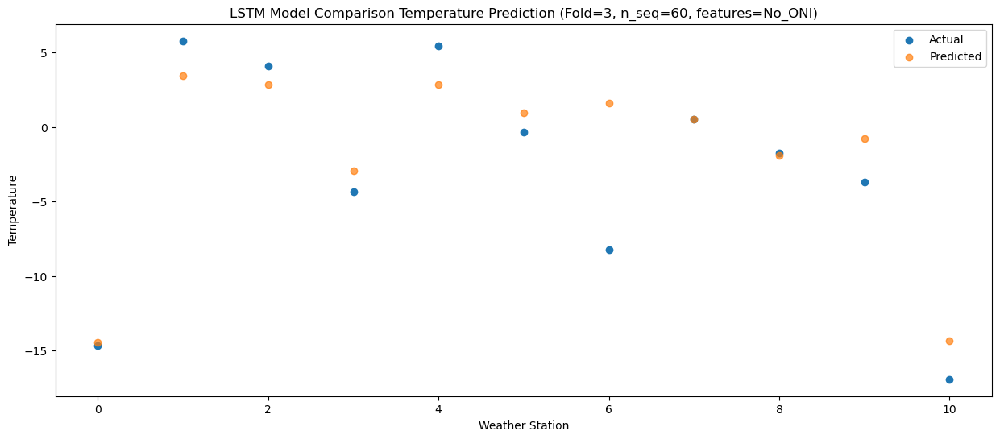

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97  -9.093583
1                 1   10.83   8.776222
2                 2    9.70   8.203552
3                 3    1.92   2.401782
4                 4   12.65   8.171781
5                 5    5.89   6.304892
6                 6   -2.88   6.924165
7                 7    8.49   5.848394
8                 8    2.31   3.451893
9                 9    2.37   4.569424
10               10   -9.35  -8.984566


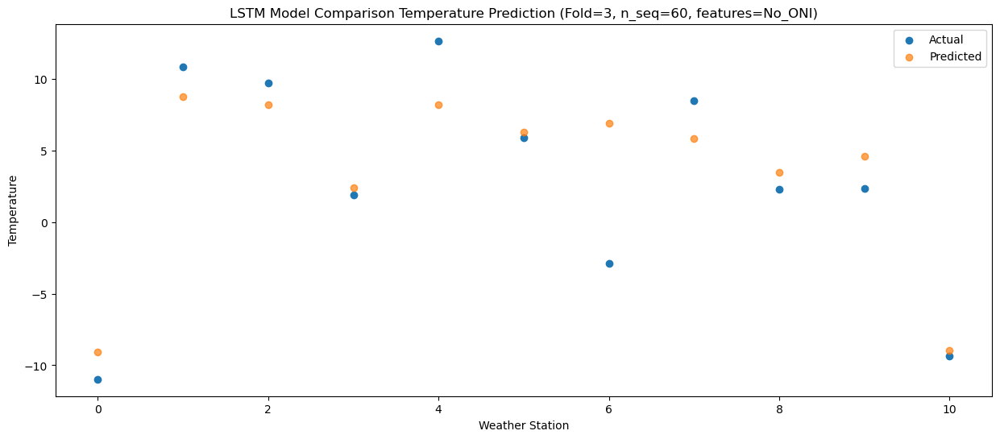

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61  -4.165591
1                 1   16.14  13.707518
2                 2   14.14  13.121978
3                 3    4.61   7.326025
4                 4   18.65  13.095260
5                 5   11.30  11.226430
6                 6    4.33  11.847192
7                 7   14.29  10.767296
8                 8    3.34   8.369635
9                 9    6.01   9.488358
10               10   -6.88  -4.065575


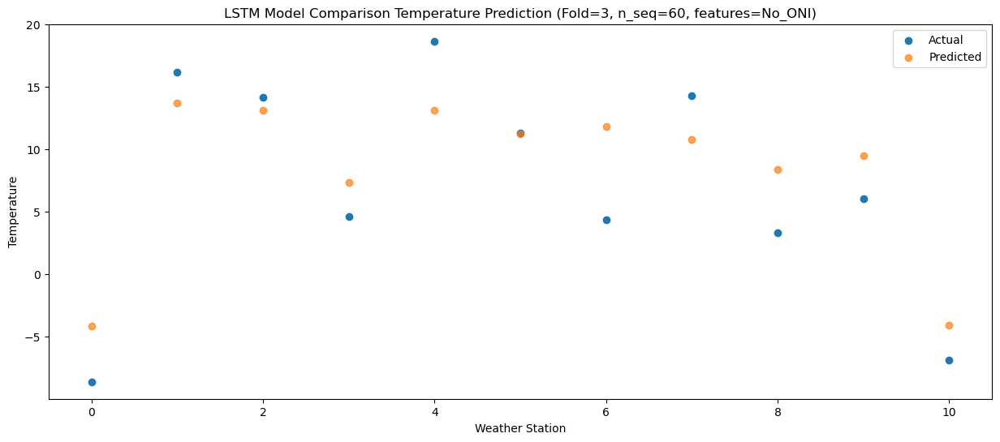

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84  -0.397963
1                 1   20.47  17.476035
2                 2   16.94  16.902074
3                 3    8.35  11.097984
4                 4   22.75  16.865320
5                 5   14.76  14.991101
6                 6    8.91  15.611103
7                 7   16.79  14.532535
8                 8    5.24  12.138261
9                 9   10.00  13.253928
10               10   -2.95  -0.302004


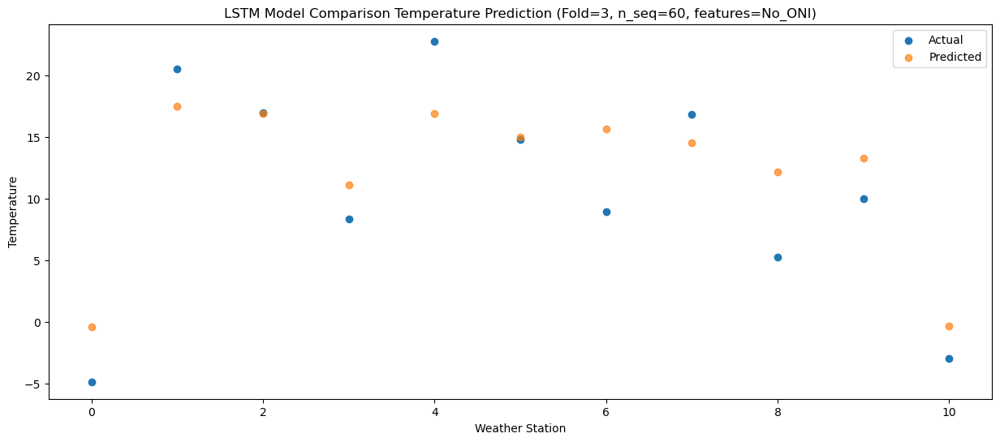

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06   2.319485
1                 1   22.73  20.191160
2                 2   22.60  19.627714
3                 3   11.97  13.817519
4                 4   24.45  19.583615
5                 5   18.02  17.705224
6                 6   15.05  18.329228
7                 7   25.15  17.254550
8                 8    8.25  14.864299
9                 9   15.68  15.974351
10               10    1.89   2.416514


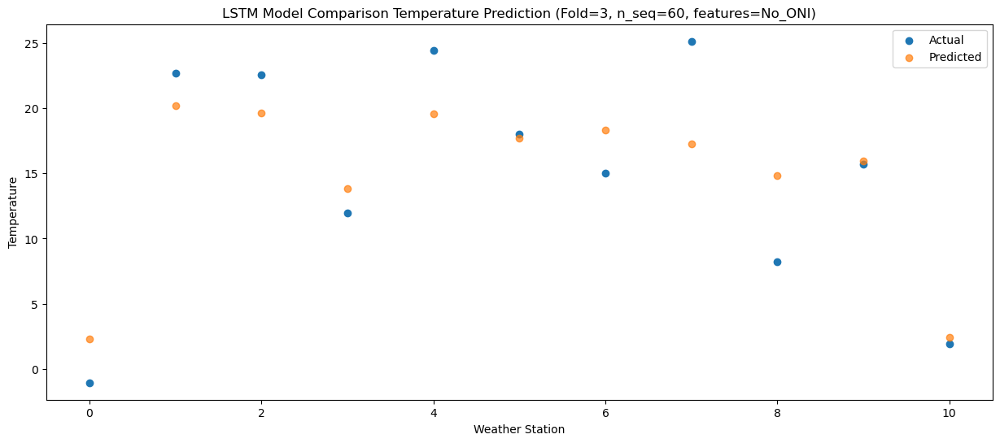

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57   1.922581
1                 1   22.91  19.805624
2                 2   20.91  19.234939
3                 3   10.86  13.427444
4                 4   23.16  19.203811
5                 5   16.47  17.326801
6                 6   12.46  17.949995
7                 7   20.52  16.868219
8                 8    9.28  14.462083
9                 9   13.43  15.582168
10               10   -0.08   2.028687


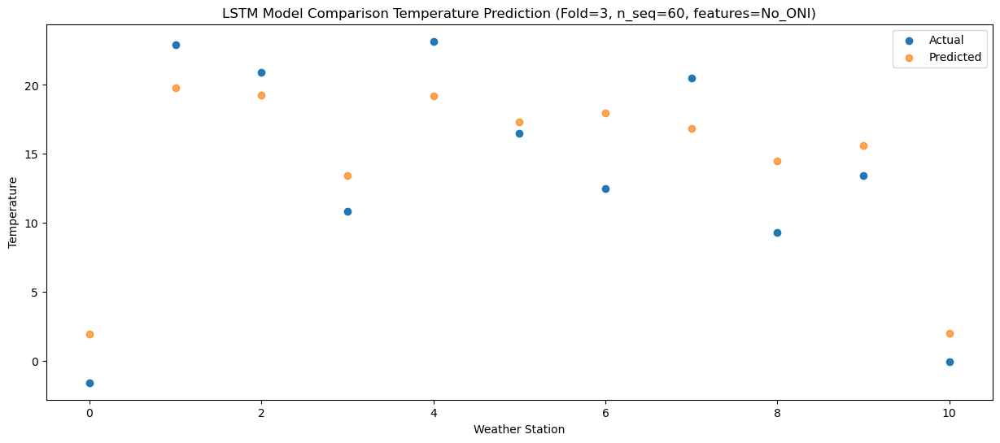

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71  -1.434128
1                 1   18.86  16.445937
2                 2   17.14  15.868185
3                 3    8.13  10.069224
4                 4   19.80  15.843804
5                 5   13.01  13.966195
6                 6    8.31  14.586747
7                 7   15.82  13.507813
8                 8    6.67  11.094154
9                 9   10.86  12.227062
10               10   -3.37  -1.326705


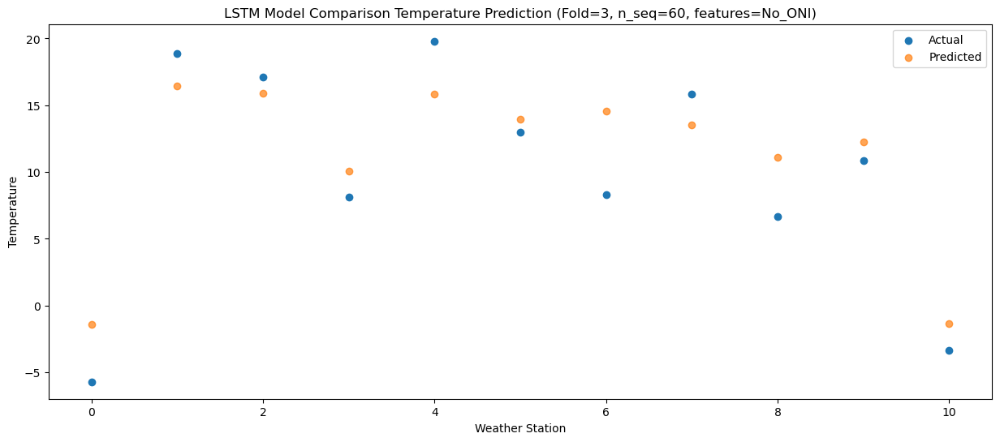

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74  -7.439471
1                 1   11.92  10.428544
2                 2   11.83   9.867034
3                 3    2.69   4.063390
4                 4   13.34   9.828679
5                 5    7.36   7.949696
6                 6    2.18   8.576329
7                 7   10.53   7.511659
8                 8    5.21   5.101746
9                 9    5.43   6.226507
10               10   -8.66  -7.325446


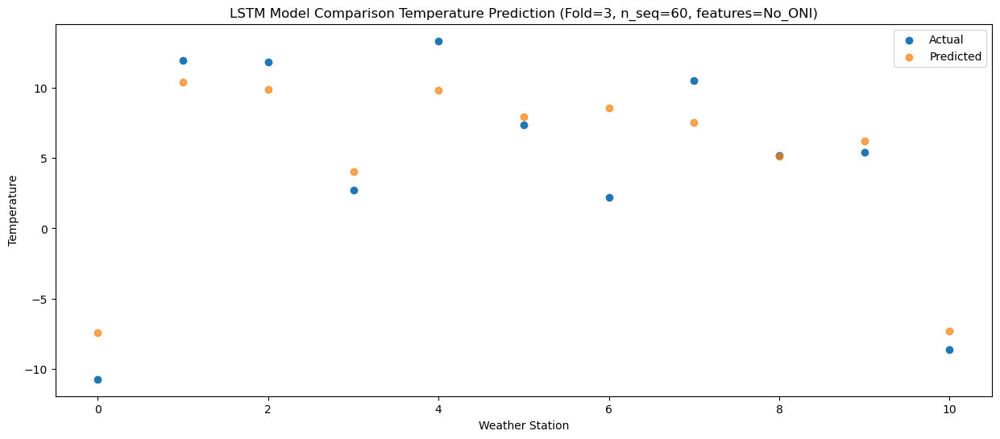

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -14.214436
1                 1    6.14   3.660201
2                 2    4.92   3.091226
3                 3   -3.70  -2.710508
4                 4    6.39   3.054486
5                 5    0.88   1.167568
6                 6   -3.68   1.796239
7                 7    2.39   0.729594
8                 8    1.17  -1.676255
9                 9   -2.42  -0.543297
10               10  -16.93 -14.101347


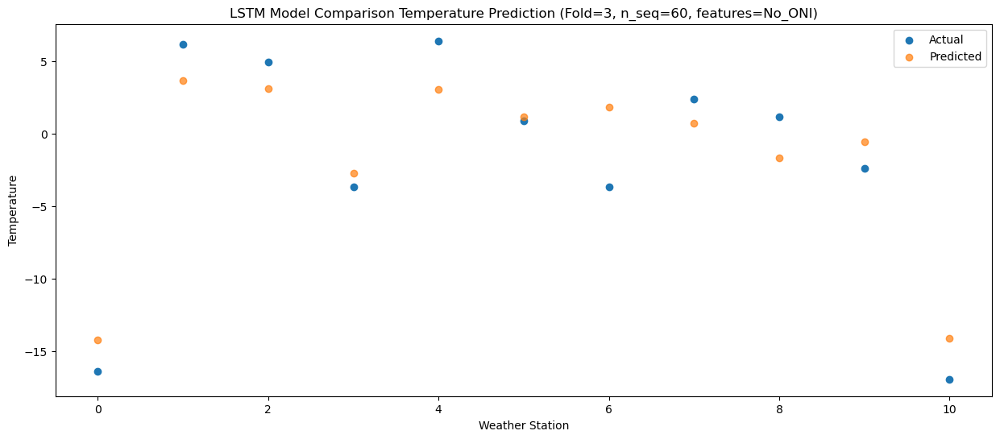

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -16.573011
1                 1    2.79   1.297209
2                 2    3.08   0.727880
3                 3   -5.53  -5.070137
4                 4    3.58   0.690795
5                 5   -1.58  -1.196399
6                 6   -7.31  -0.568043
7                 7   -0.74  -1.636103
8                 8   -0.67  -4.030621
9                 9   -3.15  -2.900718
10               10  -17.68 -16.456972


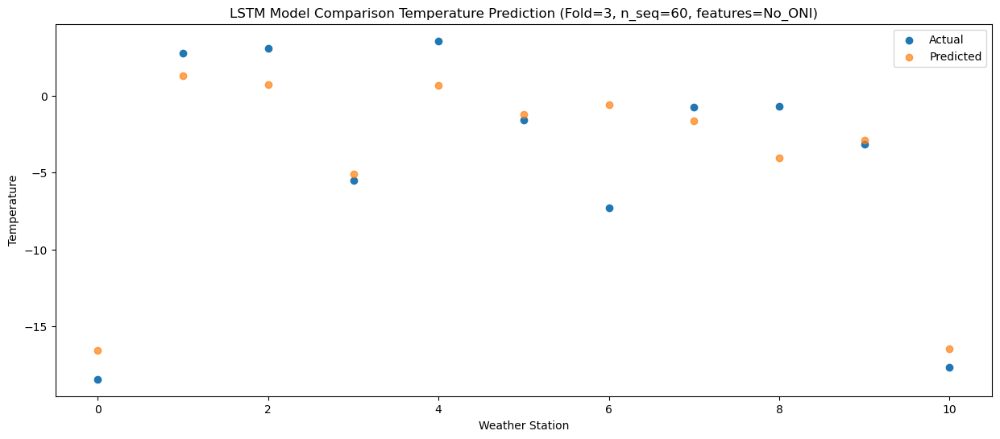

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -21.124608
1                 1   -3.82  -3.252466
2                 2    2.87  -3.821531
3                 3  -10.69  -9.616550
4                 4   -2.92  -3.850874
5                 5   -7.74  -5.739144
6                 6   -9.45  -5.116642
7                 7   -2.46  -6.185084
8                 8   -0.36  -8.579645
9                 9   -7.14  -7.444978
10               10  -20.70 -21.001089


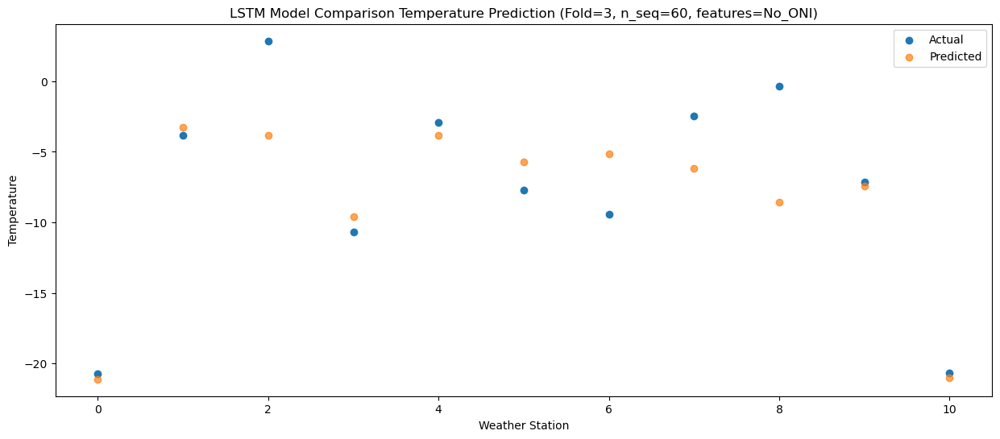

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -15.702666
1                 1    5.83   2.169487
2                 2    4.36   1.592487
3                 3   -5.01  -4.192696
4                 4    4.89   1.574597
5                 5   -1.11  -0.311555
6                 6   -7.29   0.304411
7                 7   -0.10  -0.769163
8                 8   -0.65  -3.161476
9                 9   -6.57  -2.025519
10               10  -18.66 -15.580914


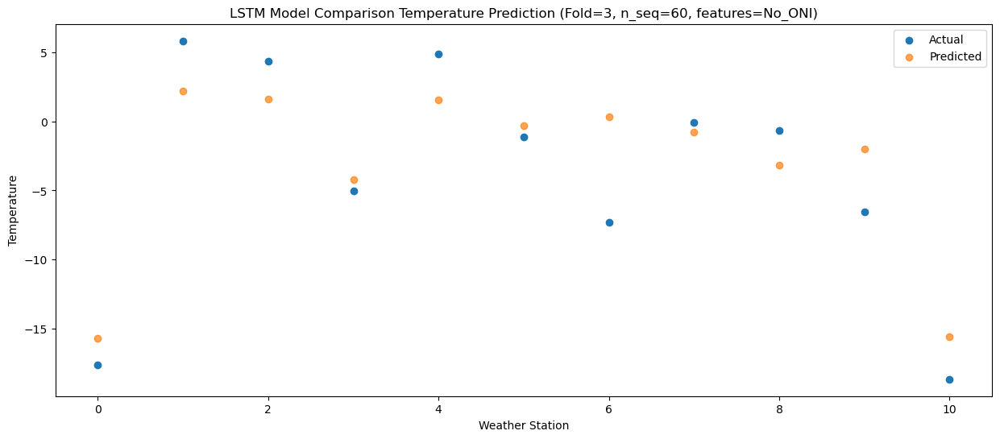

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -12.512819
1                 1    8.31   5.356936
2                 2    6.39   4.775170
3                 3   -1.36  -1.003472
4                 4    9.00   4.768707
5                 5    2.96   2.882325
6                 6   -5.55   3.498722
7                 7    3.26   2.419195
8                 8    0.28   0.023808
9                 9   -1.87   1.169102
10               10  -14.00 -12.385604


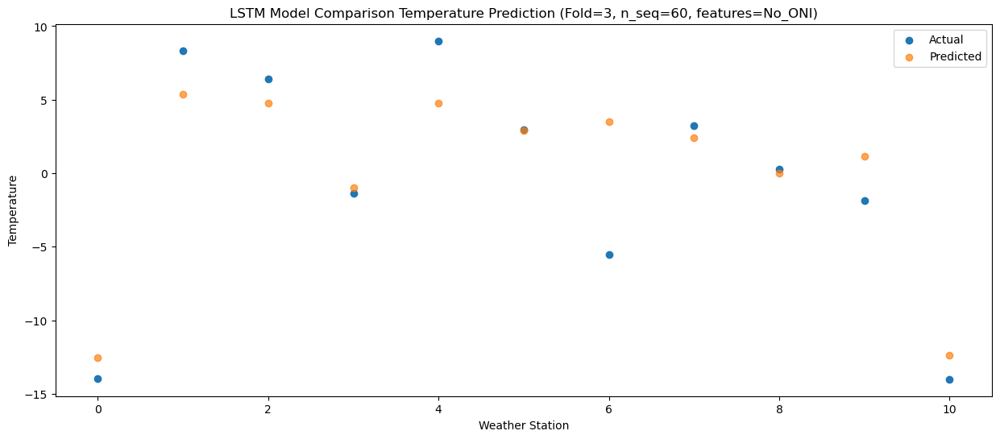

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93  -8.116473
1                 1   12.48   9.760215
2                 2    9.58   9.171409
3                 3    3.70   3.396454
4                 4   13.75   9.172588
5                 5    7.93   7.287191
6                 6   -0.57   7.905443
7                 7    8.76   6.822333
8                 8    2.51   4.413787
9                 9    1.00   5.563774
10               10   -9.42  -7.988766


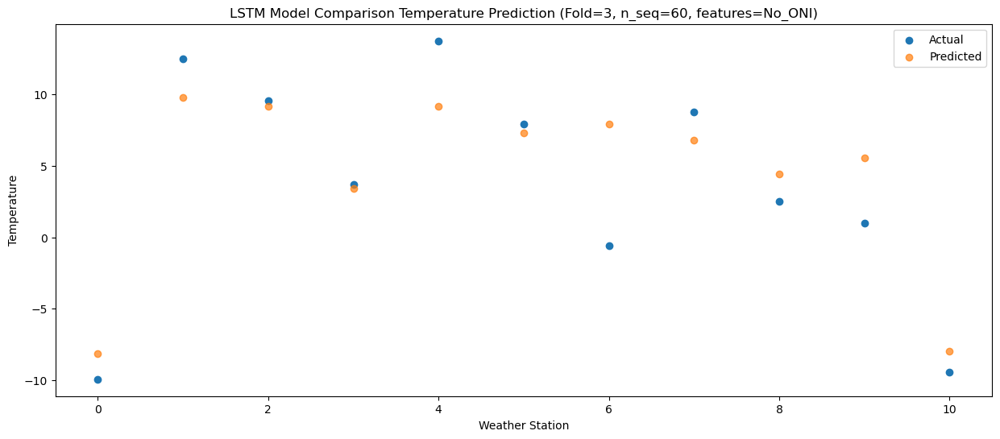

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66  -2.664672
1                 1   17.25  15.204099
2                 2   14.97  14.616242
3                 3    7.89   8.845135
4                 4   19.91  14.613451
5                 5   13.45  12.725839
6                 6    2.54  13.350139
7                 7   14.39  12.269950
8                 8    5.48   9.865556
9                 9    6.55  11.011617
10               10   -3.75  -2.543092


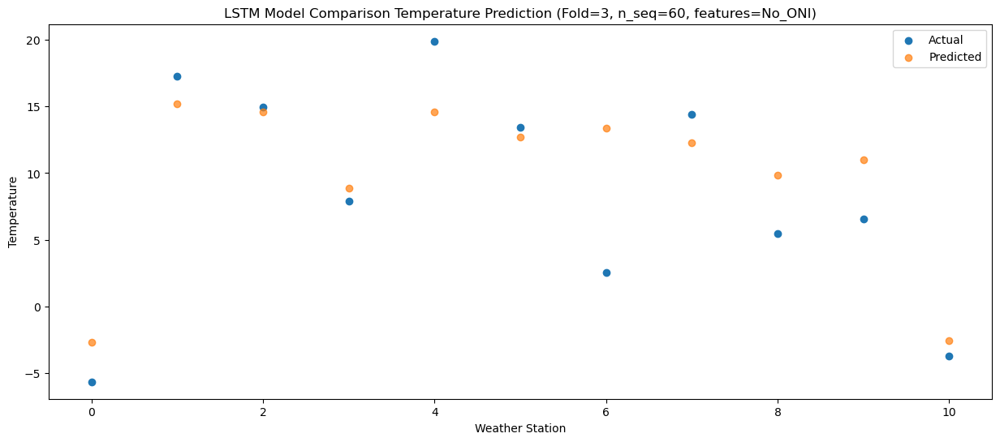

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00   1.262853
1                 1   21.81  19.127368
2                 2   20.92  18.542461
3                 3   11.79  12.771865
4                 4   24.78  18.538658
5                 5   16.68  16.655013
6                 6   11.69  17.279258
7                 7   22.57  16.199951
8                 8    8.39  13.802997
9                 9   13.02  14.953908
10               10    1.62   1.398116


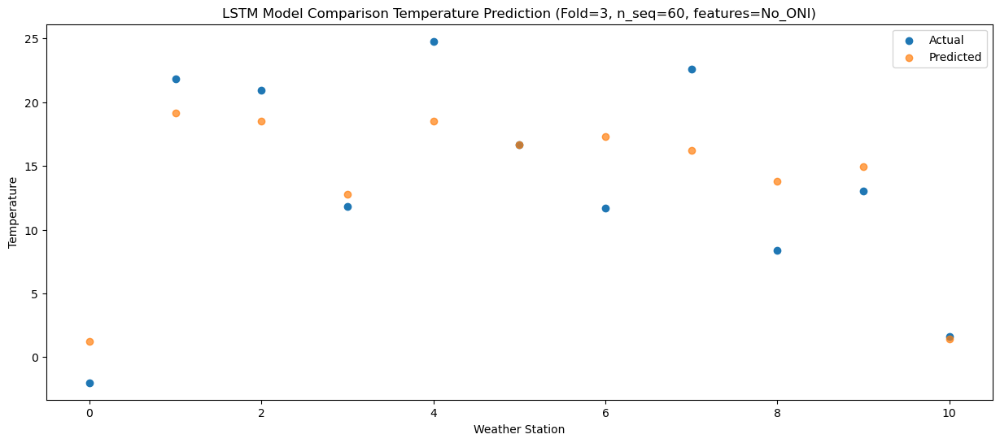

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11   2.187926
1                 1   22.33  20.051247
2                 2   24.49  19.461032
3                 3   13.50  13.693048
4                 4   23.94  19.460826
5                 5   17.23  17.581064
6                 6   12.44  18.208663
7                 7   25.65  17.128978
8                 8    9.65  14.725658
9                 9   15.58  15.880992
10               10    4.28   2.323767


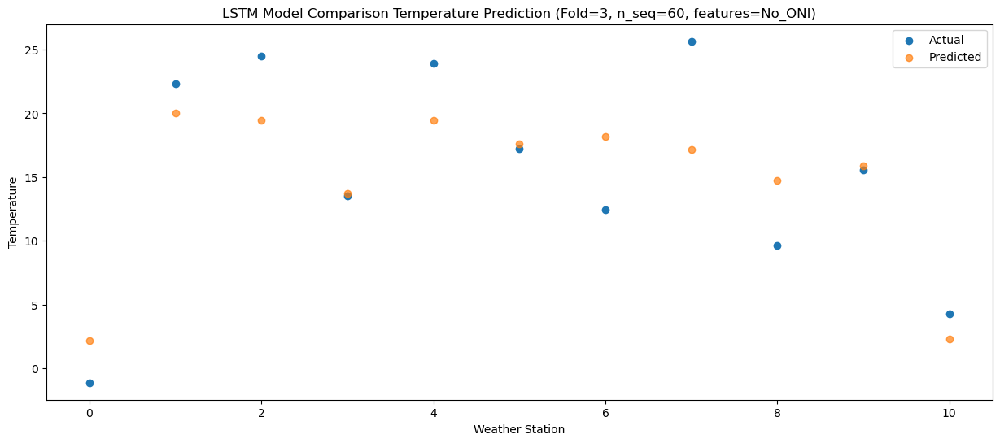

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51   1.618783
1                 1   22.61  19.480053
2                 2   21.52  18.879766
3                 3   12.48  13.120115
4                 4   23.39  18.887056
5                 5   16.68  17.008122
6                 6   12.15  17.634934
7                 7   22.79  16.551163
8                 8    8.37  14.146628
9                 9   13.86  15.307723
10               10    1.14   1.753873


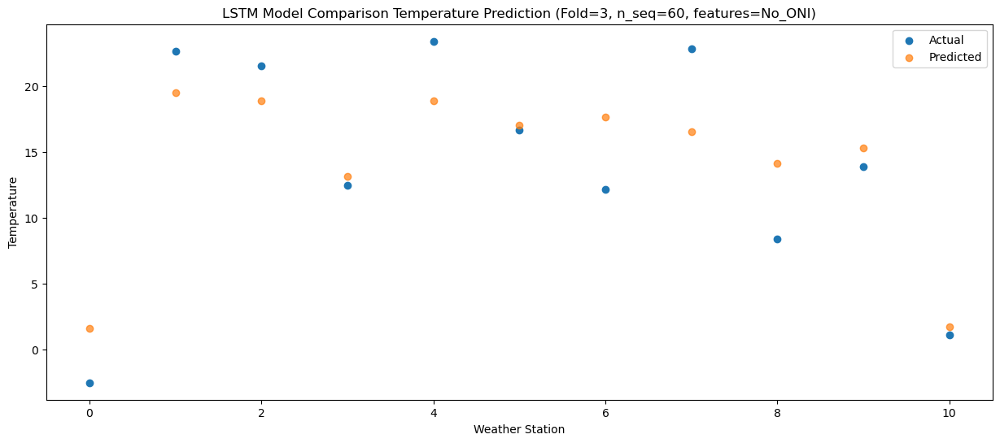

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20  -1.483123
1                 1   18.57  16.375361
2                 2   18.49  15.793666
3                 3    9.51  10.022373
4                 4   20.13  15.787946
5                 5   13.99  13.905655
6                 6    8.53  14.539630
7                 7   18.84  13.468238
8                 8    6.93  11.074159
9                 9    9.85  12.217429
10               10   -2.45  -1.343448


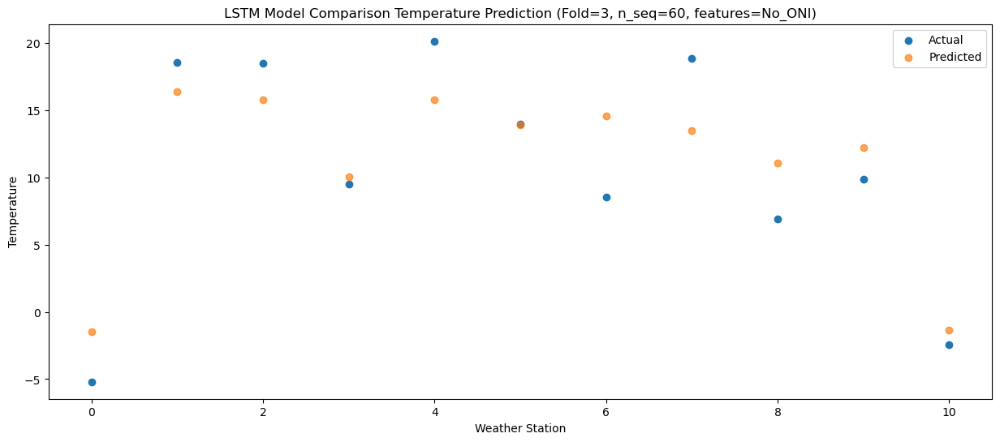

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51  -6.549198
1                 1   15.18  11.313622
2                 2   13.46  10.732504
3                 3    3.01   4.956372
4                 4   14.50  10.723907
5                 5    8.11   8.846407
6                 6    4.30   9.478720
7                 7   12.95   8.407163
8                 8    6.47   6.009036
9                 9    5.32   7.147945
10               10   -7.69  -6.409355


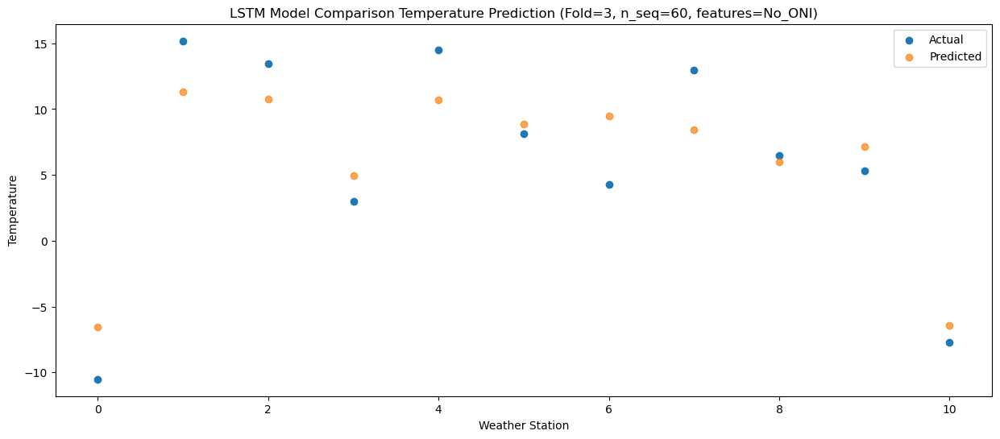

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_16 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_16 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_17 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_17 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_24 (Dense)            (1, 256)                  262400    
                                                                 
 dense_25 (Dense)            (1, 128)                  32896     
                                                                 
 dense_26 (Dense)            (1, 60)                  

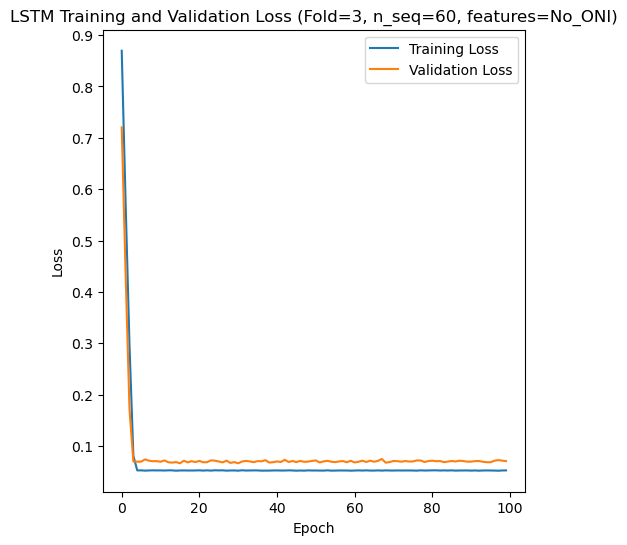

Epoch 1/100
84/84 [==============================] - 8s 53ms/step - loss: 0.7366 - accuracy: 0.0000e+00 - mae: 0.6282 - rmse: 0.7366 - mape: inf - pearson: 0.0045 - val_loss: 0.5828 - val_accuracy: 0.0000e+00 - val_mae: 0.4950 - val_rmse: 0.5828 - val_mape: 100.2014 - val_pearson: 0.0054
Epoch 2/100
84/84 [==============================] - 3s 38ms/step - loss: 0.4263 - accuracy: 0.0000e+00 - mae: 0.3642 - rmse: 0.4263 - mape: inf - pearson: 0.0671 - val_loss: 0.2805 - val_accuracy: 0.0000e+00 - val_mae: 0.2369 - val_rmse: 0.2805 - val_mape: 47.1582 - val_pearson: 0.2150
Epoch 3/100
84/84 [==============================] - 3s 39ms/step - loss: 0.1446 - accuracy: 0.0952 - mae: 0.1208 - rmse: 0.1446 - mape: inf - pearson: 0.5994 - val_loss: 0.0648 - val_accuracy: 0.6000 - val_mae: 0.0517 - val_rmse: 0.0648 - val_mape: 11.7284 - val_pearson: 0.8650
Epoch 4/100
84/84 [==============================] - 3s 41ms/step - loss: 0.0524 - accuracy: 0.5476 - mae: 0.0415 - rmse: 0.0524 - mape: inf - 

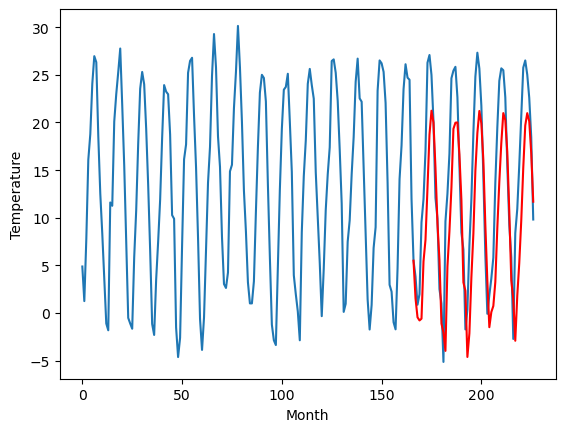

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.37		-0.12		-0.49
0.19		-2.12		-2.31
-1.27		-2.45		-1.18
0.28		-2.27		-2.55
4.35		3.73		-0.62
6.03		5.99		-0.04
7.43		11.43		4.00
9.19		17.03		7.84
9.51		19.53		10.02
9.36		18.29		8.93
8.78		13.55		4.77
7.28		7.69		0.41
3.89		3.86		-0.03
-3.86		-2.82		1.04
-3.16		-3.74		-0.58
0.27		-5.68		-5.95
1.87		3.18		1.31
3.31		6.86		3.55
7.35		11.45		4.10
8.98		17.60		8.62
9.35		18.25		8.90
9.63		18.28		8.65
8.34		14.93		6.59
6.50		10.14		3.64
-0.66		1.50		2.16
1.14		0.61		-0.53
-3.62		-6.32		-2.70
-0.19		-3.87		-3.68
2.63		2.00		-0.63
4.97		6.57		1.60
7.79		13.16		5.37
9.51		17.12		7.61
9.88		19.43		9.55
9.83		18.13		8.30
8.39		14.28		5.89
4.56		7.44		2.88
3.10		1.58		-1.52
-1.75		-3.26		-1.51
-1.90		-1.67		0.23
1.40		-1.03		-2.43
3.12		1.49		-1.63
5.84		7.17		1.33
6.62		11.98		5.36
8.83		16.07		7.24
10.44		19.20		8.76
10.95		18.47		7.52
8.85		15.12		6.27
5.20		8.85		3.65
1.49		1.65		0.16
-0.63		-0.3

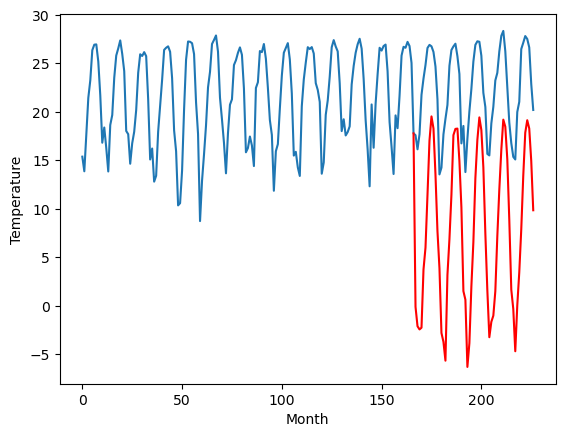

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.37		-3.50		0.87
-4.31		-5.49		-1.18
-4.50		-5.83		-1.33
-4.24		-5.65		-1.41
3.56		0.34		-3.22
2.61		2.60		-0.01
6.49		8.05		1.56
10.58		13.65		3.07
12.15		16.15		4.00
11.32		14.92		3.60
9.22		10.18		0.96
3.88		4.32		0.44
-0.12		0.51		0.63
-6.37		-6.18		0.19
-6.34		-7.10		-0.76
-8.26		-9.04		-0.78
1.07		-0.18		-1.25
2.14		3.51		1.37
6.61		8.09		1.48
10.87		14.25		3.38
11.53		14.89		3.36
12.18		14.93		2.75
9.06		11.58		2.52
5.67		6.78		1.11
-3.00		-1.86		1.14
0.51		-2.75		-3.26
-7.77		-9.69		-1.92
-5.41		-7.24		-1.83
-0.67		-1.37		-0.70
3.54		3.21		-0.33
9.34		9.79		0.45
12.63		13.75		1.12
12.83		16.06		3.23
11.29		14.76		3.47
9.22		10.91		1.69
3.09		4.07		0.98
-1.50		-1.79		-0.29
-3.93		-6.63		-2.70
-3.52		-5.04		-1.52
-1.58		-4.40		-2.82
0.57		-1.87		-2.44
2.32		3.81		1.49
7.18		8.62		1.44
10.77		12.70		1.93
12.55		15.84		3.29
14.63		15.10		0.47
10.88		11.76		0.88
4.77		5.49		0.72
-2.19		-

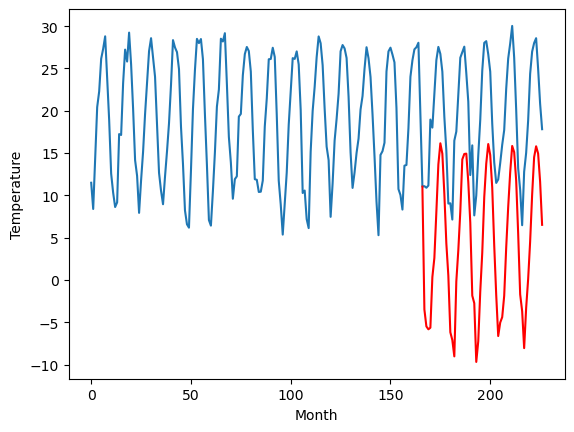

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.64		-4.14		-0.50
-5.29		-6.14		-0.85
-5.05		-6.47		-1.42
-5.38		-6.29		-0.91
2.08		-0.29		-2.37
2.74		1.97		-0.77
7.87		7.43		-0.44
12.83		13.02		0.19
14.69		15.53		0.84
14.44		14.30		-0.14
8.66		9.56		0.90
2.93		3.70		0.77
0.32		-0.11		-0.43
-5.96		-6.80		-0.84
-6.88		-7.72		-0.84
-10.34		-9.65		0.69
0.62		-0.80		-1.42
2.31		2.88		0.57
6.47		7.46		0.99
12.15		13.63		1.48
13.74		14.27		0.53
14.11		14.31		0.20
11.32		10.95		-0.37
6.67		6.15		-0.52
-1.33		-2.49		-1.16
0.67		-3.38		-4.05
-7.80		-10.32		-2.52
-7.54		-7.87		-0.33
-1.36		-2.00		-0.64
4.69		2.58		-2.11
9.40		9.16		-0.24
13.95		13.12		-0.83
17.25		15.44		-1.81
14.52		14.13		-0.39
11.09		10.28		-0.81
4.22		3.45		-0.77
-2.83		-2.41		0.42
-5.52		-7.25		-1.73
-4.53		-5.66		-1.13
-4.47		-5.01		-0.54
0.06		-2.49		-2.55
2.66		3.19		0.53
8.34		7.99		-0.35
12.53		12.08		-0.45
15.08		15.22		0.14
17.63		14.48		-3.15
12.93		11.14		-1.79
4.80	

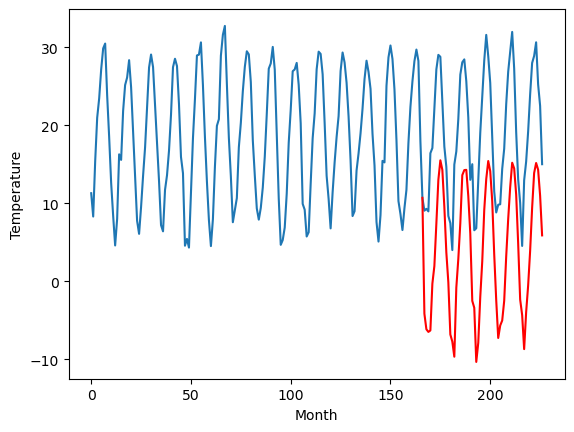

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.77		-2.87		-0.10
-4.55		-4.87		-0.32
-3.93		-5.20		-1.27
-4.31		-5.02		-0.71
3.57		0.98		-2.59
4.26		3.24		-1.02
9.91		8.71		-1.20
14.62		14.30		-0.32
17.06		16.81		-0.25
16.38		15.58		-0.80
10.08		10.85		0.77
4.33		4.99		0.66
1.57		1.16		-0.41
-5.00		-5.52		-0.52
-5.60		-6.44		-0.84
-9.49		-8.37		1.12
1.43		0.48		-0.95
3.61		4.16		0.55
7.14		8.74		1.60
13.99		14.91		0.92
15.48		15.55		0.07
15.85		15.59		-0.26
12.42		12.22		-0.20
7.55		7.42		-0.13
-0.29		-1.22		-0.93
1.45		-2.11		-3.56
-7.45		-9.05		-1.60
-6.83		-6.60		0.23
0.09		-0.73		-0.82
6.78		3.86		-2.92
11.61		10.43		-1.18
16.28		14.40		-1.88
19.70		16.71		-2.99
16.86		15.41		-1.45
12.77		11.56		-1.21
5.62		4.72		-0.90
-1.47		-1.13		0.34
-4.44		-5.97		-1.53
-3.67		-4.38		-0.71
-3.44		-3.73		-0.29
1.41		-1.21		-2.62
4.06		4.46		0.40
10.22		9.26		-0.96
15.33		13.34		-1.99
18.41		16.49		-1.92
20.28		15.75		-4.53
15.19		12.40		-2.79
6.3

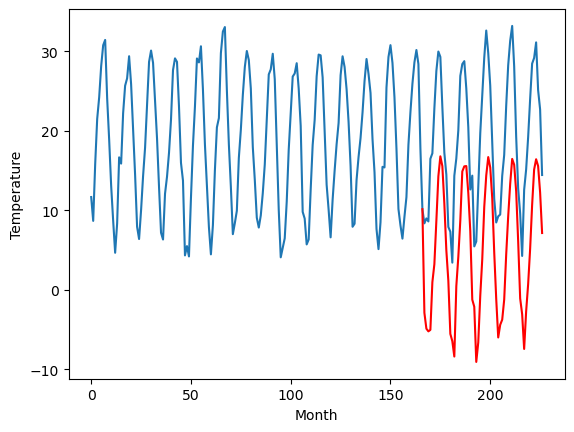

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.81		7.62		-1.19
7.17		5.62		-1.55
6.44		5.29		-1.15
5.68		5.48		-0.20
13.24		11.48		-1.76
16.21		13.74		-2.47
22.78		19.20		-3.58
26.11		24.79		-1.32
28.94		27.31		-1.63
28.32		26.07		-2.25
20.59		21.34		0.75
16.63		15.48		-1.15
12.75		11.66		-1.09
5.77		4.97		-0.80
4.67		4.04		-0.63
3.10		2.12		-0.98
12.35		10.96		-1.39
14.58		14.64		0.06
20.07		19.22		-0.85
25.03		25.39		0.36
24.77		26.03		1.26
25.09		26.07		0.98
24.40		22.71		-1.69
18.70		17.91		-0.79
11.76		9.27		-2.49
12.17		8.39		-3.78
4.80		1.46		-3.34
4.60		3.90		-0.70
11.92		9.77		-2.15
19.43		14.36		-5.07
25.12		20.93		-4.19
27.49		24.91		-2.58
29.39		27.21		-2.18
26.09		25.91		-0.18
23.19		22.06		-1.13
16.38		15.22		-1.16
8.53		9.37		0.84
6.93		4.53		-2.40
7.30		6.13		-1.17
7.47		6.77		-0.70
12.54		9.30		-3.24
16.76		14.96		-1.80
21.68		19.76		-1.92
28.16		23.85		-4.31
29.62		26.99		-2.63
29.71		26.25		-3.46
26.23		22.90		-3.33
1

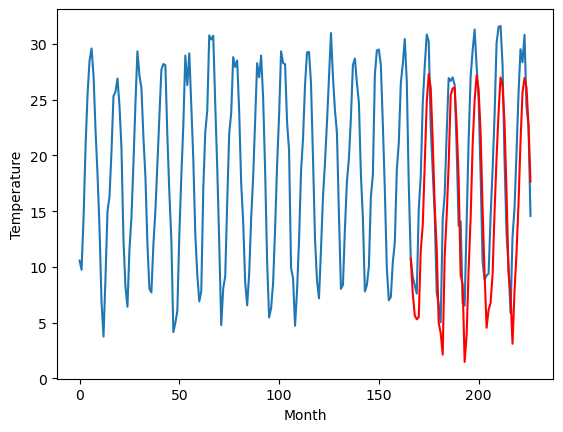

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.79		3.73		1.94
1.44		1.74		0.30
1.27		1.40		0.13
1.74		1.57		-0.17
7.35		7.57		0.22
8.62		9.83		1.21
11.41		15.29		3.88
16.00		20.89		4.89
19.04		23.39		4.35
17.84		22.16		4.32
14.04		17.44		3.40
10.22		11.57		1.35
5.91		7.76		1.85
-1.34		1.08		2.42
-1.11		0.16		1.27
-0.44		-1.77		-1.33
5.96		7.08		1.12
8.69		10.77		2.08
12.14		15.36		3.22
16.16		21.53		5.37
17.90		22.17		4.27
18.03		22.22		4.19
14.06		18.85		4.79
10.26		14.05		3.79
2.10		5.42		3.32
4.01		4.54		0.53
-2.05		-2.39		-0.34
2.23		0.05		-2.18
5.79		5.92		0.13
8.45		10.50		2.05
14.43		17.08		2.65
17.64		21.05		3.41
18.91		23.36		4.45
17.39		22.05		4.66
14.30		18.19		3.89
7.43		11.35		3.92
4.73		5.50		0.77
-1.22		0.65		1.87
1.80		2.25		0.45
5.22		2.89		-2.33
5.70		5.41		-0.29
8.81		11.08		2.27
11.43		15.89		4.46
15.07		19.97		4.90
18.94		23.11		4.17
18.38		22.37		3.99
14.54		19.03		4.49
9.10		12.75		3.65
3.37		5.56		2.19
1.16		3.57

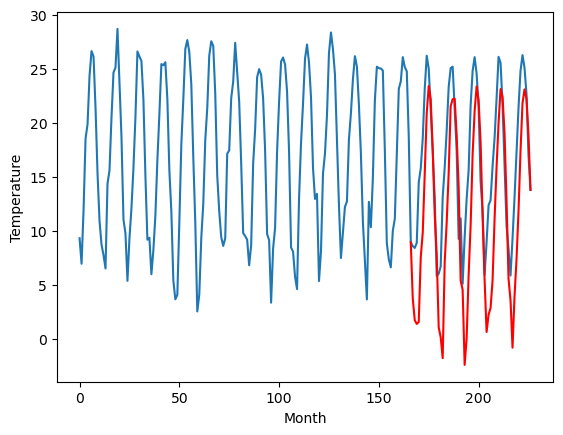

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.00		3.55		-0.45
3.19		1.56		-1.63
1.54		1.21		-0.33
2.11		1.40		-0.71
9.04		7.40		-1.64
10.62		9.66		-0.96
14.72		15.12		0.40
21.07		20.71		-0.36
23.61		23.22		-0.39
21.62		21.99		0.37
18.04		17.26		-0.78
11.11		11.40		0.29
8.56		7.59		-0.97
2.03		0.90		-1.13
0.36		-0.02		-0.38
-3.25		-1.95		1.30
9.02		6.89		-2.13
10.92		10.58		-0.34
14.96		15.17		0.21
21.26		21.34		0.08
22.55		21.98		-0.57
23.07		22.03		-1.04
20.03		18.67		-1.36
14.26		13.86		-0.40
6.32		5.22		-1.10
7.78		4.34		-3.44
-1.29		-2.59		-1.30
0.77		-0.14		-0.91
7.43		5.74		-1.69
11.29		10.32		-0.97
16.96		16.90		-0.06
22.28		20.87		-1.41
25.98		23.18		-2.80
22.46		21.87		-0.59
18.87		18.01		-0.86
12.50		11.17		-1.33
5.95		5.32		-0.63
1.10		0.47		-0.63
2.75		2.07		-0.68
4.89		2.71		-2.18
6.61		5.24		-1.37
12.23		10.92		-1.31
17.01		15.72		-1.29
21.09		19.80		-1.29
23.05		22.93		-0.12
22.86		22.19		-0.67
18.92		18.85		-0.07
13.02	

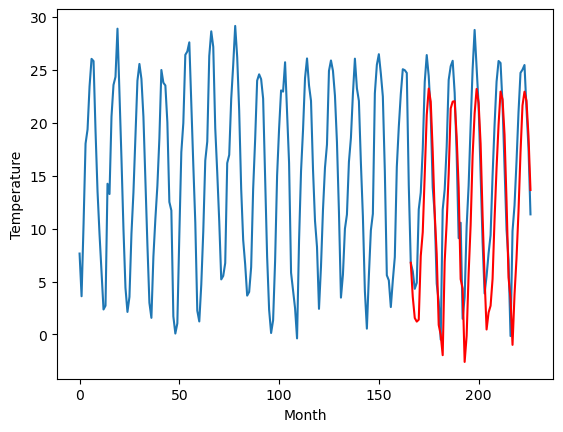

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.41		3.93		2.52
0.59		1.94		1.35
-0.34		1.60		1.94
-1.17		1.78		2.95
5.65		7.78		2.13
8.64		10.04		1.40
14.22		15.50		1.28
21.51		21.08		-0.43
23.55		23.59		0.04
21.35		22.36		1.01
17.59		17.63		0.04
10.75		11.77		1.02
6.91		7.96		1.05
-0.60		1.27		1.87
-2.18		0.35		2.53
-5.54		-1.59		3.95
6.43		7.26		0.83
10.08		10.95		0.87
14.49		15.54		1.05
21.73		21.70		-0.03
22.30		22.34		0.04
23.16		22.39		-0.77
19.67		19.03		-0.64
14.32		14.24		-0.08
3.46		5.60		2.14
3.78		4.72		0.94
-5.06		-2.22		2.84
-2.04		0.24		2.28
5.43		6.12		0.69
9.21		10.70		1.49
17.71		17.29		-0.42
22.19		21.25		-0.94
24.13		23.57		-0.56
21.90		22.26		0.36
17.99		18.40		0.41
10.50		11.56		1.06
4.71		5.70		0.99
-1.07		0.85		1.92
0.89		2.45		1.56
2.48		3.09		0.61
3.75		5.62		1.87
10.25		11.30		1.05
15.96		16.10		0.14
19.84		20.19		0.35
22.57		23.33		0.76
21.41		22.59		1.18
18.32		19.25		0.93
12.18		12.98		0.80
5.11		5.78		0.67


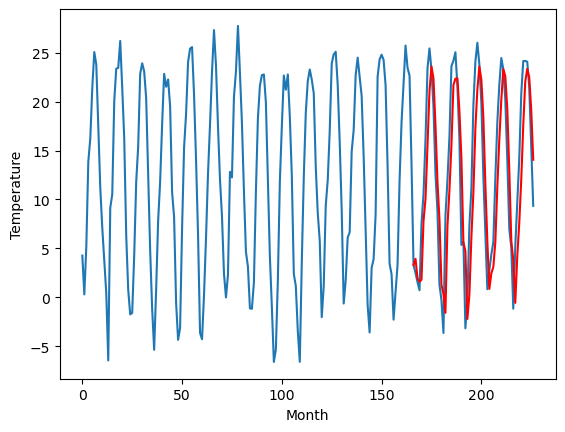

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.42		2.80		1.38
1.10		0.81		-0.29
-1.34		0.47		1.81
-1.59		0.66		2.25
6.01		6.66		0.65
9.12		8.92		-0.20
15.00		14.38		-0.62
22.73		19.96		-2.77
23.94		22.47		-1.47
21.34		21.25		-0.09
17.44		16.51		-0.93
10.10		10.65		0.55
7.46		6.85		-0.61
-0.42		0.16		0.58
-2.45		-0.77		1.68
-6.89		-2.71		4.18
6.97		6.14		-0.83
10.68		9.84		-0.84
15.46		14.43		-1.03
22.85		20.59		-2.26
22.56		21.24		-1.32
22.84		21.29		-1.55
19.73		17.93		-1.80
14.27		13.13		-1.14
3.96		4.50		0.54
3.71		3.62		-0.09
-5.77		-3.32		2.45
-2.94		-0.85		2.09
5.27		5.02		-0.25
9.39		9.60		0.21
17.92		16.19		-1.73
22.53		20.15		-2.38
23.35		22.47		-0.88
22.05		21.15		-0.90
17.91		17.30		-0.61
10.44		10.46		0.02
4.90		4.59		-0.31
-1.83		-0.26		1.57
0.41		1.34		0.93
1.60		1.98		0.38
4.14		4.50		0.36
11.47		10.18		-1.29
17.23		14.99		-2.24
21.54		19.07		-2.47
23.07		22.21		-0.86
21.81		21.48		-0.33
18.77		18.14		-0.63
12.36		11.87	

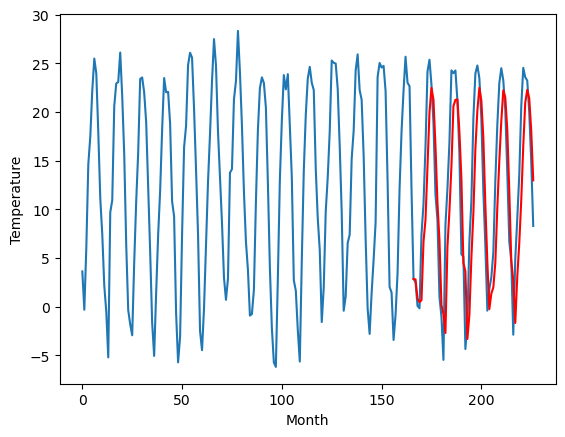

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.09		1.56		2.65
-1.87		-0.43		1.44
-3.07		-0.77		2.30
-3.88		-0.58		3.30
2.28		5.42		3.14
3.66		7.67		4.01
10.40		13.12		2.72
16.89		18.71		1.82
20.33		21.21		0.88
17.92		19.98		2.06
13.93		15.24		1.31
7.77		9.38		1.61
4.54		5.57		1.03
-3.02		-1.11		1.91
-4.94		-2.04		2.90
-7.18		-3.98		3.20
2.71		4.86		2.15
6.51		8.56		2.05
11.04		13.15		2.11
17.93		19.31		1.38
18.09		19.94		1.85
19.29		19.99		0.70
15.00		16.63		1.63
11.47		11.83		0.36
1.07		3.21		2.14
0.21		2.33		2.12
-8.62		-4.62		4.00
-5.06		-2.15		2.91
0.91		3.72		2.81
4.91		8.30		3.39
13.49		14.89		1.40
16.76		18.85		2.09
19.36		21.18		1.82
18.29		19.86		1.57
14.24		16.01		1.77
7.38		9.17		1.79
3.30		3.30		-0.00
-3.41		-1.55		1.86
-1.78		0.05		1.83
-1.64		0.70		2.34
-0.76		3.22		3.98
7.71		8.90		1.19
11.40		13.71		2.31
15.71		17.79		2.08
18.80		20.93		2.13
17.47		20.19		2.72
15.13		16.85		1.72
9.87		10.58		0.71
2.48		3.39		0.91
1.82	

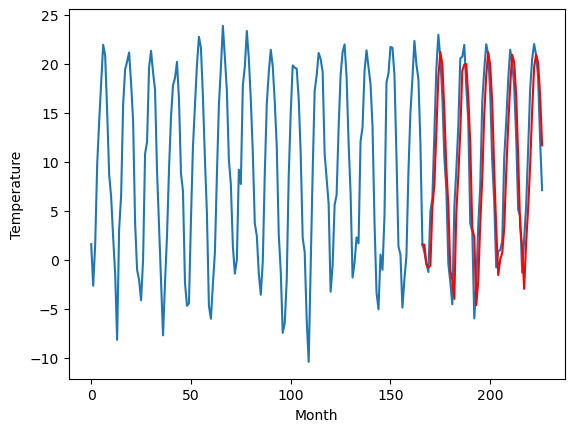

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[1.5513027381896975, -0.12301670074462923, -3.497290840148926, -4.140666847229004, -2.872769222259522, 7.618567829132081, 3.732677688598633, 3.5507083511352544, 3.9320749664306636, 2.8024674034118657, 1.5586012077331546]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84   1.551303
1                 1    0.37  -0.123017
2                 2   -4.37  -3.497291
3                 3   -3.64  -4.140667
4                 4   -2.77  -2.872769
5                 5    8.81   7.618568
6                 6    1.79   3.732678
7                 7    4.00   3.550708
8                 8    1.41   3.932075
9                 9    1.42   2.802467
10               10   -1.09   1.558601


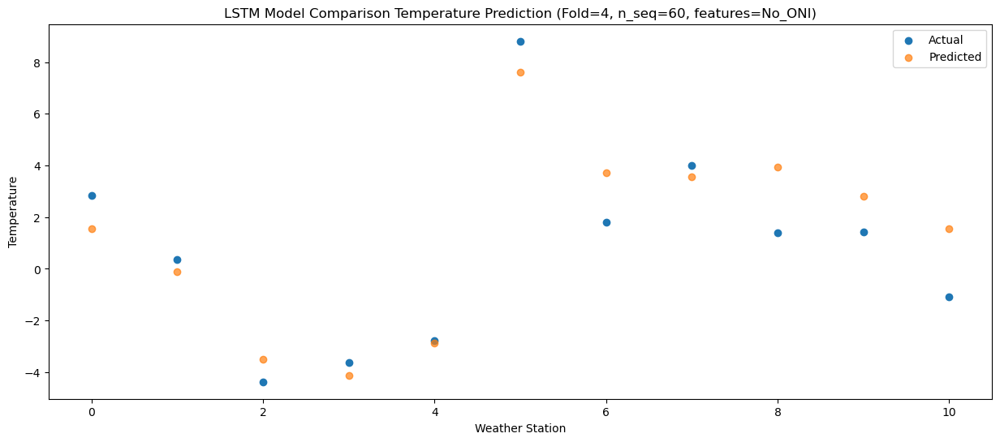

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.440315
1                 1    0.19  -2.124463
2                 2   -4.31  -5.494037
3                 3   -5.29  -6.136673
4                 4   -4.55  -4.866612
5                 5    7.17   5.622233
6                 6    1.44   1.738259
7                 7    3.19   1.559574
8                 8    0.59   1.939762
9                 9    1.10   0.812550
10               10   -1.87  -0.433603


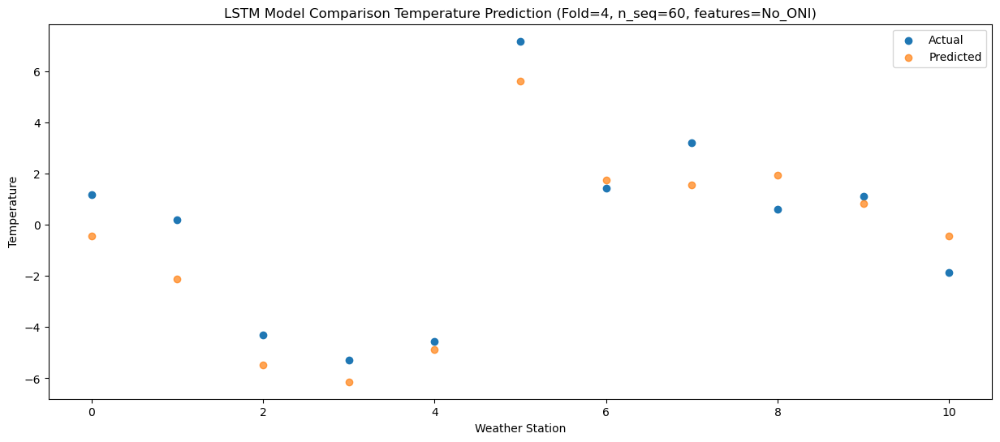

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -0.769441
1                 1   -1.27  -2.453804
2                 2   -4.50  -5.834417
3                 3   -5.05  -6.474004
4                 4   -3.93  -5.203610
5                 5    6.44   5.290476
6                 6    1.27   1.395164
7                 7    1.54   1.213405
8                 8   -0.34   1.595247
9                 9   -1.34   0.472104
10               10   -3.07  -0.769360


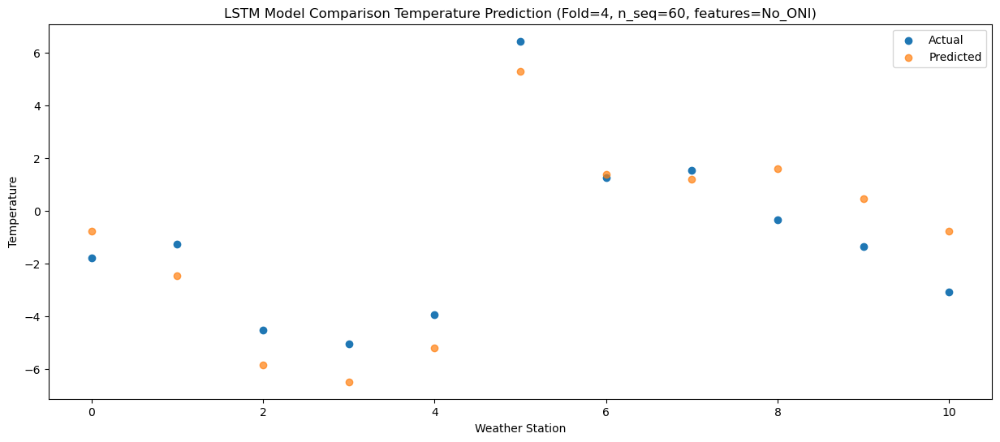

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -0.584840
1                 1    0.28  -2.274911
2                 2   -4.24  -5.650142
3                 3   -5.38  -6.288116
4                 4   -4.31  -5.017756
5                 5    5.68   5.480788
6                 6    1.74   1.574577
7                 7    2.11   1.397994
8                 8   -1.17   1.783282
9                 9   -1.59   0.662183
10               10   -3.88  -0.578626


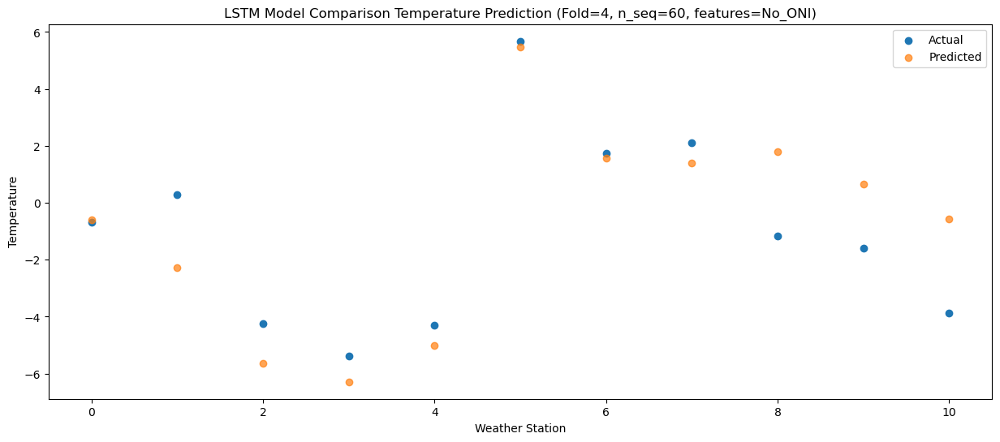

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   5.416216
1                 1    4.35   3.727538
2                 2    3.56   0.344252
3                 3    2.08  -0.289199
4                 4    3.57   0.984283
5                 5   13.24  11.479572
6                 6    7.35   7.568383
7                 7    9.04   7.399364
8                 8    5.65   7.782473
9                 9    6.01   6.661442
10               10    2.28   5.419575


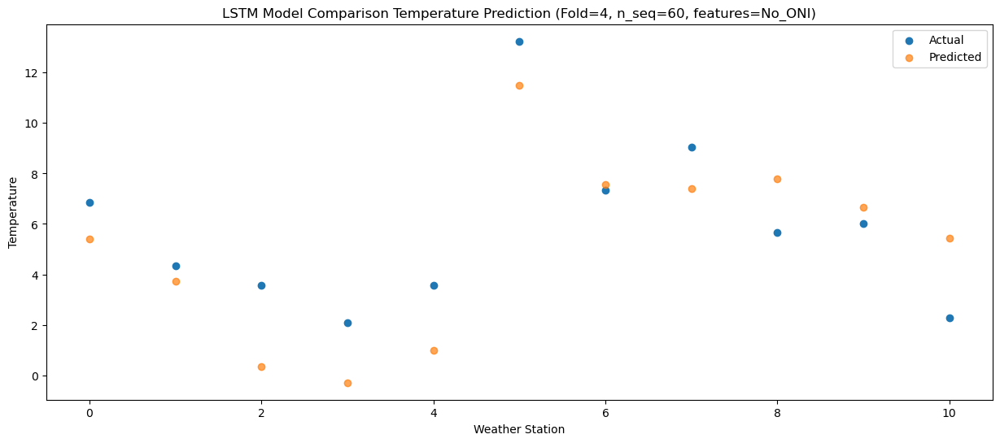

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   7.681211
1                 1    6.03   5.986795
2                 2    2.61   2.598901
3                 3    2.74   1.966596
4                 4    4.26   3.240537
5                 5   16.21  13.735738
6                 6    8.62   9.830311
7                 7   10.62   9.655717
8                 8    8.64  10.036208
9                 9    9.12   8.915706
10               10    3.66   7.665115


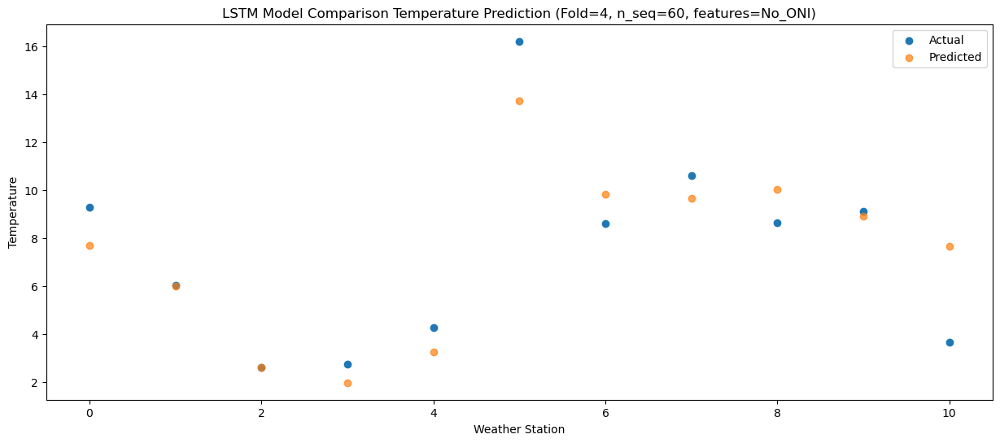

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36  13.139172
1                 1    7.43  11.429604
2                 2    6.49   8.051491
3                 3    7.87   7.428408
4                 4    9.91   8.707394
5                 5   22.78  19.197377
6                 6   11.41  15.289959
7                 7   14.72  15.119274
8                 8   14.22  15.496760
9                 9   15.00  14.379639
10               10   10.40  13.124889


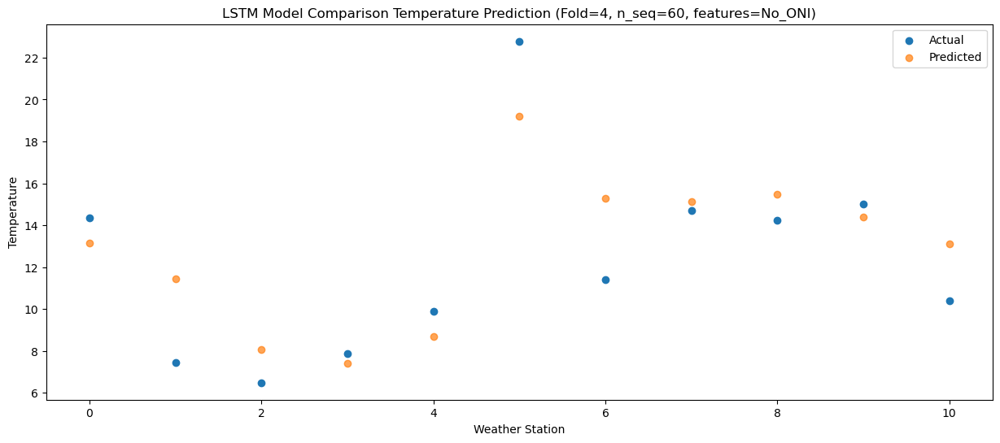

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  18.730280
1                 1    9.19  17.031438
2                 2   10.58  13.649850
3                 3   12.83  13.021598
4                 4   14.62  14.300329
5                 5   26.11  24.791814
6                 6   16.00  20.885137
7                 7   21.07  20.706933
8                 8   21.51  21.083840
9                 9   22.73  19.963717
10               10   16.89  18.711305


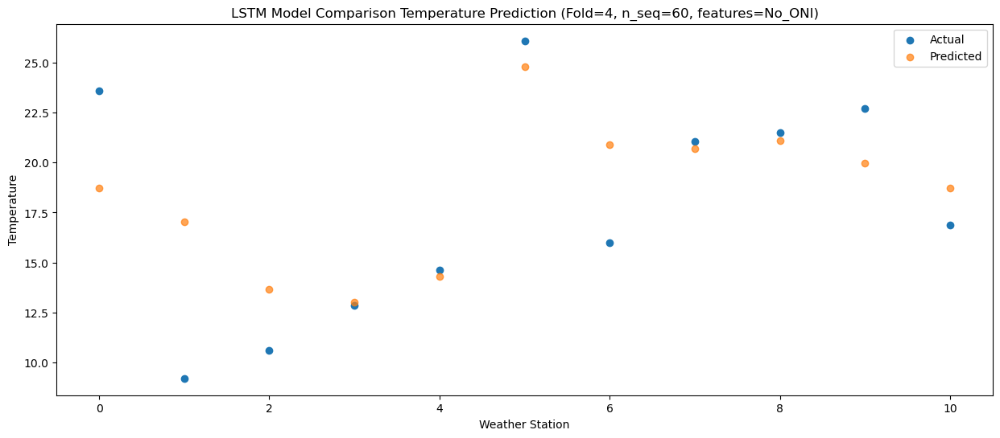

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  21.236681
1                 1    9.51  19.534446
2                 2   12.15  16.154261
3                 3   14.69  15.528384
4                 4   17.06  16.808412
5                 5   28.94  27.306646
6                 6   19.04  23.393908
7                 7   23.61  23.216206
8                 8   23.55  23.588760
9                 9   23.94  22.468324
10               10   20.33  21.208032


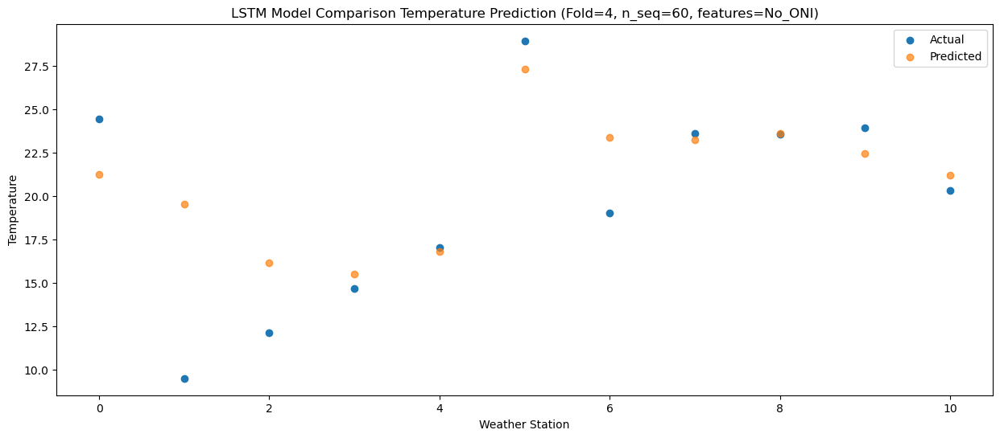

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  20.003396
1                 1    9.36  18.288497
2                 2   11.32  14.919897
3                 3   14.44  14.298914
4                 4   16.38  15.581058
5                 5   28.32  26.071833
6                 6   17.84  22.163308
7                 7   21.62  21.989676
8                 8   21.35  22.363118
9                 9   21.34  21.245644
10               10   17.92  19.979923


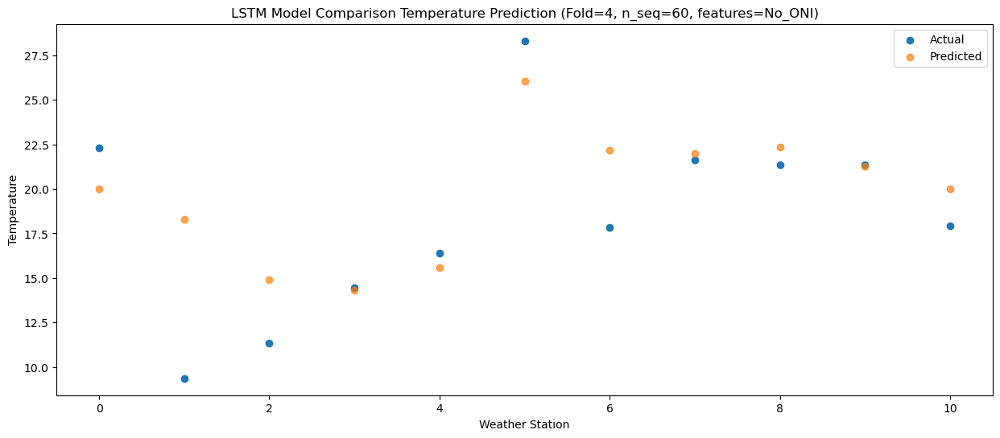

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  15.258839
1                 1    8.78  13.546247
2                 2    9.22  10.179216
3                 3    8.66   9.563552
4                 4   10.08  10.849817
5                 5   20.59  21.340299
6                 6   14.04  17.435113
7                 7   18.04  17.259902
8                 8   17.59  17.629981
9                 9   17.44  16.510119
10               10   13.93  15.241977


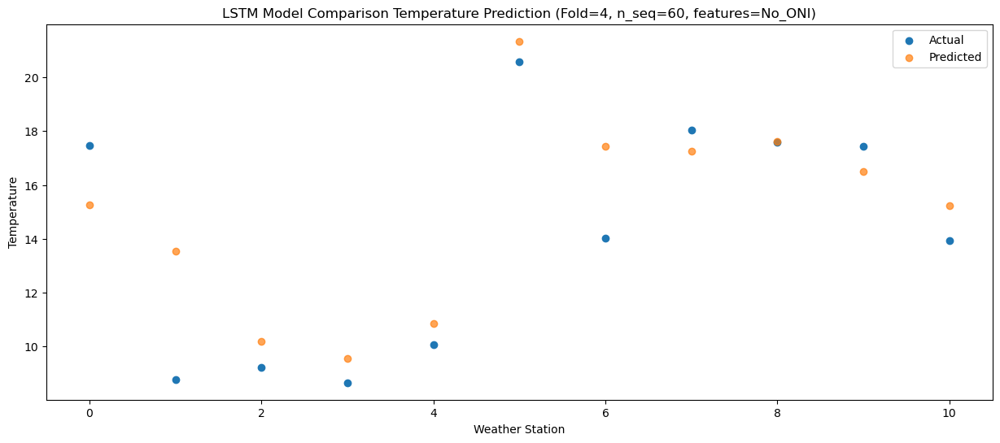

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   9.401595
1                 1    7.28   7.687328
2                 2    3.88   4.322915
3                 3    2.93   3.704844
4                 4    4.33   4.988162
5                 5   16.63  15.477620
6                 6   10.22  11.573938
7                 7   11.11  11.400659
8                 8   10.75  11.768188
9                 9   10.10  10.651011
10               10    7.77   9.383488


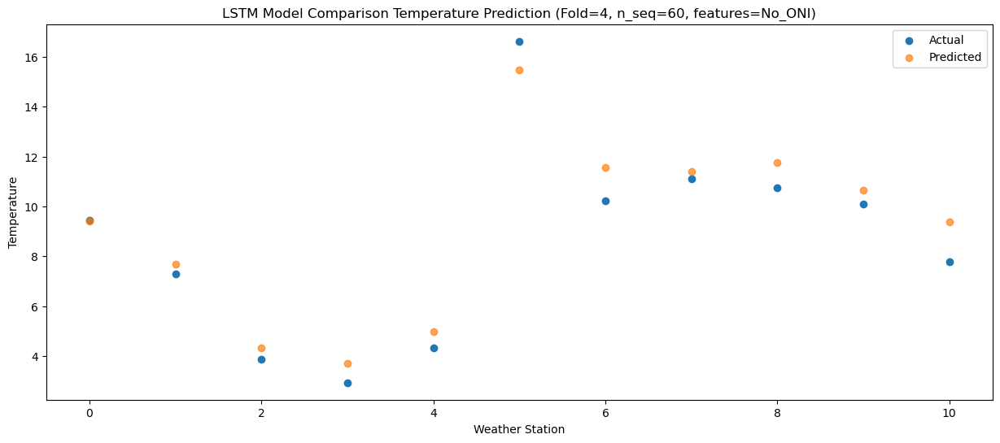

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   5.585473
1                 1    3.89   3.863279
2                 2   -0.12   0.507333
3                 3    0.32  -0.114200
4                 4    1.57   1.164968
5                 5   12.75  11.655351
6                 6    5.91   7.763558
7                 7    8.56   7.589690
8                 8    6.91   7.957837
9                 9    7.46   6.845727
10               10    4.54   5.574583


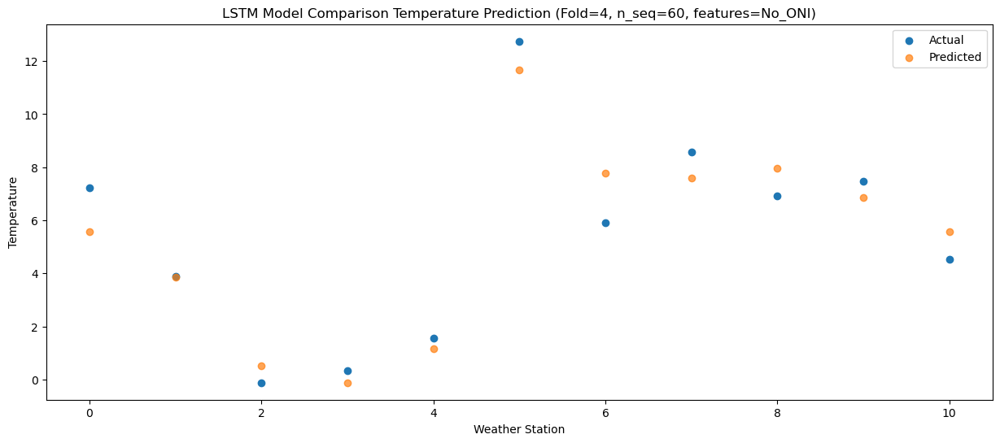

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -1.098184
1                 1   -3.86  -2.820946
2                 2   -6.37  -6.182998
3                 3   -5.96  -6.801288
4                 4   -5.00  -5.522046
5                 5    5.77   4.966993
6                 6   -1.34   1.082976
7                 7    2.03   0.903394
8                 8   -0.60   1.273010
9                 9   -0.42   0.163850
10               10   -3.02  -1.112625


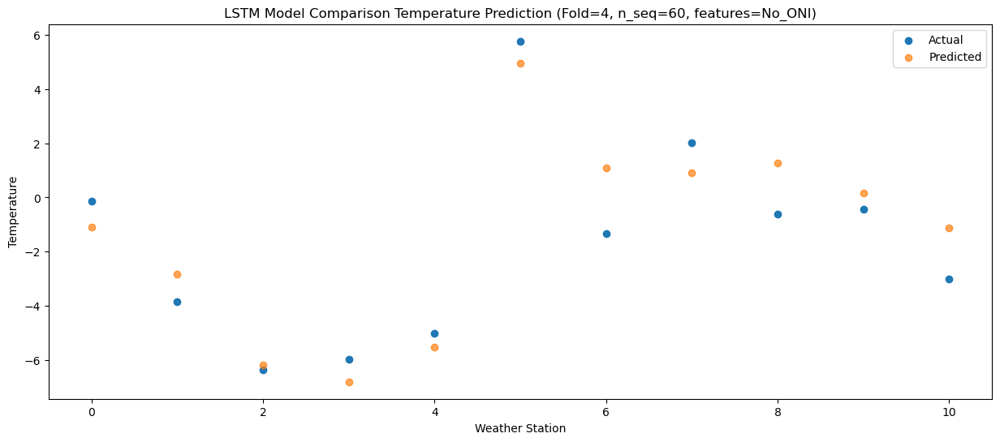

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -2.018465
1                 1   -3.16  -3.739627
2                 2   -6.34  -7.102548
3                 3   -6.88  -7.719563
4                 4   -5.60  -6.440813
5                 5    4.67   4.042609
6                 6   -1.11   0.164647
7                 7    0.36  -0.020518
8                 8   -2.18   0.346237
9                 9   -2.45  -0.765214
10               10   -4.94  -2.036625


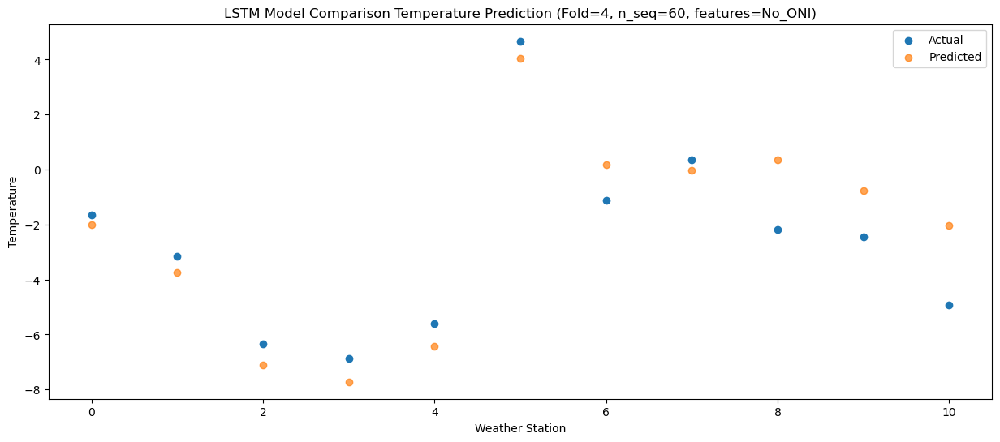

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78  -3.961708
1                 1    0.27  -5.679263
2                 2   -8.26  -9.036484
3                 3  -10.34  -9.652515
4                 4   -9.49  -8.370219
5                 5    3.10   2.117093
6                 6   -0.44  -1.766132
7                 7   -3.25  -1.954392
8                 8   -5.54  -1.593115
9                 9   -6.89  -2.708015
10               10   -7.18  -3.981482


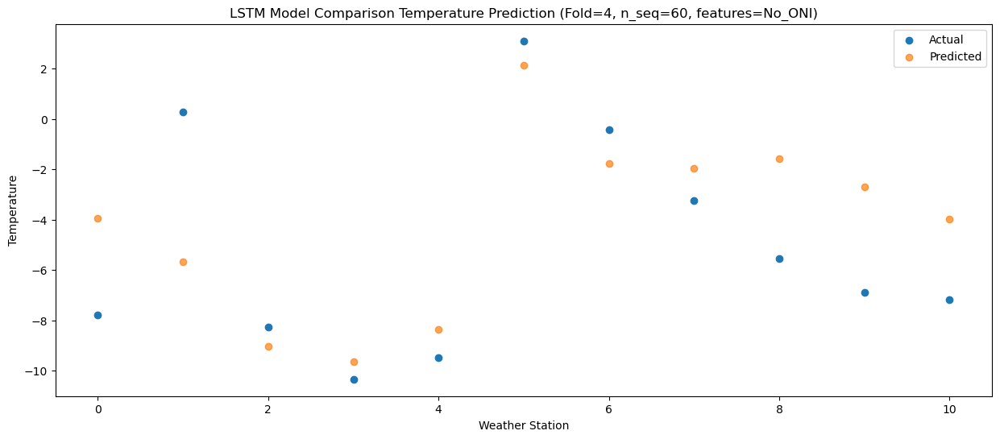

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   4.893354
1                 1    1.87   3.175069
2                 2    1.07  -0.177525
3                 3    0.62  -0.800491
4                 4    1.43   0.479105
5                 5   12.35  10.960533
6                 6    5.96   7.080044
7                 7    9.02   6.894104
8                 8    6.43   7.256726
9                 9    6.97   6.144237
10               10    2.71   4.863577


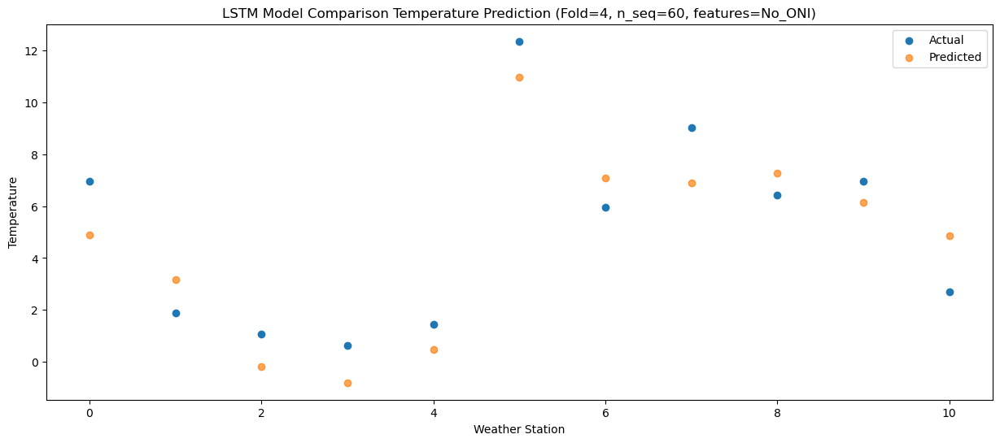

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   8.580668
1                 1    3.31   6.863958
2                 2    2.14   3.509226
3                 3    2.31   2.882024
4                 4    3.61   4.162493
5                 5   14.58  14.638733
6                 6    8.69  10.770611
7                 7   10.92  10.581358
8                 8   10.08  10.949768
9                 9   10.68   9.841857
10               10    6.51   8.561122


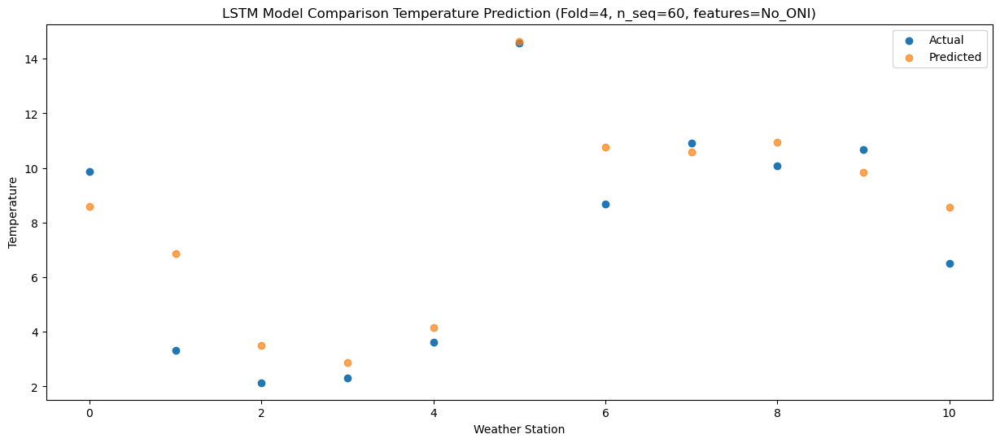

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07  13.170966
1                 1    7.35  11.448685
2                 2    6.61   8.093027
3                 3    6.47   7.462052
4                 4    7.14   8.742458
5                 5   20.07  19.219100
6                 6   12.14  15.363676
7                 7   14.96  15.169568
8                 8   14.49  15.537699
9                 9   15.46  14.431837
10               10   11.04  13.149399


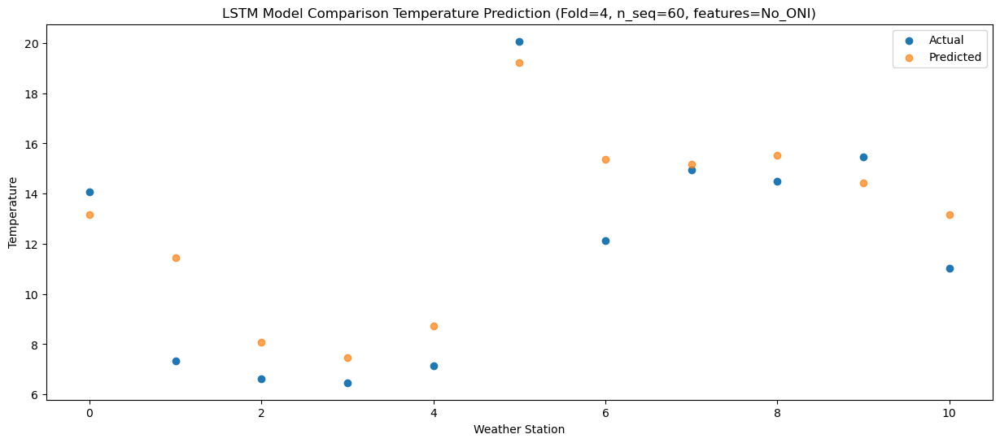

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  19.332769
1                 1    8.98  17.604400
2                 2   10.87  14.248017
3                 3   12.15  13.628375
4                 4   13.99  14.909939
5                 5   25.03  25.388355
6                 6   16.16  21.528826
7                 7   21.26  21.337058
8                 8   21.73  21.699553
9                 9   22.85  20.592756
10               10   17.93  19.308116


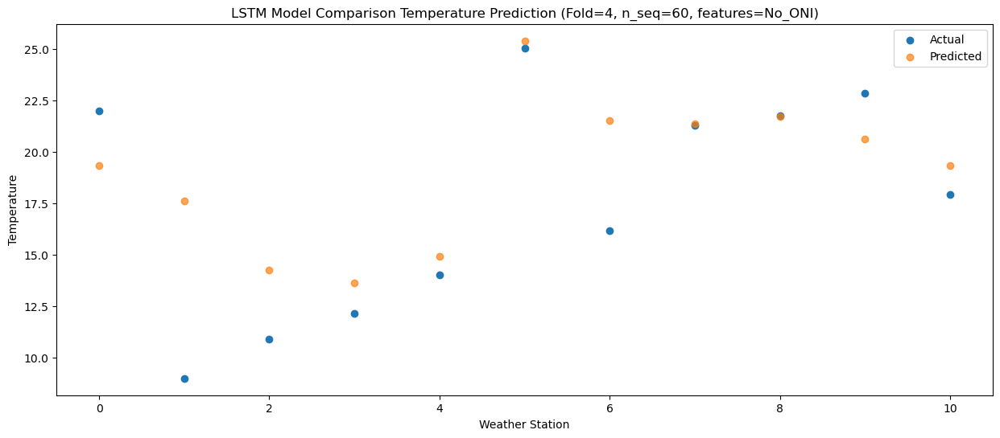

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  19.975790
1                 1    9.35  18.246227
2                 2   11.53  14.892488
3                 3   13.74  14.270261
4                 4   15.48  15.549706
5                 5   24.77  26.027086
6                 6   17.90  22.173417
7                 7   22.55  21.979603
8                 8   22.30  22.340332
9                 9   22.56  21.237746
10               10   18.09  19.944378


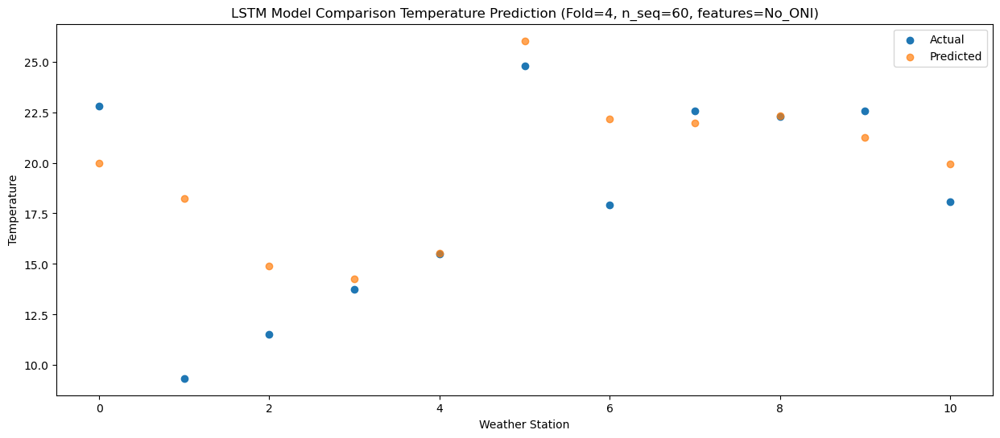

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  20.007125
1                 1    9.63  18.279616
2                 2   12.18  14.932064
3                 3   14.11  14.308659
4                 4   15.85  15.586269
5                 5   25.09  26.072251
6                 6   18.03  22.219115
7                 7   23.07  22.027667
8                 8   23.16  22.390059
9                 9   22.84  21.285776
10               10   19.29  19.985370


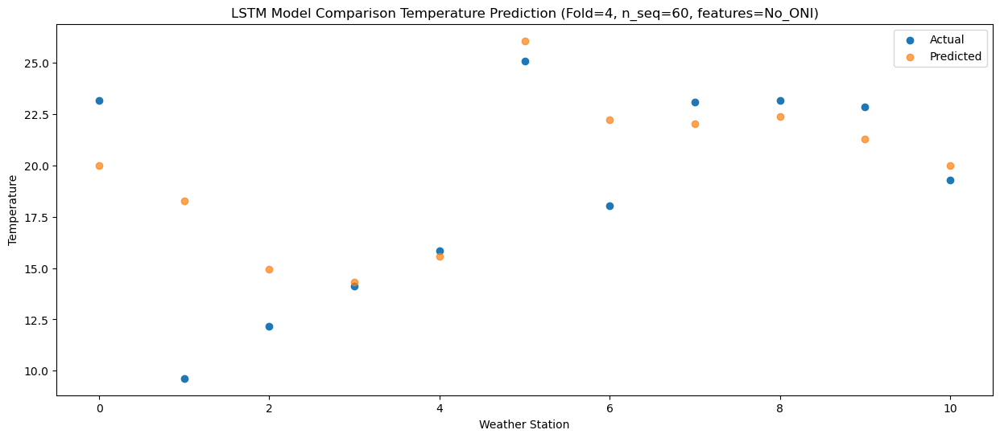

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  16.651194
1                 1    8.34  14.925532
2                 2    9.06  11.576545
3                 3   11.32  10.947088
4                 4   12.42  12.222049
5                 5   24.40  22.708000
6                 6   14.06  18.849126
7                 7   20.03  18.665051
8                 8   19.67  19.031564
9                 9   19.73  17.930731
10               10   15.00  16.629267


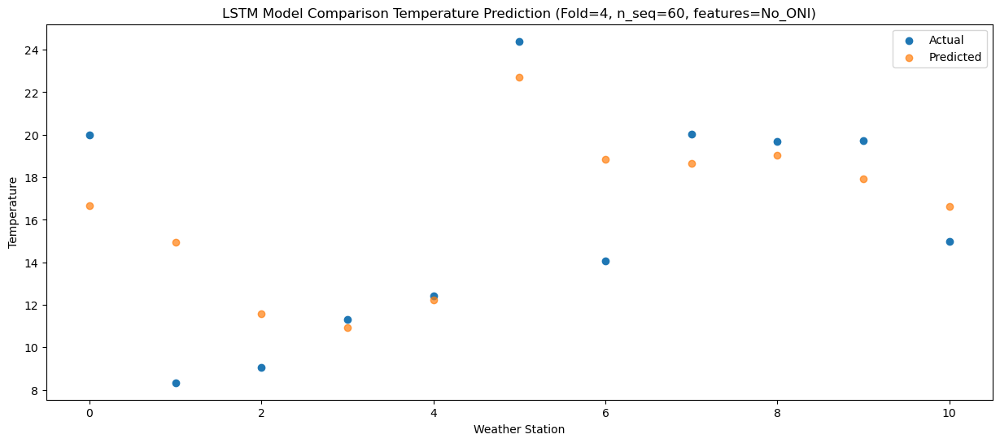

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86  11.858229
1                 1    6.50  10.135380
2                 2    5.67   6.778649
3                 3    6.67   6.146043
4                 4    7.55   7.421036
5                 5   18.70  17.909477
6                 6   10.26  14.053204
7                 7   14.26  13.862230
8                 8   14.32  14.236884
9                 9   14.27  13.132903
10               10   11.47  11.834776


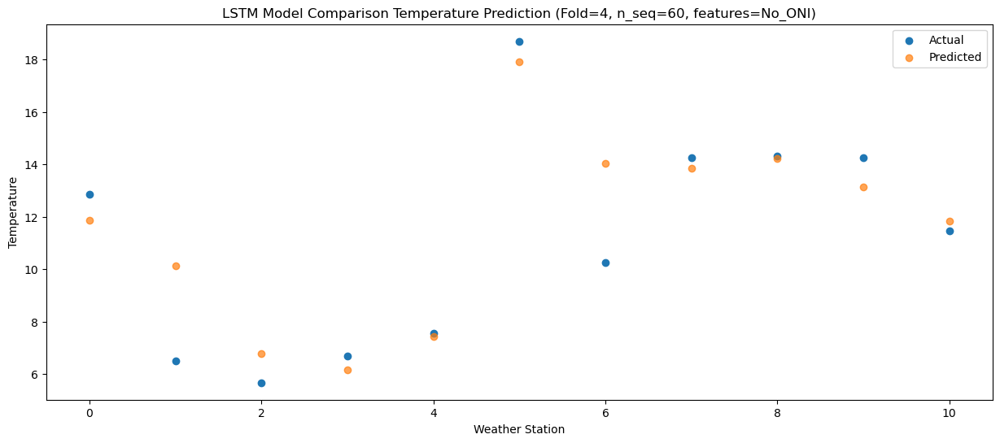

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80   3.223488
1                 1   -0.66   1.499538
2                 2   -3.00  -1.859032
3                 3   -1.33  -2.494013
4                 4   -0.29  -1.218909
5                 5   11.76   9.271947
6                 6    2.10   5.417160
7                 7    6.32   5.223218
8                 8    3.46   5.604169
9                 9    3.96   4.499417
10               10    1.07   3.211446


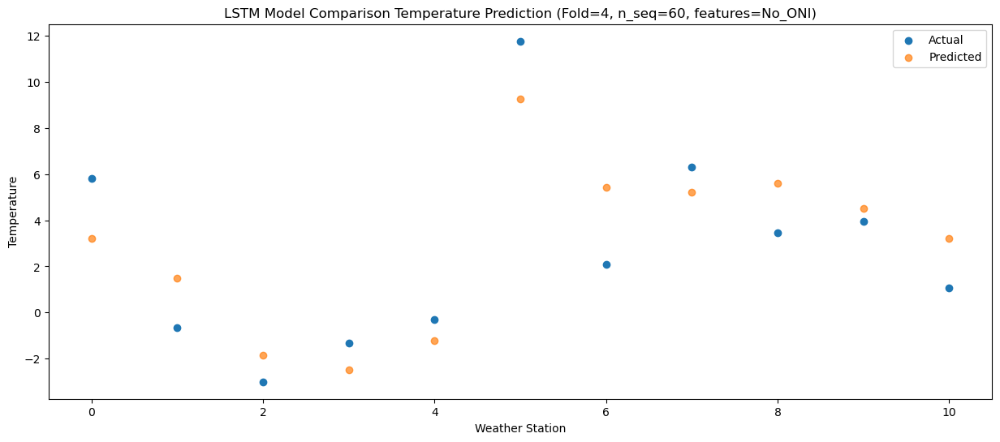

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01   2.339861
1                 1    1.14   0.612571
2                 2    0.51  -2.748532
3                 3    0.67  -3.382256
4                 4    1.45  -2.108446
5                 5   12.17   8.394718
6                 6    4.01   4.539749
7                 7    7.78   4.344818
8                 8    3.78   4.720847
9                 9    3.71   3.619146
10               10    0.21   2.330327


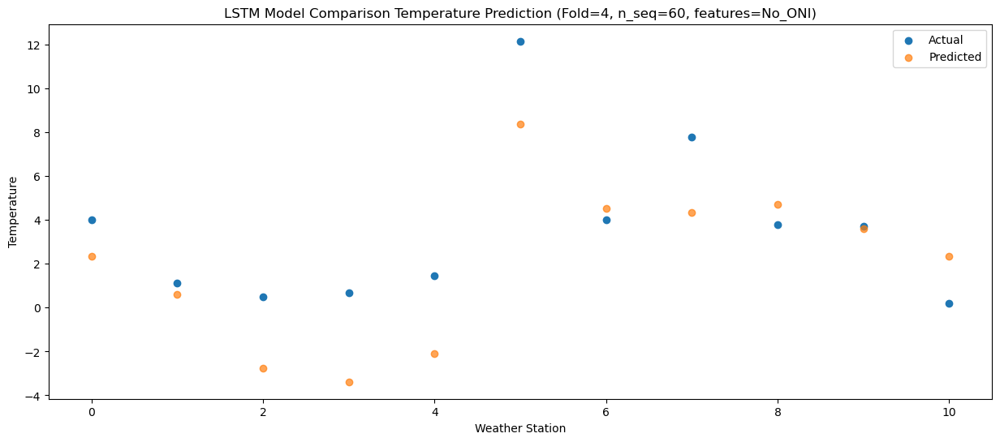

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -4.600217
1                 1   -3.62  -6.324842
2                 2   -7.77  -9.691304
3                 3   -7.80 -10.322016
4                 4   -7.45  -9.047553
5                 5    4.80   1.461686
6                 6   -2.05  -2.394084
7                 7   -1.29  -2.590501
8                 8   -5.06  -2.218496
9                 9   -5.77  -3.322061
10               10   -8.62  -4.616436


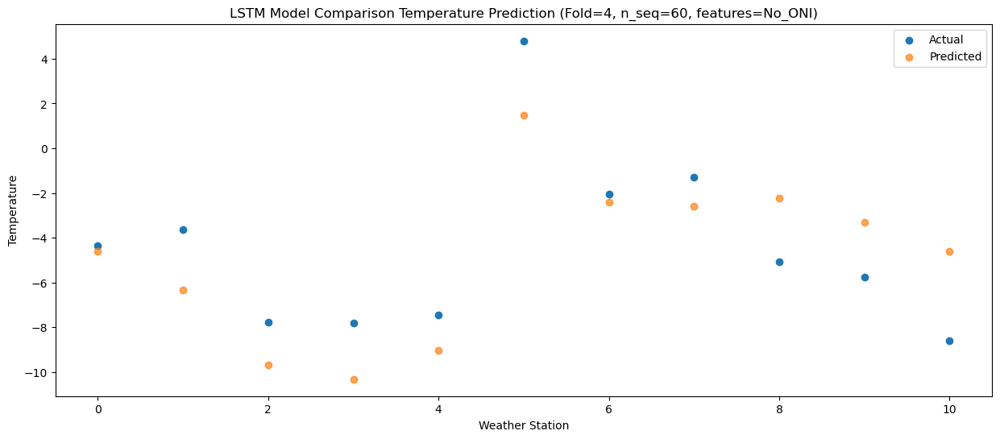

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -2.127465
1                 1   -0.19  -3.872823
2                 2   -5.41  -7.239380
3                 3   -7.54  -7.872707
4                 4   -6.83  -6.596001
5                 5    4.60   3.903049
6                 6    2.23   0.050684
7                 7    0.77  -0.135178
8                 8   -2.04   0.244387
9                 9   -2.94  -0.853471
10               10   -5.06  -2.149738


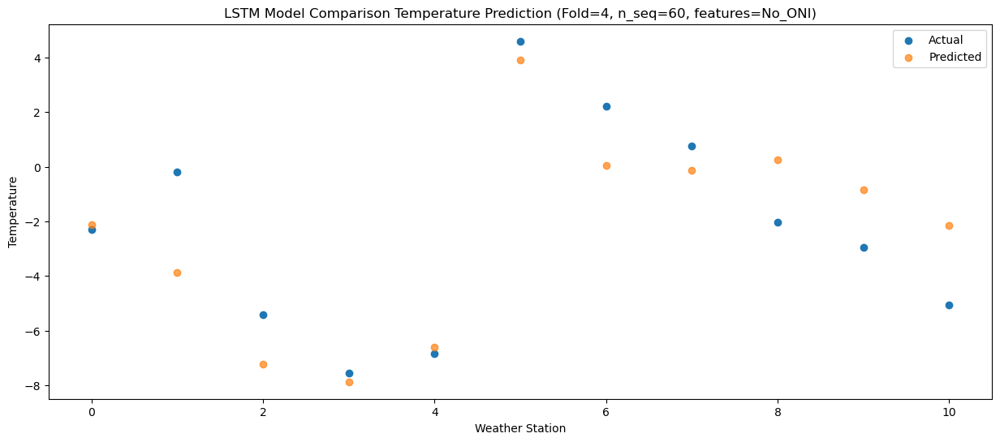

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41   3.745225
1                 1    2.63   1.995103
2                 2   -0.67  -1.373489
3                 3   -1.36  -2.003421
4                 4    0.09  -0.725202
5                 5   11.92   9.774828
6                 6    5.79   5.924179
7                 7    7.43   5.741516
8                 8    5.43   6.119905
9                 9    5.27   5.019089
10               10    0.91   3.721626


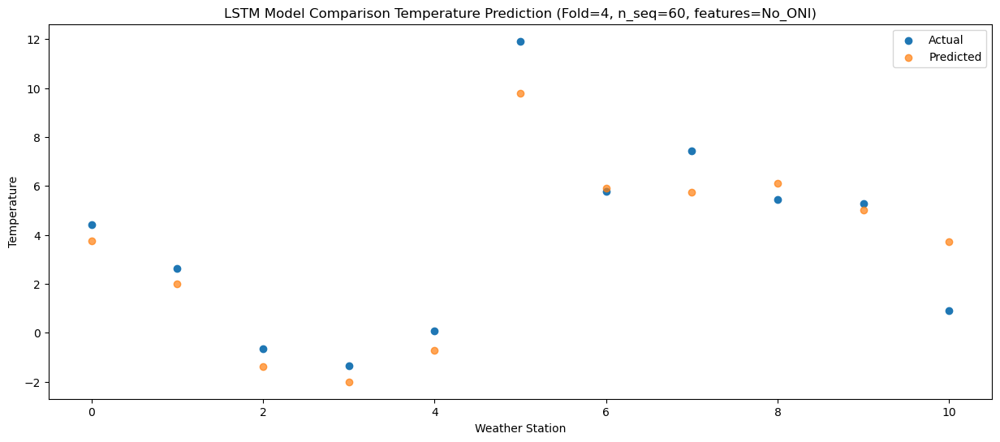

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   8.336943
1                 1    4.97   6.574354
2                 2    3.54   3.211055
3                 3    4.69   2.581443
4                 4    6.78   3.858511
5                 5   19.43  14.357454
6                 6    8.45  10.502227
7                 7   11.29  10.321831
8                 8    9.21  10.702515
9                 9    9.39   9.604699
10               10    4.91   8.304370


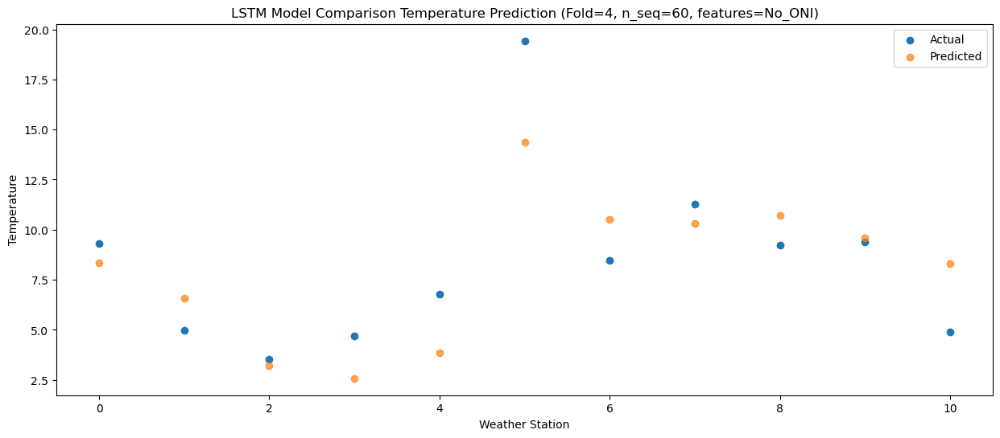

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23  14.930544
1                 1    7.79  13.157741
2                 2    9.34   9.790288
3                 3    9.40   9.157220
4                 4   11.61  10.433106
5                 5   25.12  20.932873
6                 6   14.43  17.075521
7                 7   16.96  16.897692
8                 8   17.71  17.285792
9                 9   17.92  16.190765
10               10   13.49  14.893585


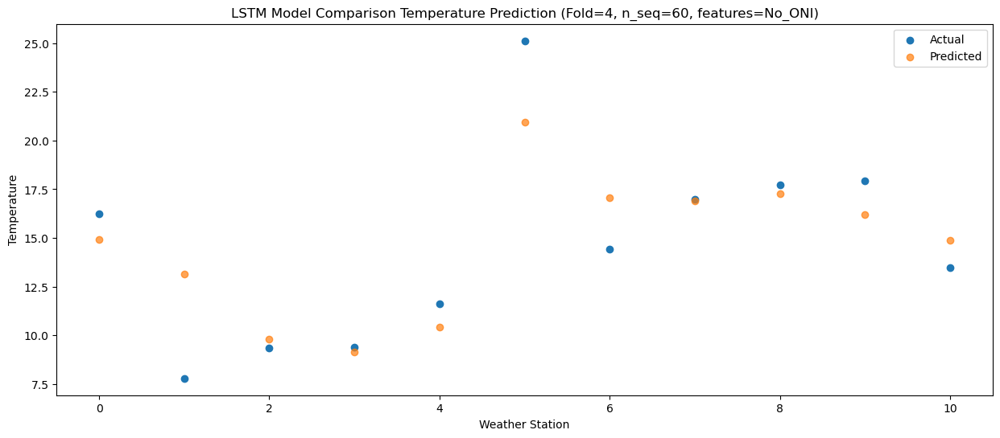

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  18.890005
1                 1    9.51  17.117534
2                 2   12.63  13.747825
3                 3   13.95  13.124208
4                 4   16.28  14.403077
5                 5   27.49  24.907017
6                 6   17.64  21.050863
7                 7   22.28  20.867441
8                 8   22.19  21.250719
9                 9   22.53  20.151810
10               10   16.76  18.850268


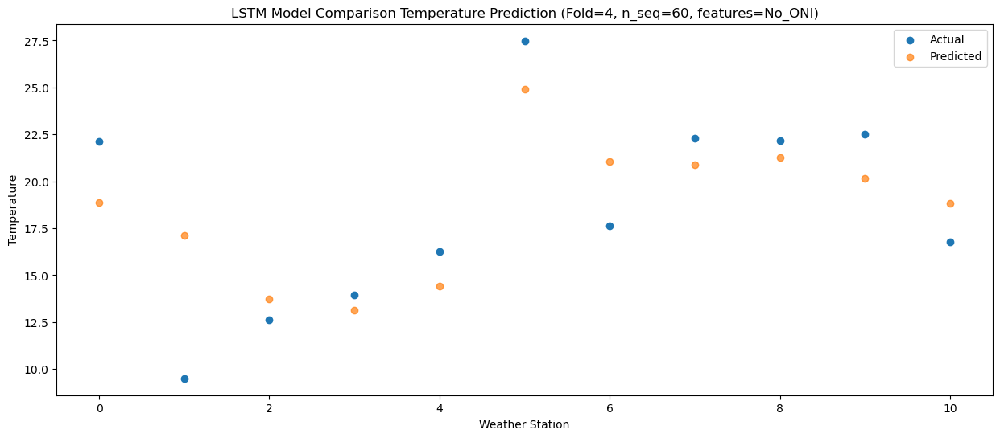

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  21.207413
1                 1    9.88  19.433385
2                 2   12.83  16.064594
3                 3   17.25  15.435782
4                 4   19.70  16.713824
5                 5   29.39  27.211639
6                 6   18.91  23.362546
7                 7   25.98  23.180129
8                 8   24.13  23.570284
9                 9   23.35  22.469398
10               10   19.36  21.176246


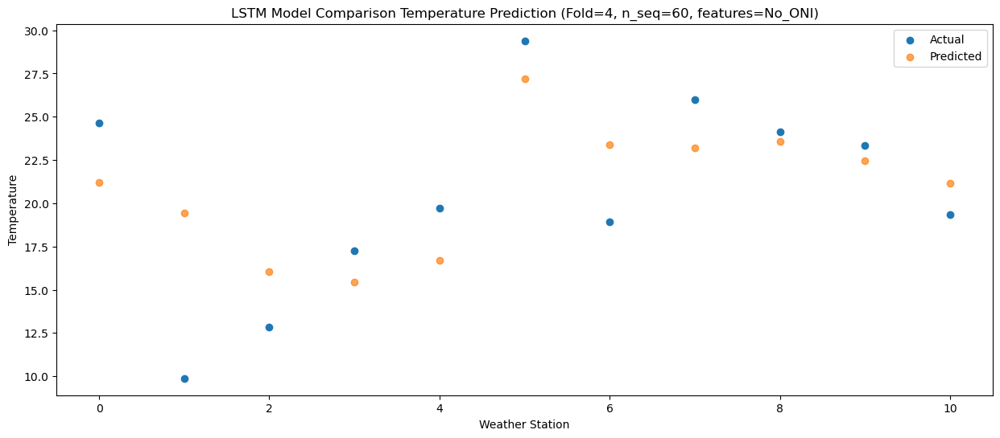

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  19.900410
1                 1    9.83  18.126274
2                 2   11.29  14.761767
3                 3   14.52  14.134508
4                 4   16.86  15.413581
5                 5   26.09  25.909376
6                 6   17.39  22.049954
7                 7   22.46  21.867930
8                 8   21.90  22.257442
9                 9   22.05  21.154913
10               10   18.29  19.861663


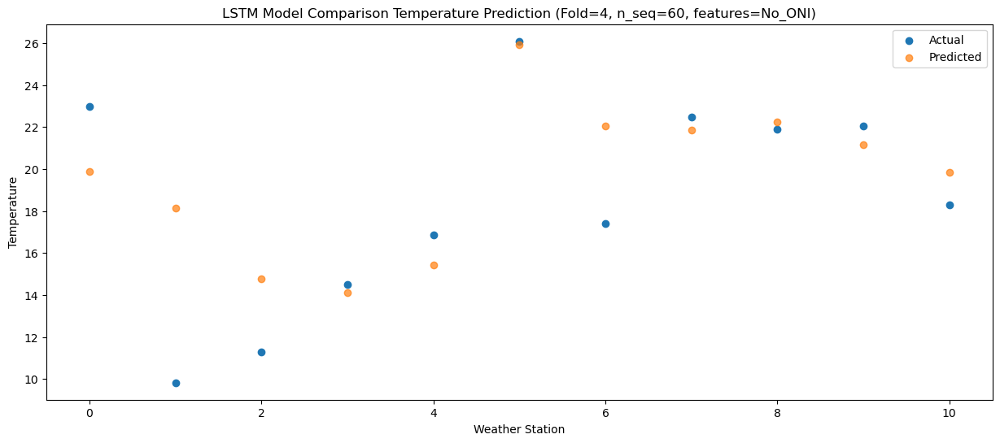

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09  16.045692
1                 1    8.39  14.278627
2                 2    9.22  10.911845
3                 3   11.09  10.283476
4                 4   12.77  11.559245
5                 5   23.19  22.057125
6                 6   14.30  18.192357
7                 7   18.87  18.009015
8                 8   17.99  18.400669
9                 9   17.91  17.296612
10               10   14.24  16.011772


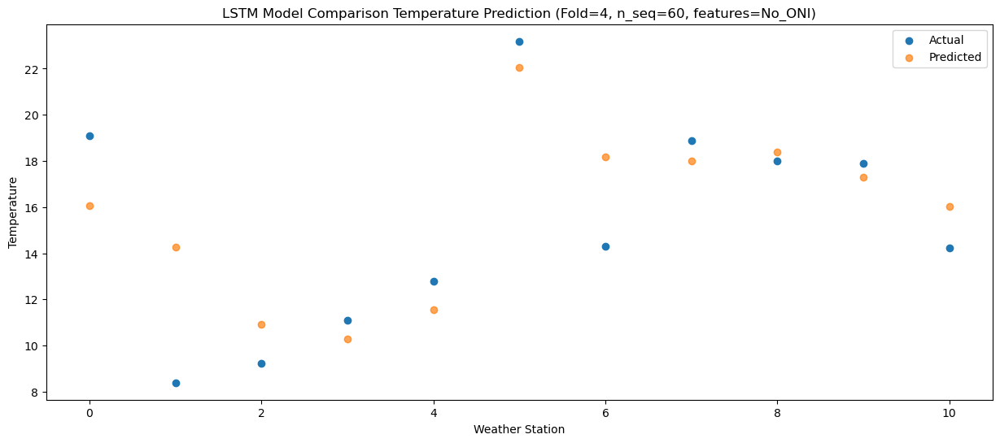

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   9.217202
1                 1    4.56   7.444256
2                 2    3.09   4.074238
3                 3    4.22   3.449140
4                 4    5.62   4.724297
5                 5   16.38  15.221269
6                 6    7.43  11.352542
7                 7   12.50  11.172142
8                 8   10.50  11.563069
9                 9   10.44  10.460668
10               10    7.38   9.168813


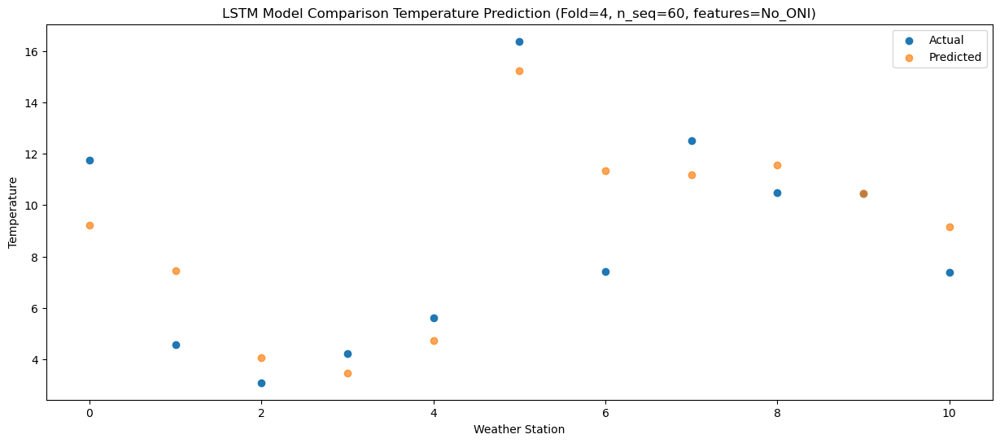

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41   3.365183
1                 1    3.10   1.584574
2                 2   -1.50  -1.786128
3                 3   -2.83  -2.405085
4                 4   -1.47  -1.129047
5                 5    8.53   9.370769
6                 6    4.73   5.500880
7                 7    5.95   5.321157
8                 8    4.71   5.702498
9                 9    4.90   4.592580
10               10    3.30   3.299775


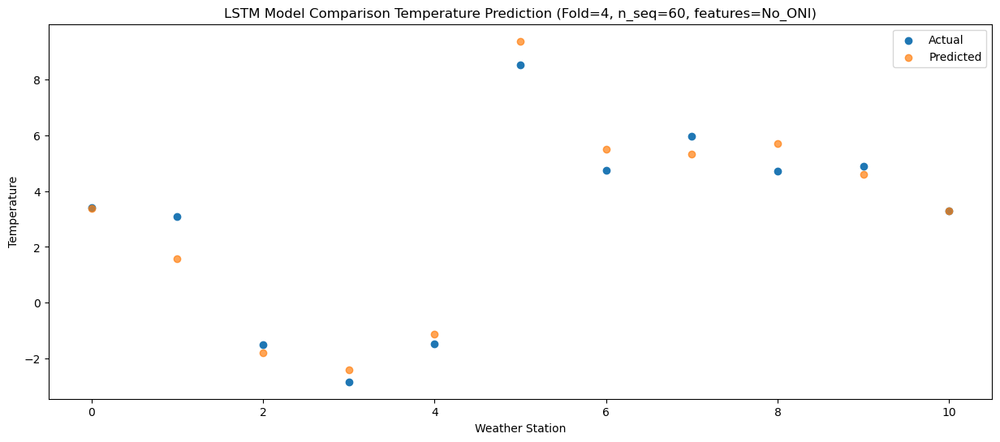

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -1.478288
1                 1   -1.75  -3.259309
2                 2   -3.93  -6.629505
3                 3   -5.52  -7.249966
4                 4   -4.44  -5.972685
5                 5    6.93   4.527663
6                 6   -1.22   0.649029
7                 7    1.10   0.471666
8                 8   -1.07   0.852681
9                 9   -1.83  -0.255216
10               10   -3.41  -1.549245


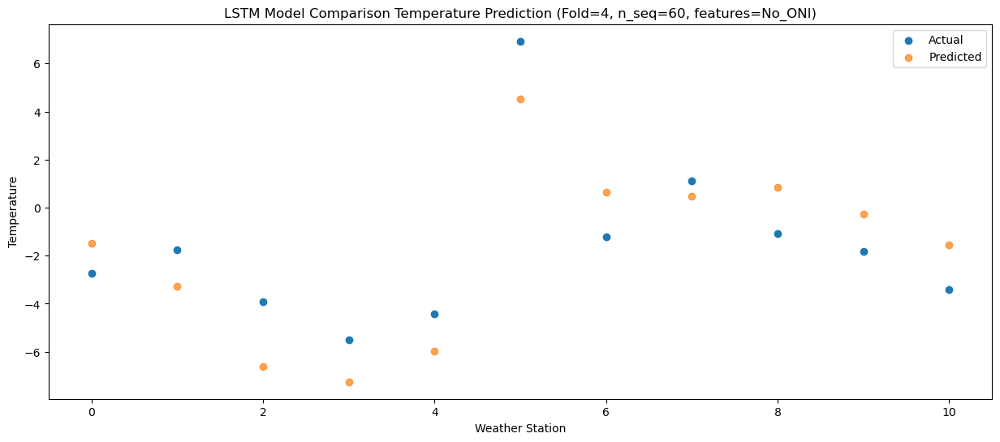

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77   0.111553
1                 1   -1.90  -1.673214
2                 2   -3.52  -5.036546
3                 3   -4.53  -5.655661
4                 4   -3.67  -4.379280
5                 5    7.30   6.126281
6                 6    1.80   2.251481
7                 7    2.75   2.073184
8                 8    0.89   2.452672
9                 9    0.41   1.340158
10               10   -1.78   0.049681


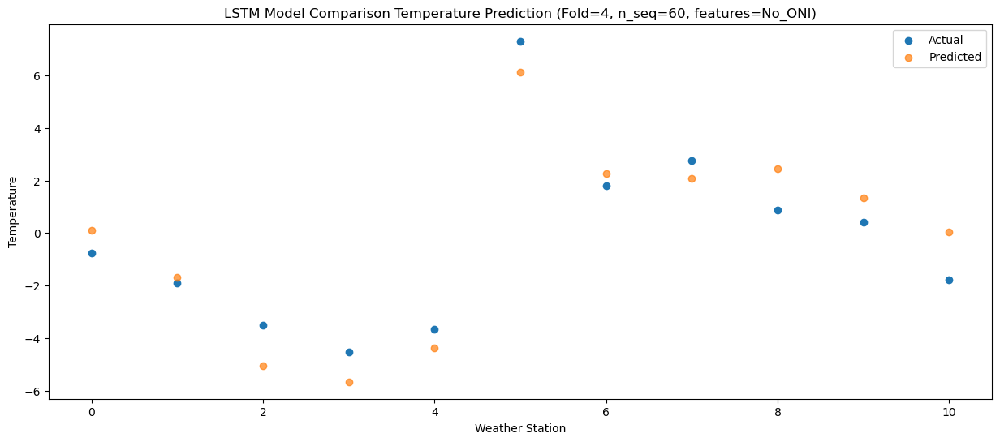

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98   0.749920
1                 1    1.40  -1.031983
2                 2   -1.58  -4.398985
3                 3   -4.47  -5.010744
4                 4   -3.44  -3.734249
5                 5    7.47   6.767427
6                 6    5.22   2.886004
7                 7    4.89   2.713698
8                 8    2.48   3.094660
9                 9    1.60   1.981306
10               10   -1.64   0.695136


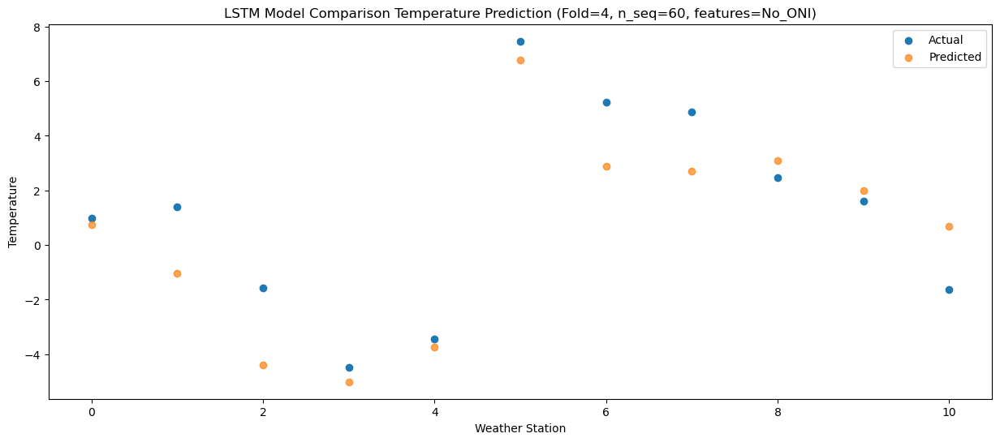

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16   3.268247
1                 1    3.12   1.490662
2                 2    0.57  -1.872435
3                 3    0.06  -2.485078
4                 4    1.41  -1.209015
5                 5   12.54   9.296253
6                 6    5.70   5.410186
7                 7    6.61   5.243386
8                 8    3.75   5.619916
9                 9    4.14   4.503671
10               10   -0.76   3.216192


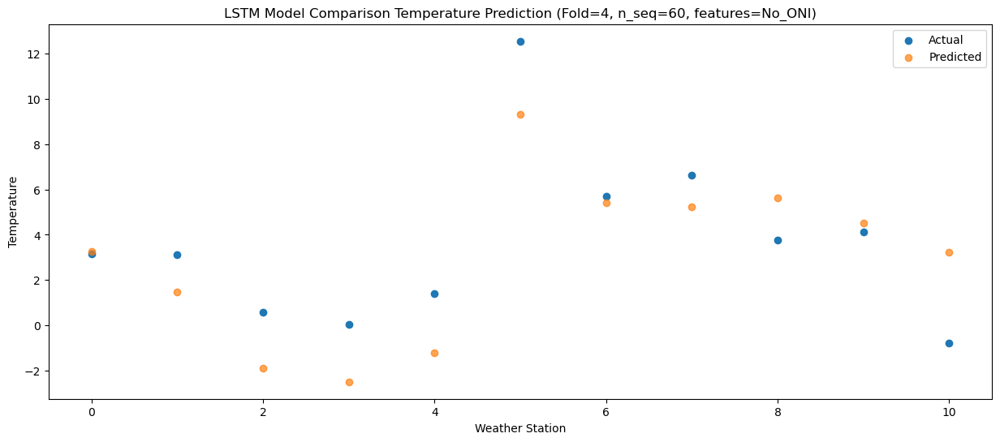

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   8.941520
1                 1    5.84   7.170611
2                 2    2.32   3.808461
3                 3    2.66   3.188214
4                 4    4.06   4.460944
5                 5   16.76  14.963430
6                 6    8.81  11.081788
7                 7   12.23  10.915352
8                 8   10.25  11.300559
9                 9   11.47  10.183109
10               10    7.71   8.901584


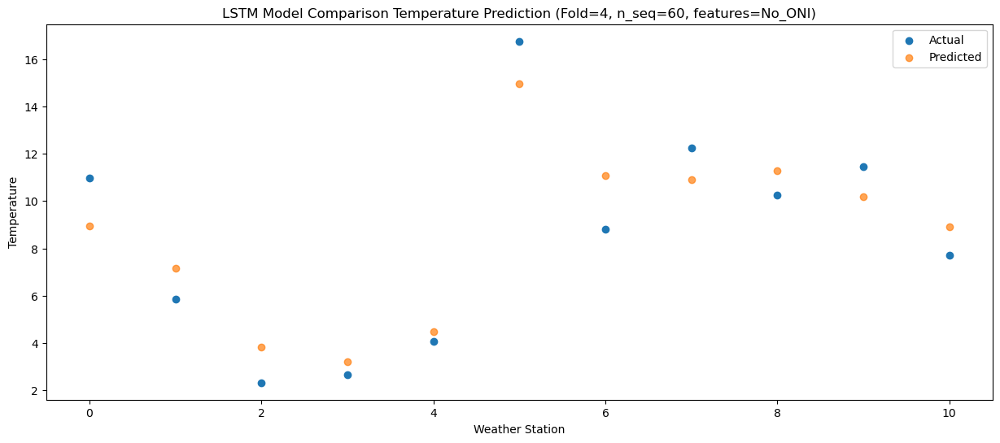

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80  13.755652
1                 1    6.62  11.983065
2                 2    7.18   8.616800
3                 3    8.34   7.993574
4                 4   10.22   9.262385
5                 5   21.68  19.764783
6                 6   11.43  15.888884
7                 7   17.01  15.715879
8                 8   15.96  16.104545
9                 9   17.23  14.987005
10               10   11.40  13.712041


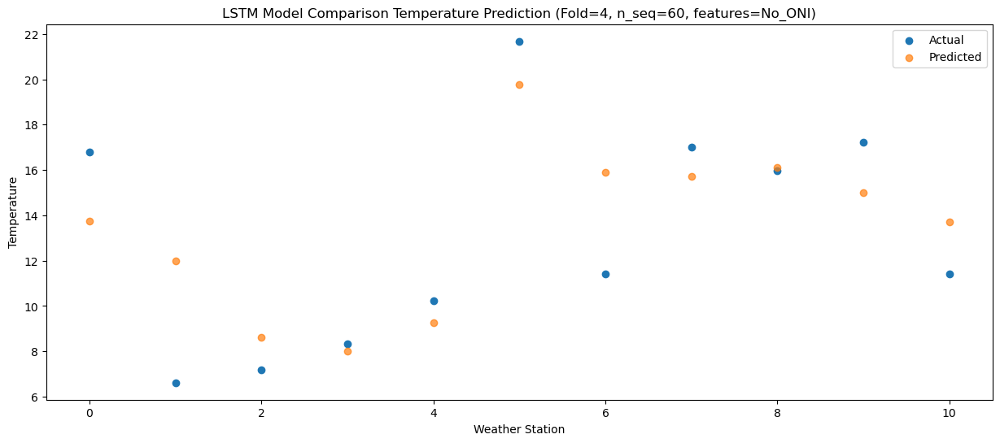

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71  17.844592
1                 1    8.83  16.066753
2                 2   10.77  12.703691
3                 3   12.53  12.077196
4                 4   15.33  13.343041
5                 5   28.16  23.848374
6                 6   15.07  19.971007
7                 7   21.09  19.795826
8                 8   19.84  20.186431
9                 9   21.54  19.072598
10               10   15.71  17.793374


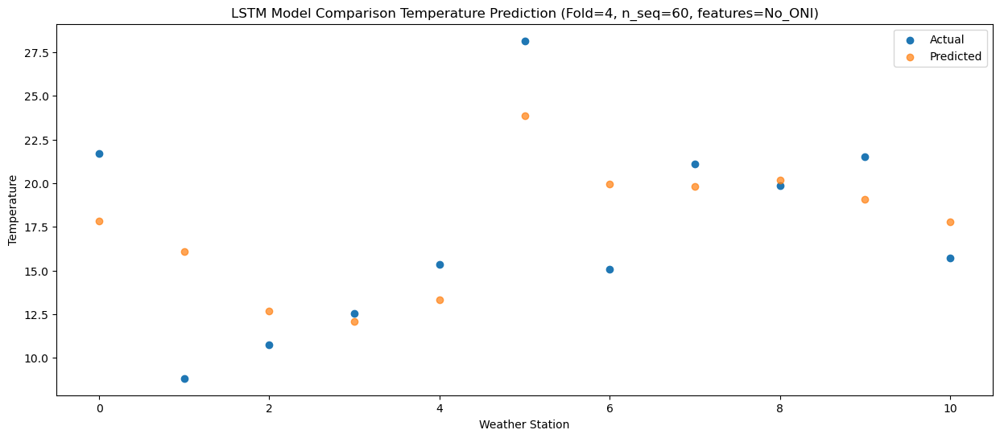

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  20.986241
1                 1   10.44  19.203949
2                 2   12.55  15.841896
3                 3   15.08  15.218017
4                 4   18.41  16.486732
5                 5   29.62  26.993197
6                 6   18.94  23.108155
7                 7   23.05  22.933293
8                 8   22.57  23.325550
9                 9   23.07  22.213759
10               10   18.80  20.931604


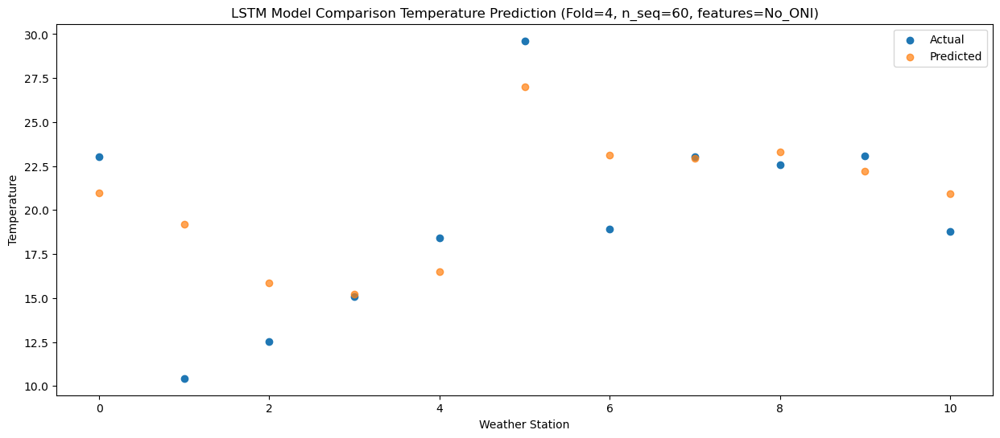

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  20.252906
1                 1   10.95  18.472440
2                 2   14.63  15.104925
3                 3   17.63  14.479983
4                 4   20.28  15.747741
5                 5   29.71  26.247319
6                 6   18.38  22.368814
7                 7   22.86  22.191610
8                 8   21.41  22.592085
9                 9   21.81  21.481724
10               10   17.47  20.193665


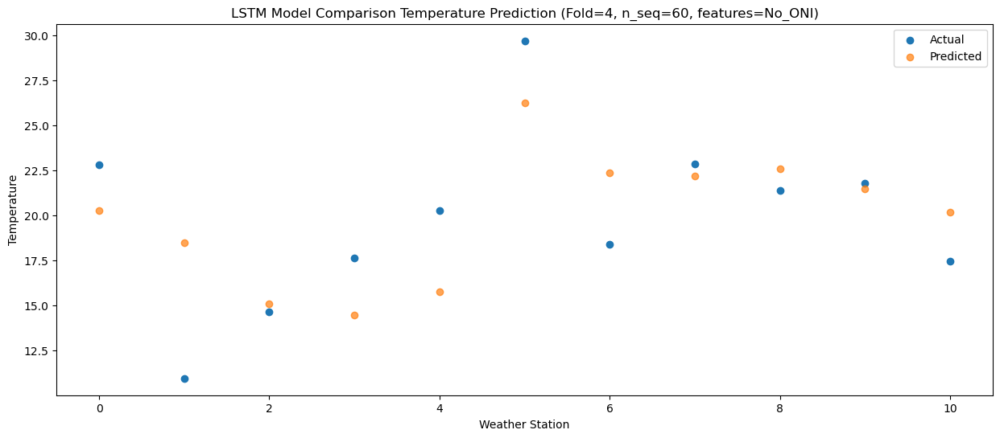

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99  16.899606
1                 1    8.85  15.123857
2                 2   10.88  11.761123
3                 3   12.93  11.135501
4                 4   15.19  12.398427
5                 5   26.23  22.900348
6                 6   14.54  19.031719
7                 7   18.92  18.847297
8                 8   18.32  19.251785
9                 9   18.77  18.141050
10               10   15.13  16.850223


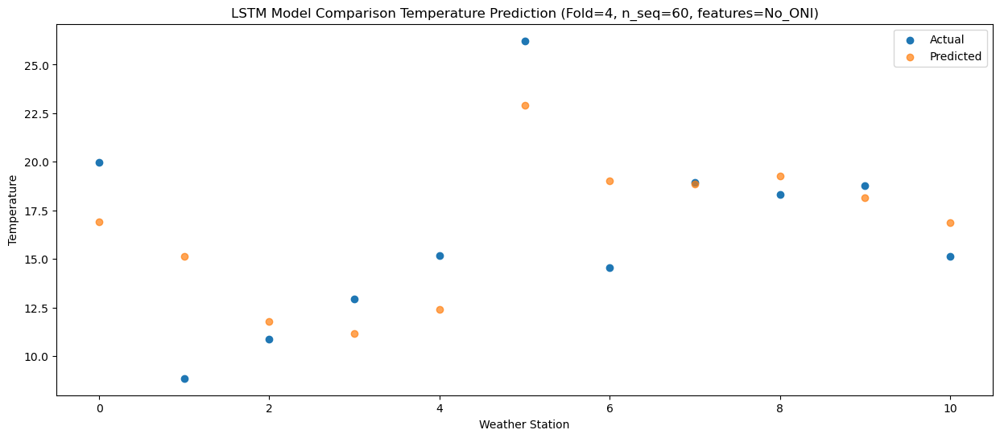

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87  10.637626
1                 1    5.20   8.852374
2                 2    4.77   5.489220
3                 3    4.80   4.866981
4                 4    6.36   6.130098
5                 5   17.70  16.638182
6                 6    9.10  12.753239
7                 7   13.02  12.574489
8                 8   12.18  12.977760
9                 9   12.36  11.870261
10               10    9.87  10.579177


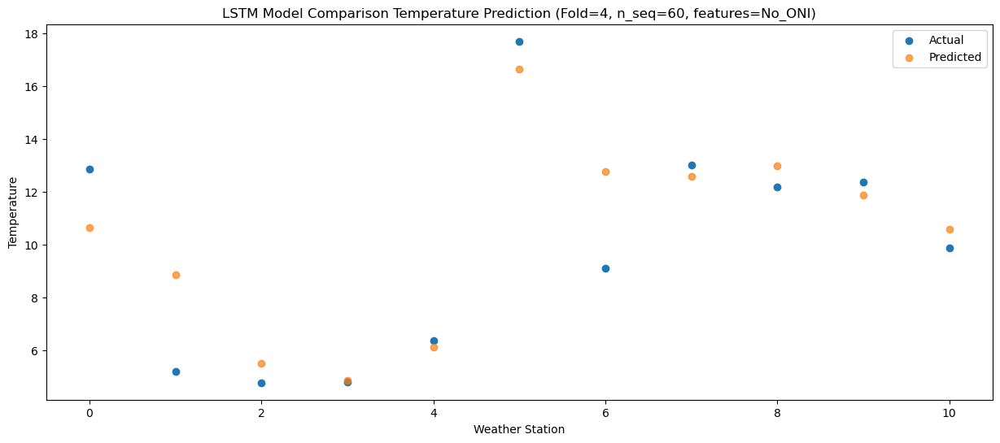

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62   3.443631
1                 1    1.49   1.652022
2                 2   -2.19  -1.704664
3                 3   -1.27  -2.324311
4                 4   -0.17  -1.060423
5                 5   10.99   9.452573
6                 6    3.37   5.563223
7                 7    7.12   5.379236
8                 8    5.11   5.783511
9                 9    5.27   4.679548
10               10    2.48   3.390232


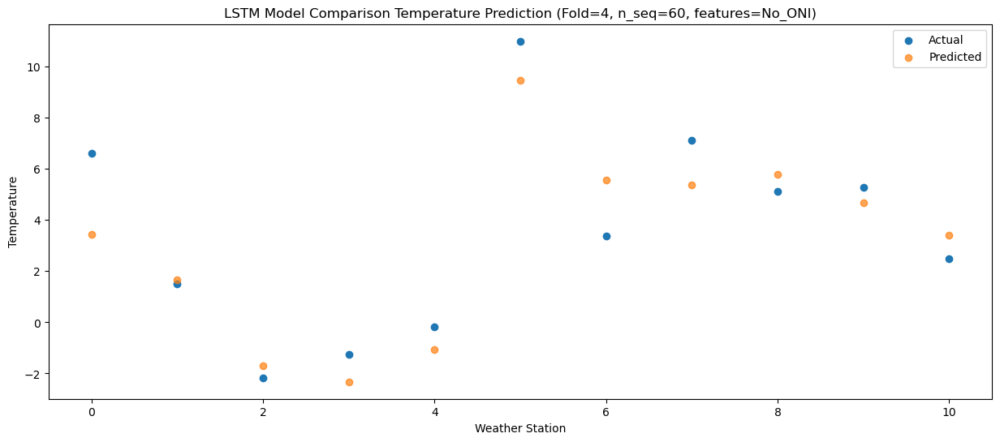

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22   1.452521
1                 1   -0.63  -0.342706
2                 2   -4.74  -3.693932
3                 3   -4.29  -4.316295
4                 4   -3.30  -3.051750
5                 5    8.19   7.456416
6                 6    1.16   3.572973
7                 7    4.24   3.386266
8                 8    3.22   3.792993
9                 9    3.28   2.691234
10               10    1.82   1.403584


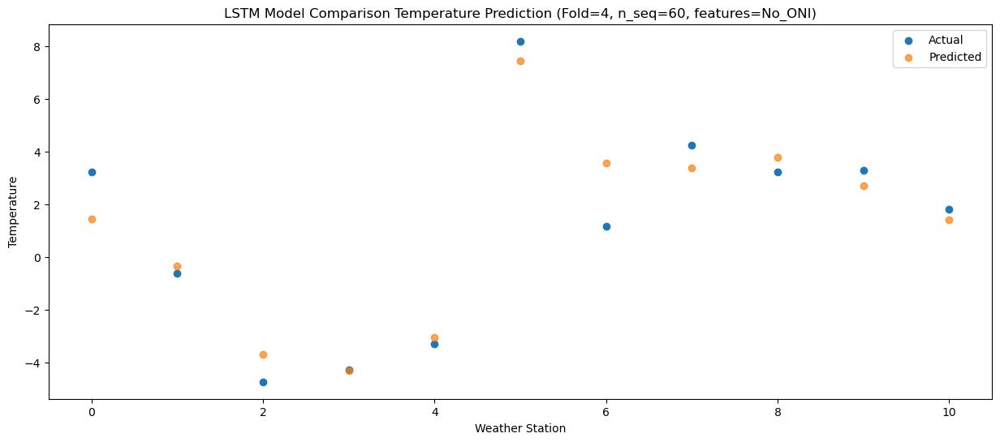

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37  -2.898497
1                 1   -2.05  -4.707547
2                 2   -8.93  -8.060572
3                 3   -9.81  -8.679139
4                 4   -8.65  -7.417116
5                 5    3.94   3.089774
6                 6   -1.28  -0.800619
7                 7   -2.92  -0.980738
8                 8   -3.06  -0.573482
9                 9   -4.30  -1.675965
10               10   -3.95  -2.958554


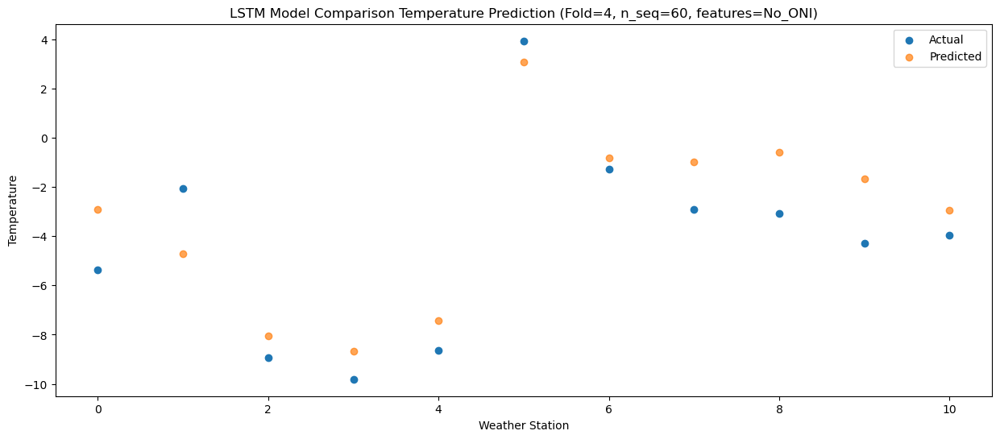

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74   1.830174
1                 1   -2.32   0.019395
2                 2   -2.61  -3.321623
3                 3   -1.40  -3.945105
4                 4   -0.33  -2.685546
5                 5   10.76   7.827183
6                 6    2.13   3.943471
7                 7    6.99   3.766040
8                 8    3.28   4.175553
9                 9    3.47   3.074124
10               10   -0.47   1.794887


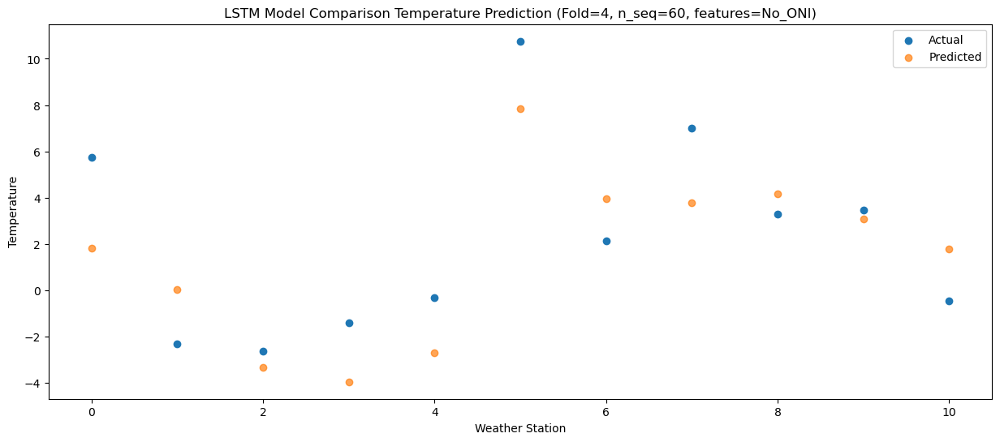

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27   5.261673
1                 1    2.58   3.439026
2                 2   -0.38   0.098083
3                 3    1.01  -0.524978
4                 4    2.24   0.731917
5                 5   13.36  11.244028
6                 6    5.92   7.361399
7                 7    9.42   7.190616
8                 8    7.72   7.601768
9                 9    7.62   6.505822
10               10    2.88   5.224702


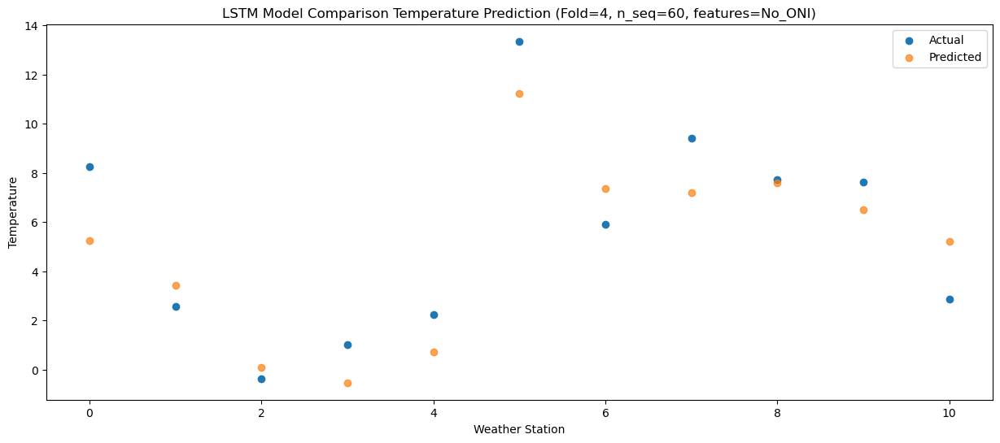

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89   9.719896
1                 1    3.63   7.877542
2                 2    3.44   4.537077
3                 3    4.86   3.922051
4                 4    6.29   5.179952
5                 5   18.32  15.692116
6                 6   10.15  11.810748
7                 7   13.56  11.646079
8                 8   12.30  12.058215
9                 9   12.11  10.964586
10               10    8.60   9.678672


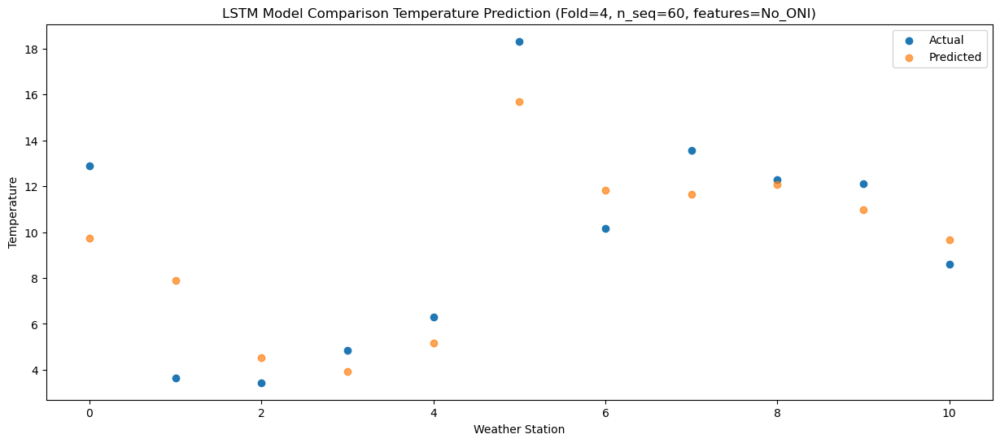

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90  15.229533
1                 1    9.08  13.391040
2                 2    8.96  10.056926
3                 3    9.62   9.443377
4                 4   11.09  10.701947
5                 5   23.61  21.212005
6                 6   14.22  17.335591
7                 7   18.21  17.174943
8                 8   18.90  17.585349
9                 9   19.14  16.497835
10               10   14.70  15.205177


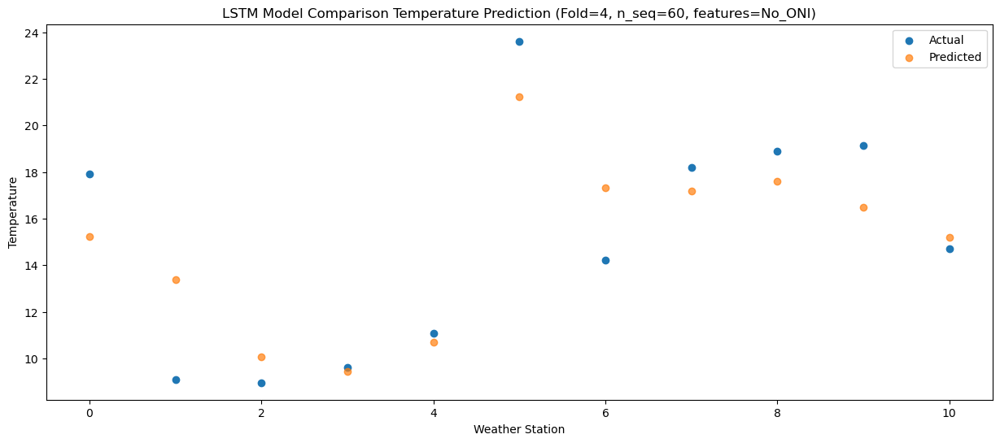

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09  19.687874
1                 1    9.73  17.849016
2                 2   11.59  14.510664
3                 3   13.65  13.892252
4                 4   15.54  15.148672
5                 5   27.62  25.656421
6                 6   17.64  21.786384
7                 7   21.93  21.626801
8                 8   22.26  22.043191
9                 9   23.11  20.960253
10               10   17.86  19.670932


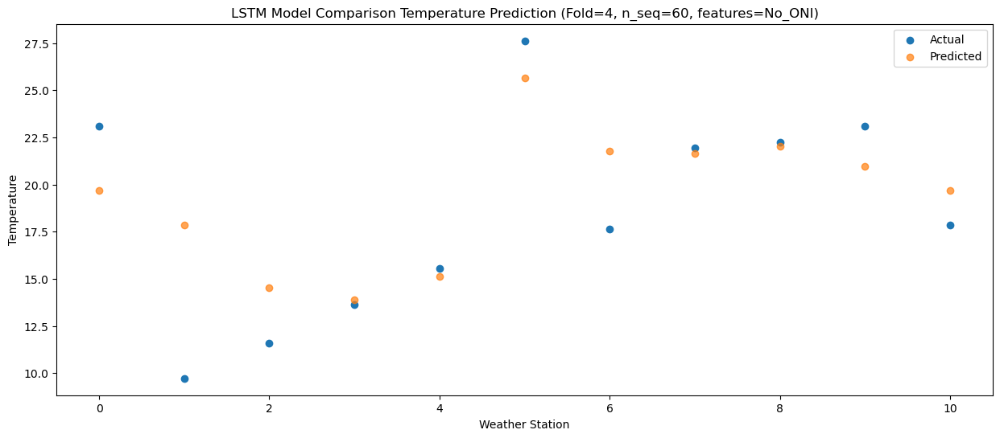

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85  20.981992
1                 1   10.42  19.144414
2                 2   12.61  15.802384
3                 3   14.55  15.184371
4                 4   16.25  16.442845
5                 5   26.45  26.946298
6                 6   19.10  23.081446
7                 7   22.23  22.924194
8                 8   22.27  23.341149
9                 9   22.14  22.259363
10               10   19.38  20.972451


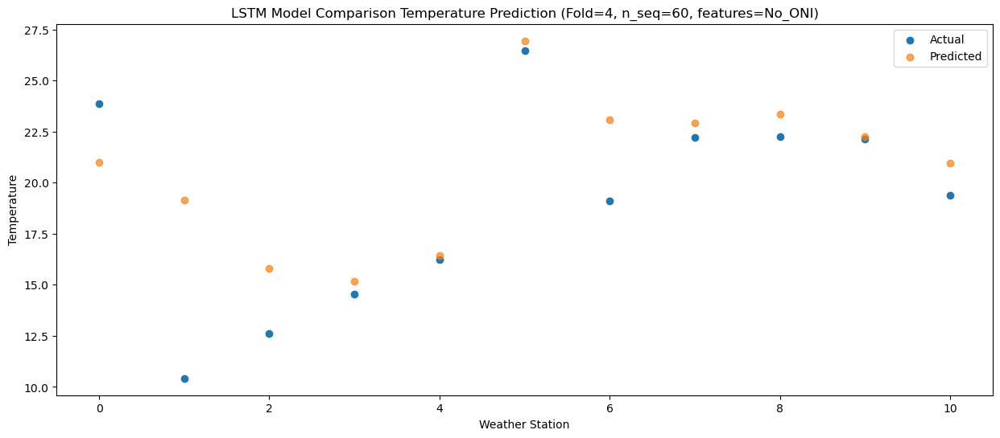

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36  20.129624
1                 1   10.12  18.287155
2                 2   13.18  14.943790
3                 3   16.30  14.327138
4                 4   18.21  15.585702
5                 5   28.91  26.092748
6                 6   17.94  22.218929
7                 7   22.67  22.063005
8                 8   22.19  22.480405
9                 9   21.80  21.398037
10               10   18.24  20.114984


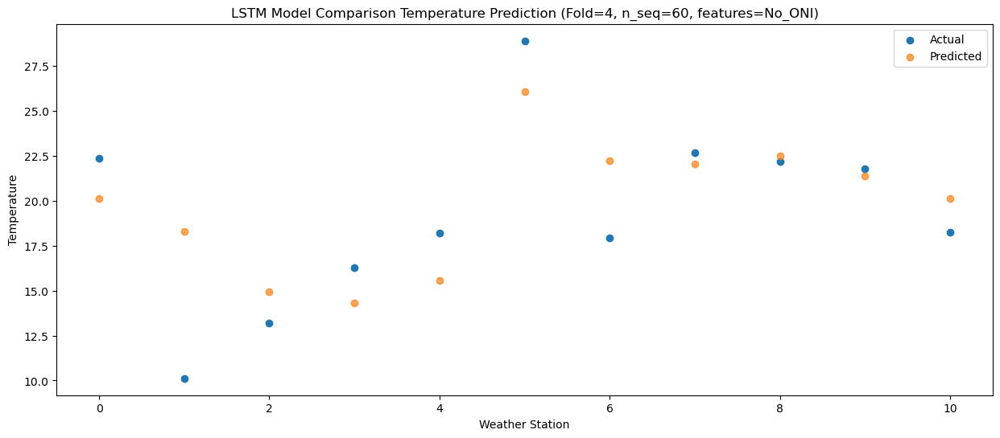

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93  16.794660
1                 1    9.25  14.950656
2                 2    9.57  11.612073
3                 3   10.91  10.996813
4                 4   12.20  12.258126
5                 5   22.46  22.760967
6                 6   15.50  18.889352
7                 7   18.53  18.735713
8                 8   19.58  19.150134
9                 9   18.57  18.068843
10               10   15.97  16.791213


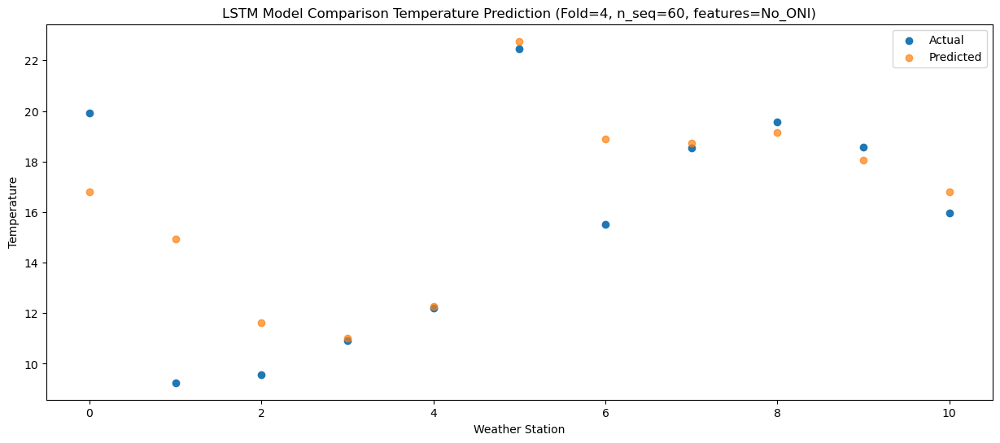

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80  11.688766
1                 1    5.48   9.847026
2                 2    5.43   6.515960
3                 3    8.16   5.901259
4                 4    9.78   7.163011
5                 5   20.75  17.664244
6                 6    9.88  13.791401
7                 7   14.85  13.638264
8                 8   13.65  14.052820
9                 9   13.50  12.967497
10               10    9.50  11.691228


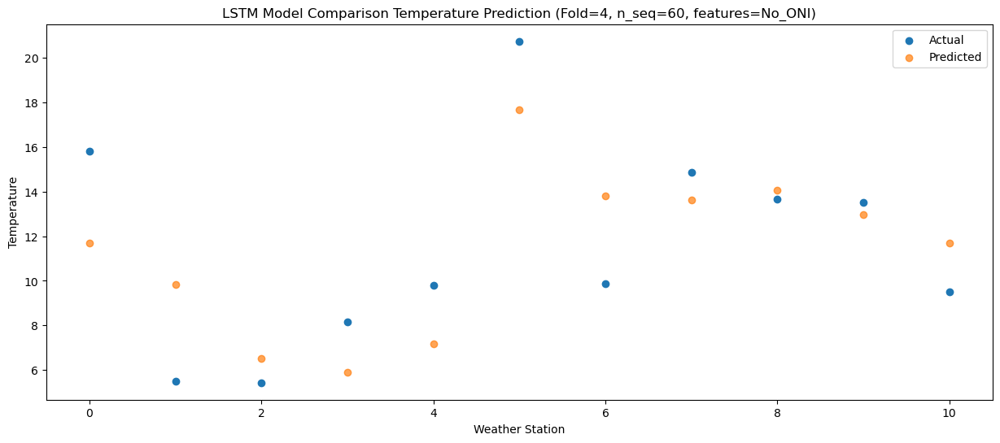

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_18 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_18 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_19 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_19 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_27 (Dense)            (1, 256)                  262400    
                                                                 
 dense_28 (Dense)            (1, 128)                  32896     
                                                                 
 dense_29 (Dense)            (1, 60)                  

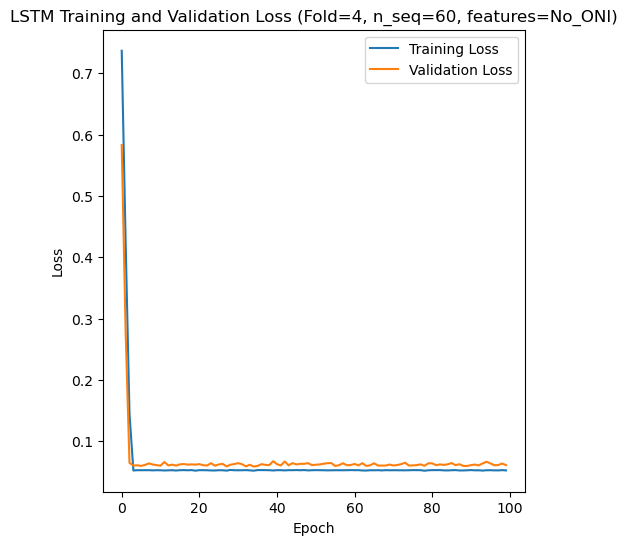

[[1.4861617103579143, 0.9786035866235188, 1.3316726836241808, 1.660381701812271, 2.0090180978238665, 1.550297946140477, 2.373206283264187, 3.3673380546960456, 3.5942420724817166, 2.8558518781690627, 2.0048481533597147, 0.754267196101549, 1.2109466009794985, 1.4618163810053708, 1.5465074904456761, 2.147342949014745, 1.5354146237058084, 1.8348243127986907, 2.2472249328598943, 3.6367577208107935, 3.268505332182959, 3.3226647668000937, 3.1047445852272975, 2.2068760153750633, 2.136954288872575, 2.125095079811519, 2.04989548430843, 1.5308709828876017, 0.9364008680390974, 1.9082841822066663, 2.4884839988923155, 2.8798807686817987, 3.7226049302319573, 3.412063317584448, 2.694320360164366, 2.481779756436839, 0.991378058363293, 2.2439503979418807, 1.724295833199112, 1.515047522938528, 2.2772736115594294, 1.7055959623653605, 3.0409955604217256, 3.3205385463347916, 3.2132023692710296, 3.173411585615044, 3.0050879823165166, 2.2900732220528153, 1.80528265622461, 1.87840765441285, 1.3939133124438936,

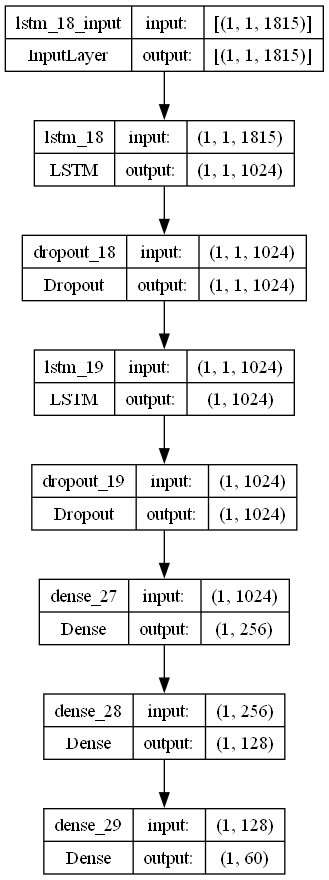

In [3]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr = 0.005668181316305681 
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate = 0.45502838358743375

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperature)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_CV_S60_No_ONI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)